<a href="https://colab.research.google.com/github/kluo9/Deep-Learning/blob/main/Basic_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

define visionlization function

In [ ]:
def show(tensor, ch = 1, size = (28,28), num = 16):
  # tenor: 128 * 784
  data = tensor.detach().cpu().view(-1,ch,*size) # 128 * 1 * 28 * 28
  grid = make_grid(data[:num], nrow = 4).permute(1,2,0)
  plt.imshow(grid)
  plt.show()

Set up the main parameters and hyperparameters

In [ ]:
epochs = 500
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.00001
loss_func = nn.BCEWithLogitsLoss()
bs = 128
device = 'cuda'
dataloader = DataLoader(MNIST('.', download = True, transform = transforms.ToTensor()), shuffle = True, batch_size = bs)

# number os steps = 60000 / 128 = 468.75

# Models

Generator

In [ ]:
from torch.nn.modules.batchnorm import BatchNorm1d
# generator
def genBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.BatchNorm1d(out),
      nn.ReLU(inplace = True)
  )

class Generator(nn.Module):
  def __init__(self, z_dim = 64, i_dim = 784, h_dim = 128):
    super().__init__()
    self.gen = nn.Sequential(
        genBlock(z_dim, h_dim), # 64, 128
        genBlock(h_dim, h_dim*2), # 128, 256
        genBlock(h_dim*2, h_dim*4), # 256, 512
        genBlock(h_dim*4, h_dim*8), # 512, 1024
        nn.Linear(h_dim*8, i_dim), # 1024, 784 (28*28)
        nn.Sigmoid(),
    )
  def forward(self, noise):
    return self.gen(noise)

def gen_noise(number, z_dim):
  return torch.randn(number, z_dim).to(device)

Descriminator

In [ ]:
def discBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.LeakyReLU(0.2)
  )

class Discriminator(nn.Module):
  def __init__(self, i_dim = 784, h_dim = 256):
    super().__init__()
    self.disc = nn.Sequential(
        discBlock(i_dim, h_dim*4), # 784, 1024
        discBlock(h_dim*4, h_dim*2), # 1024, 512
        discBlock(h_dim*2, h_dim), # 512, 256
        nn.Linear(h_dim, 1) # 256, 1
    )
  def forward(self, image):
    return self.disc(image)


In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr = lr)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([8, 9, 9, 6, 7, 3, 9, 8, 8, 7])


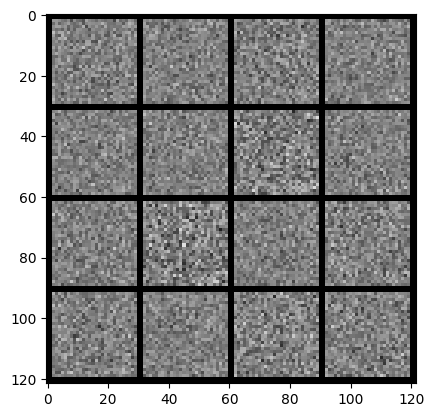

In [ ]:
x,y = next(iter(dataloader))
print(x.shape, y.shape)
print(y[:10])

noise = gen_noise(bs, z_dim)
fake = gen(noise)
show(fake)

Loss function

In [ ]:
# generator loss
def cal_gen_loss(loss_func, gen, disc, number, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  predict = disc(fake)
  target = torch.ones_like(predict)
  gen_loss = loss_func(predict, target)
  return gen_loss

def cal_disc_loss(loss_func, gen, disc, number, real, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  disc_fake = disc(fake.detach())
  disc_fake_target = torch.zeros_like(disc_fake)
  disc_fake_loss = loss_func(disc_fake, disc_fake_target)

  disc_real = disc(real)
  disc_real_target = torch.ones_like(disc_real)
  disc_real_loss = loss_func(disc_real, disc_real_target)

  disc_loss = (disc_fake_loss + disc_real_loss) / 2
  return disc_loss


# Main loop

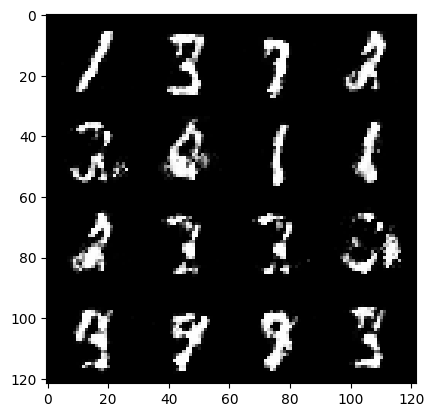

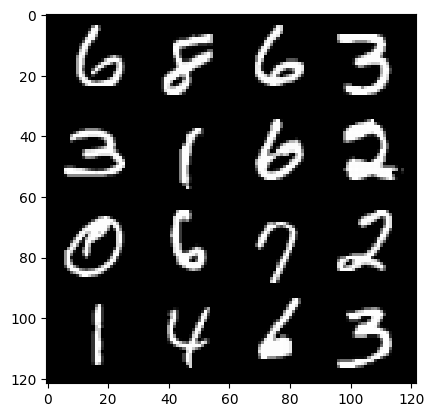

216: step 101700 / Gen loss 1.9044768846034996 / Disc loss 0.3041858697930971


  0%|          | 0/469 [00:00<?, ?it/s]

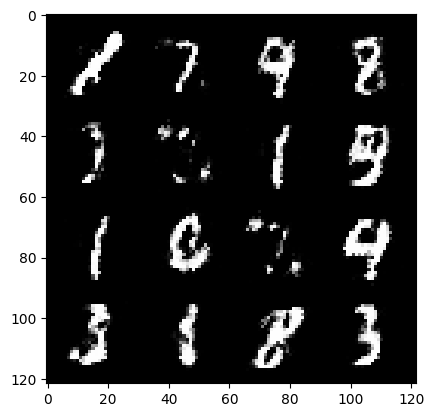

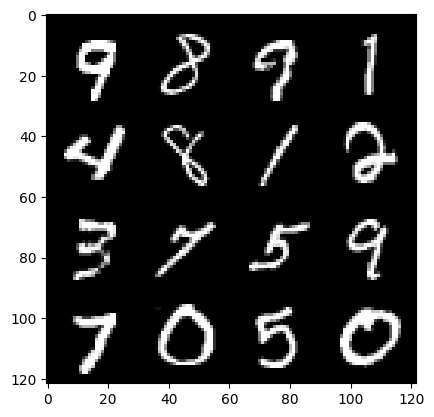

217: step 102000 / Gen loss 1.9127485275268543 / Disc loss 0.28618862147132546


  0%|          | 0/469 [00:00<?, ?it/s]

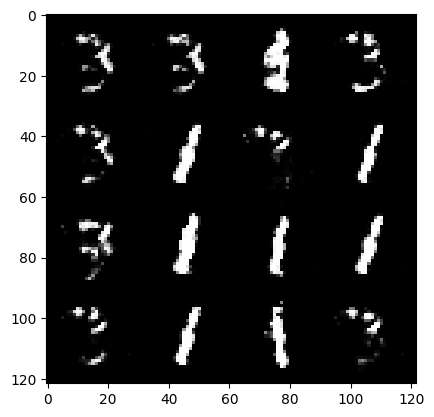

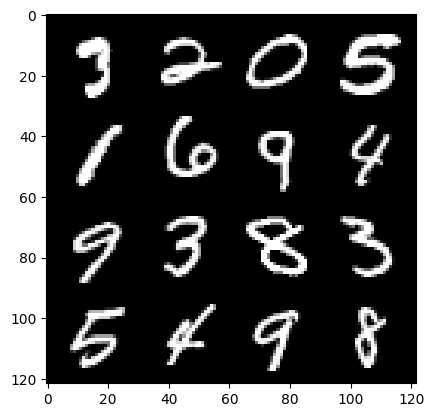

218: step 102300 / Gen loss 1.773351910511653 / Disc loss 0.320949589908123


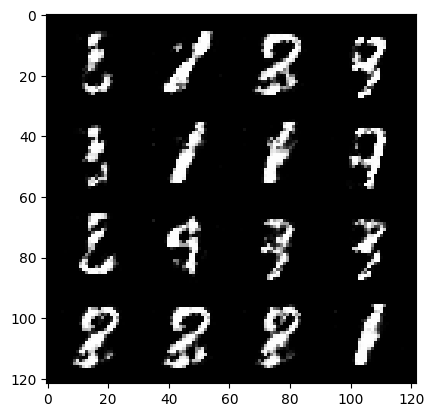

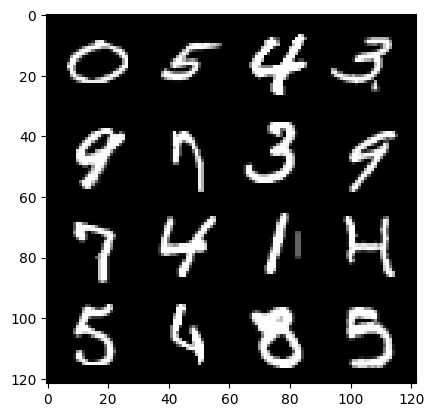

218: step 102600 / Gen loss 1.9262955904006942 / Disc loss 0.2640204449991383


  0%|          | 0/469 [00:00<?, ?it/s]

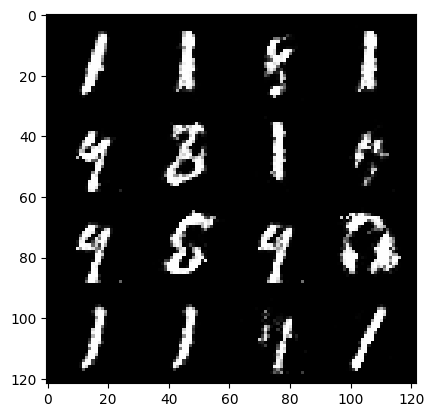

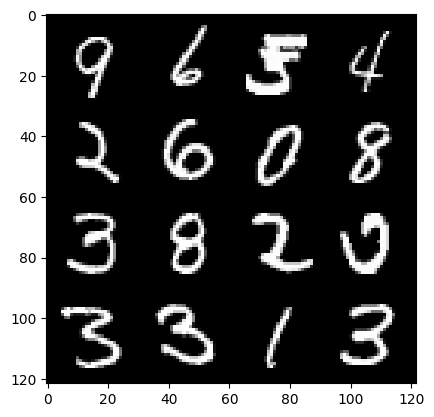

219: step 102900 / Gen loss 2.0287757043043775 / Disc loss 0.27313615898291266


  0%|          | 0/469 [00:00<?, ?it/s]

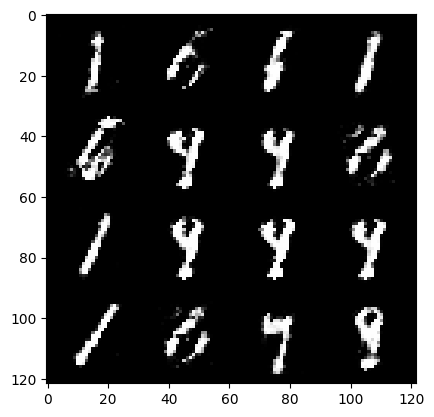

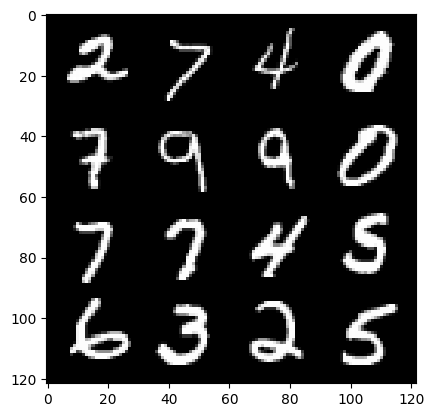

220: step 103200 / Gen loss 1.8765975677967073 / Disc loss 0.30282006467382117


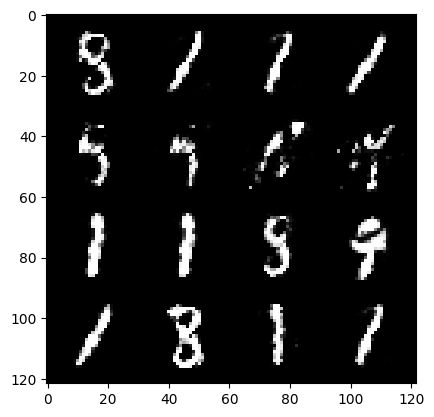

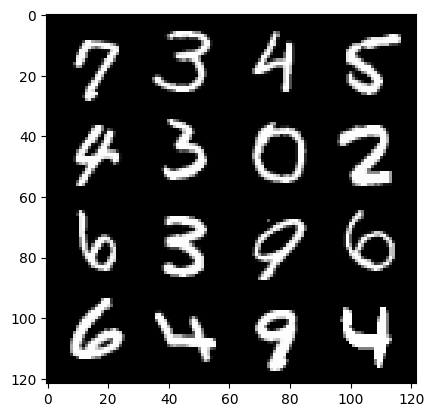

220: step 103500 / Gen loss 1.838932216564814 / Disc loss 0.29944326539834326


  0%|          | 0/469 [00:00<?, ?it/s]

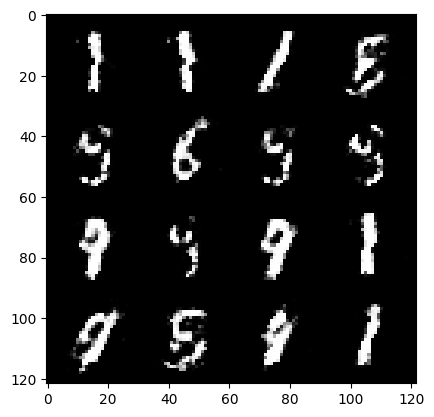

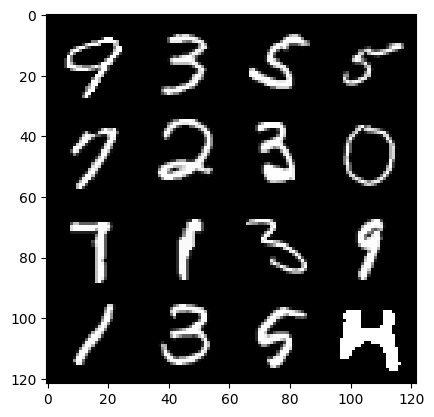

221: step 103800 / Gen loss 1.82491504073143 / Disc loss 0.2867968939741456


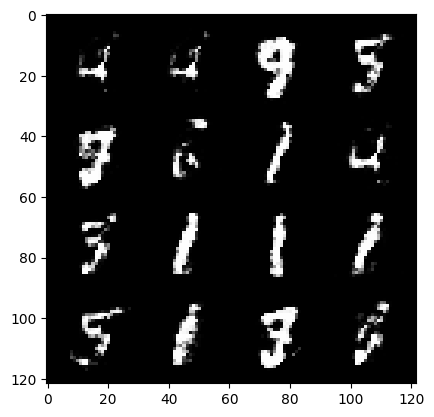

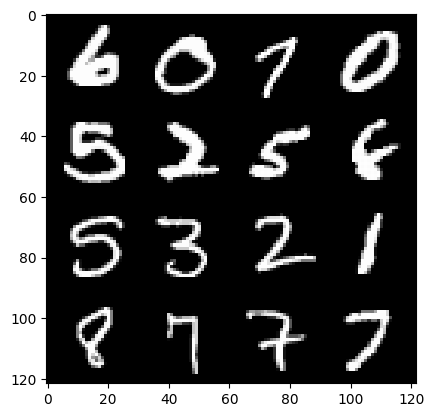

221: step 104100 / Gen loss 1.7809619081020343 / Disc loss 0.2905461855232715


  0%|          | 0/469 [00:00<?, ?it/s]

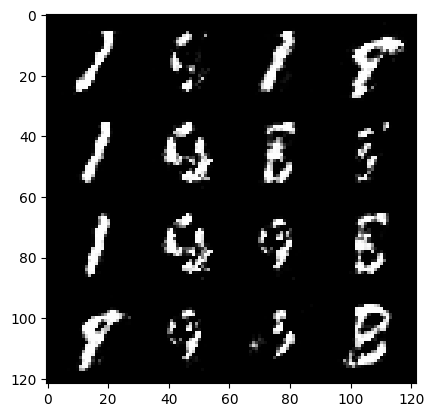

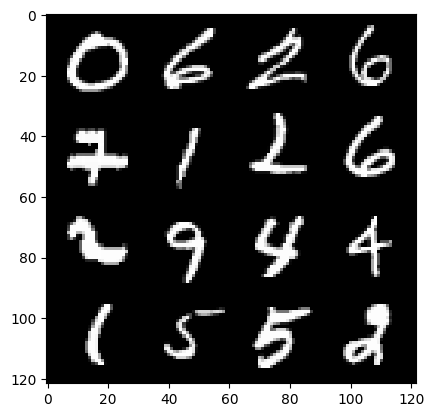

222: step 104400 / Gen loss 1.9439034756024673 / Disc loss 0.2678124331434567


  0%|          | 0/469 [00:00<?, ?it/s]

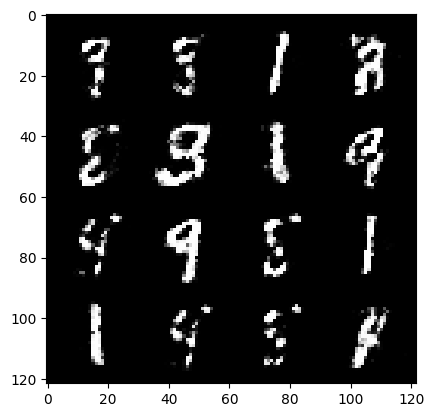

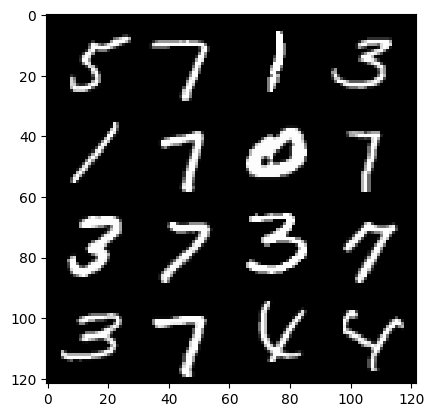

223: step 104700 / Gen loss 1.9298118793964392 / Disc loss 0.28704374874631555


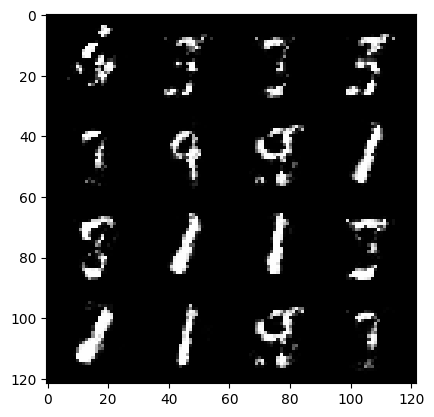

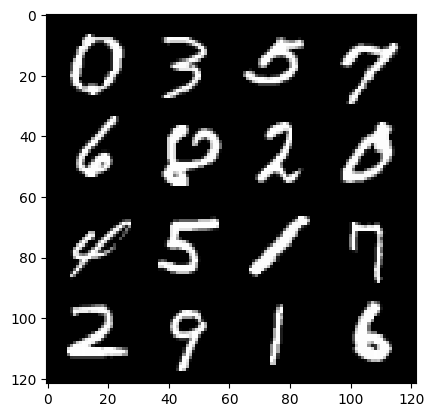

223: step 105000 / Gen loss 1.9392289511362728 / Disc loss 0.2735627226034803


  0%|          | 0/469 [00:00<?, ?it/s]

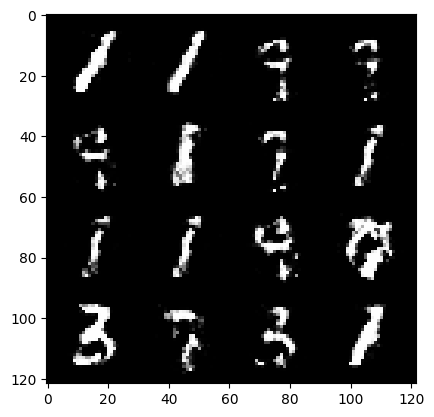

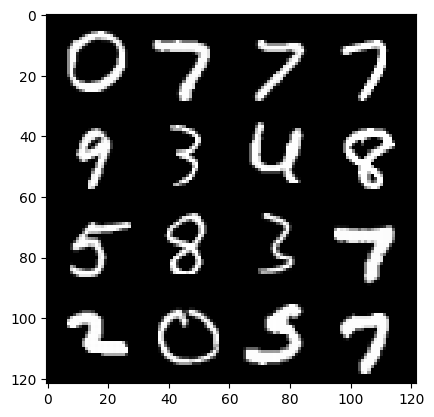

224: step 105300 / Gen loss 1.8829626524448384 / Disc loss 0.28180389945705725


  0%|          | 0/469 [00:00<?, ?it/s]

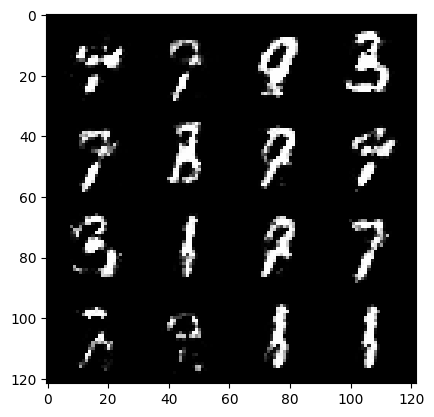

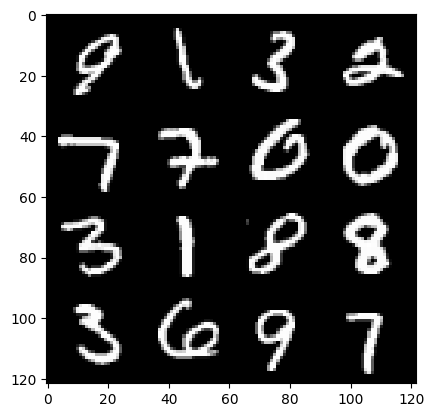

225: step 105600 / Gen loss 1.882186157306036 / Disc loss 0.28254311377803465


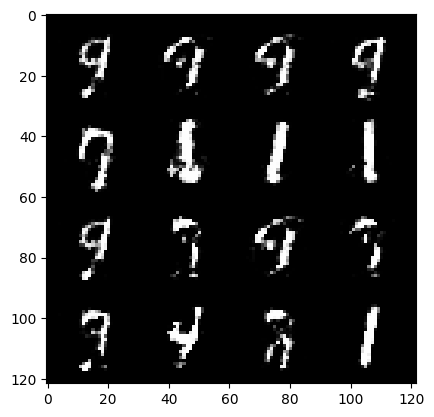

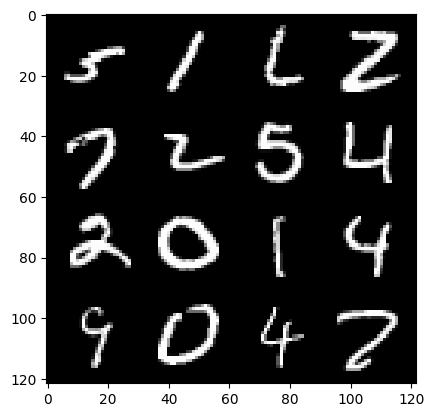

225: step 105900 / Gen loss 1.8923549254735308 / Disc loss 0.2787216989199323


  0%|          | 0/469 [00:00<?, ?it/s]

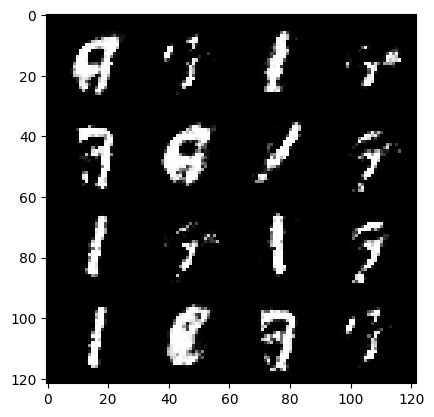

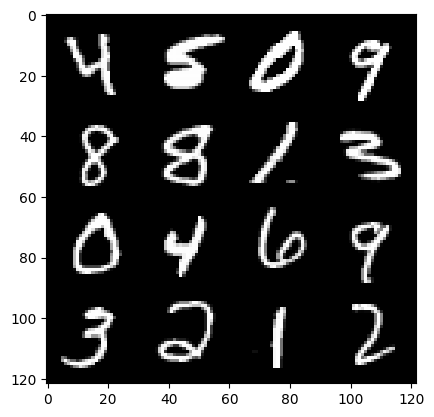

226: step 106200 / Gen loss 1.9123912835121144 / Disc loss 0.2934491050740081


  0%|          | 0/469 [00:00<?, ?it/s]

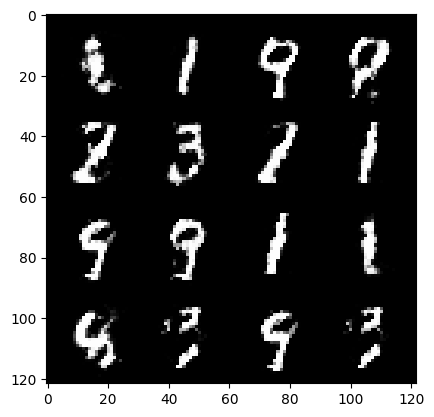

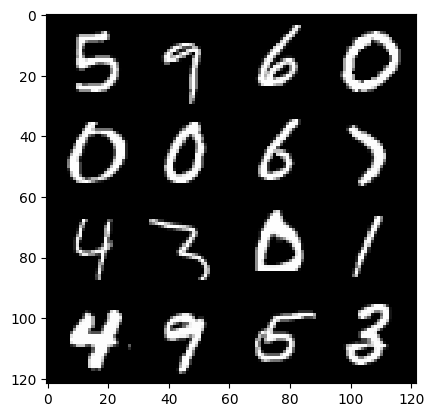

227: step 106500 / Gen loss 1.947584544420243 / Disc loss 0.2783039346337318


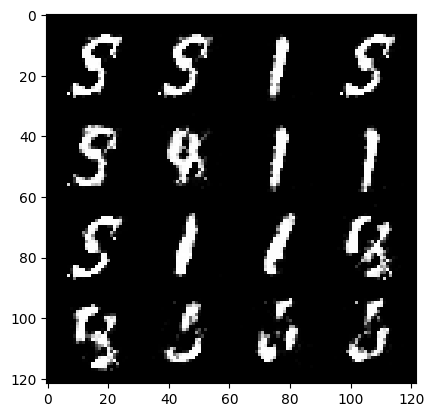

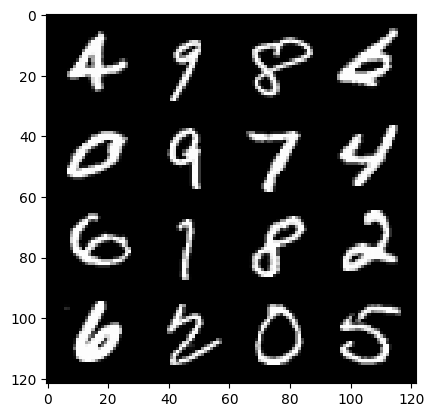

227: step 106800 / Gen loss 2.007390427986782 / Disc loss 0.27484852934877074


  0%|          | 0/469 [00:00<?, ?it/s]

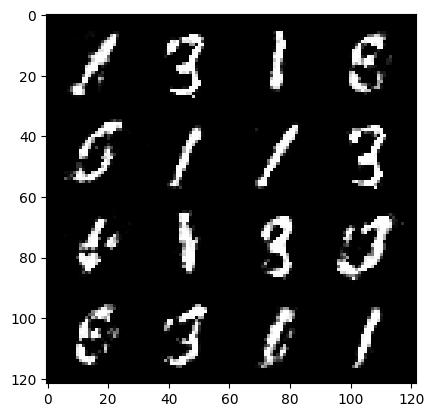

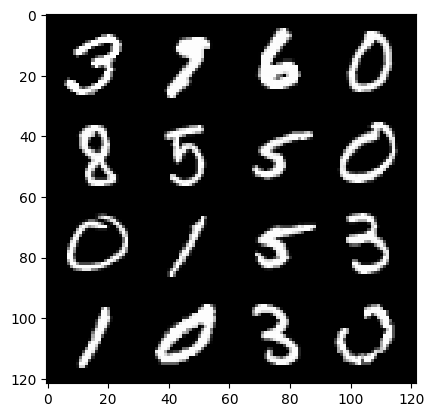

228: step 107100 / Gen loss 2.087986721992492 / Disc loss 0.26202490682403246


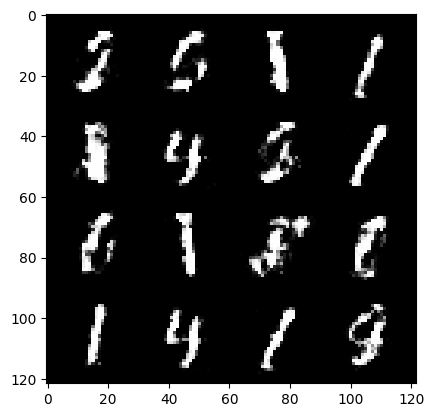

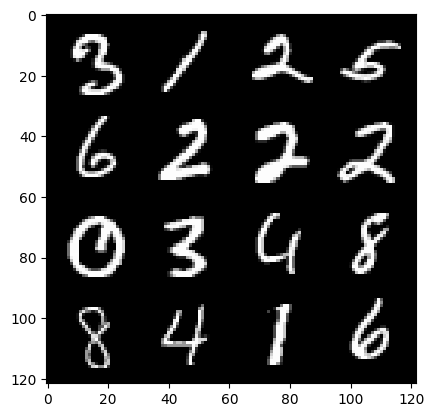

228: step 107400 / Gen loss 1.842954779068629 / Disc loss 0.3075264901916188


  0%|          | 0/469 [00:00<?, ?it/s]

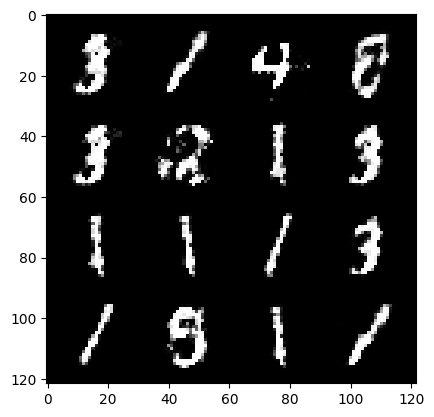

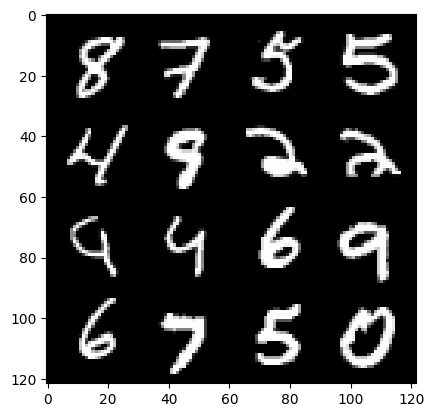

229: step 107700 / Gen loss 1.842405972480774 / Disc loss 0.3079048447310925


  0%|          | 0/469 [00:00<?, ?it/s]

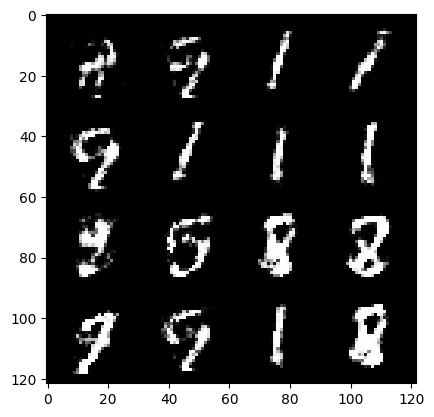

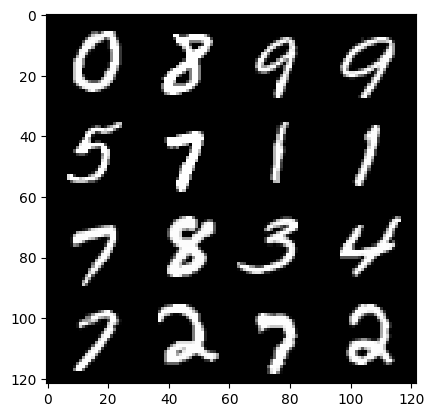

230: step 108000 / Gen loss 1.9148462148507435 / Disc loss 0.2814267316460608


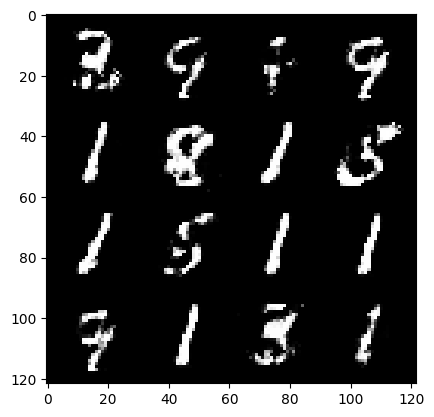

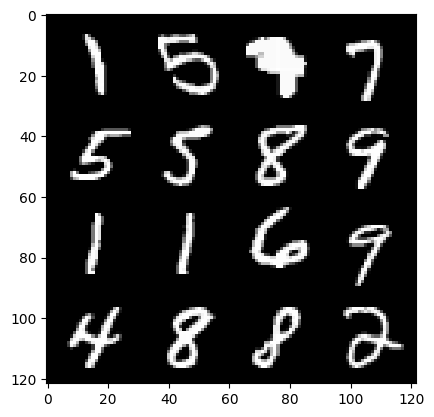

230: step 108300 / Gen loss 1.860316719611486 / Disc loss 0.2928253320356206


  0%|          | 0/469 [00:00<?, ?it/s]

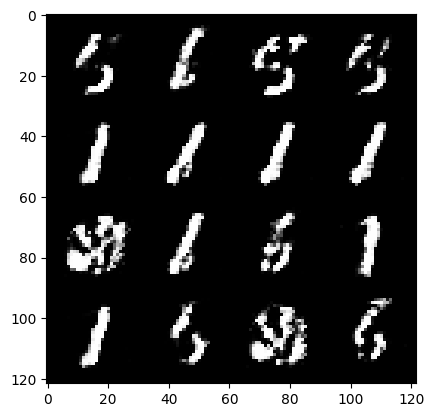

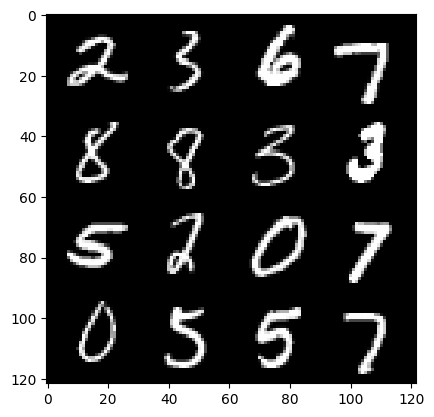

231: step 108600 / Gen loss 1.8597279989719384 / Disc loss 0.29538942441344274


  0%|          | 0/469 [00:00<?, ?it/s]

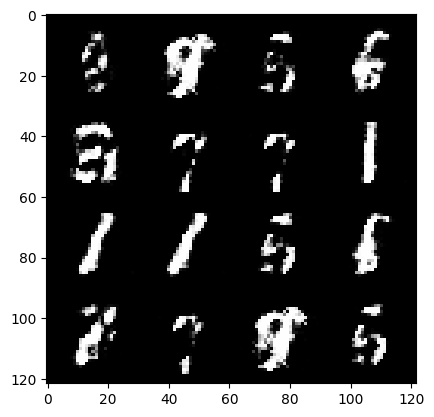

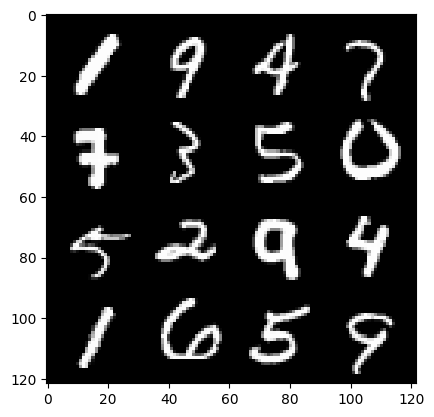

232: step 108900 / Gen loss 2.003291179339091 / Disc loss 0.26741205831368764


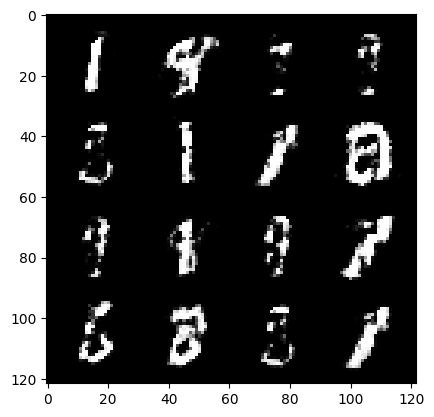

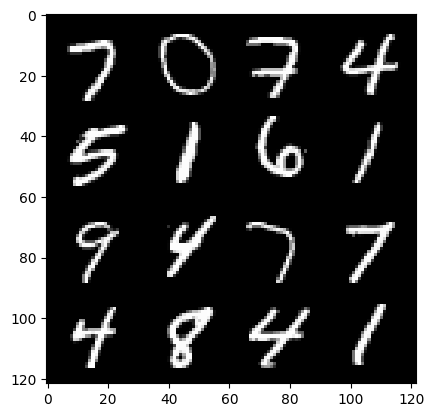

232: step 109200 / Gen loss 1.9068403287728632 / Disc loss 0.2868725912769635


  0%|          | 0/469 [00:00<?, ?it/s]

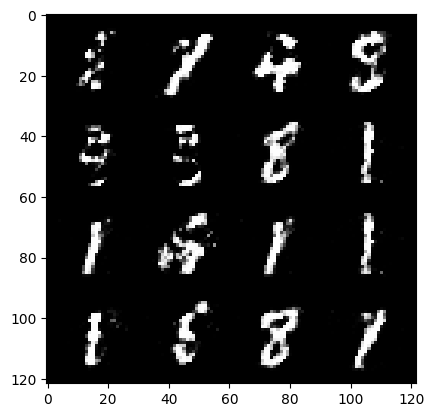

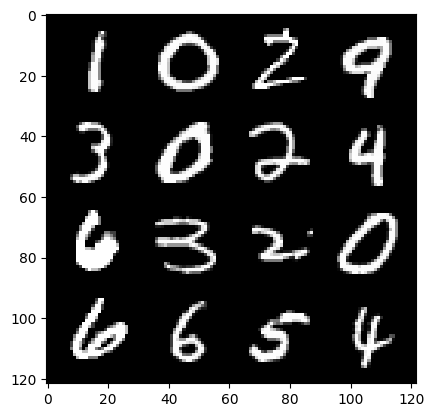

233: step 109500 / Gen loss 1.7569141952196756 / Disc loss 0.294236592501402


  0%|          | 0/469 [00:00<?, ?it/s]

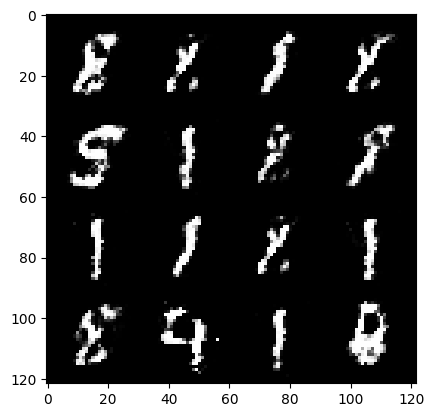

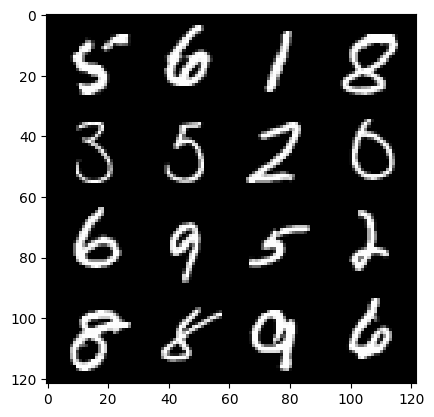

234: step 109800 / Gen loss 2.002414395014445 / Disc loss 0.27347067619363474


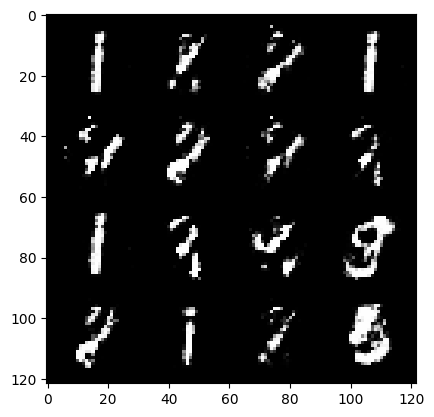

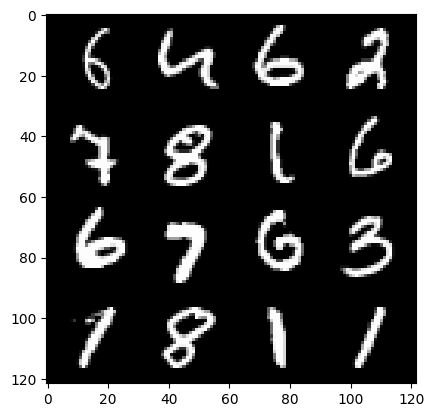

234: step 110100 / Gen loss 1.8502487361431113 / Disc loss 0.2872562231620151


  0%|          | 0/469 [00:00<?, ?it/s]

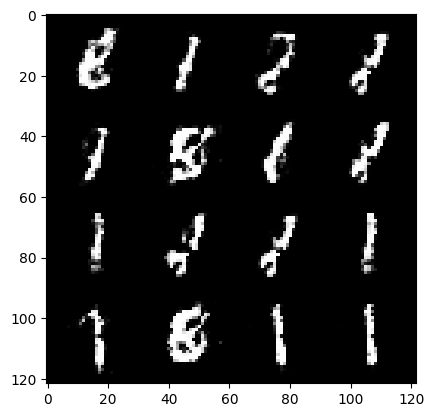

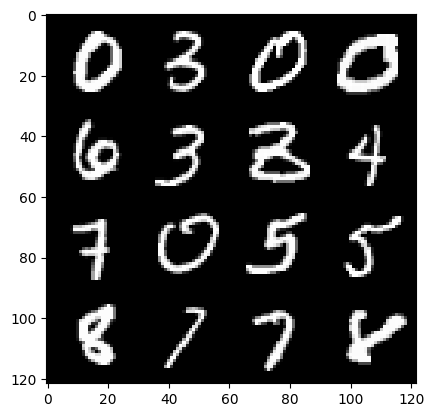

235: step 110400 / Gen loss 1.9558442076047269 / Disc loss 0.27623808835943525


  0%|          | 0/469 [00:00<?, ?it/s]

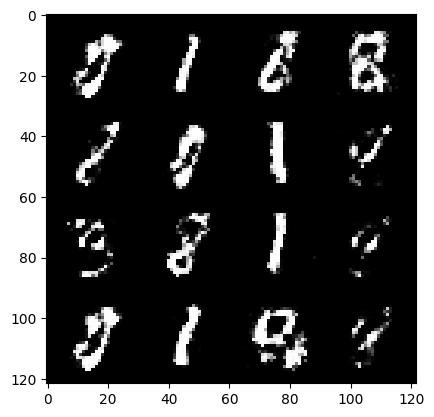

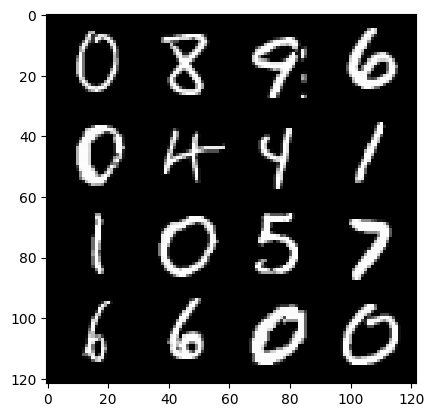

236: step 110700 / Gen loss 1.9968014462788914 / Disc loss 0.26928384572267533


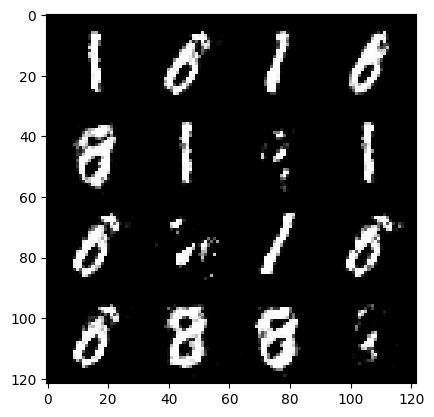

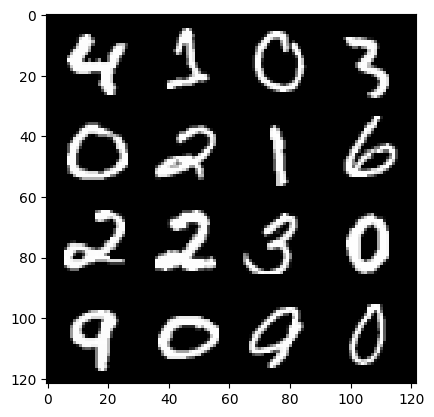

236: step 111000 / Gen loss 1.9757895338535296 / Disc loss 0.2777853823701539


  0%|          | 0/469 [00:00<?, ?it/s]

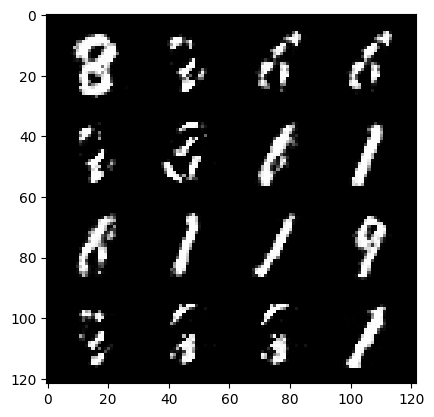

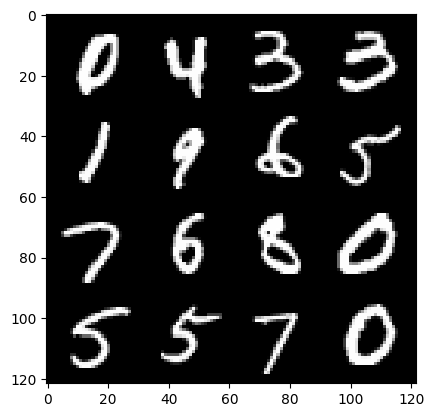

237: step 111300 / Gen loss 1.8094524117310844 / Disc loss 0.2934594409167766


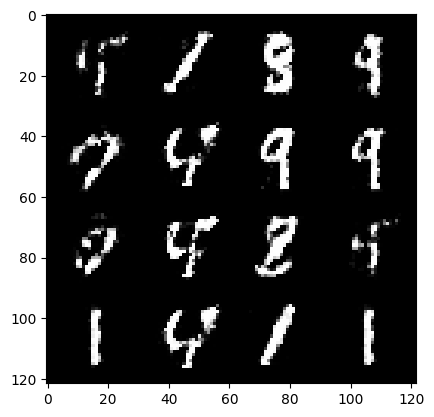

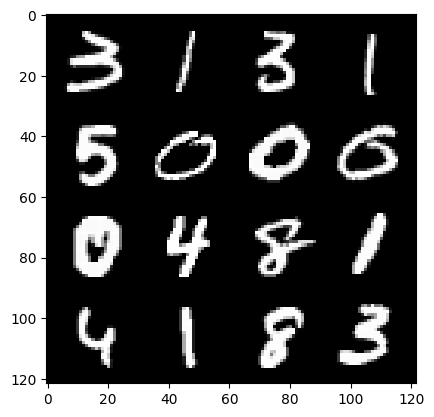

237: step 111600 / Gen loss 1.8881024575233454 / Disc loss 0.28467251072327304


  0%|          | 0/469 [00:00<?, ?it/s]

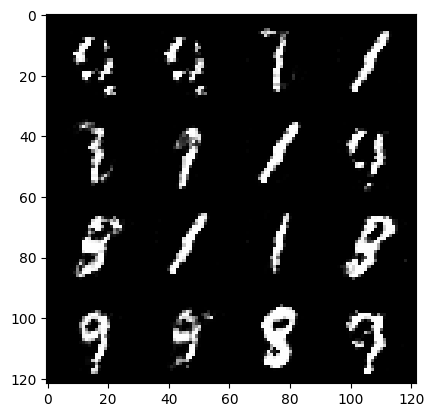

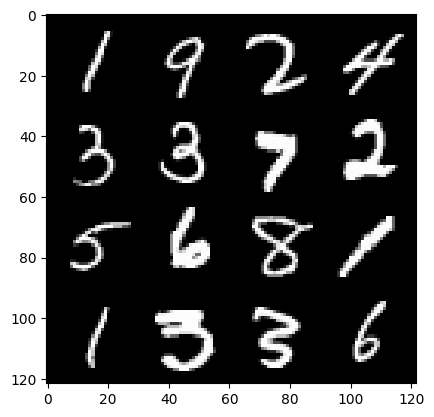

238: step 111900 / Gen loss 1.917466938495636 / Disc loss 0.2811715427537761


  0%|          | 0/469 [00:00<?, ?it/s]

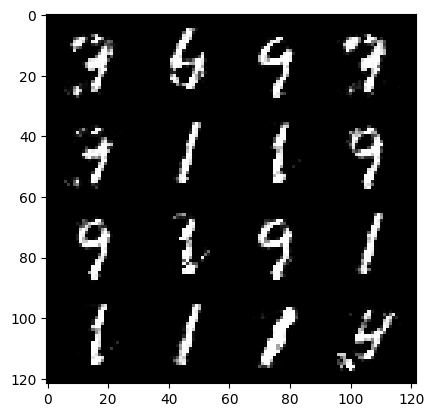

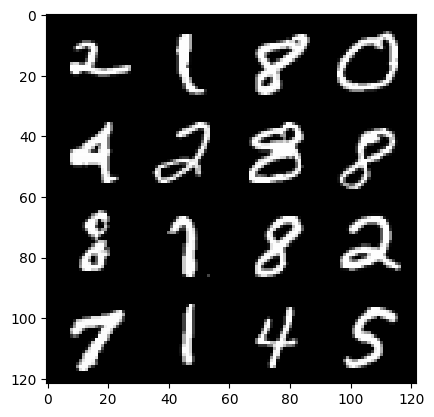

239: step 112200 / Gen loss 1.9006569349765783 / Disc loss 0.28797596991062163


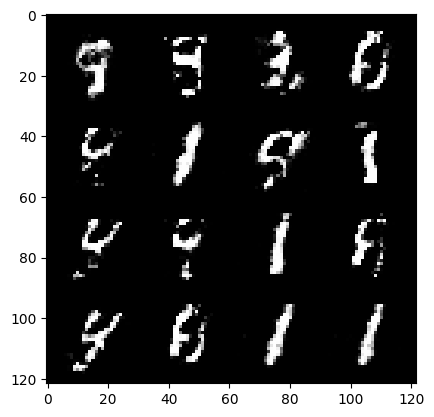

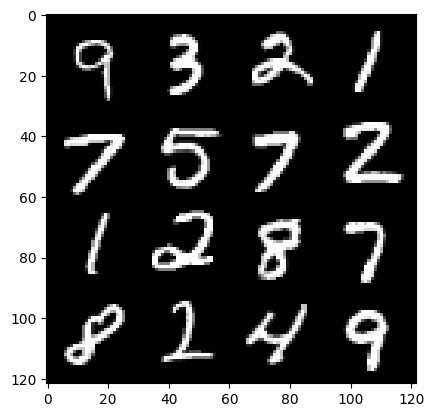

239: step 112500 / Gen loss 1.9719273646672566 / Disc loss 0.26587517693638796


  0%|          | 0/469 [00:00<?, ?it/s]

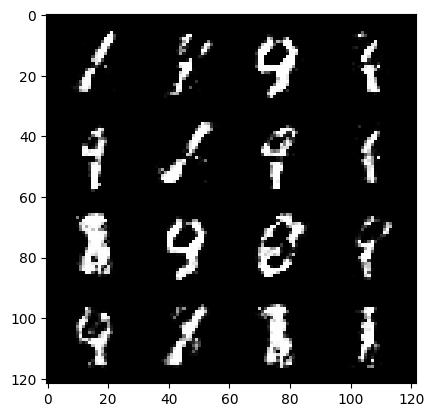

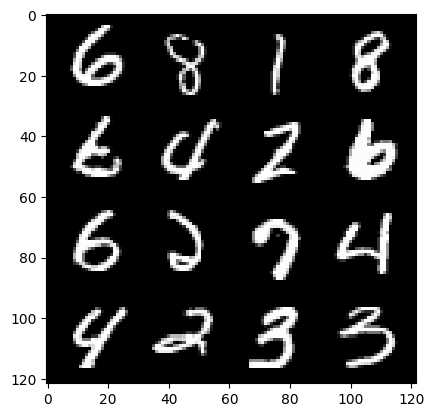

240: step 112800 / Gen loss 2.018726217349369 / Disc loss 0.25369894857207936


  0%|          | 0/469 [00:00<?, ?it/s]

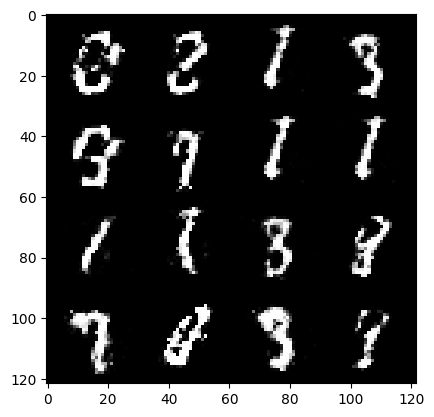

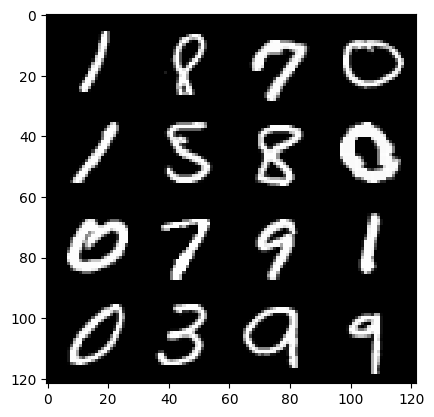

241: step 113100 / Gen loss 1.9861876022815708 / Disc loss 0.2741696162025133


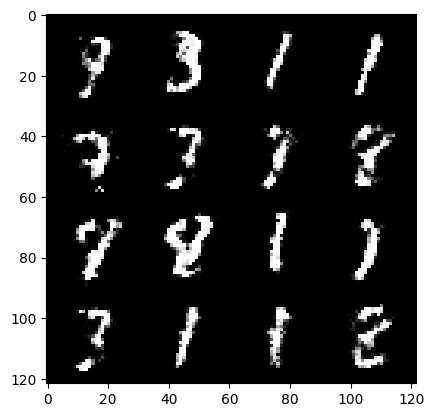

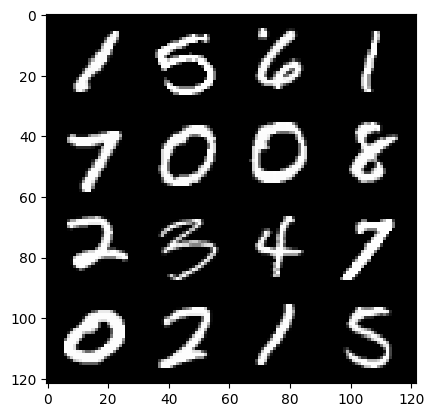

241: step 113400 / Gen loss 2.001579521099726 / Disc loss 0.2572594131032625


  0%|          | 0/469 [00:00<?, ?it/s]

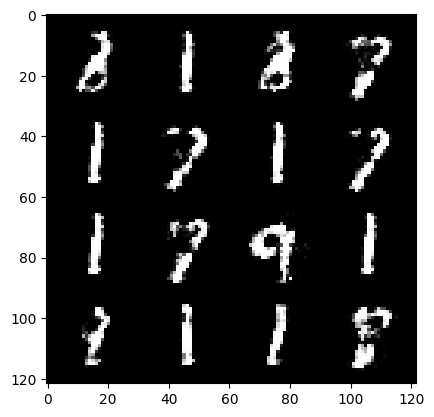

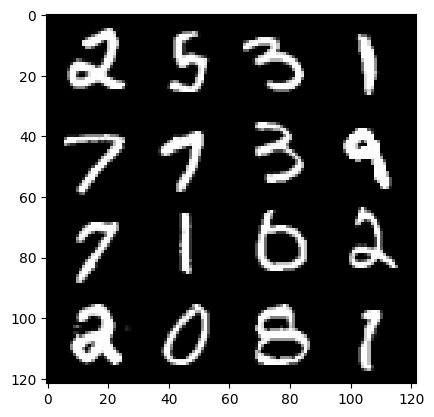

242: step 113700 / Gen loss 1.998980285724003 / Disc loss 0.2831551957627137


  0%|          | 0/469 [00:00<?, ?it/s]

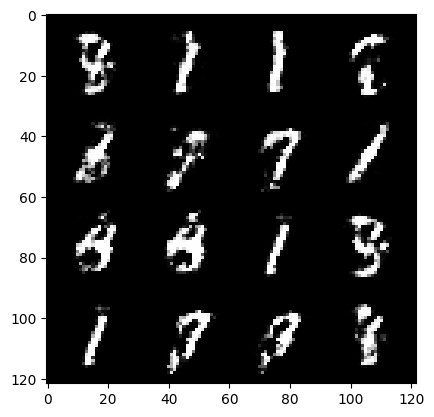

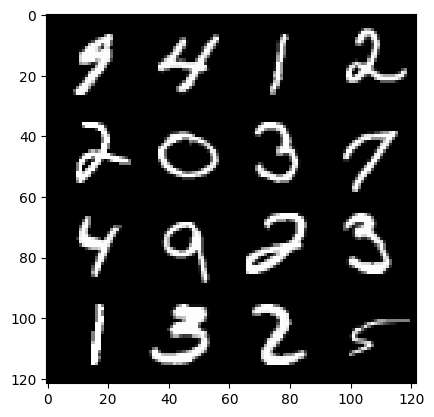

243: step 114000 / Gen loss 1.8128062860170997 / Disc loss 0.30232098023096715


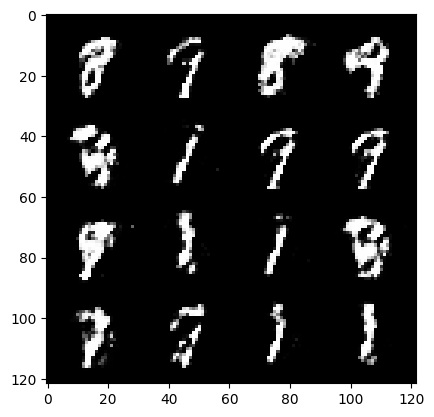

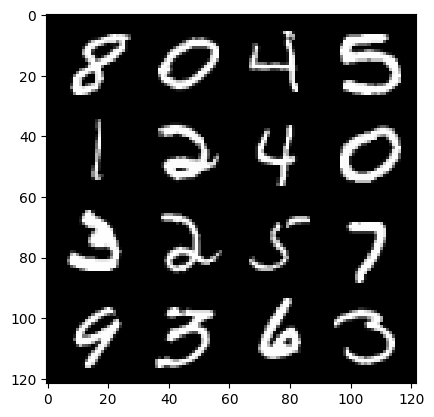

243: step 114300 / Gen loss 1.8131930255889894 / Disc loss 0.3024378428856531


  0%|          | 0/469 [00:00<?, ?it/s]

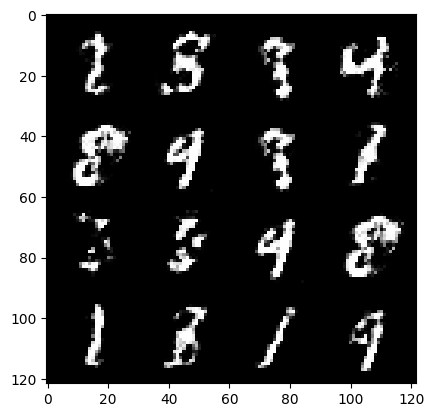

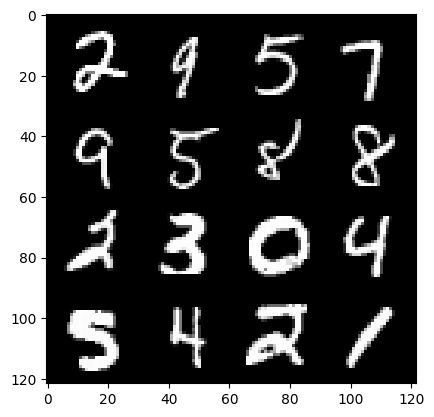

244: step 114600 / Gen loss 1.7756354097525286 / Disc loss 0.3015377646684645


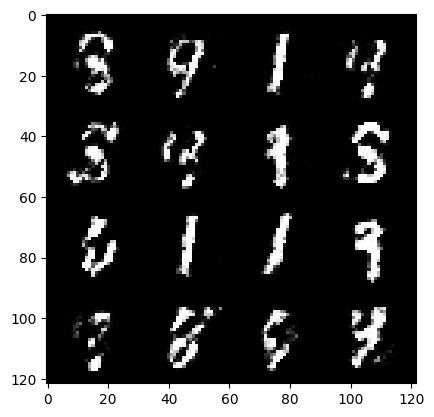

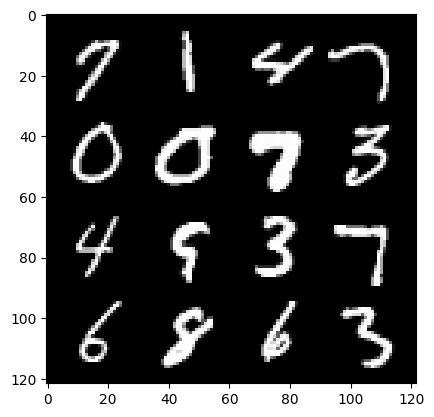

244: step 114900 / Gen loss 1.8198499250411984 / Disc loss 0.2934498890240989


  0%|          | 0/469 [00:00<?, ?it/s]

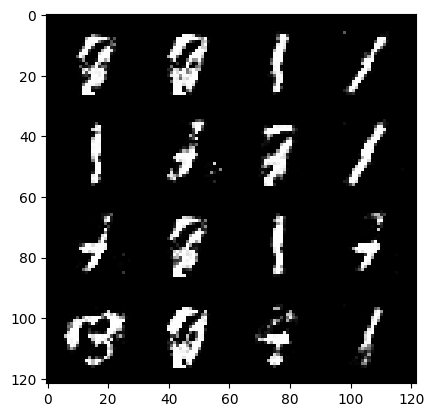

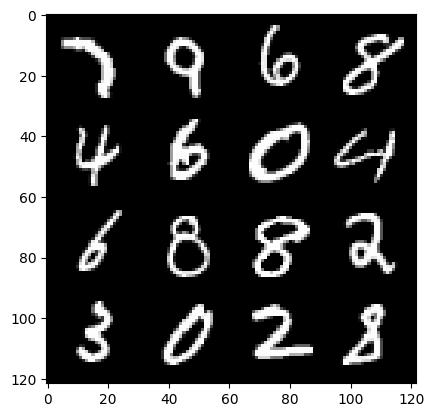

245: step 115200 / Gen loss 1.9870866672197987 / Disc loss 0.27435053904851264


  0%|          | 0/469 [00:00<?, ?it/s]

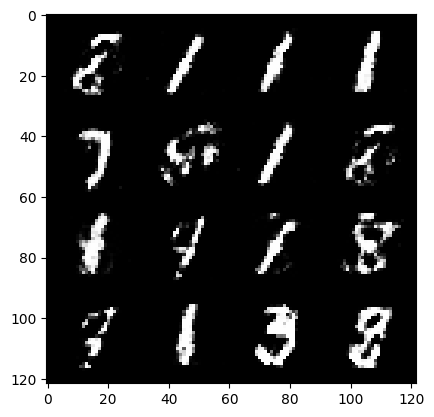

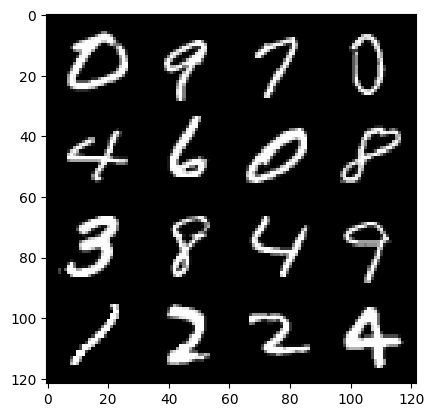

246: step 115500 / Gen loss 1.9019017529487625 / Disc loss 0.2866151719292005


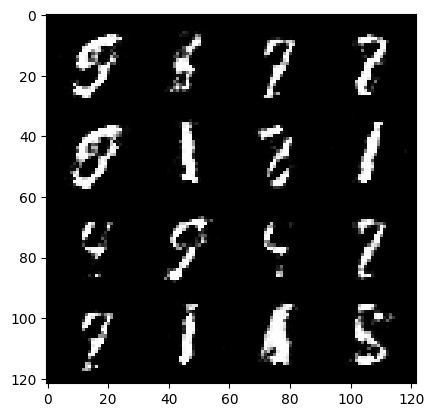

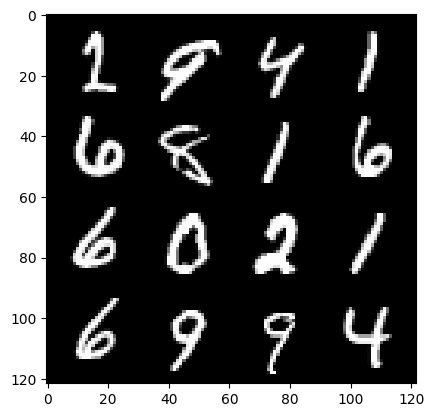

246: step 115800 / Gen loss 1.8070975569884 / Disc loss 0.3020893292129041


  0%|          | 0/469 [00:00<?, ?it/s]

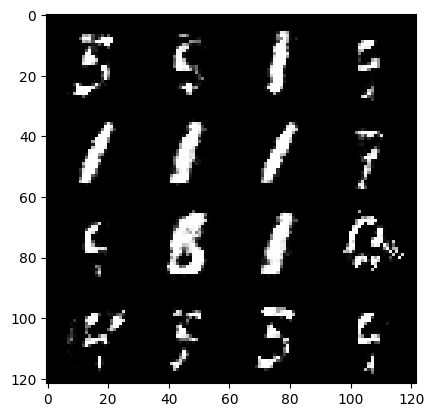

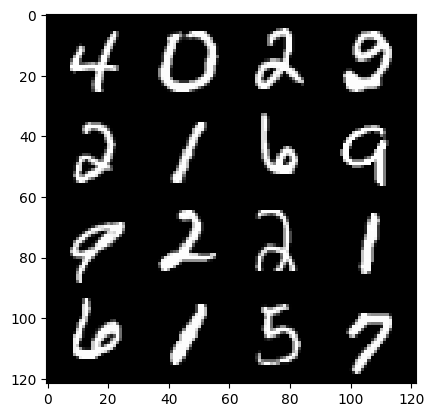

247: step 116100 / Gen loss 1.850730560620626 / Disc loss 0.28636200264096245


  0%|          | 0/469 [00:00<?, ?it/s]

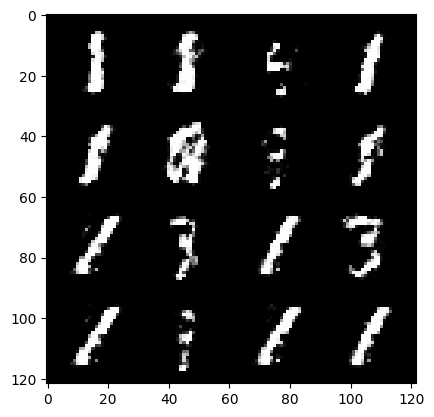

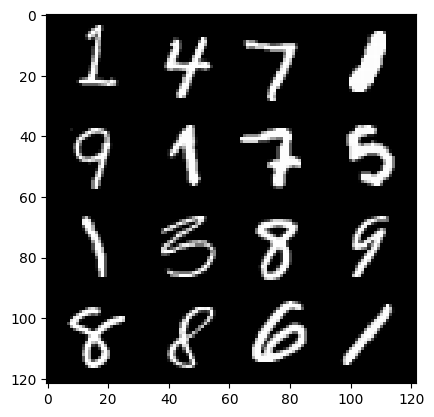

248: step 116400 / Gen loss 1.8718196030457814 / Disc loss 0.2713812162478766


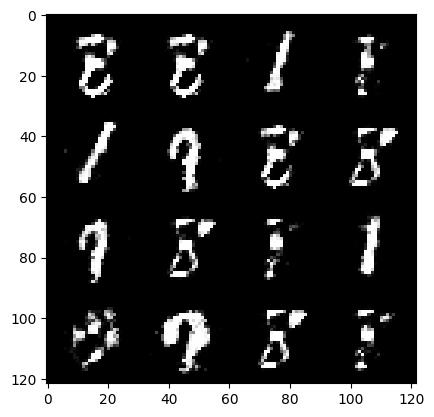

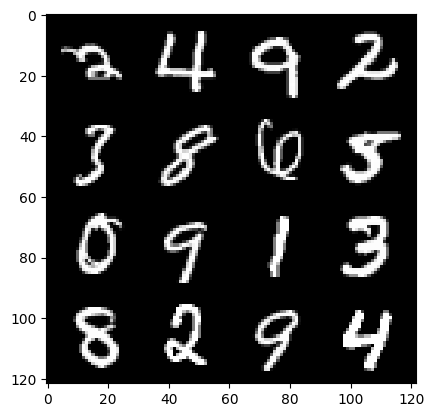

248: step 116700 / Gen loss 1.7937357858816785 / Disc loss 0.28630205884575843


  0%|          | 0/469 [00:00<?, ?it/s]

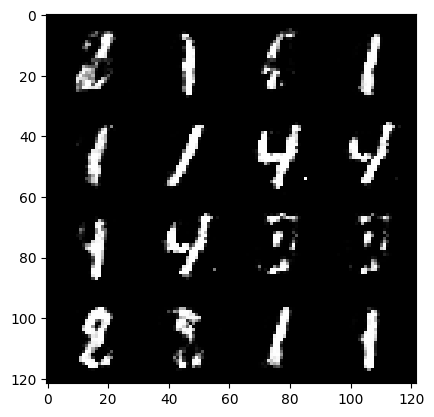

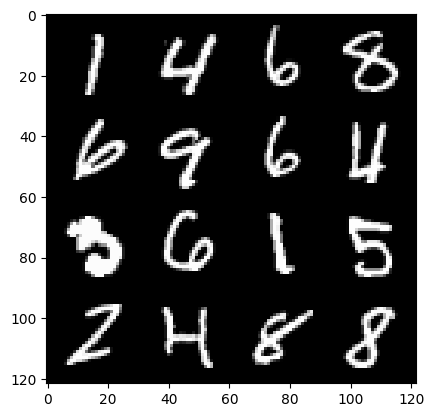

249: step 117000 / Gen loss 1.8037684317429856 / Disc loss 0.29623089517156276


  0%|          | 0/469 [00:00<?, ?it/s]

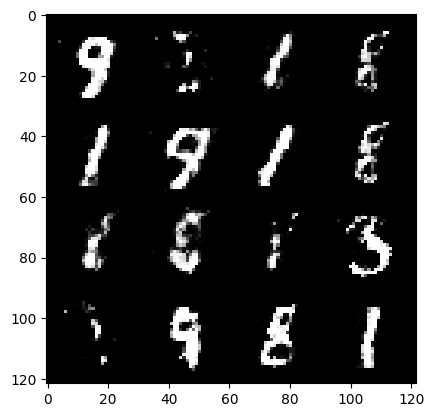

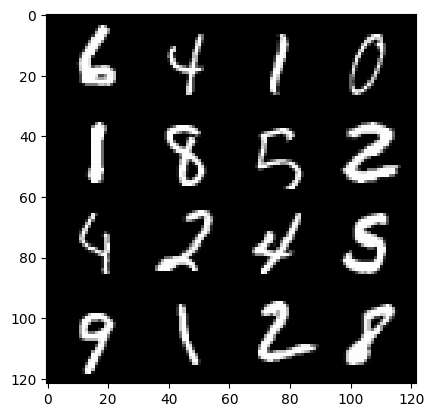

250: step 117300 / Gen loss 1.6661023390293122 / Disc loss 0.3169817447662355


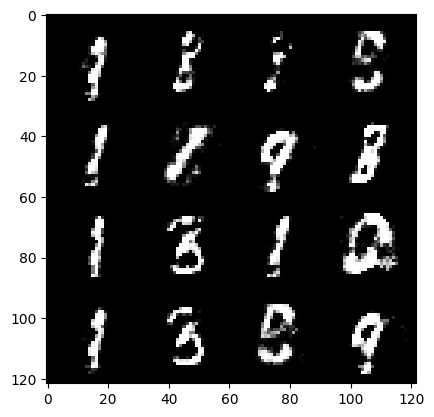

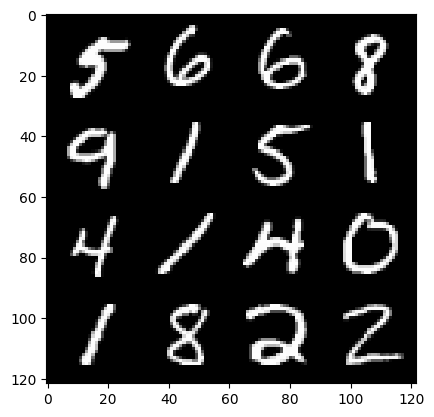

250: step 117600 / Gen loss 1.8075205409526842 / Disc loss 0.2883330948650838


  0%|          | 0/469 [00:00<?, ?it/s]

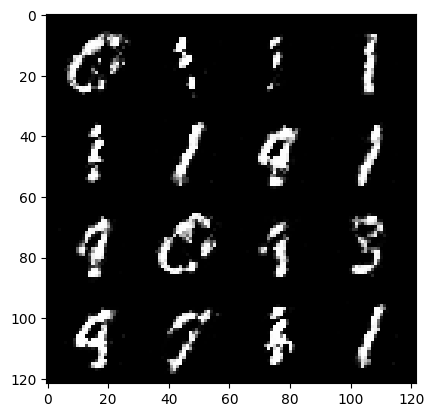

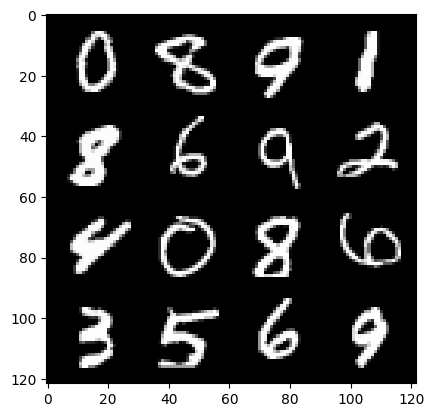

251: step 117900 / Gen loss 1.9823418052991222 / Disc loss 0.26210927307605725


  0%|          | 0/469 [00:00<?, ?it/s]

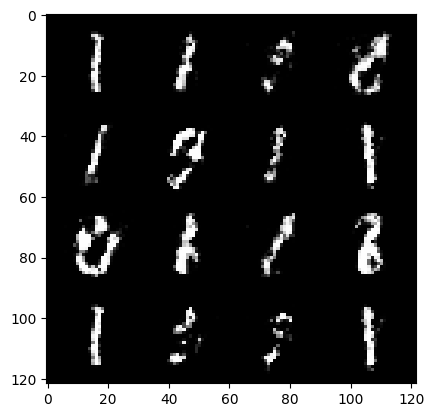

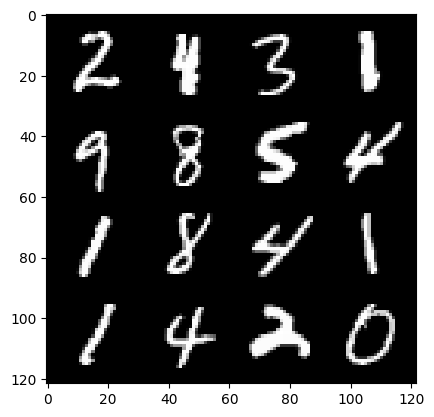

252: step 118200 / Gen loss 1.9022005307674406 / Disc loss 0.2776275889575481


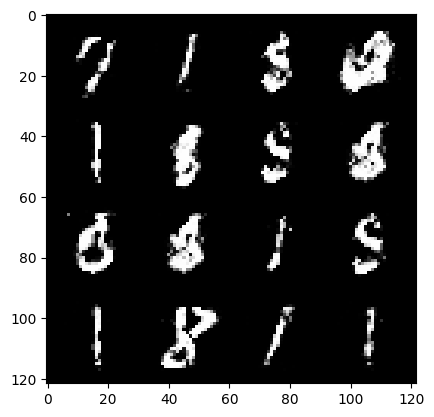

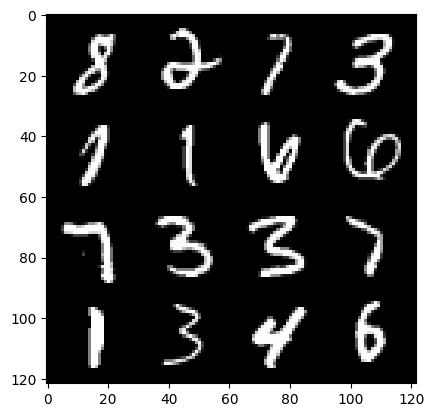

252: step 118500 / Gen loss 1.7127790999412538 / Disc loss 0.3127945357561109


  0%|          | 0/469 [00:00<?, ?it/s]

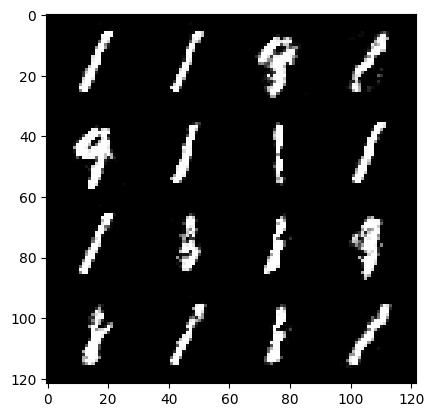

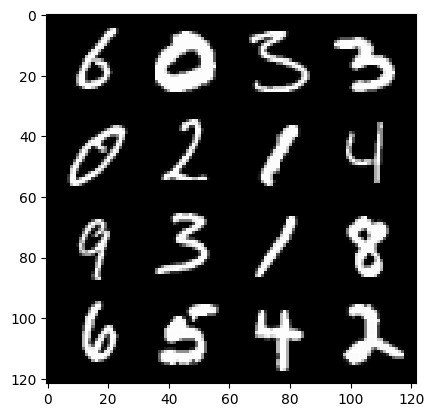

253: step 118800 / Gen loss 1.700305330355962 / Disc loss 0.32319993292291954


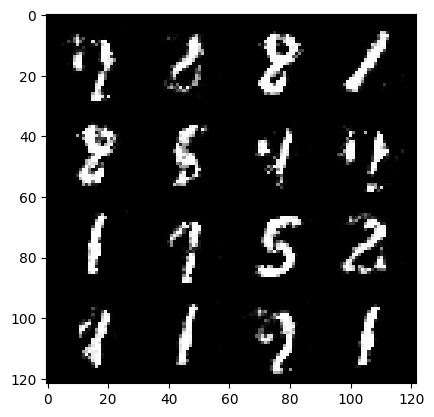

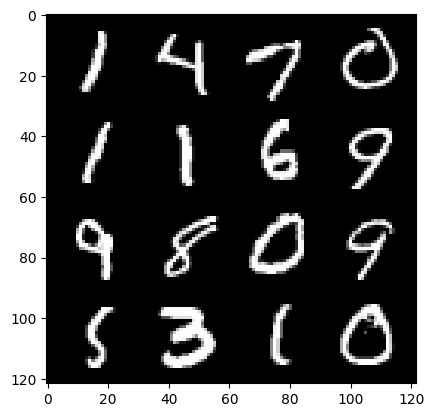

253: step 119100 / Gen loss 1.9975740265846245 / Disc loss 0.28805860633651403


  0%|          | 0/469 [00:00<?, ?it/s]

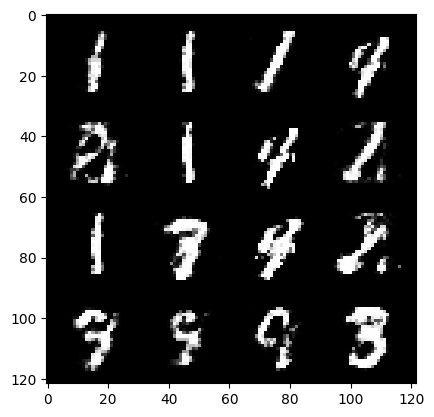

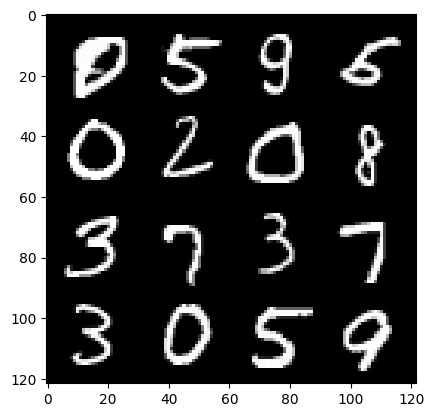

254: step 119400 / Gen loss 1.781266771952313 / Disc loss 0.3310455298423765


  0%|          | 0/469 [00:00<?, ?it/s]

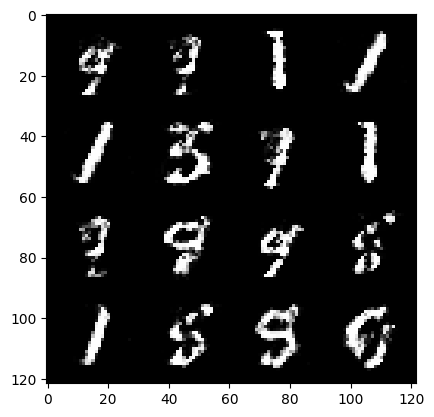

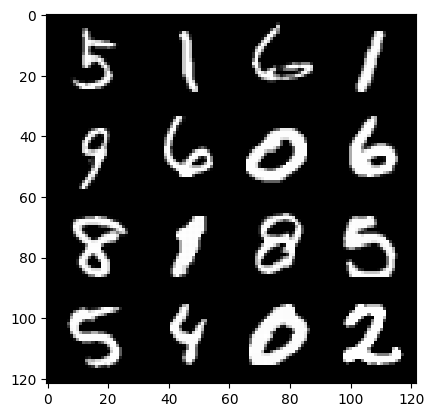

255: step 119700 / Gen loss 1.7685581370194758 / Disc loss 0.3098316697776317


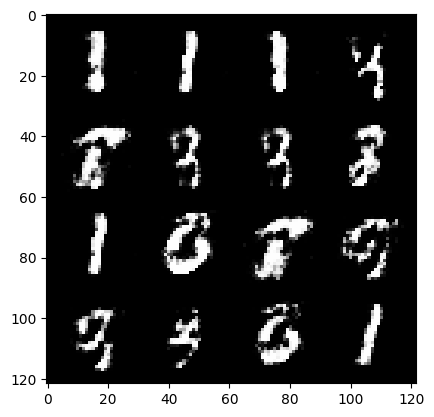

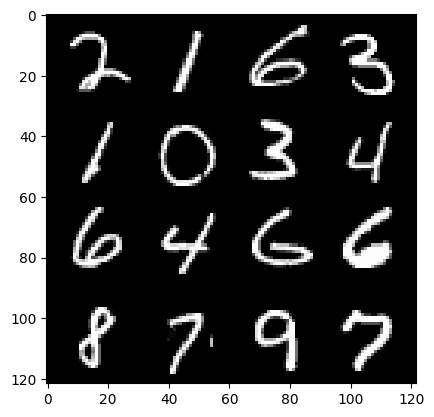

255: step 120000 / Gen loss 1.9725138088067362 / Disc loss 0.2750094808638095


  0%|          | 0/469 [00:00<?, ?it/s]

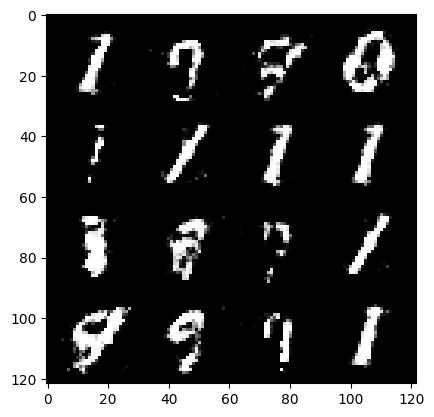

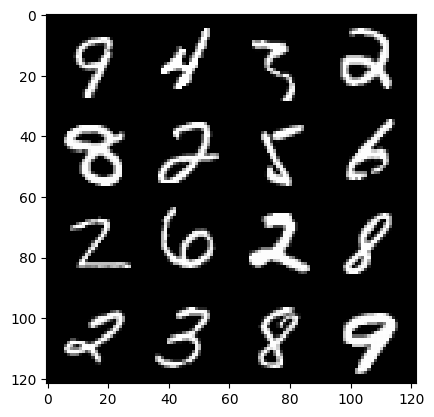

256: step 120300 / Gen loss 1.8909728248914066 / Disc loss 0.28721497088670733


  0%|          | 0/469 [00:00<?, ?it/s]

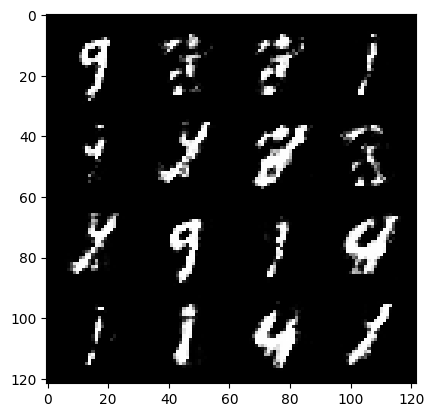

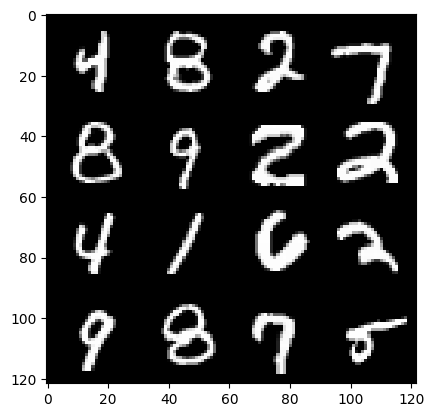

257: step 120600 / Gen loss 1.8394830513000477 / Disc loss 0.28796198378006593


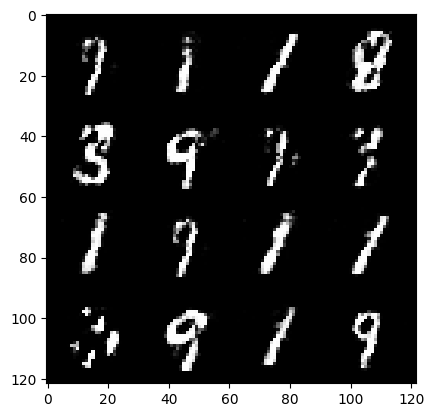

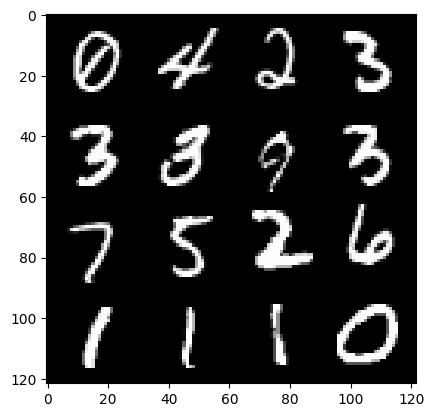

257: step 120900 / Gen loss 1.919900158643722 / Disc loss 0.2751714177926381


  0%|          | 0/469 [00:00<?, ?it/s]

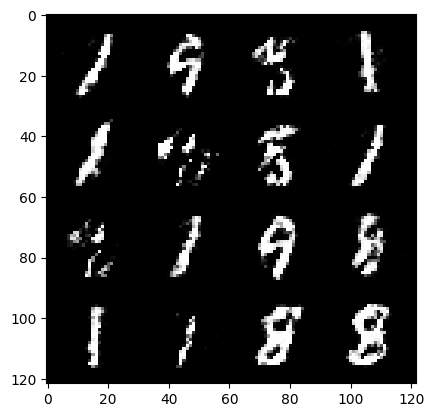

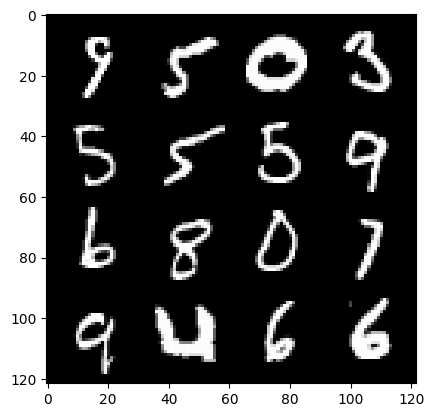

258: step 121200 / Gen loss 1.853689020077387 / Disc loss 0.2737592933078607


  0%|          | 0/469 [00:00<?, ?it/s]

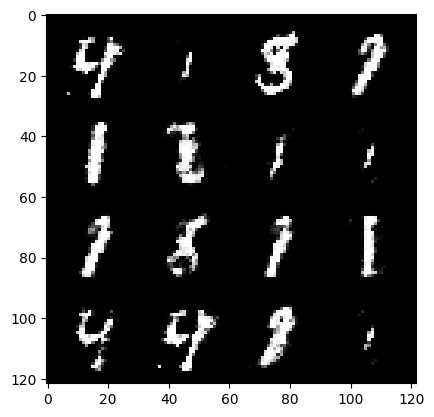

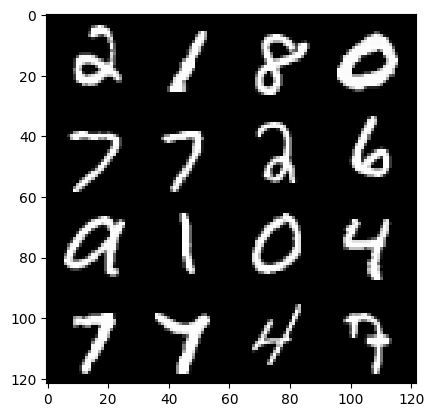

259: step 121500 / Gen loss 1.8630859887599933 / Disc loss 0.2738069328665735


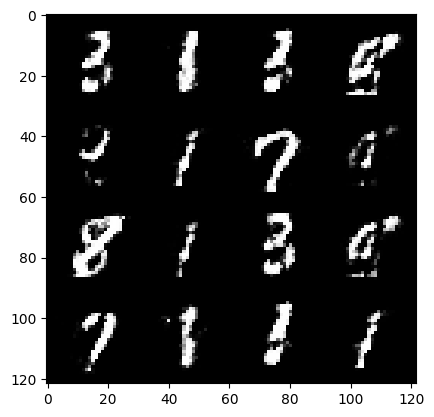

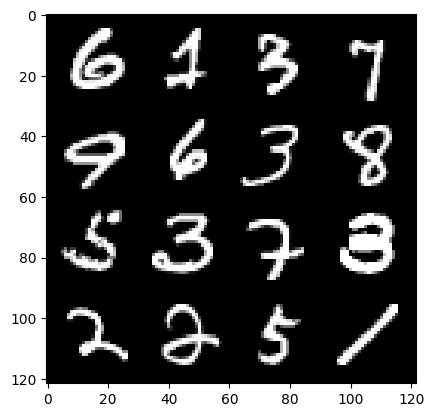

259: step 121800 / Gen loss 1.9688531680901855 / Disc loss 0.26664380684494965


  0%|          | 0/469 [00:00<?, ?it/s]

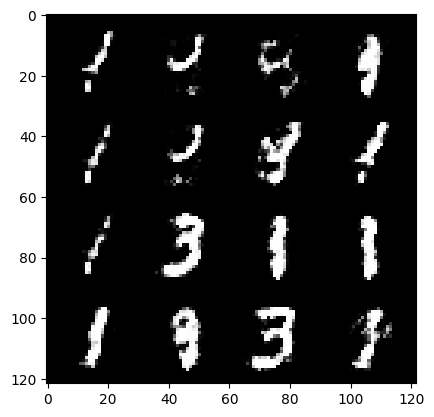

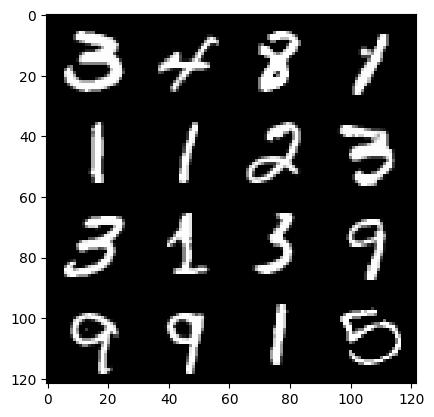

260: step 122100 / Gen loss 1.8353212960561112 / Disc loss 0.29432445123791695


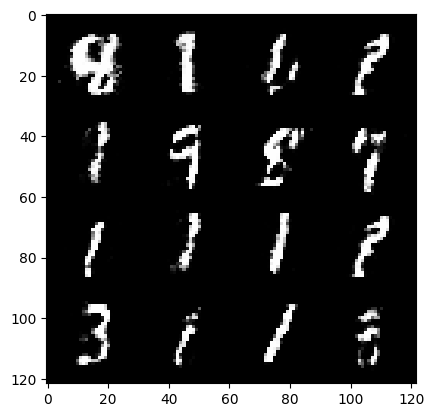

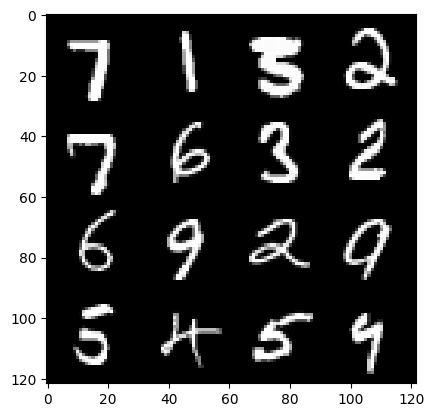

260: step 122400 / Gen loss 2.0055293869972233 / Disc loss 0.254358383913835


  0%|          | 0/469 [00:00<?, ?it/s]

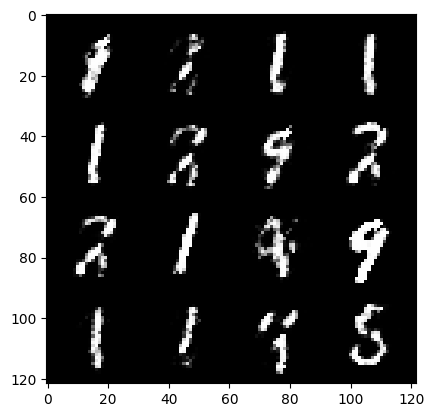

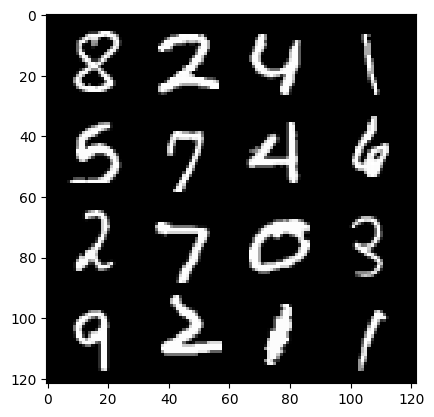

261: step 122700 / Gen loss 1.9641345894336706 / Disc loss 0.27497867082556054


  0%|          | 0/469 [00:00<?, ?it/s]

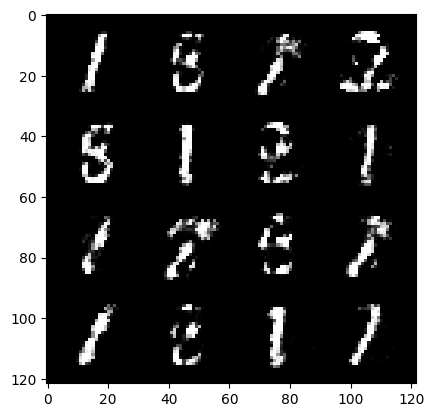

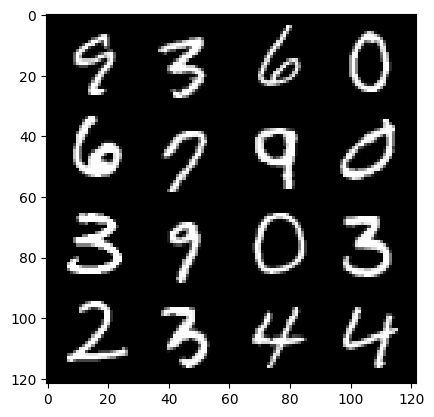

262: step 123000 / Gen loss 1.788735972245533 / Disc loss 0.2836055208742618


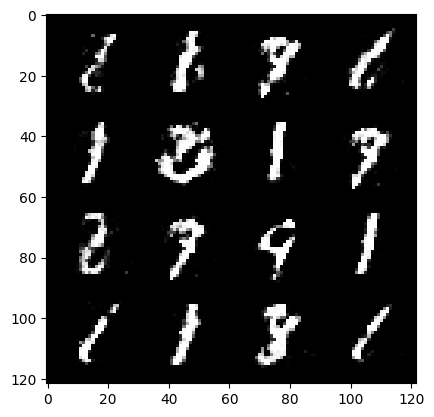

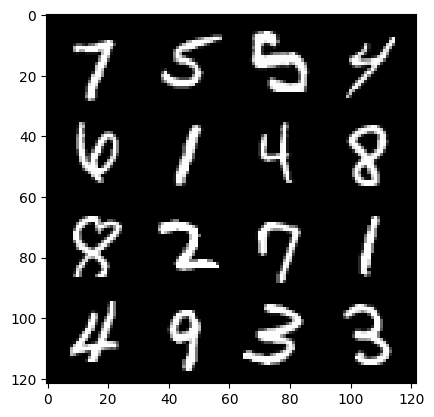

262: step 123300 / Gen loss 1.9459690125783287 / Disc loss 0.27383604750037205


  0%|          | 0/469 [00:00<?, ?it/s]

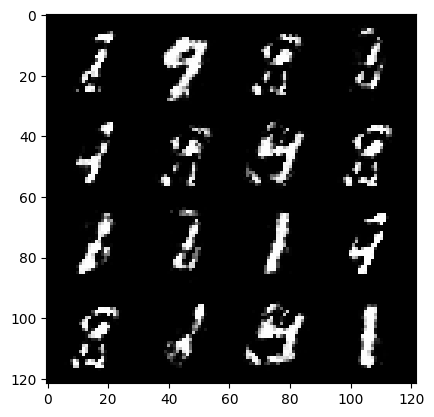

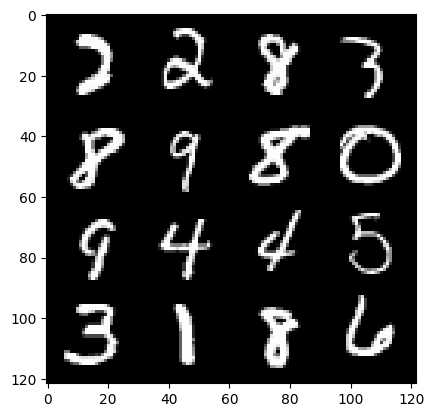

263: step 123600 / Gen loss 1.9226765493551896 / Disc loss 0.28225623846054054


  0%|          | 0/469 [00:00<?, ?it/s]

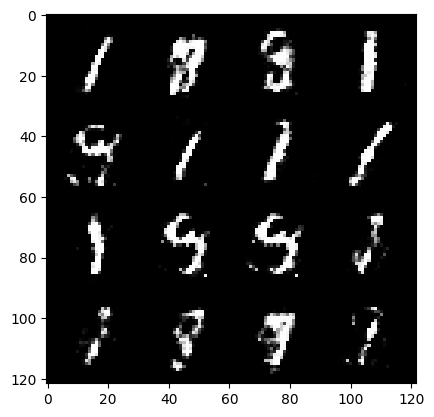

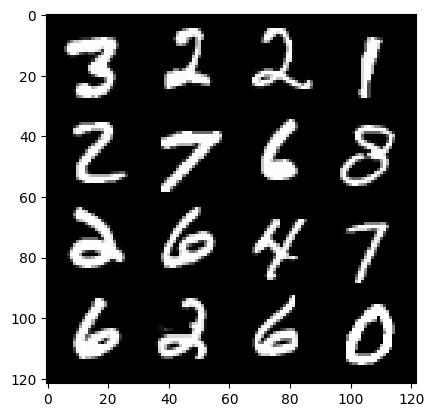

264: step 123900 / Gen loss 2.0375262399514527 / Disc loss 0.2533702452977499


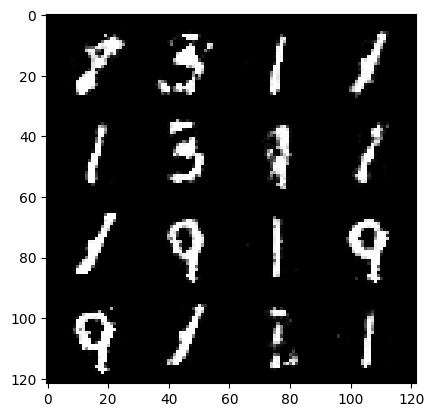

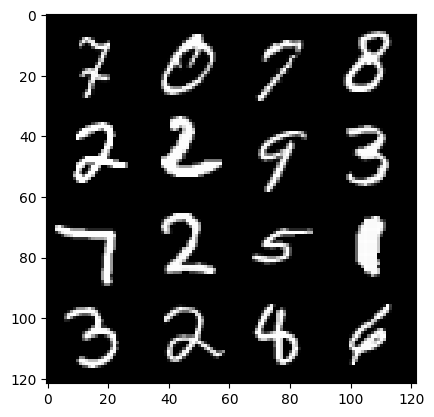

264: step 124200 / Gen loss 1.900465906858445 / Disc loss 0.2823374349872273


  0%|          | 0/469 [00:00<?, ?it/s]

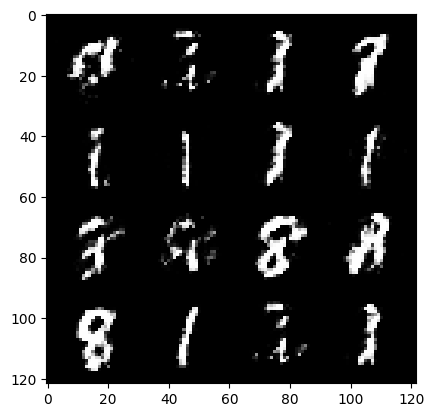

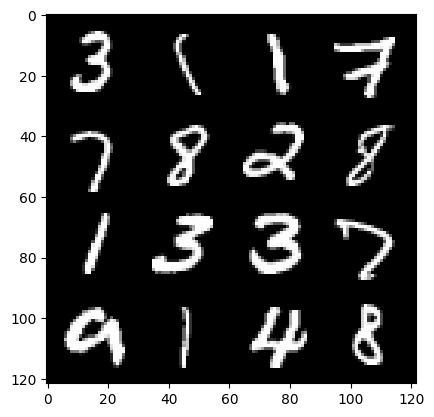

265: step 124500 / Gen loss 1.8843332505226134 / Disc loss 0.2945126044253506


  0%|          | 0/469 [00:00<?, ?it/s]

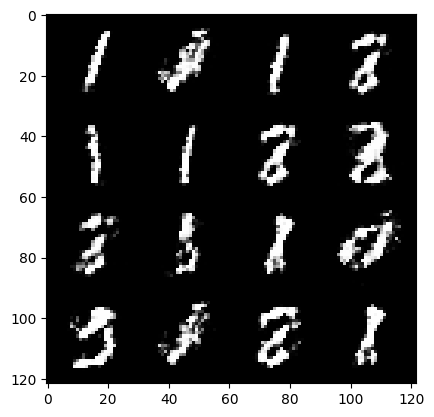

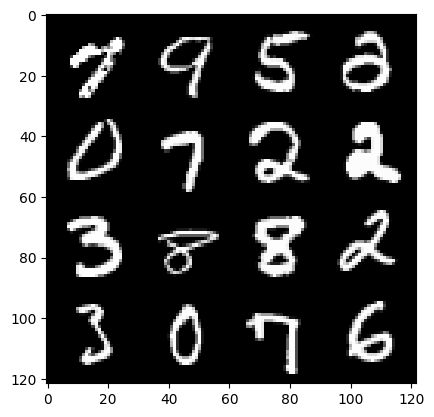

266: step 124800 / Gen loss 1.8703110682964326 / Disc loss 0.2912662491699062


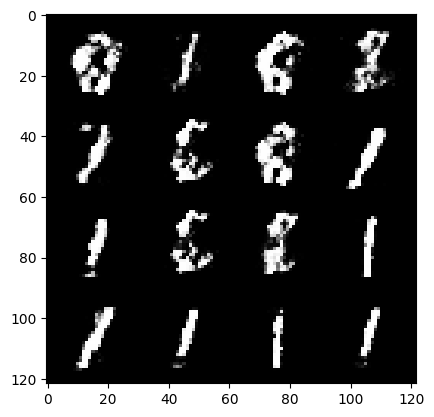

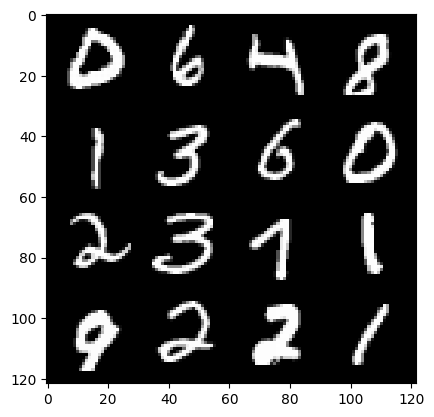

266: step 125100 / Gen loss 1.7911206944783533 / Disc loss 0.3089128562808039


  0%|          | 0/469 [00:00<?, ?it/s]

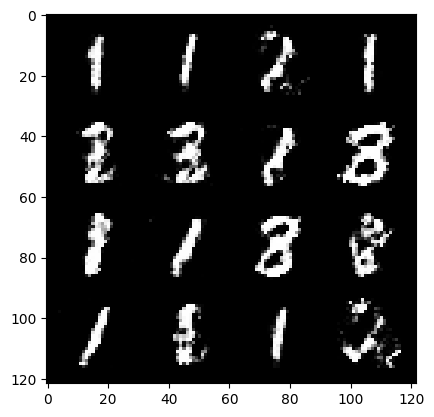

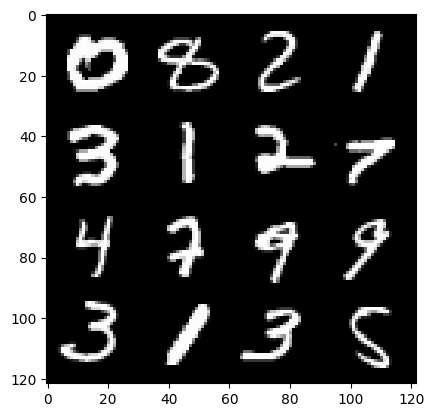

267: step 125400 / Gen loss 1.714250264962514 / Disc loss 0.32126368512709924


  0%|          | 0/469 [00:00<?, ?it/s]

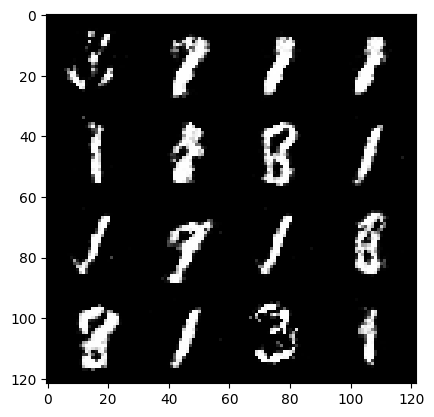

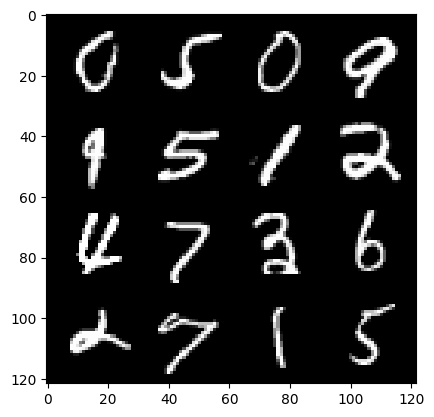

268: step 125700 / Gen loss 1.765151053269704 / Disc loss 0.2949361483256023


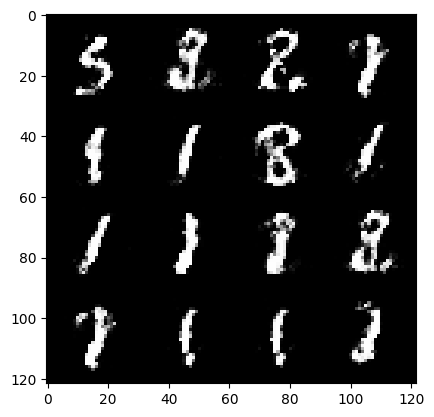

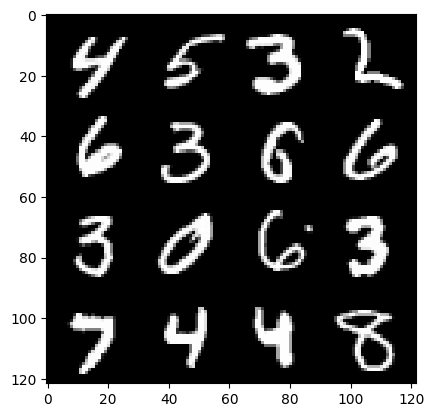

268: step 126000 / Gen loss 1.9758354008197785 / Disc loss 0.2586448952058951


  0%|          | 0/469 [00:00<?, ?it/s]

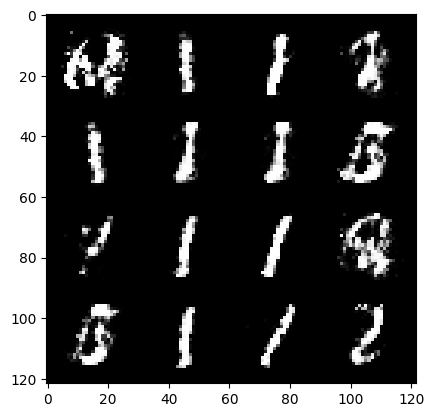

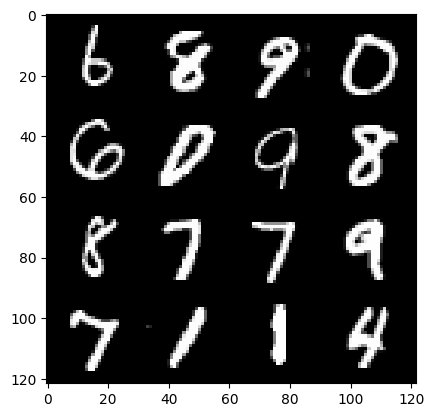

269: step 126300 / Gen loss 2.091156143347421 / Disc loss 0.25389242385824534


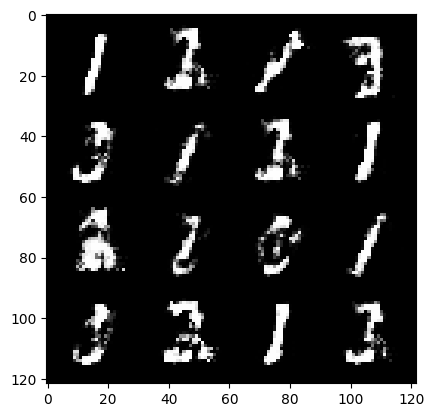

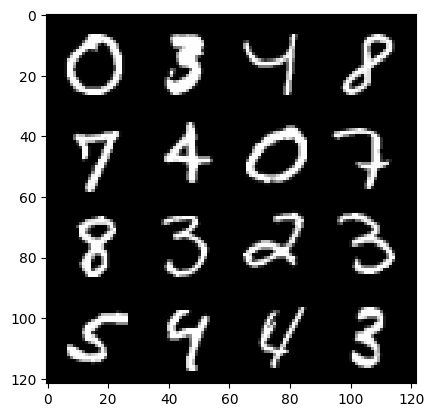

269: step 126600 / Gen loss 1.9174331104755398 / Disc loss 0.29710233236352596


  0%|          | 0/469 [00:00<?, ?it/s]

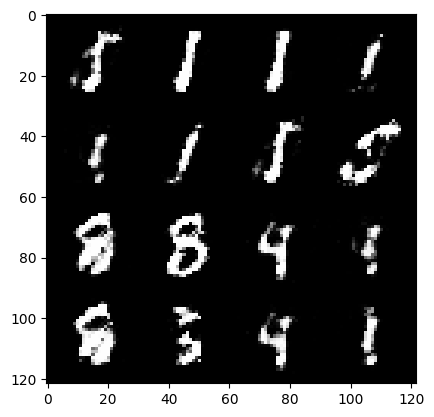

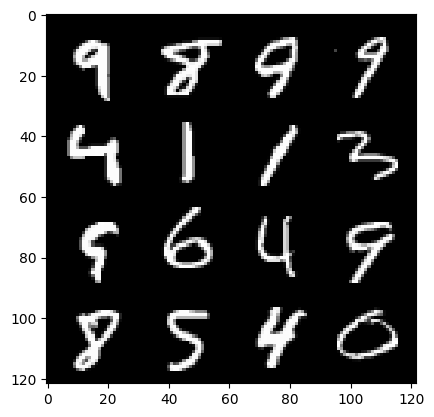

270: step 126900 / Gen loss 1.9361046357949585 / Disc loss 0.27205806309978176


  0%|          | 0/469 [00:00<?, ?it/s]

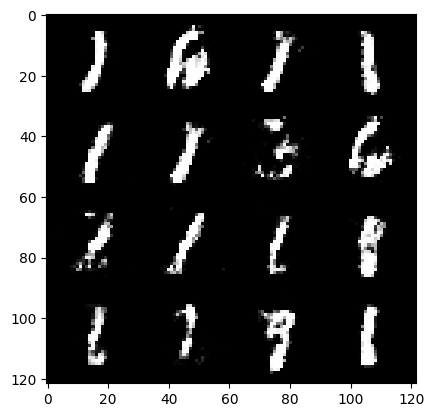

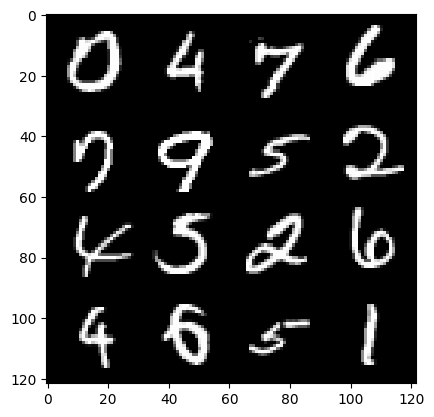

271: step 127200 / Gen loss 1.9578456942240399 / Disc loss 0.29381098523735993


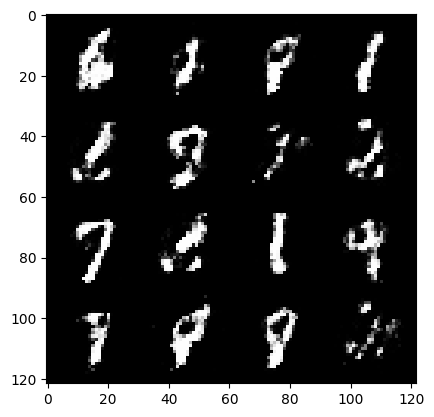

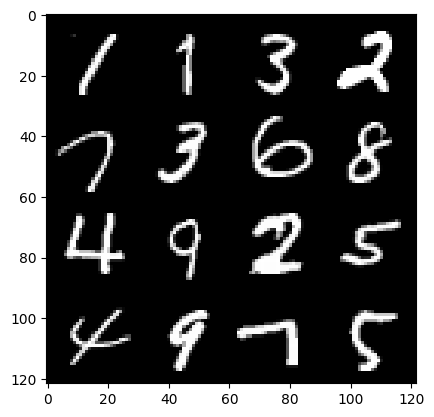

271: step 127500 / Gen loss 1.8768012452125549 / Disc loss 0.2836953442295391


  0%|          | 0/469 [00:00<?, ?it/s]

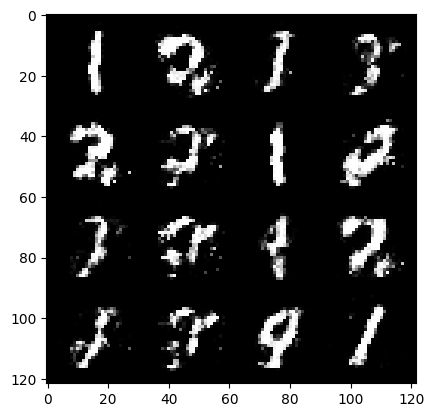

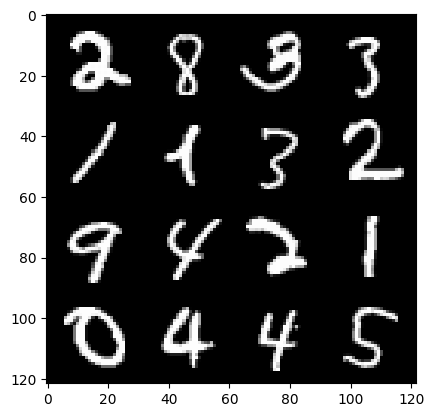

272: step 127800 / Gen loss 2.007433089415232 / Disc loss 0.2723698999484379


  0%|          | 0/469 [00:00<?, ?it/s]

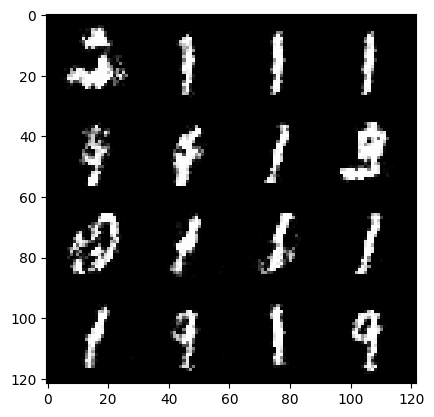

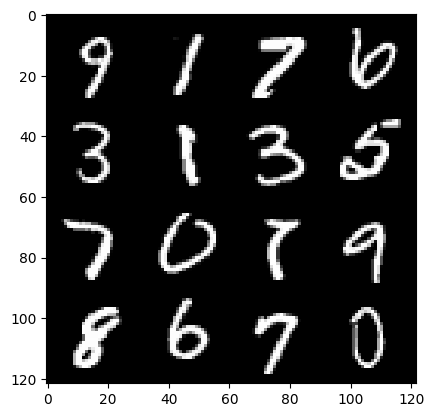

273: step 128100 / Gen loss 2.012475456396739 / Disc loss 0.2737295703093213


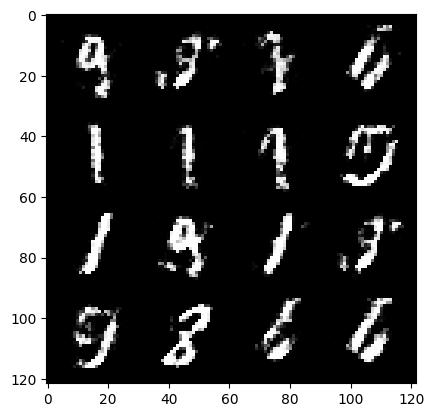

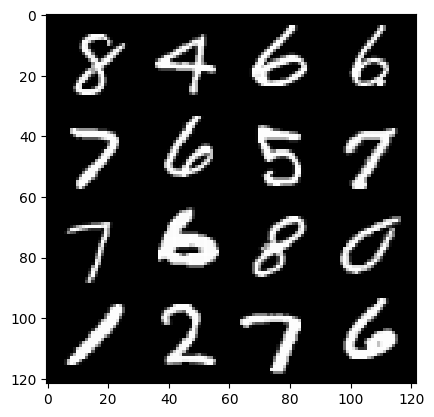

273: step 128400 / Gen loss 2.0079761791229256 / Disc loss 0.27430280586083716


  0%|          | 0/469 [00:00<?, ?it/s]

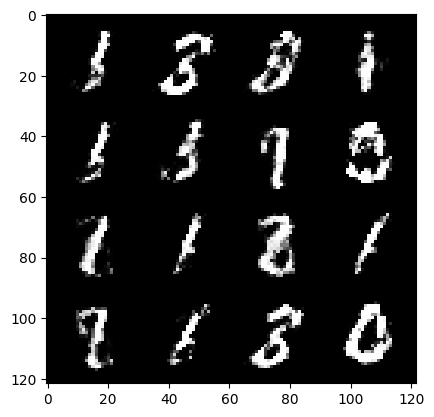

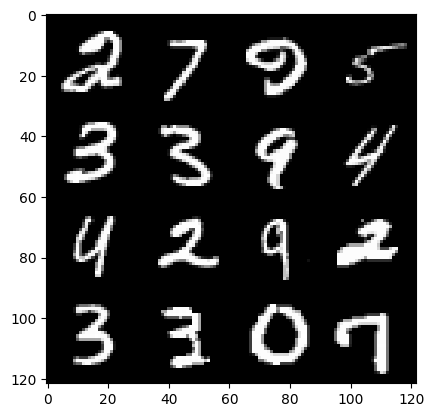

274: step 128700 / Gen loss 1.9781856294473004 / Disc loss 0.27848392595847427


  0%|          | 0/469 [00:00<?, ?it/s]

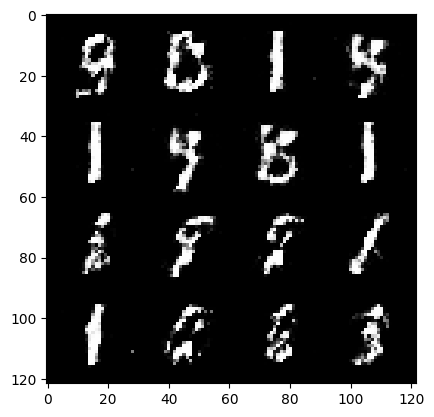

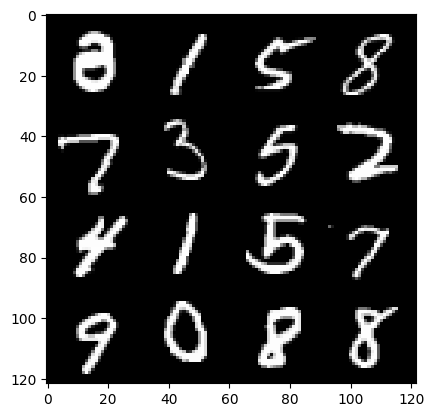

275: step 129000 / Gen loss 1.9173213676611598 / Disc loss 0.28294813225666676


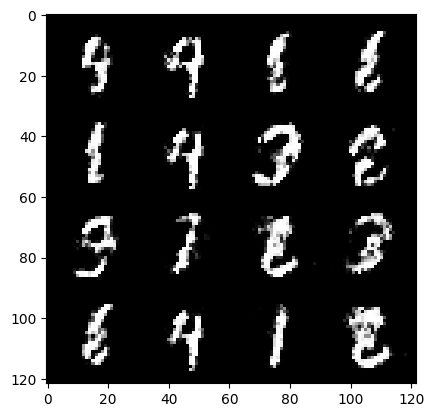

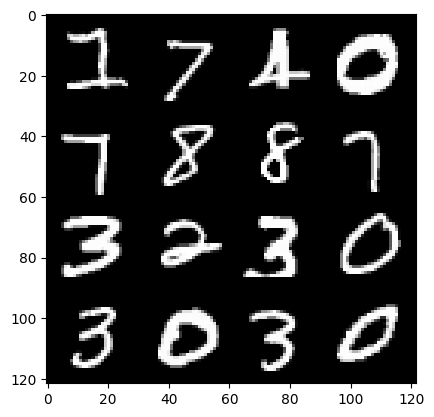

275: step 129300 / Gen loss 1.8982164021333054 / Disc loss 0.28552331383029605


  0%|          | 0/469 [00:00<?, ?it/s]

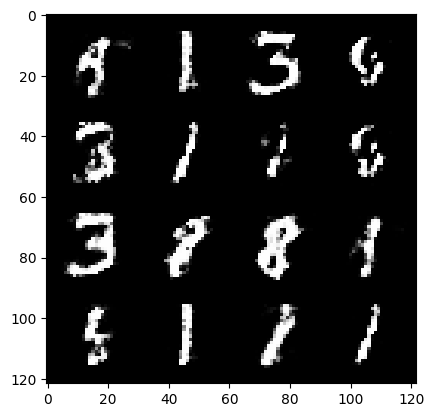

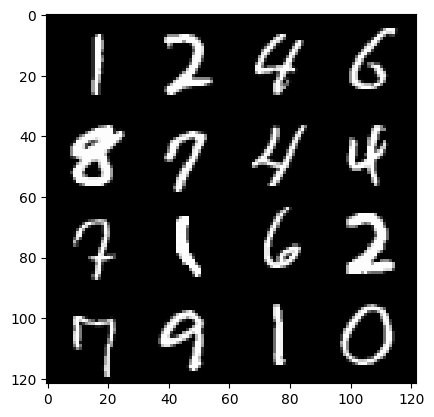

276: step 129600 / Gen loss 1.9323605561256405 / Disc loss 0.27474534700314207


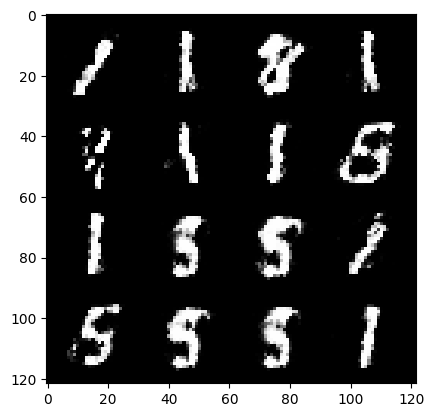

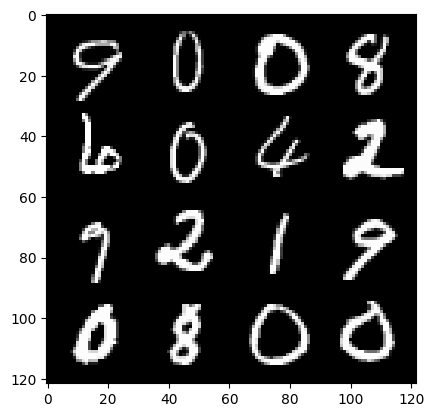

276: step 129900 / Gen loss 1.8996115664641047 / Disc loss 0.28188370575507476


  0%|          | 0/469 [00:00<?, ?it/s]

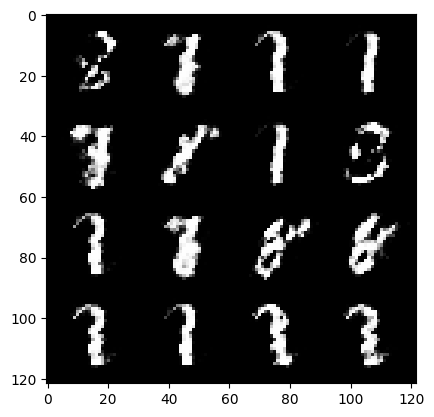

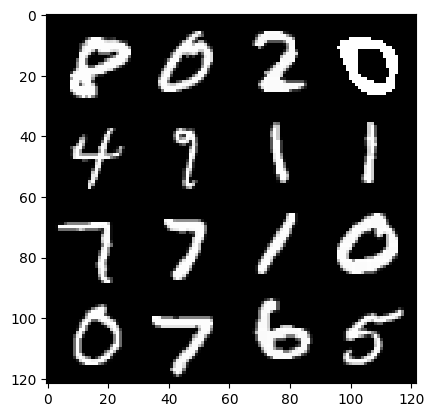

277: step 130200 / Gen loss 1.9042616037527733 / Disc loss 0.2847584056357543


  0%|          | 0/469 [00:00<?, ?it/s]

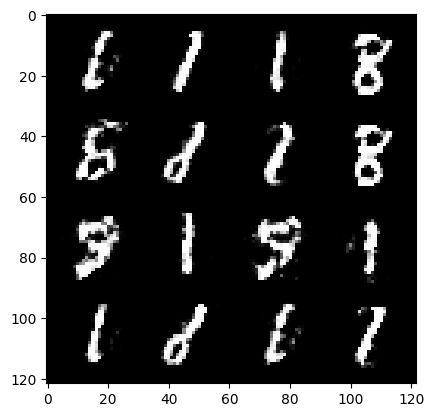

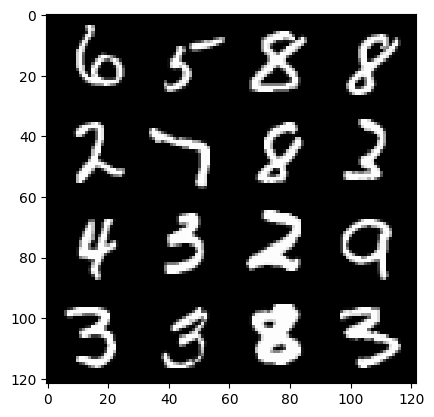

278: step 130500 / Gen loss 1.9329355283578231 / Disc loss 0.2904102229575316


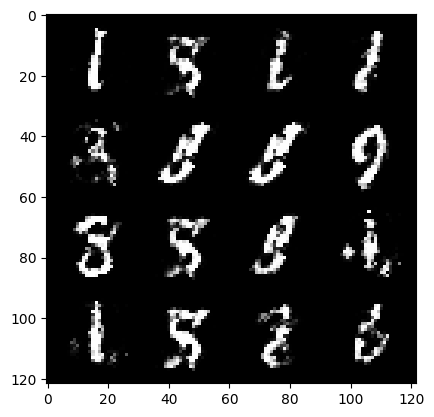

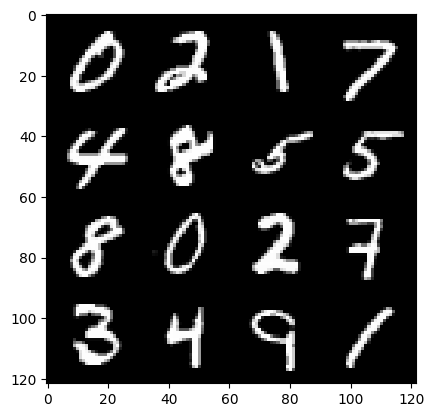

278: step 130800 / Gen loss 1.8392041261990872 / Disc loss 0.2921473547816274


  0%|          | 0/469 [00:00<?, ?it/s]

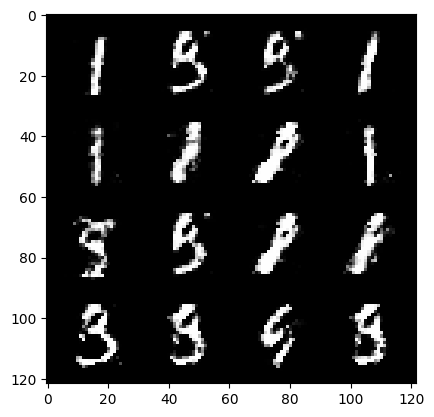

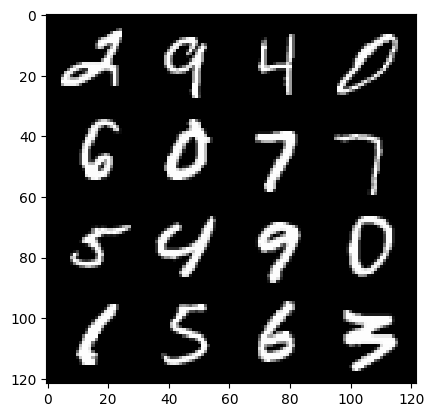

279: step 131100 / Gen loss 1.9491303845246633 / Disc loss 0.2662100387116274


  0%|          | 0/469 [00:00<?, ?it/s]

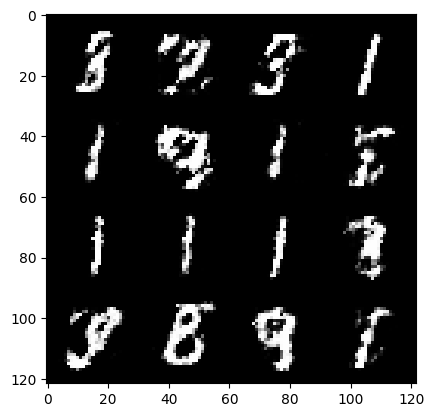

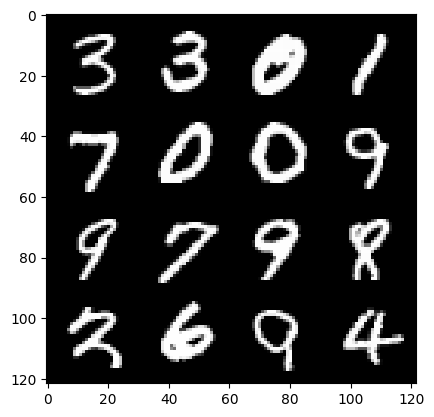

280: step 131400 / Gen loss 1.9937349287668866 / Disc loss 0.2800316859781743


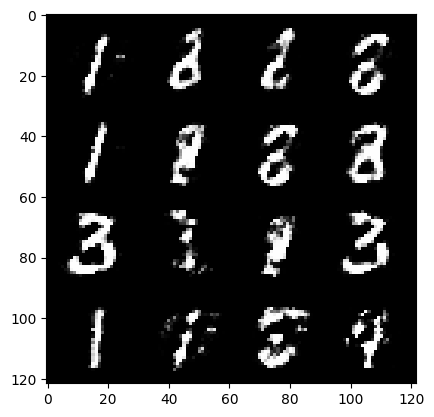

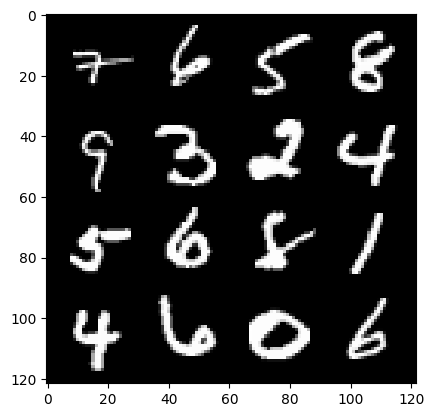

280: step 131700 / Gen loss 1.910487909317016 / Disc loss 0.2823169573148093


  0%|          | 0/469 [00:00<?, ?it/s]

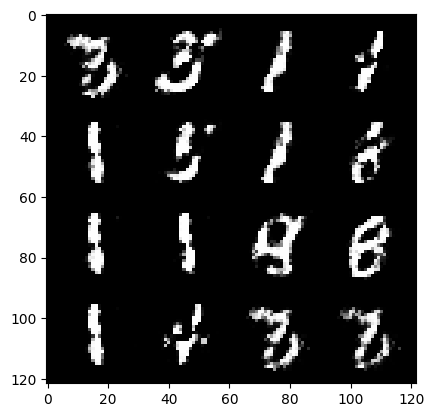

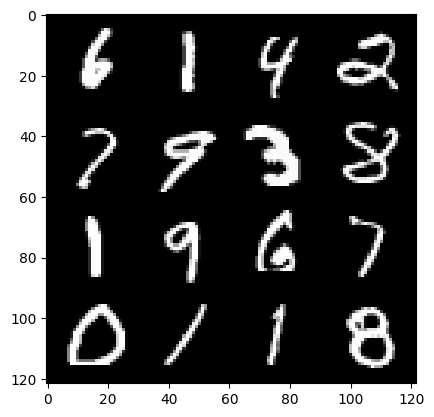

281: step 132000 / Gen loss 1.8754278536637636 / Disc loss 0.29652484451731054


  0%|          | 0/469 [00:00<?, ?it/s]

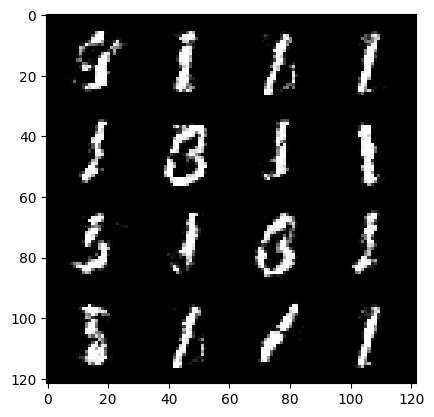

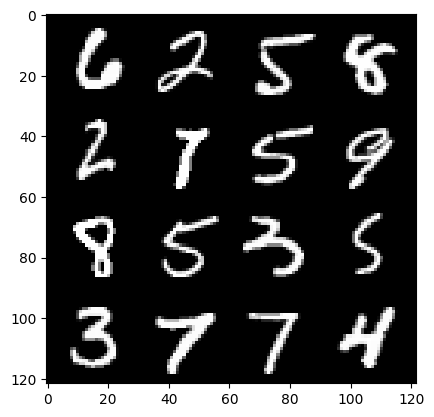

282: step 132300 / Gen loss 1.9522354952494314 / Disc loss 0.2748719696700575


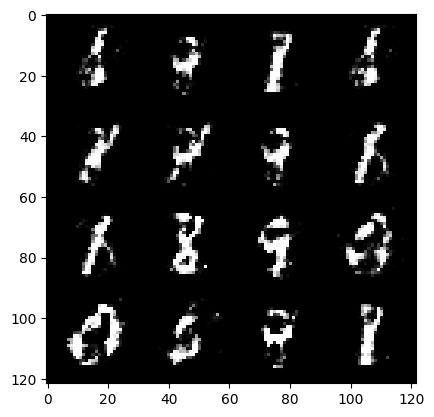

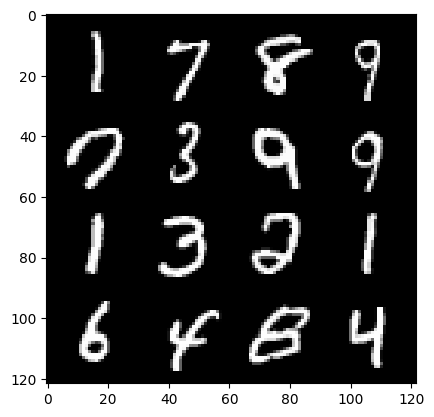

282: step 132600 / Gen loss 1.875799035231273 / Disc loss 0.28170855085055035


  0%|          | 0/469 [00:00<?, ?it/s]

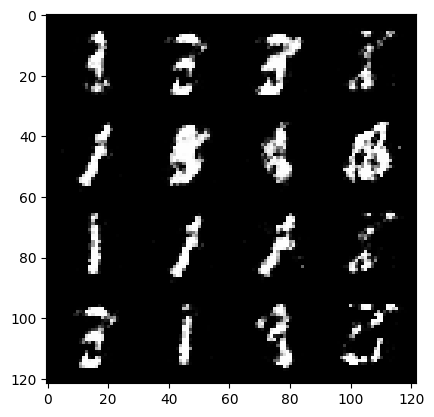

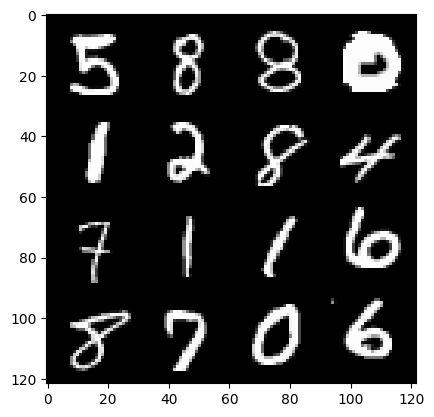

283: step 132900 / Gen loss 1.9094375141461677 / Disc loss 0.28761616781353955


  0%|          | 0/469 [00:00<?, ?it/s]

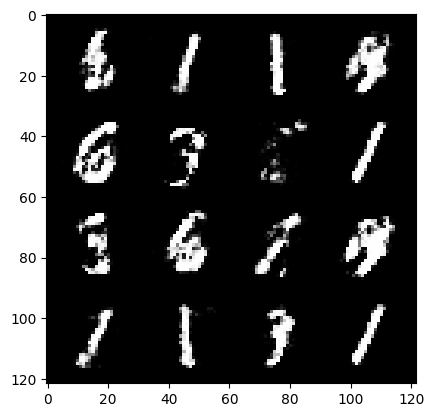

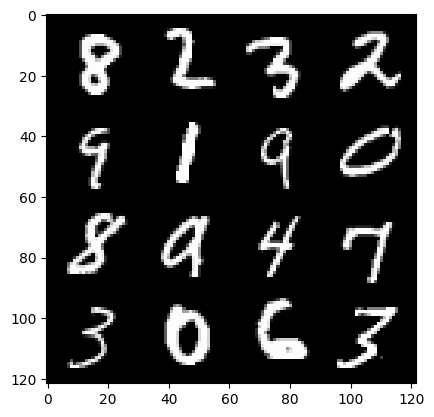

284: step 133200 / Gen loss 2.0203852029641465 / Disc loss 0.25613989348212884


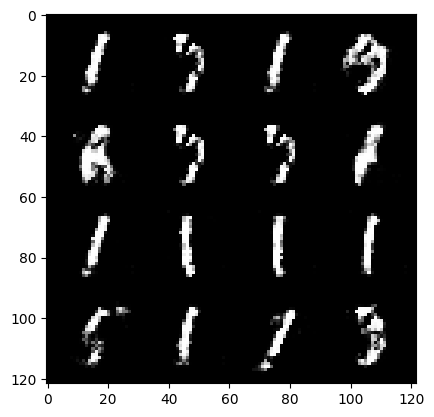

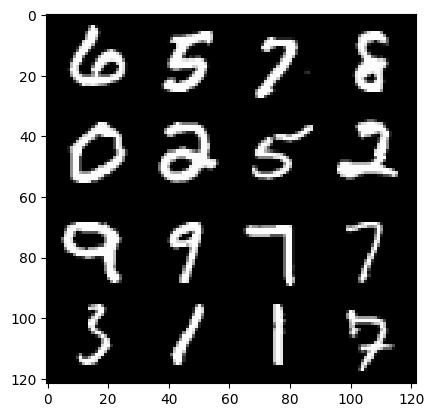

284: step 133500 / Gen loss 1.8033967844645185 / Disc loss 0.30738234172264733


  0%|          | 0/469 [00:00<?, ?it/s]

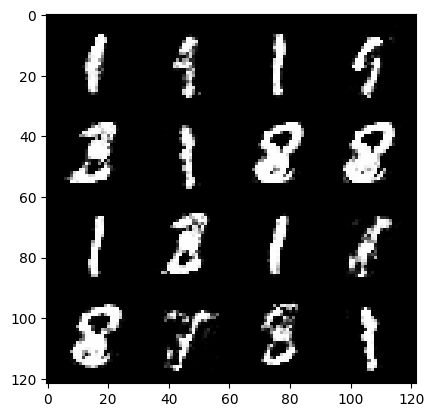

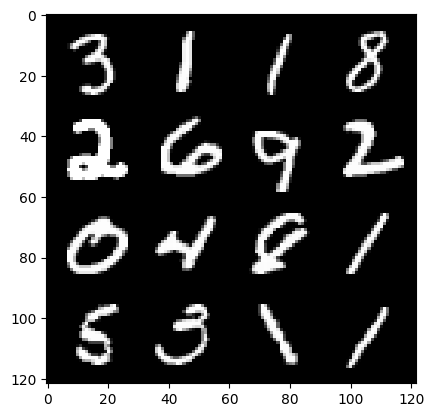

285: step 133800 / Gen loss 1.99618714372317 / Disc loss 0.27716811125477164


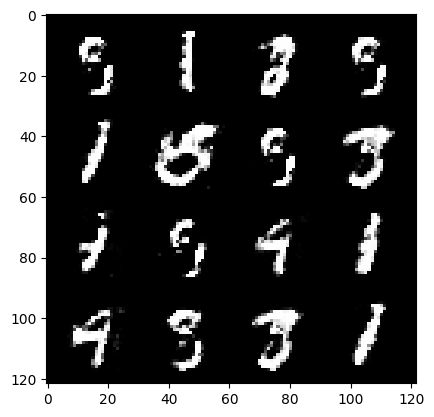

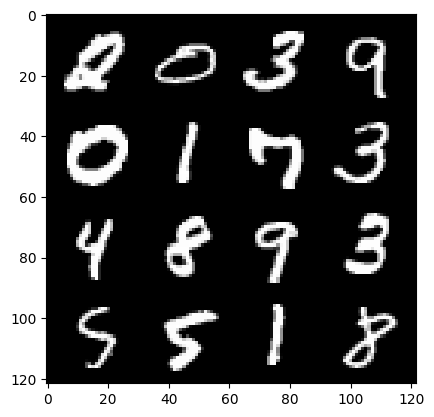

285: step 134100 / Gen loss 2.0025438654422767 / Disc loss 0.27736587842305516


  0%|          | 0/469 [00:00<?, ?it/s]

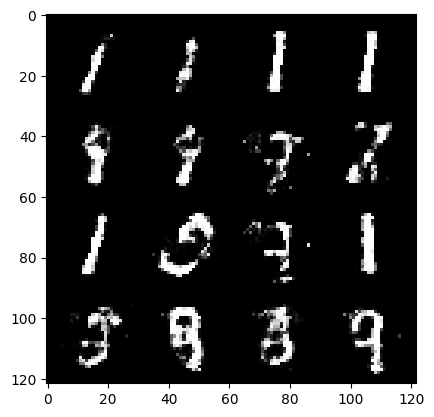

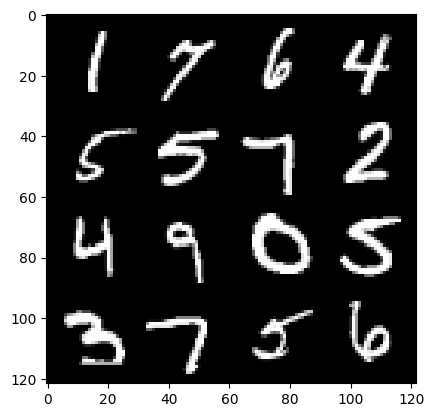

286: step 134400 / Gen loss 2.0922676539421077 / Disc loss 0.2788397496442001


  0%|          | 0/469 [00:00<?, ?it/s]

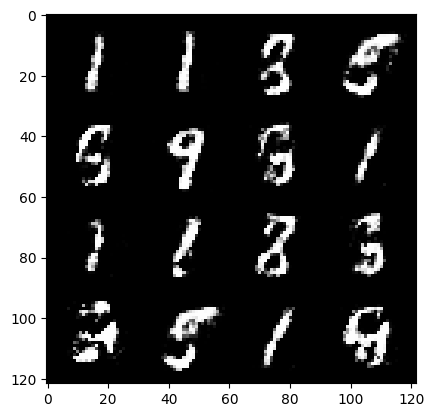

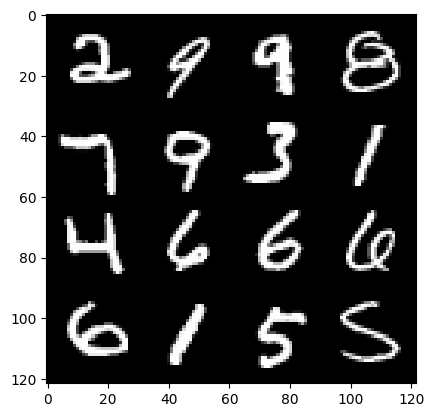

287: step 134700 / Gen loss 1.887093160947164 / Disc loss 0.281574367235104


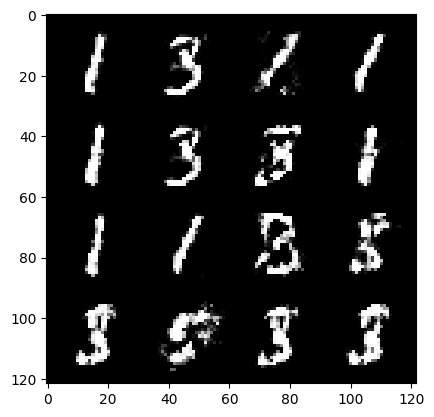

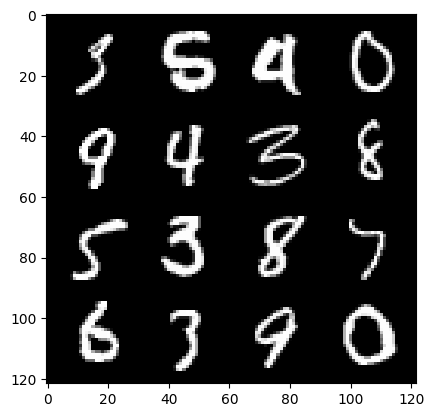

287: step 135000 / Gen loss 1.942341318130495 / Disc loss 0.2724222073455652


  0%|          | 0/469 [00:00<?, ?it/s]

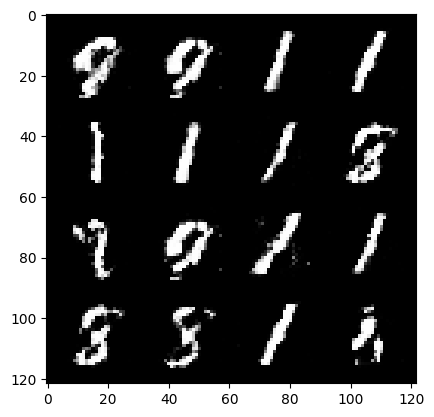

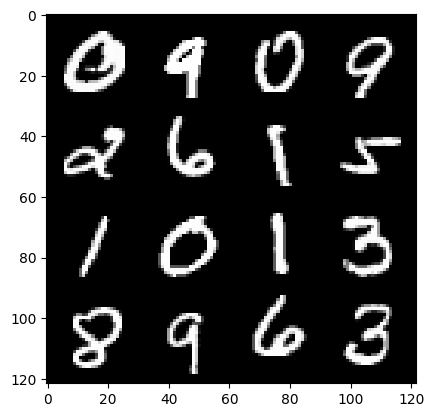

288: step 135300 / Gen loss 1.8772941021124527 / Disc loss 0.2911375598112743


  0%|          | 0/469 [00:00<?, ?it/s]

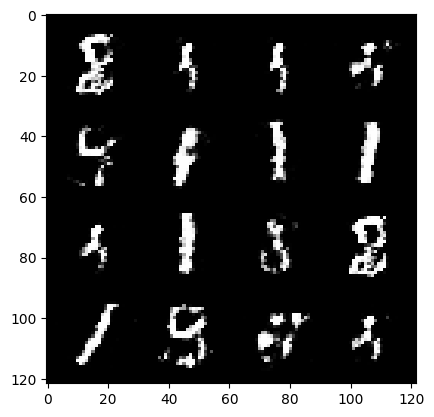

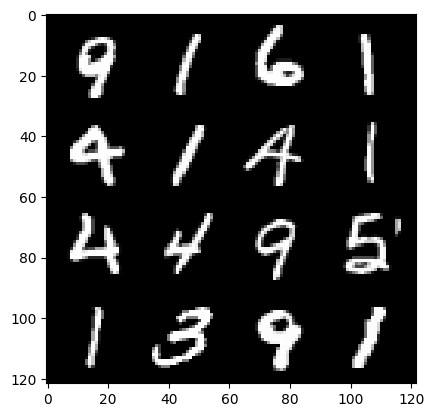

289: step 135600 / Gen loss 1.9497749118010195 / Disc loss 0.2784439793725811


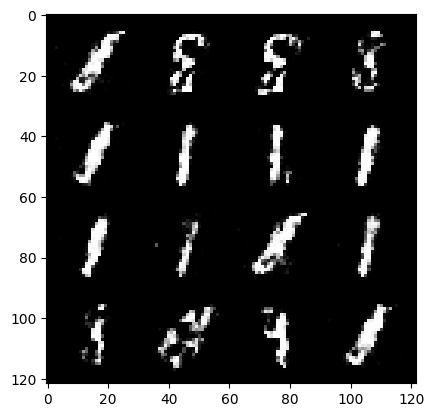

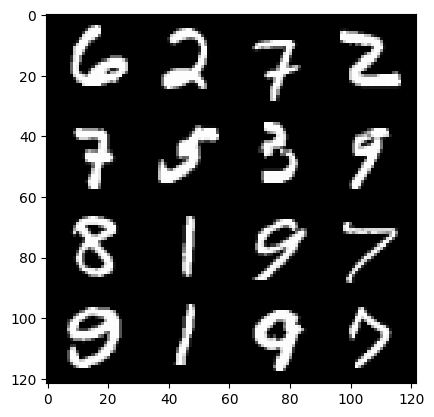

289: step 135900 / Gen loss 2.0455215620994593 / Disc loss 0.2573721337815124


  0%|          | 0/469 [00:00<?, ?it/s]

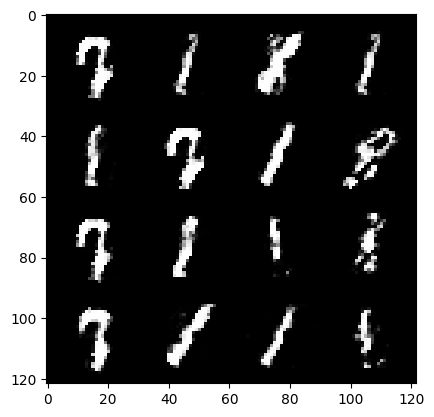

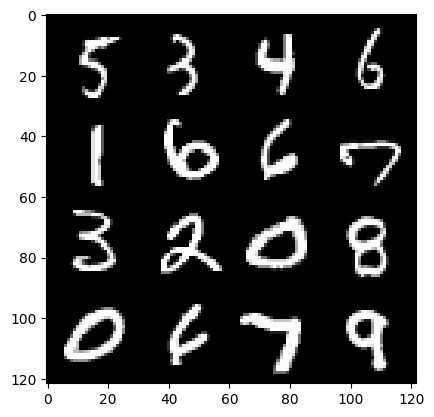

290: step 136200 / Gen loss 1.9067755452791857 / Disc loss 0.27749565462271375


  0%|          | 0/469 [00:00<?, ?it/s]

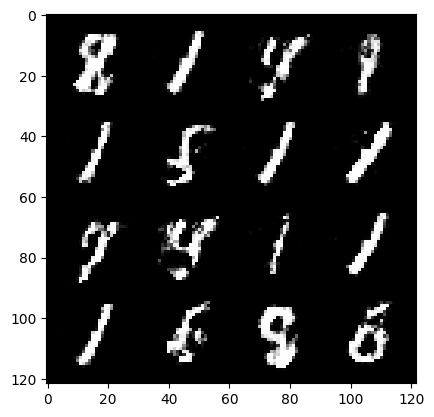

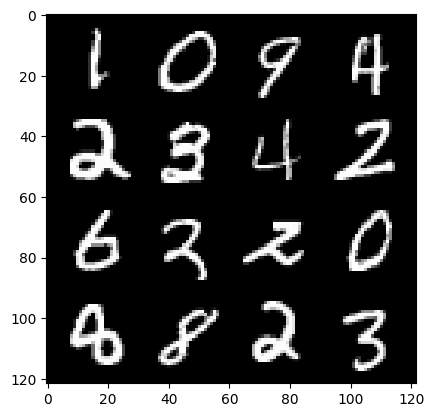

291: step 136500 / Gen loss 1.8960231935977936 / Disc loss 0.27624521752198544


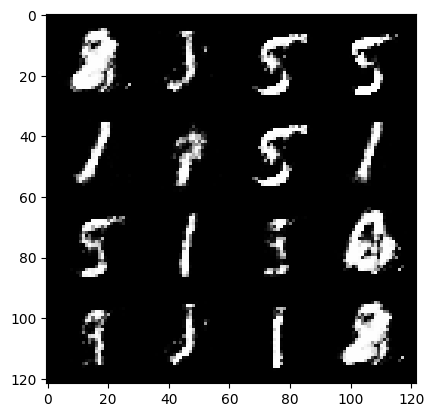

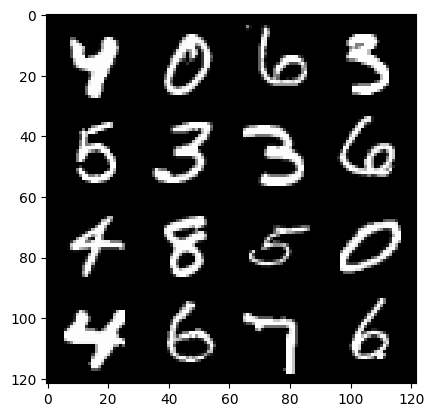

291: step 136800 / Gen loss 1.8360938239097593 / Disc loss 0.30085799669226004


  0%|          | 0/469 [00:00<?, ?it/s]

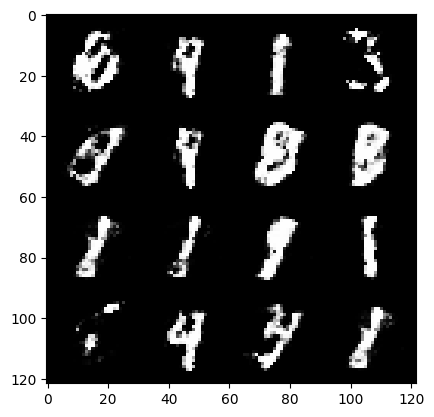

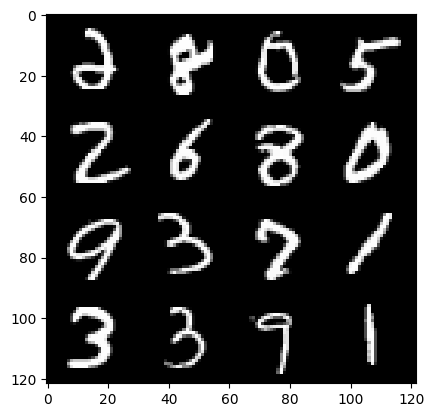

292: step 137100 / Gen loss 2.0238244442145032 / Disc loss 0.2650446410477161


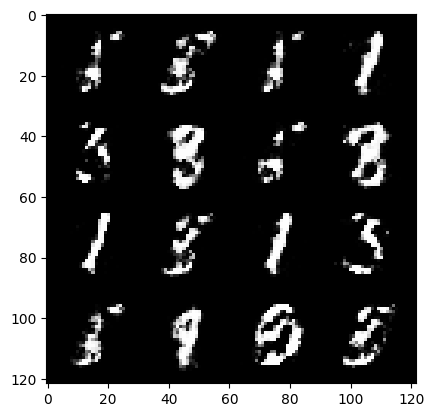

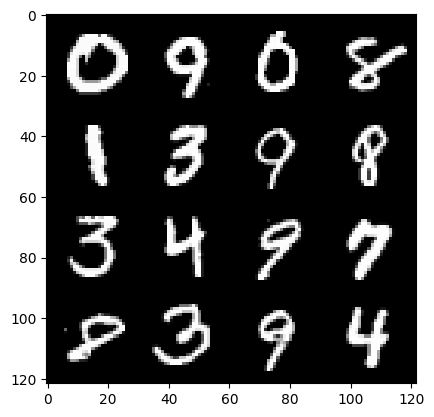

292: step 137400 / Gen loss 1.91480036377907 / Disc loss 0.27031624605258314


  0%|          | 0/469 [00:00<?, ?it/s]

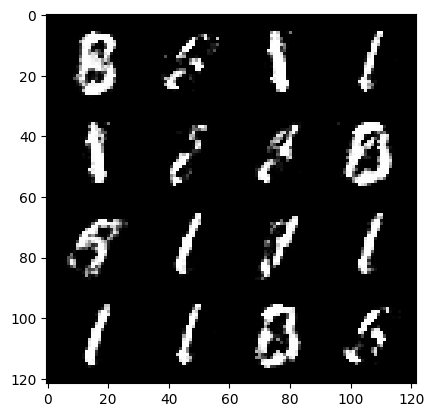

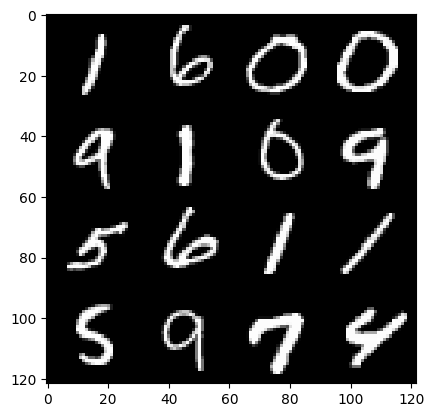

293: step 137700 / Gen loss 1.85748499751091 / Disc loss 0.27681402737895644


  0%|          | 0/469 [00:00<?, ?it/s]

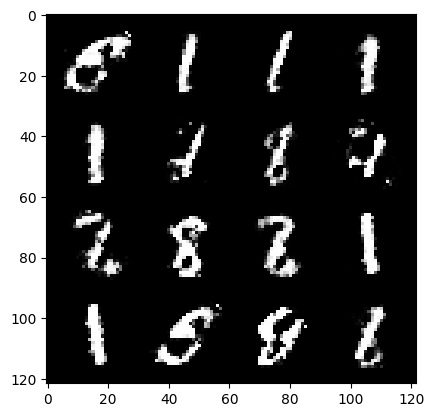

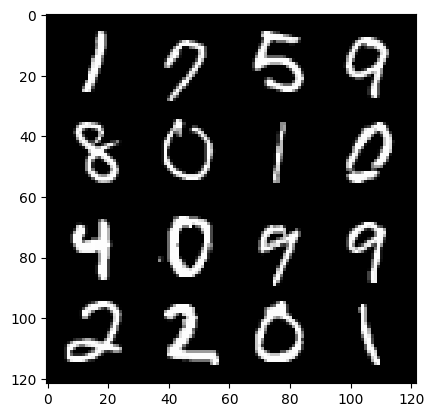

294: step 138000 / Gen loss 1.9284163935979188 / Disc loss 0.27076518019040424


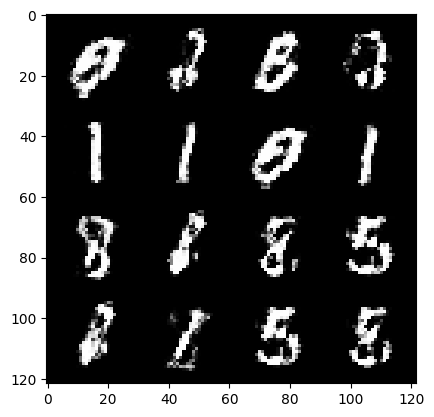

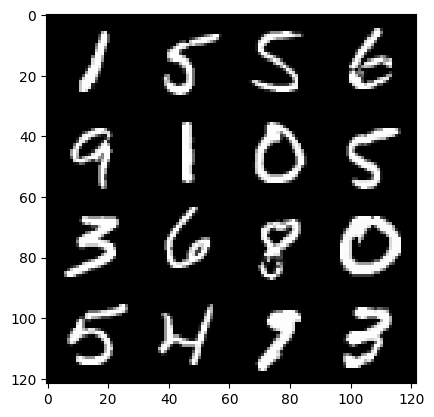

294: step 138300 / Gen loss 1.9660998721917469 / Disc loss 0.27406648397445715


  0%|          | 0/469 [00:00<?, ?it/s]

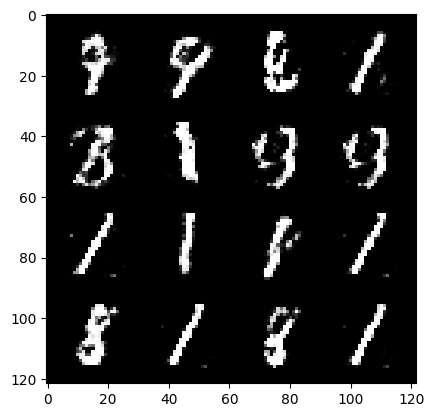

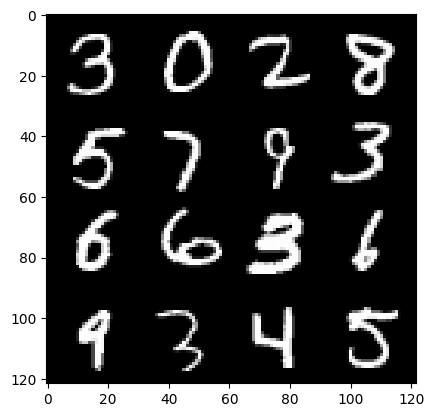

295: step 138600 / Gen loss 1.8978132704893746 / Disc loss 0.29192629615465804


  0%|          | 0/469 [00:00<?, ?it/s]

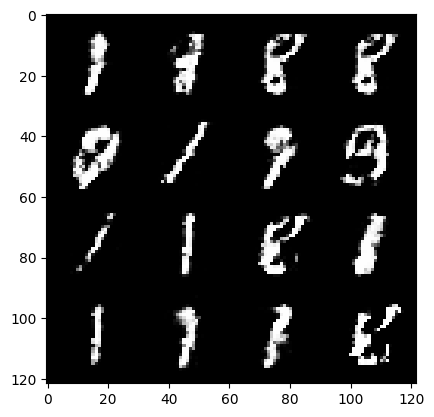

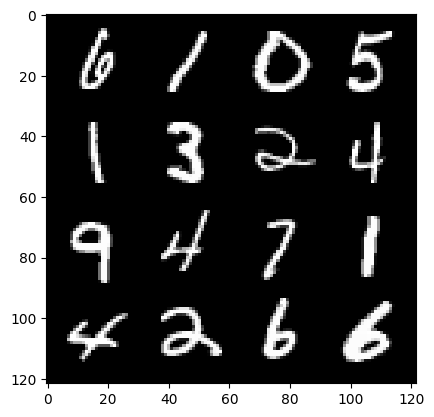

296: step 138900 / Gen loss 1.8899673291047423 / Disc loss 0.2766178101301192


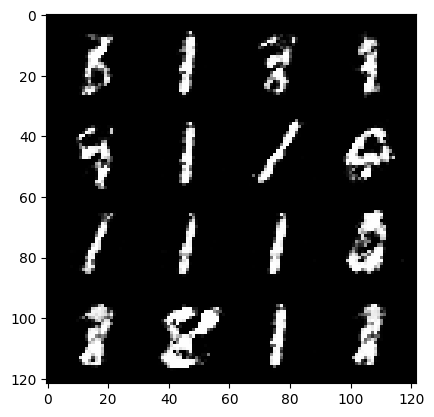

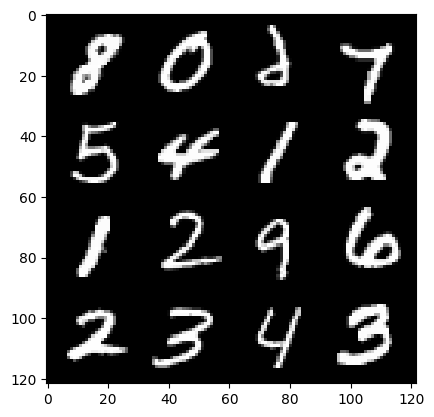

296: step 139200 / Gen loss 1.9365037461121886 / Disc loss 0.2770869502921899


  0%|          | 0/469 [00:00<?, ?it/s]

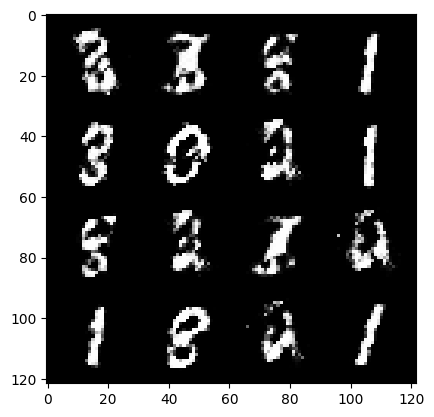

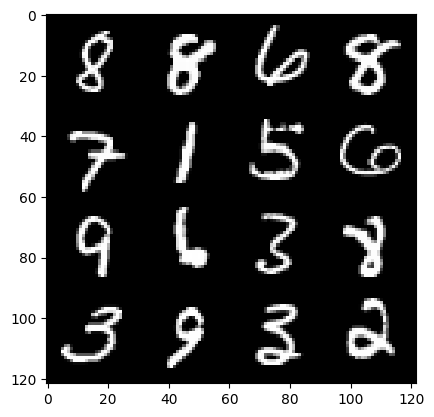

297: step 139500 / Gen loss 1.8015299510955816 / Disc loss 0.3018904842436313


  0%|          | 0/469 [00:00<?, ?it/s]

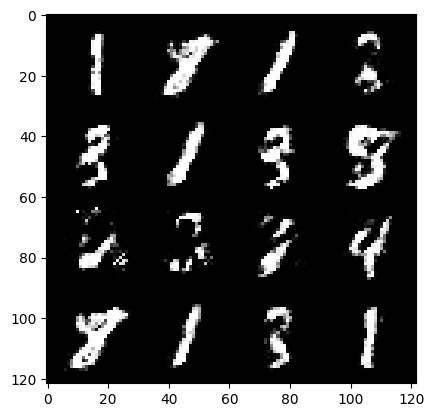

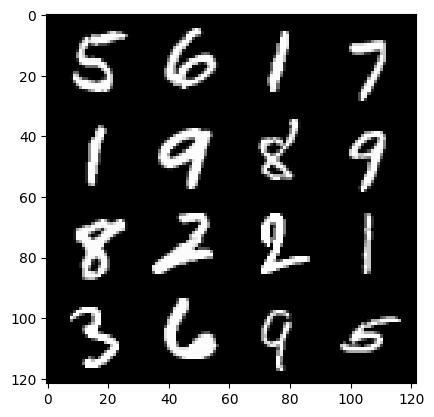

298: step 139800 / Gen loss 1.7908570273717248 / Disc loss 0.3090943863491217


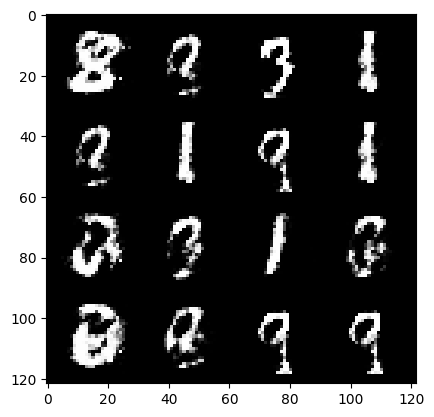

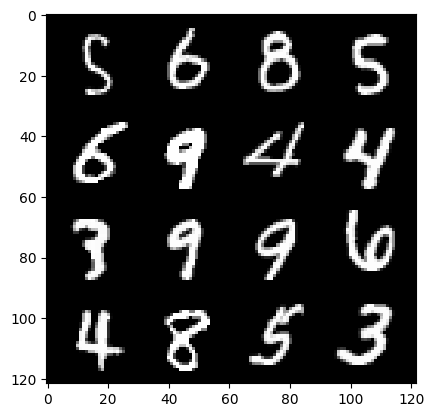

298: step 140100 / Gen loss 1.7826249818007145 / Disc loss 0.32445202767848963


  0%|          | 0/469 [00:00<?, ?it/s]

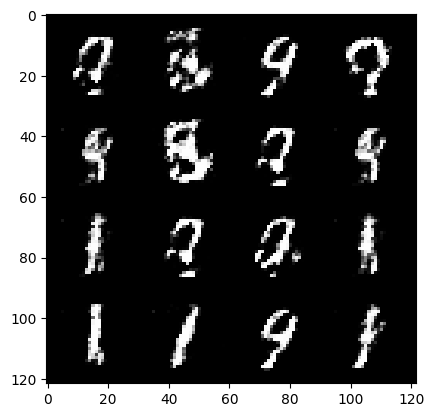

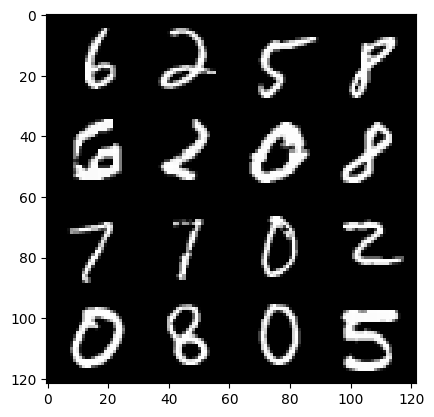

299: step 140400 / Gen loss 2.043082324266435 / Disc loss 0.2667247621218363


  0%|          | 0/469 [00:00<?, ?it/s]

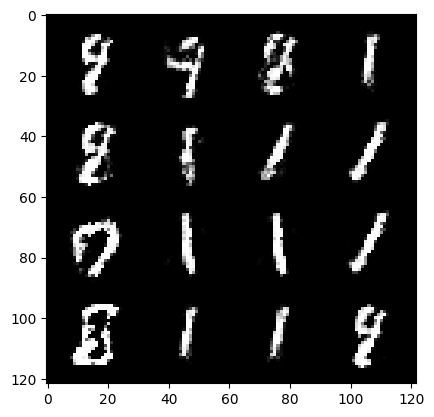

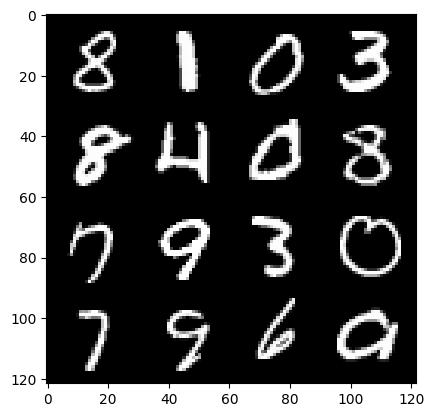

300: step 140700 / Gen loss 1.8510166052977237 / Disc loss 0.2826657029489679


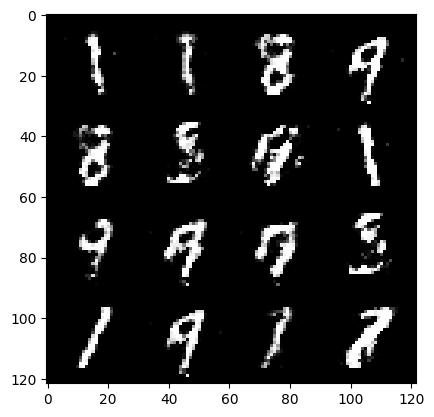

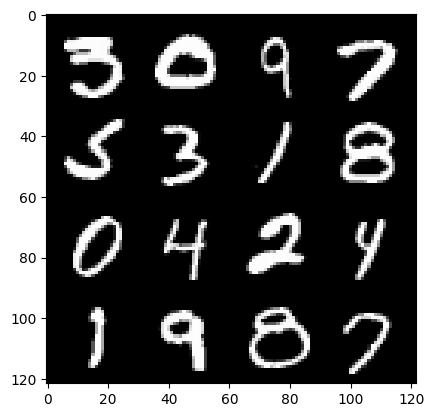

300: step 141000 / Gen loss 1.8678748802343996 / Disc loss 0.2865030709902445


  0%|          | 0/469 [00:00<?, ?it/s]

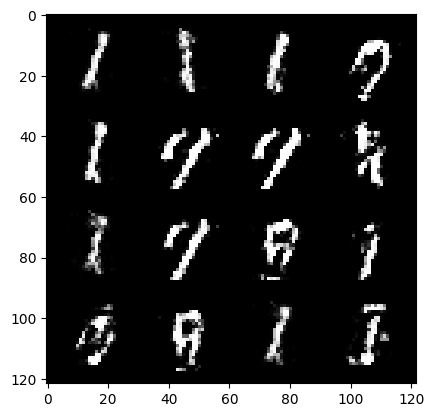

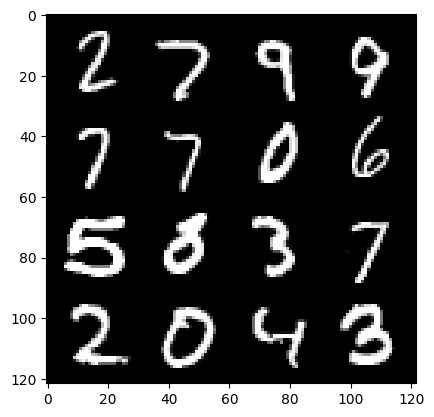

301: step 141300 / Gen loss 1.8611121392250054 / Disc loss 0.2613641179601351


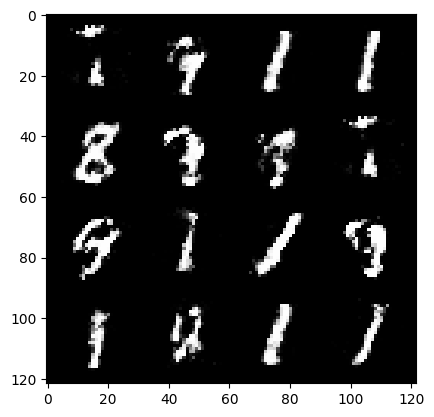

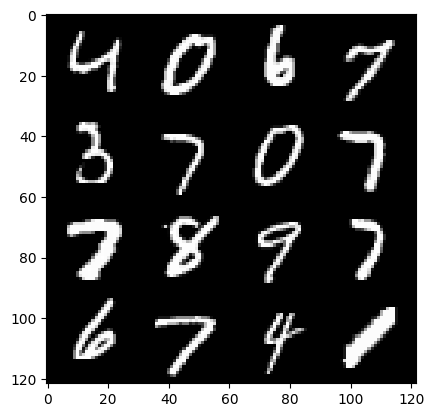

301: step 141600 / Gen loss 1.8334141703446705 / Disc loss 0.2840457080304624


  0%|          | 0/469 [00:00<?, ?it/s]

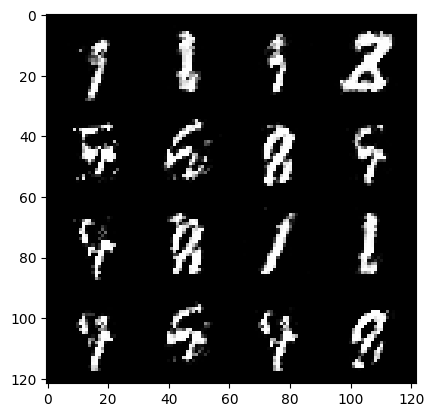

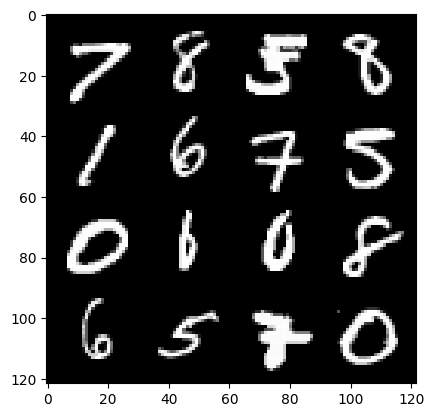

302: step 141900 / Gen loss 1.9620465644200642 / Disc loss 0.2723929169277352


  0%|          | 0/469 [00:00<?, ?it/s]

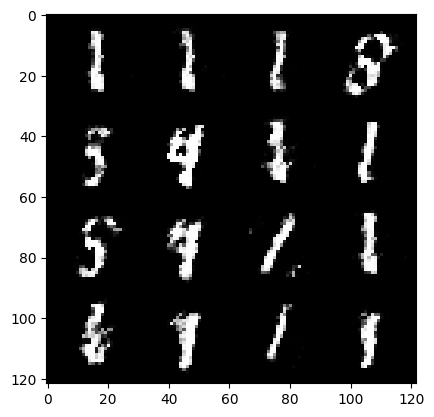

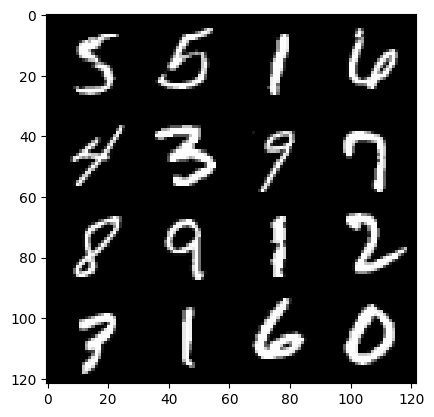

303: step 142200 / Gen loss 1.9704186932245895 / Disc loss 0.273167560249567


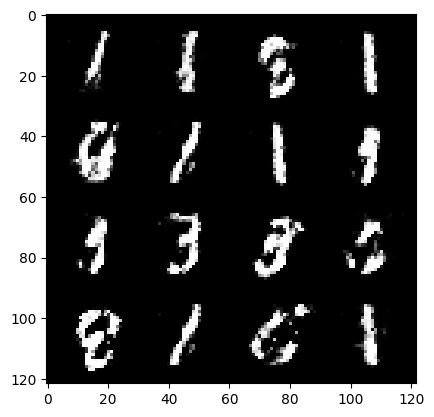

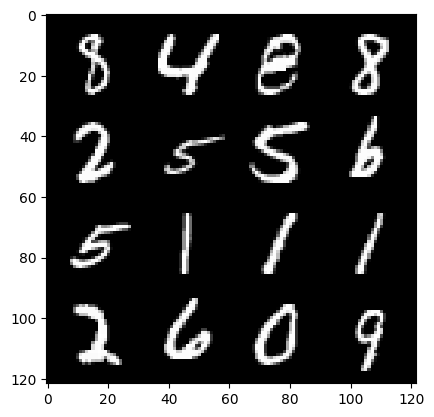

303: step 142500 / Gen loss 1.91169465303421 / Disc loss 0.2779794319470723


  0%|          | 0/469 [00:00<?, ?it/s]

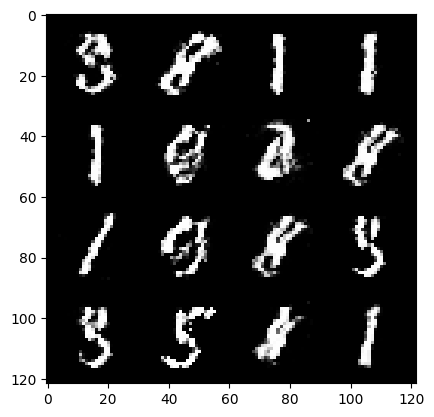

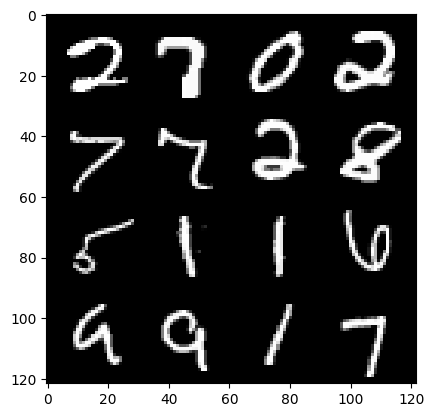

304: step 142800 / Gen loss 1.9578745635350545 / Disc loss 0.2756400560339292


  0%|          | 0/469 [00:00<?, ?it/s]

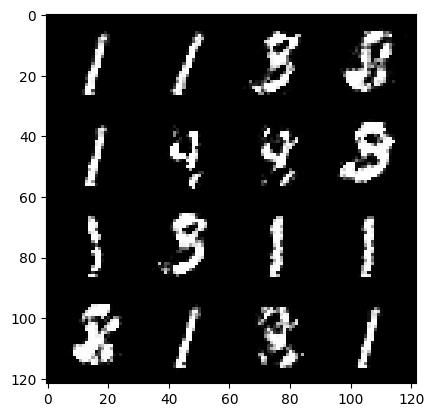

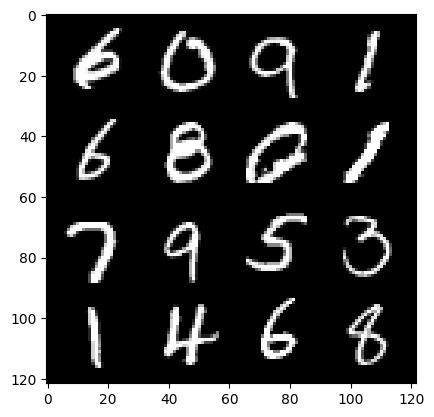

305: step 143100 / Gen loss 1.9781659169991799 / Disc loss 0.27960221702853877


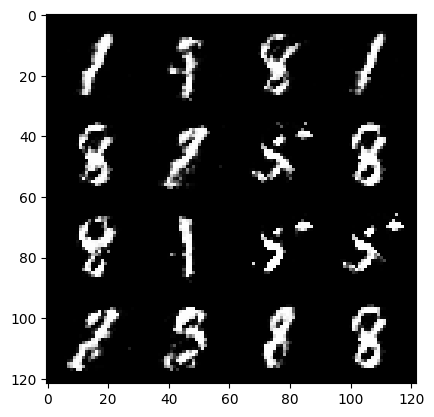

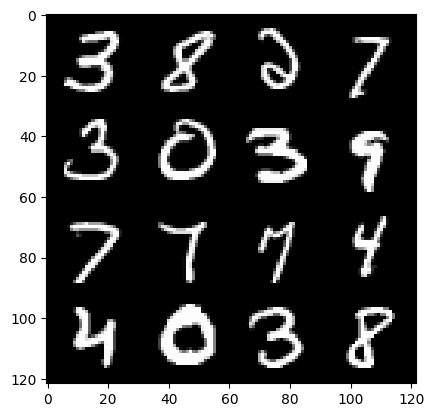

305: step 143400 / Gen loss 2.0051784539222717 / Disc loss 0.27156463195880265


  0%|          | 0/469 [00:00<?, ?it/s]

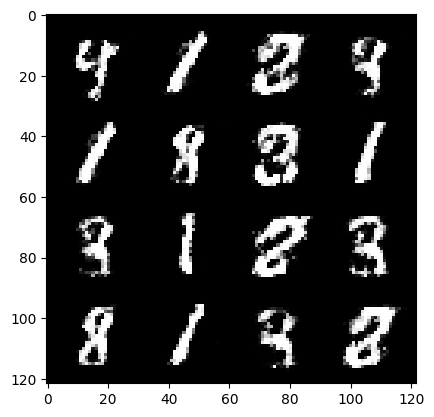

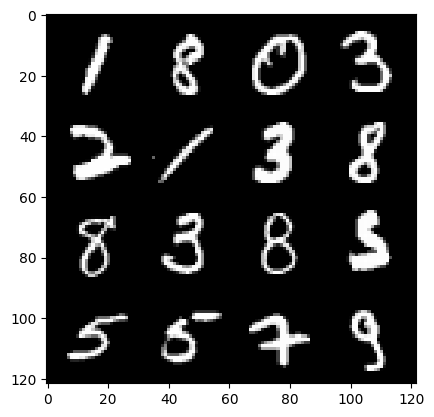

306: step 143700 / Gen loss 1.9993882751464842 / Disc loss 0.277483626107375


  0%|          | 0/469 [00:00<?, ?it/s]

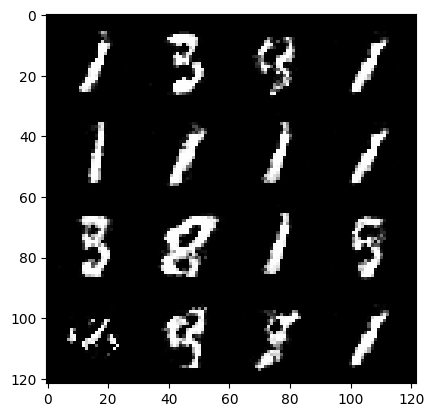

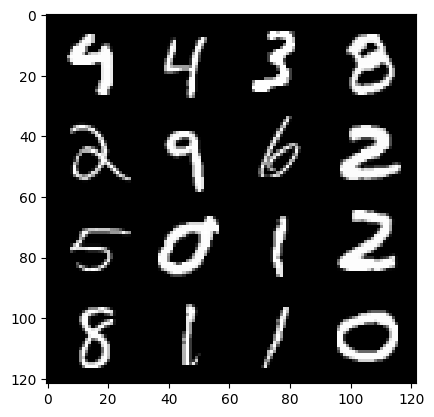

307: step 144000 / Gen loss 2.0373593958218876 / Disc loss 0.2665144120156764


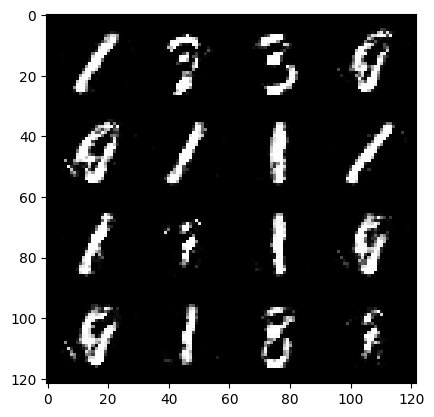

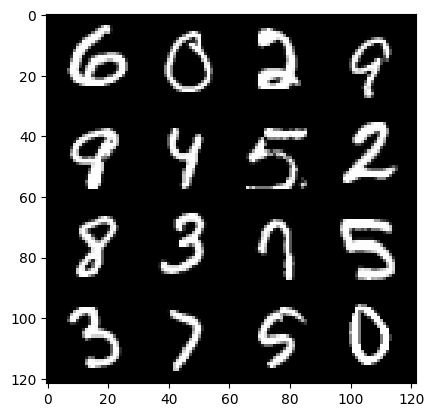

307: step 144300 / Gen loss 1.9363759807745613 / Disc loss 0.27515524710218103


  0%|          | 0/469 [00:00<?, ?it/s]

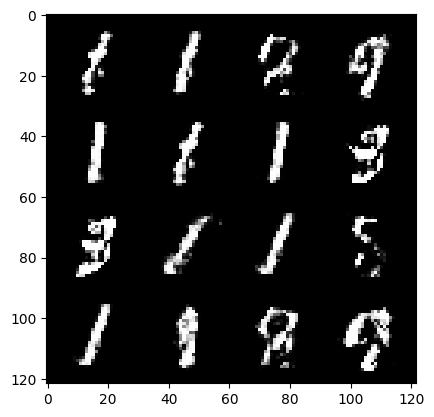

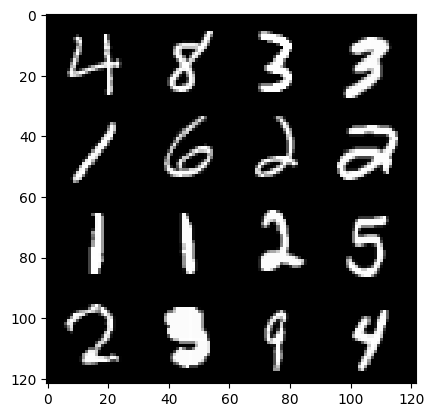

308: step 144600 / Gen loss 1.945448660850526 / Disc loss 0.26842202906807255


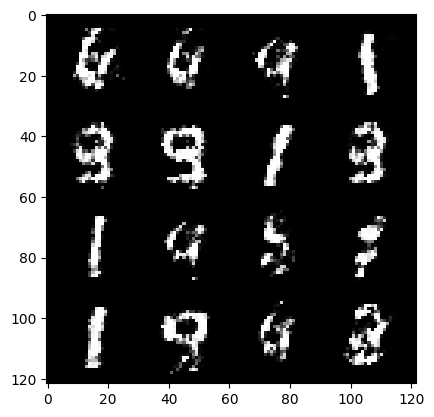

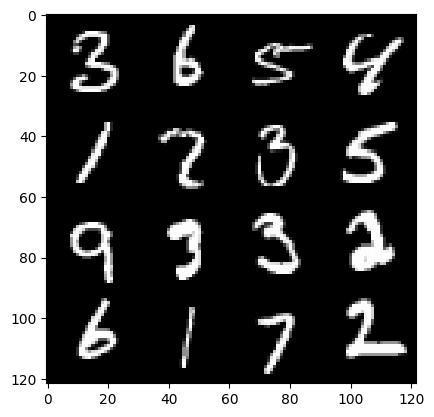

308: step 144900 / Gen loss 1.9433653000990552 / Disc loss 0.28149556626876204


  0%|          | 0/469 [00:00<?, ?it/s]

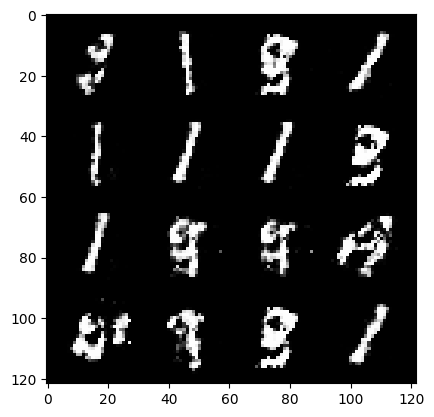

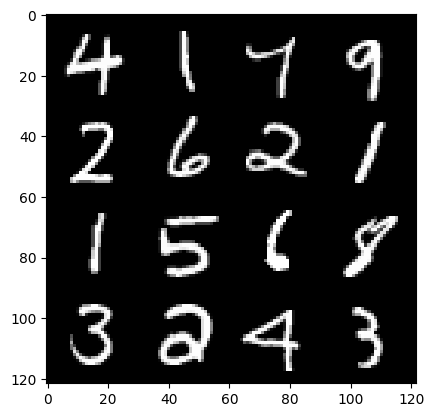

309: step 145200 / Gen loss 2.048365138371785 / Disc loss 0.2892001306513943


  0%|          | 0/469 [00:00<?, ?it/s]

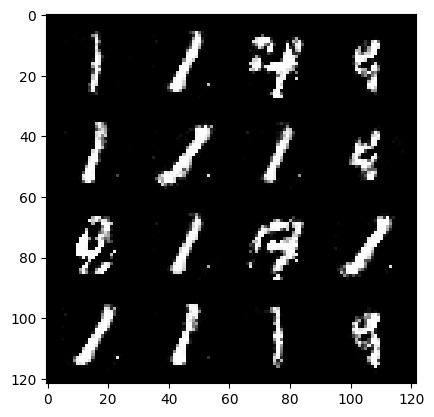

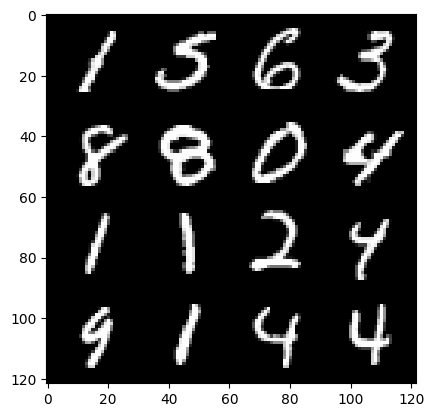

310: step 145500 / Gen loss 2.049681711594263 / Disc loss 0.2511751285692055


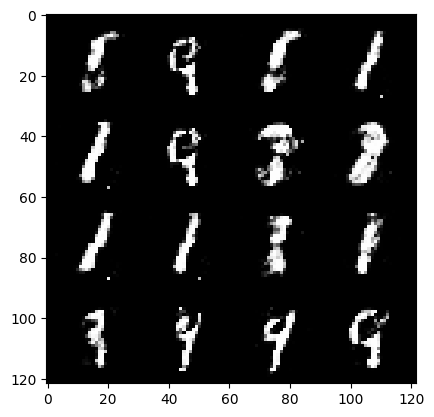

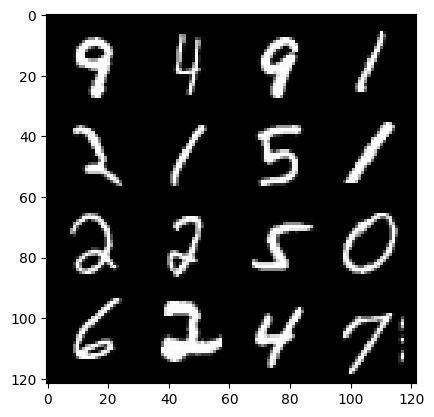

310: step 145800 / Gen loss 2.008534941275915 / Disc loss 0.2562363581359388


  0%|          | 0/469 [00:00<?, ?it/s]

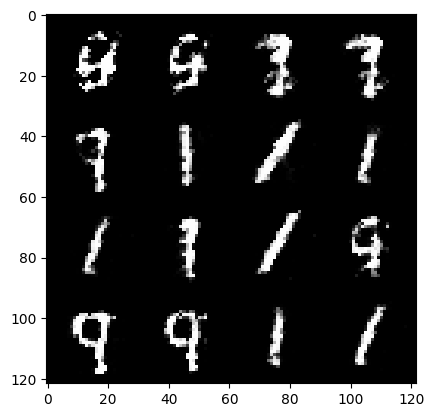

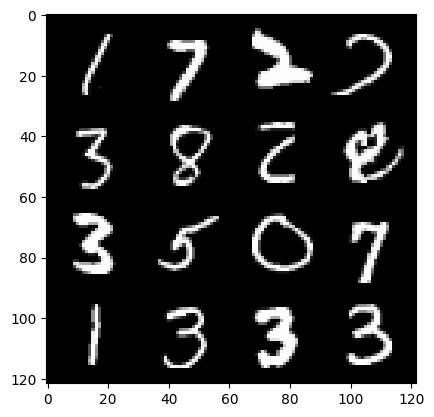

311: step 146100 / Gen loss 2.029489110310872 / Disc loss 0.25911897410949075


  0%|          | 0/469 [00:00<?, ?it/s]

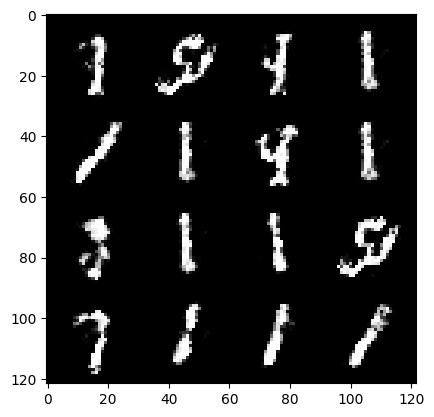

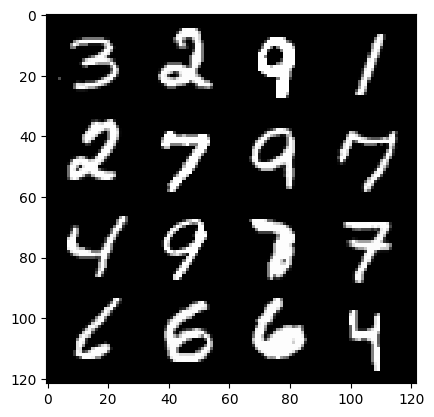

312: step 146400 / Gen loss 2.0154584077994033 / Disc loss 0.2487306861579419


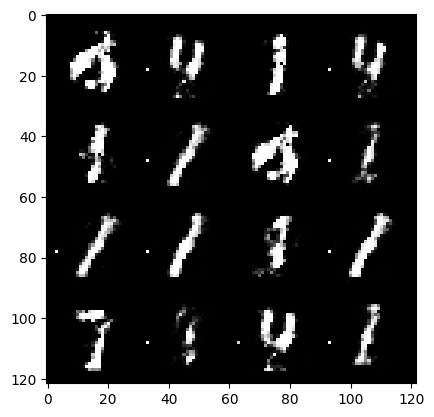

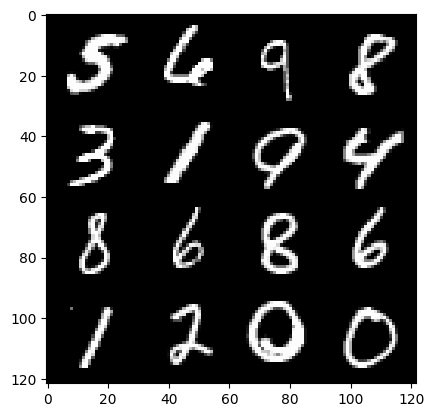

312: step 146700 / Gen loss 1.6339079070091256 / Disc loss 0.33347072447339693


  0%|          | 0/469 [00:00<?, ?it/s]

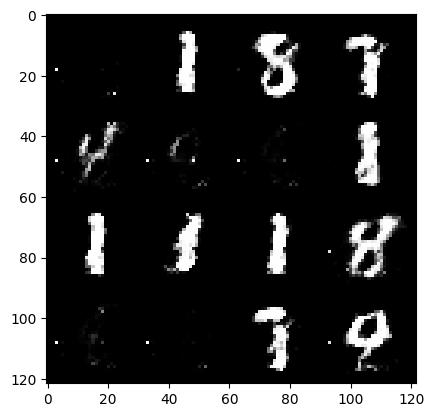

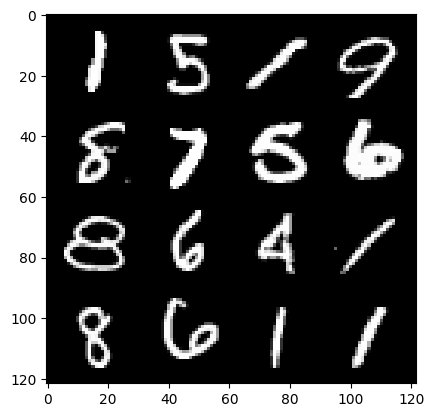

313: step 147000 / Gen loss 1.3470008675257363 / Disc loss 0.4302719565232595


  0%|          | 0/469 [00:00<?, ?it/s]

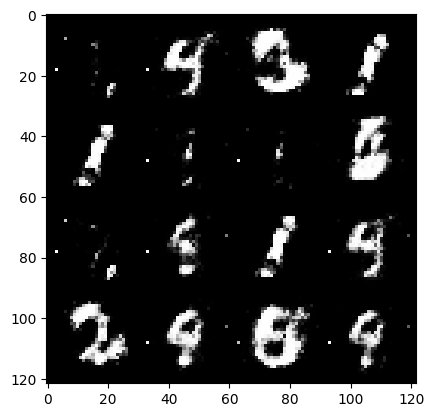

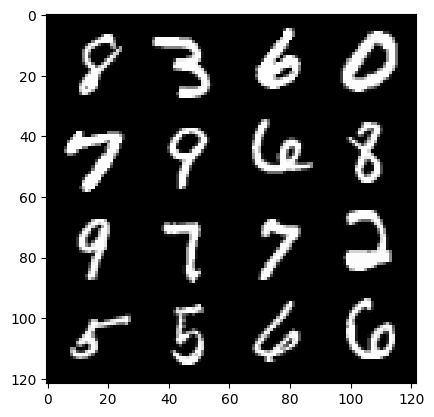

314: step 147300 / Gen loss 1.3910956251621254 / Disc loss 0.4328123086690907


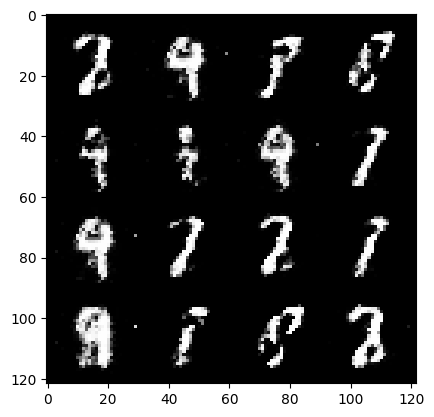

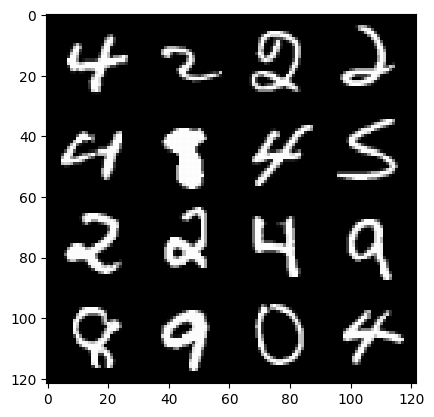

314: step 147600 / Gen loss 1.2912419966856632 / Disc loss 0.43311016609271363


  0%|          | 0/469 [00:00<?, ?it/s]

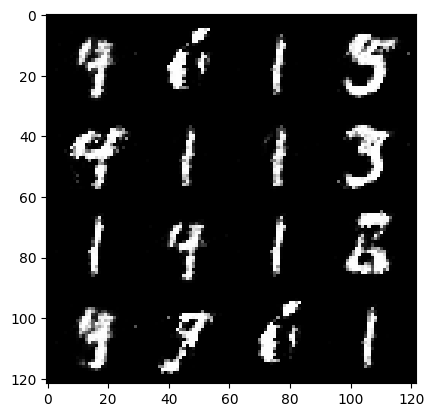

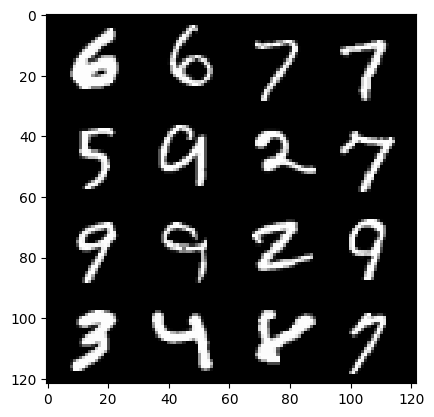

315: step 147900 / Gen loss 1.357467152277629 / Disc loss 0.38189948260784135


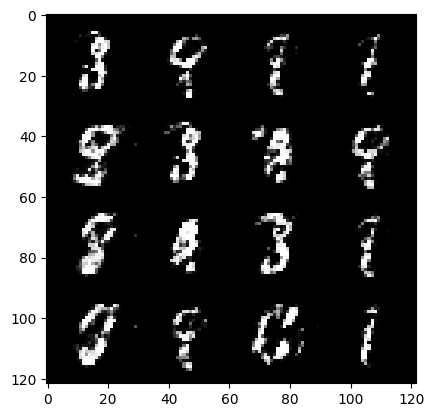

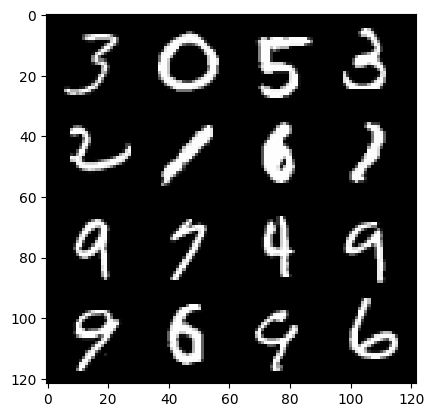

315: step 148200 / Gen loss 1.4774681262175238 / Disc loss 0.33731467604637144


  0%|          | 0/469 [00:00<?, ?it/s]

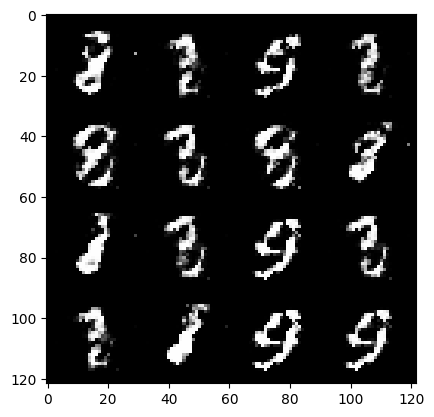

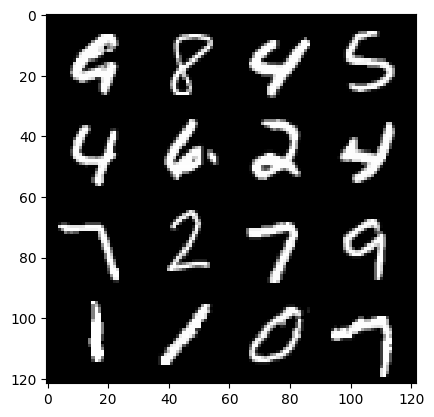

316: step 148500 / Gen loss 1.8232767887910197 / Disc loss 0.2710819166402023


  0%|          | 0/469 [00:00<?, ?it/s]

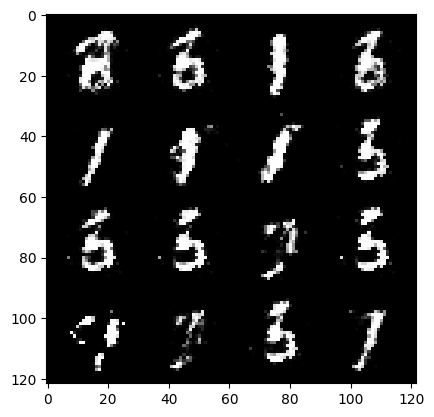

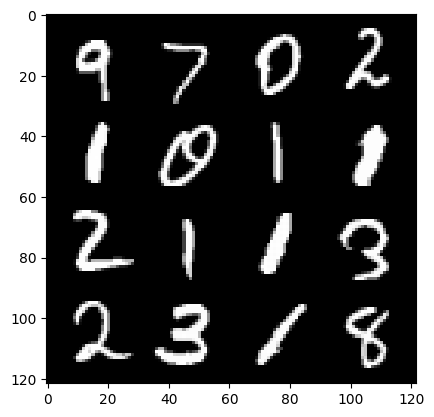

317: step 148800 / Gen loss 2.0981327450275407 / Disc loss 0.257239278058211


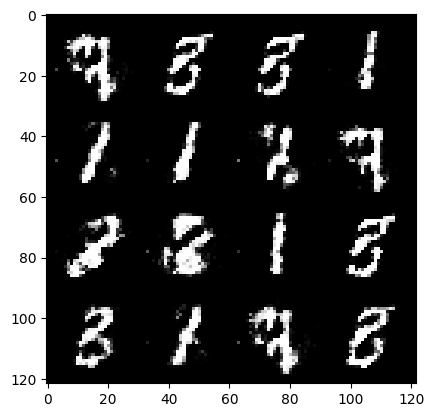

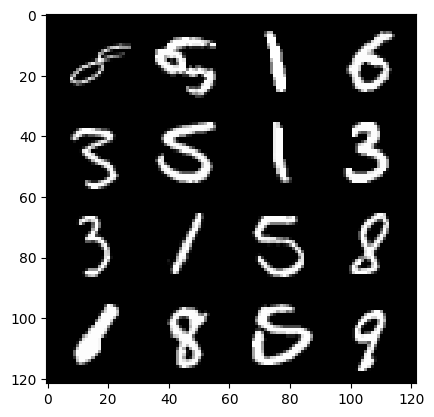

317: step 149100 / Gen loss 2.220619581937791 / Disc loss 0.2635345365107059


  0%|          | 0/469 [00:00<?, ?it/s]

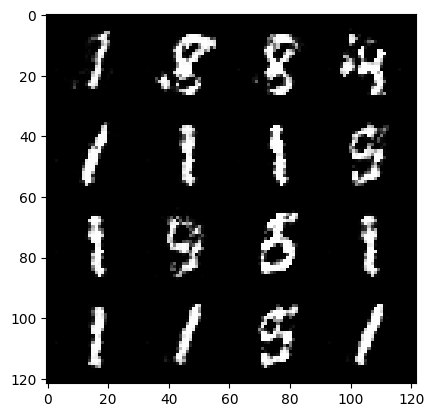

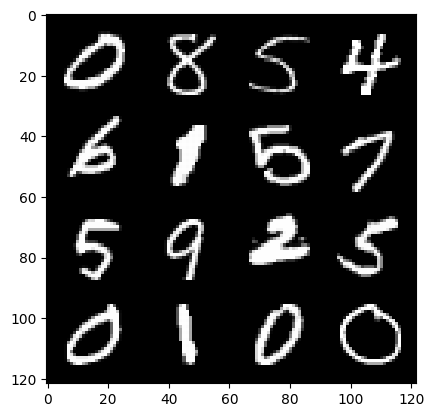

318: step 149400 / Gen loss 2.0307158128420517 / Disc loss 0.2877874683340394


  0%|          | 0/469 [00:00<?, ?it/s]

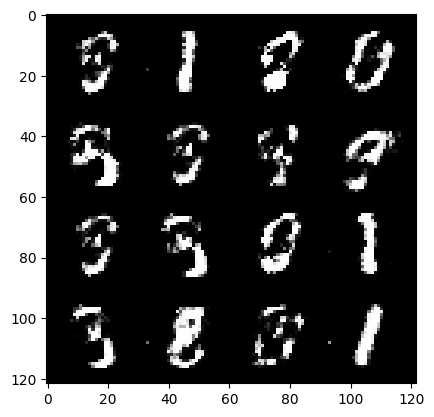

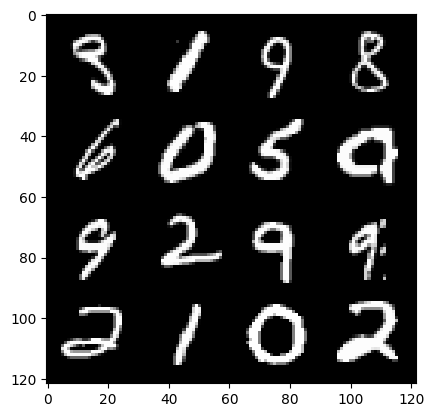

319: step 149700 / Gen loss 2.291910434563955 / Disc loss 0.25819009110331514


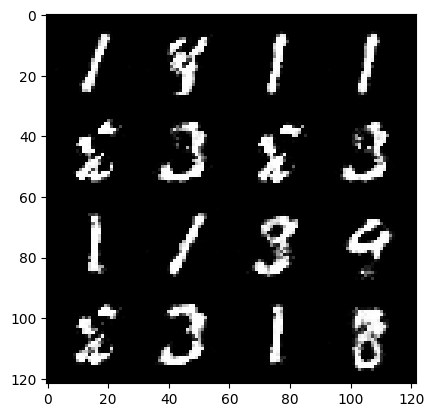

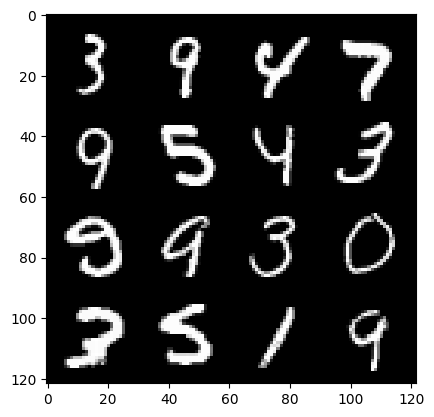

319: step 150000 / Gen loss 2.122870854536693 / Disc loss 0.2930956651270389


  0%|          | 0/469 [00:00<?, ?it/s]

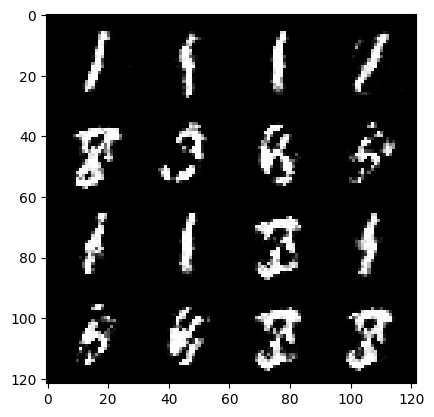

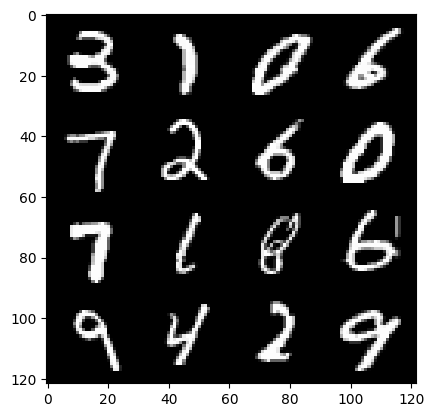

320: step 150300 / Gen loss 2.0646022673447937 / Disc loss 0.28597107976675046


  0%|          | 0/469 [00:00<?, ?it/s]

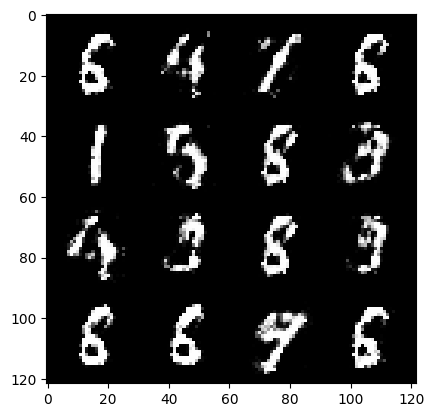

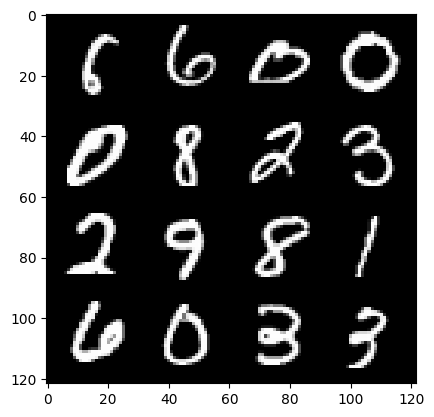

321: step 150600 / Gen loss 2.0540255463123325 / Disc loss 0.28435363094011956


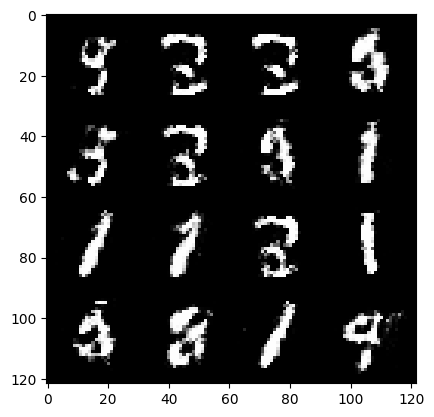

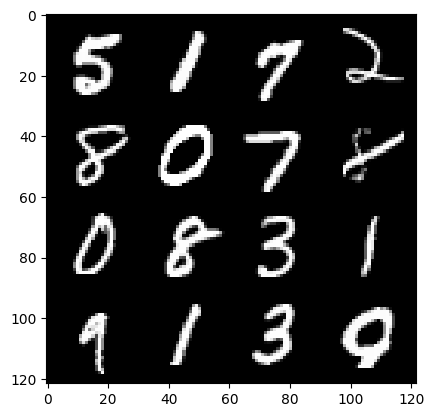

321: step 150900 / Gen loss 2.315956803162893 / Disc loss 0.2515529854098954


  0%|          | 0/469 [00:00<?, ?it/s]

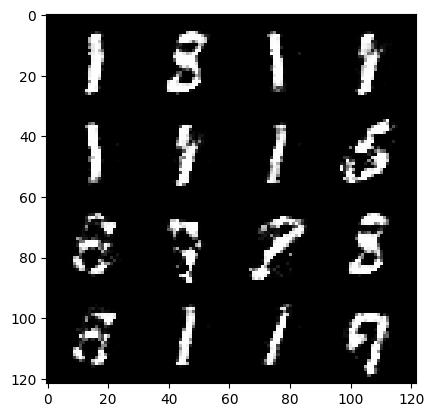

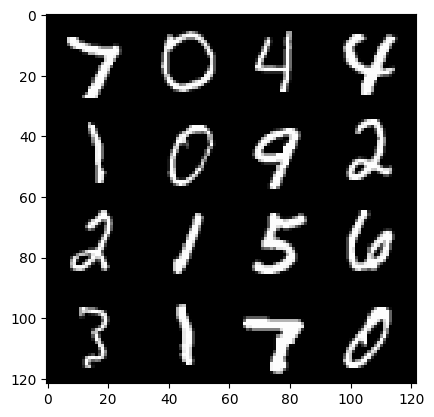

322: step 151200 / Gen loss 2.3684849182764673 / Disc loss 0.2659100544949372


  0%|          | 0/469 [00:00<?, ?it/s]

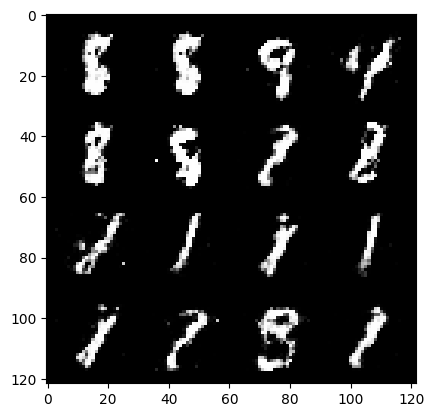

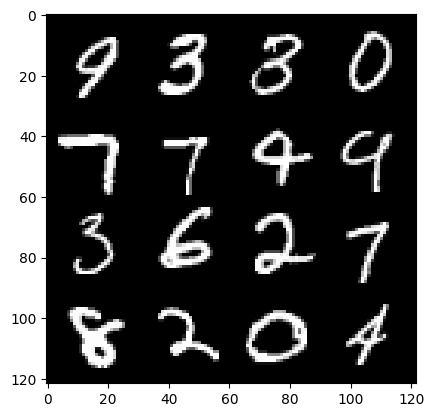

323: step 151500 / Gen loss 2.3807857886950163 / Disc loss 0.2596157243847847


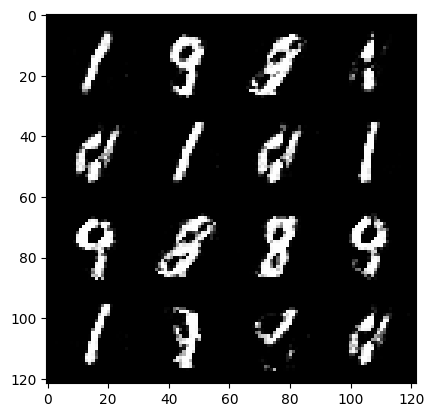

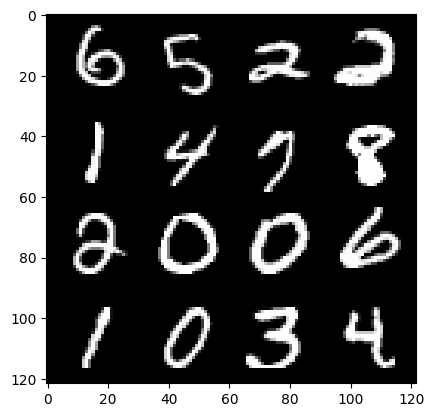

323: step 151800 / Gen loss 2.432810098727545 / Disc loss 0.2682335813840231


  0%|          | 0/469 [00:00<?, ?it/s]

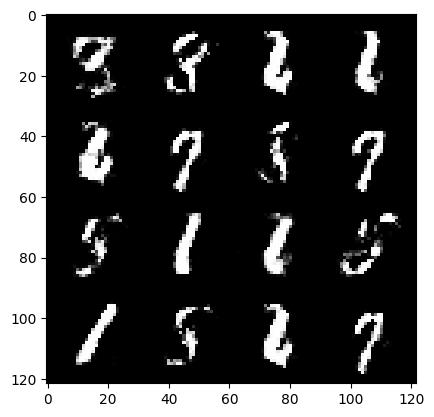

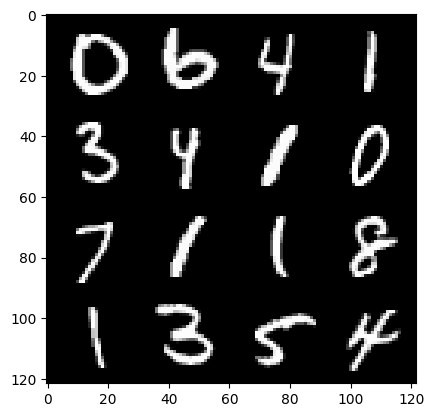

324: step 152100 / Gen loss 2.3387986969947807 / Disc loss 0.26498260244727123


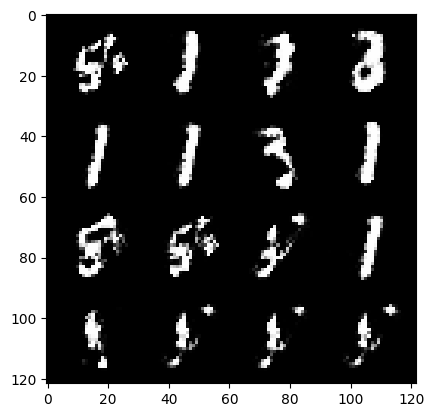

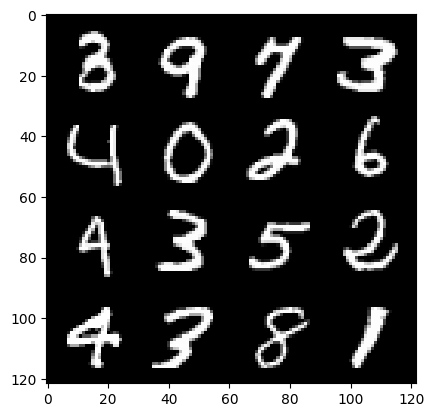

324: step 152400 / Gen loss 2.462647983233133 / Disc loss 0.2544744098186491


  0%|          | 0/469 [00:00<?, ?it/s]

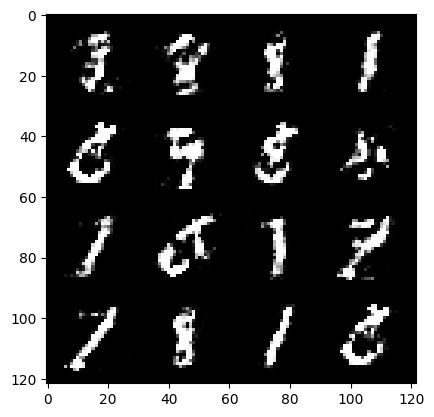

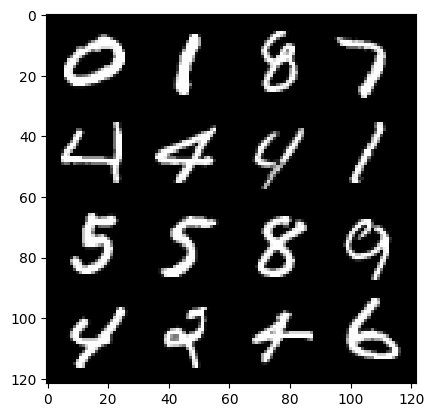

325: step 152700 / Gen loss 2.586046588420867 / Disc loss 0.22485004425048813


  0%|          | 0/469 [00:00<?, ?it/s]

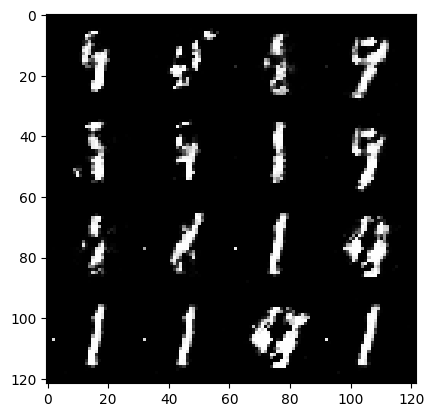

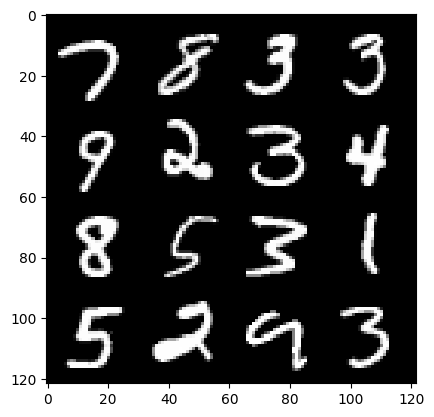

326: step 153000 / Gen loss 2.6383249358336136 / Disc loss 0.27315902302662537


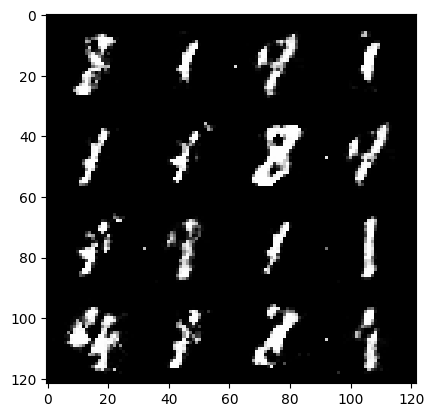

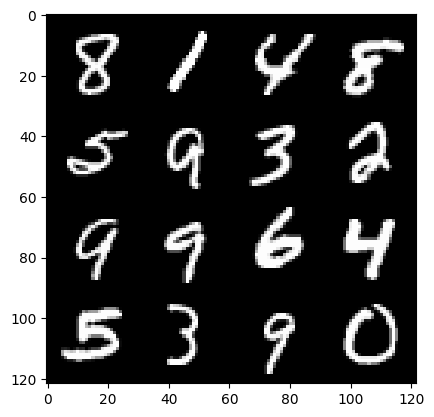

326: step 153300 / Gen loss 1.7653193497657758 / Disc loss 0.3321534289916356


  0%|          | 0/469 [00:00<?, ?it/s]

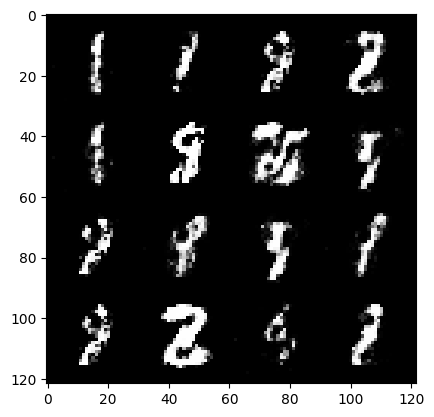

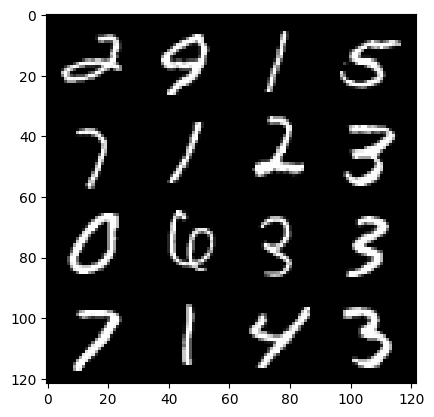

327: step 153600 / Gen loss 1.8213656552632653 / Disc loss 0.26799261336525276


  0%|          | 0/469 [00:00<?, ?it/s]

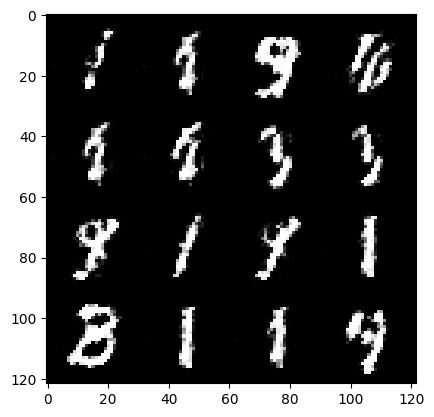

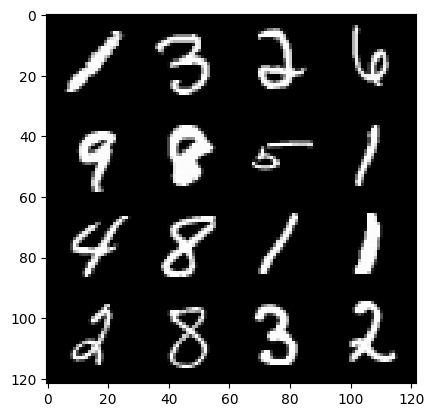

328: step 153900 / Gen loss 2.000315874814987 / Disc loss 0.2490015812218188


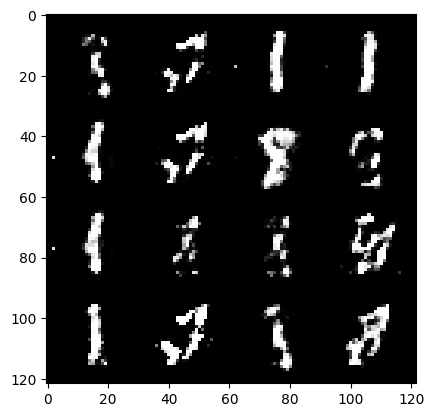

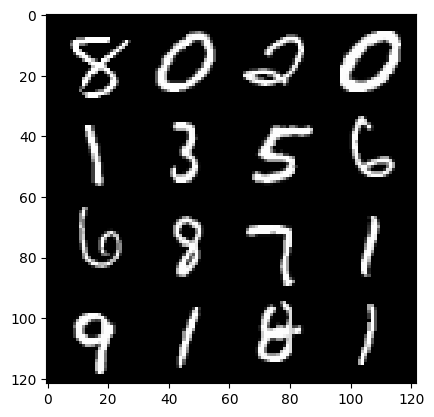

328: step 154200 / Gen loss 2.2540031723181397 / Disc loss 0.23237831721703195


  0%|          | 0/469 [00:00<?, ?it/s]

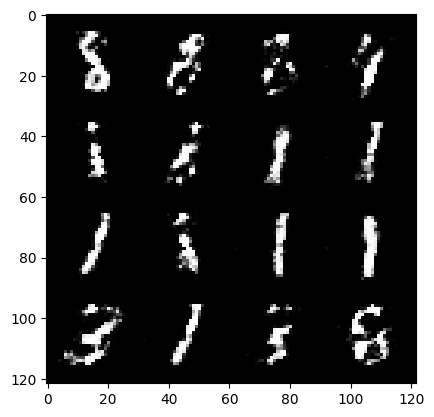

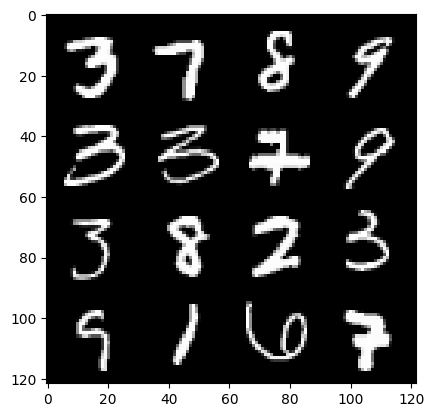

329: step 154500 / Gen loss 2.069532334804536 / Disc loss 0.2490766963859401


  0%|          | 0/469 [00:00<?, ?it/s]

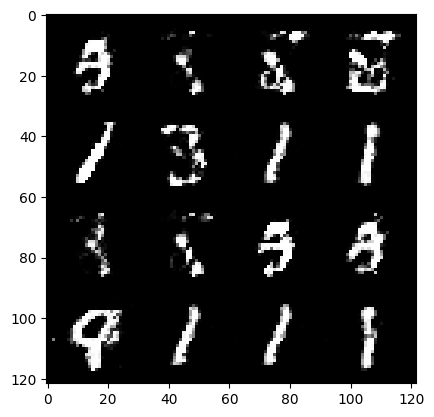

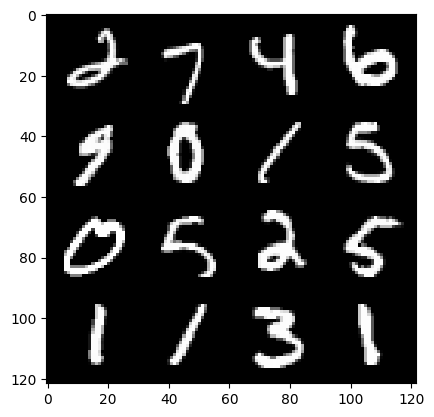

330: step 154800 / Gen loss 1.9939051997661592 / Disc loss 0.2781387634078663


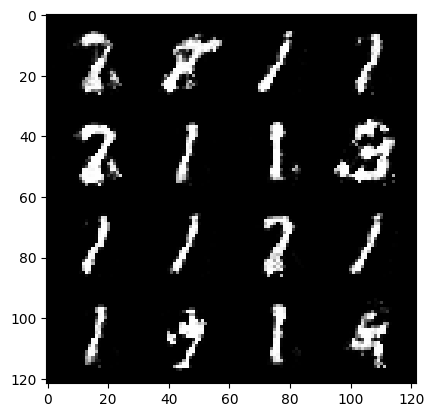

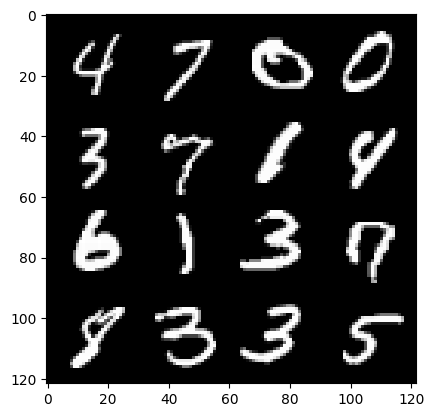

330: step 155100 / Gen loss 2.068676380713781 / Disc loss 0.2529488491018613


  0%|          | 0/469 [00:00<?, ?it/s]

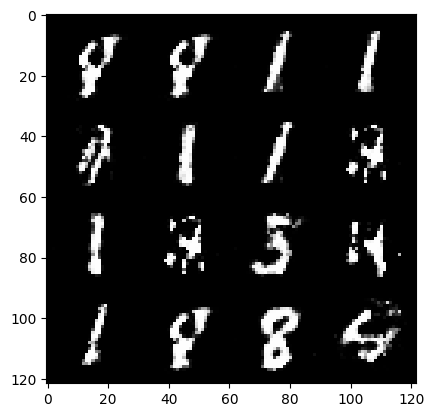

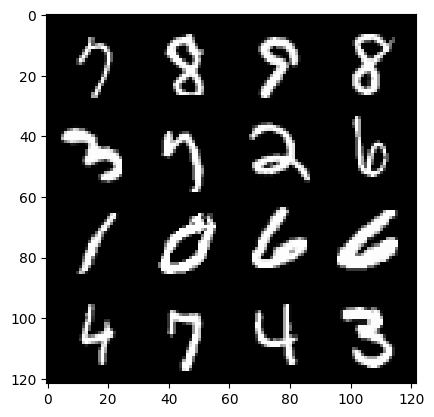

331: step 155400 / Gen loss 2.323079534769057 / Disc loss 0.25208842054009445


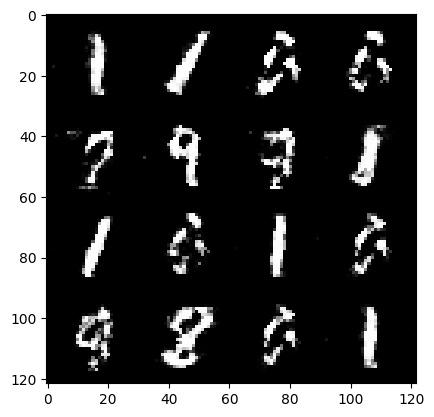

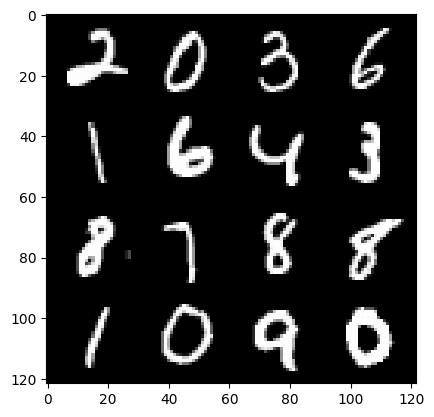

331: step 155700 / Gen loss 2.3352778391043345 / Disc loss 0.28245816970864923


  0%|          | 0/469 [00:00<?, ?it/s]

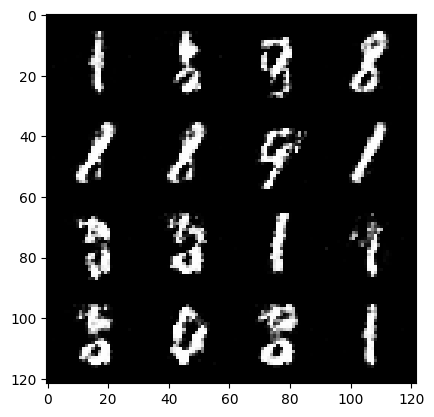

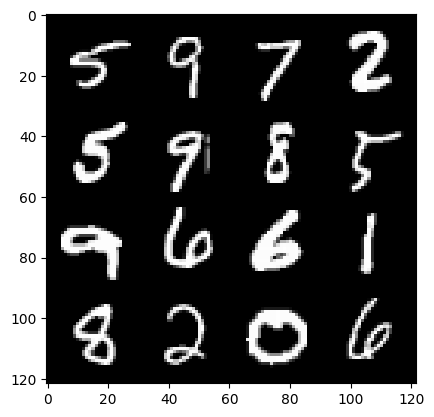

332: step 156000 / Gen loss 2.195457334518433 / Disc loss 0.2601503678162893


  0%|          | 0/469 [00:00<?, ?it/s]

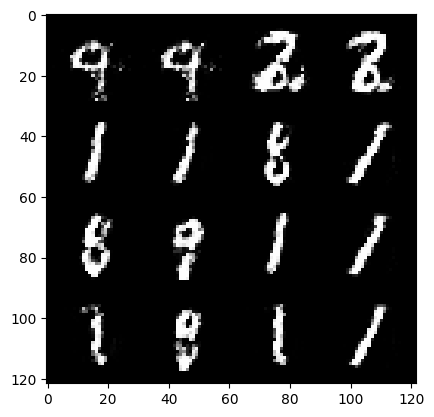

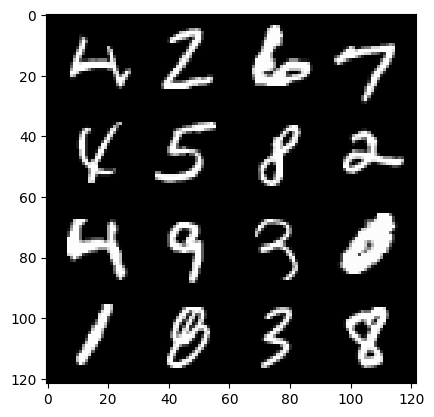

333: step 156300 / Gen loss 2.1921666646003706 / Disc loss 0.24096782123049085


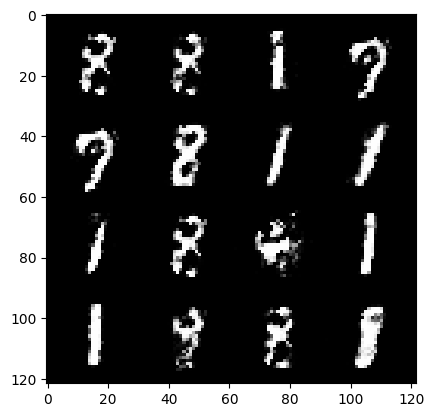

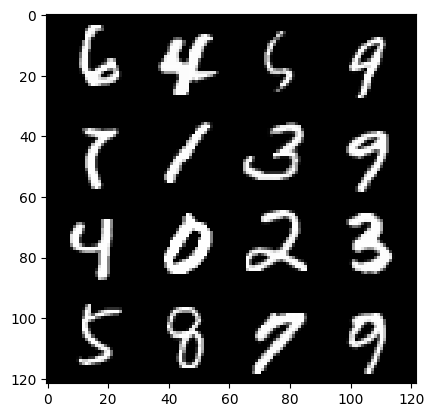

333: step 156600 / Gen loss 2.332106619675956 / Disc loss 0.2586682696143786


  0%|          | 0/469 [00:00<?, ?it/s]

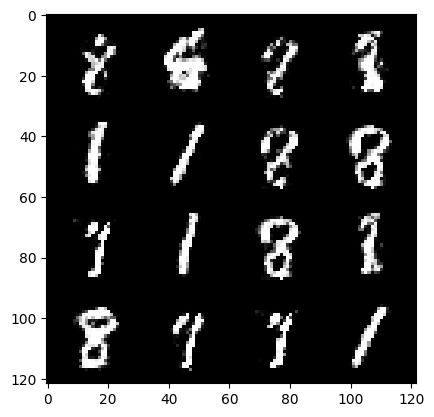

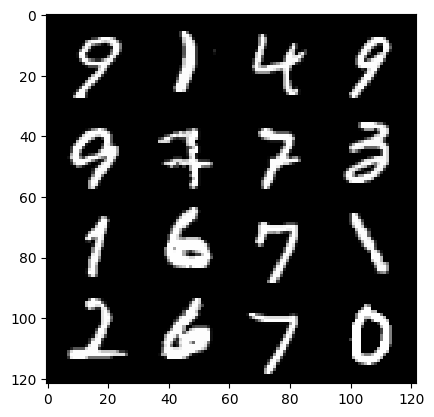

334: step 156900 / Gen loss 2.279413019021353 / Disc loss 0.2506798338890072


  0%|          | 0/469 [00:00<?, ?it/s]

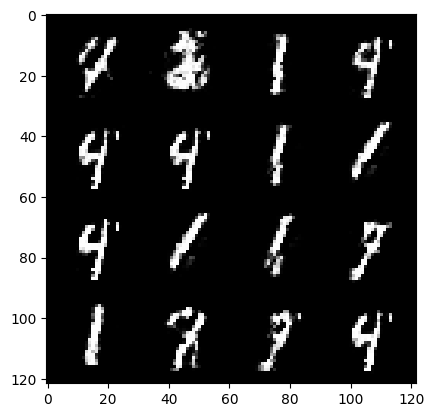

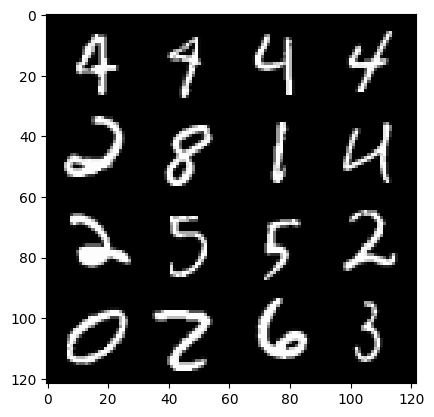

335: step 157200 / Gen loss 2.244642542203268 / Disc loss 0.2691417945921421


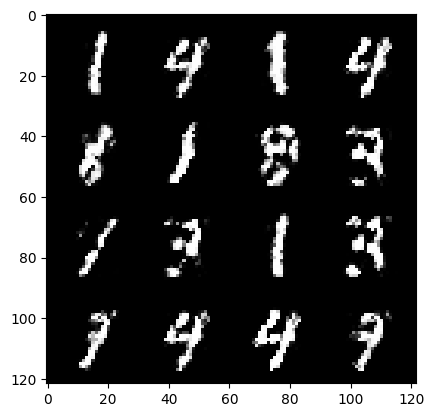

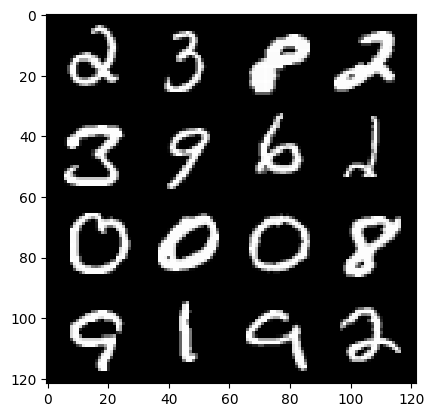

335: step 157500 / Gen loss 2.2893941450119026 / Disc loss 0.2355616082251071


  0%|          | 0/469 [00:00<?, ?it/s]

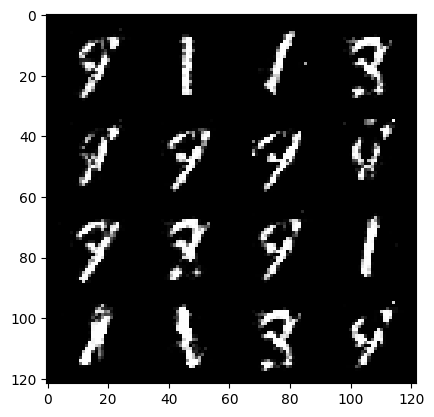

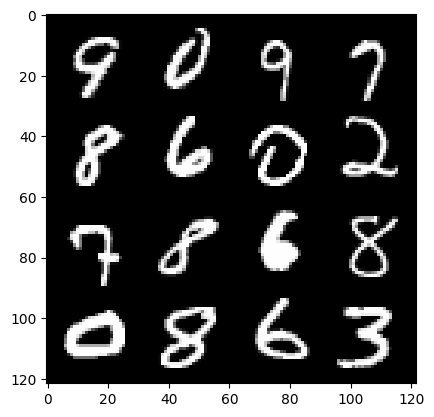

336: step 157800 / Gen loss 2.2398713672161095 / Disc loss 0.24009842346111937


  0%|          | 0/469 [00:00<?, ?it/s]

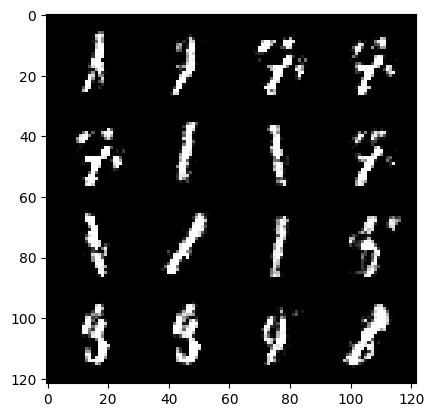

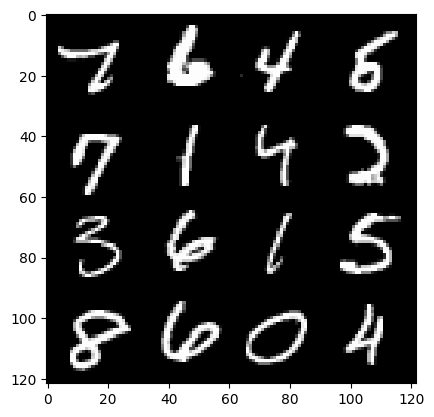

337: step 158100 / Gen loss 2.3043639036019616 / Disc loss 0.2507756603260835


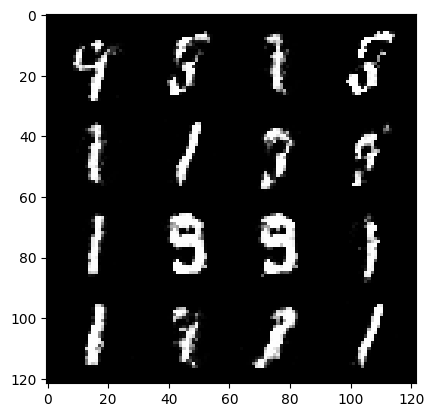

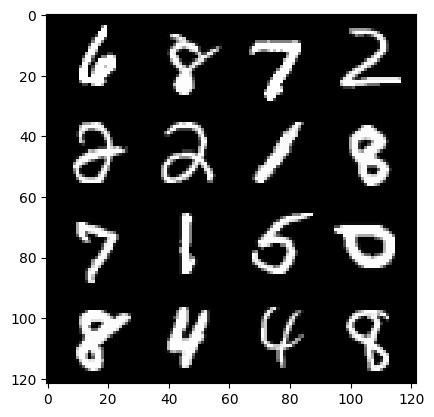

337: step 158400 / Gen loss 2.452743319670361 / Disc loss 0.24568384697039933


  0%|          | 0/469 [00:00<?, ?it/s]

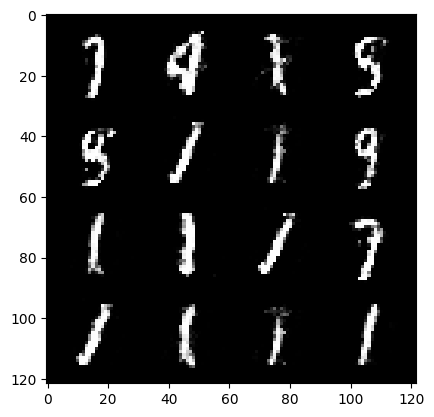

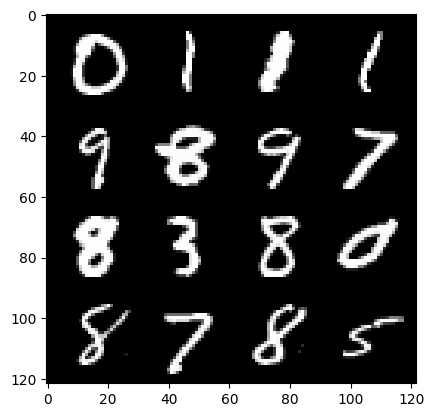

338: step 158700 / Gen loss 2.3325152174631754 / Disc loss 0.25519232744971915


  0%|          | 0/469 [00:00<?, ?it/s]

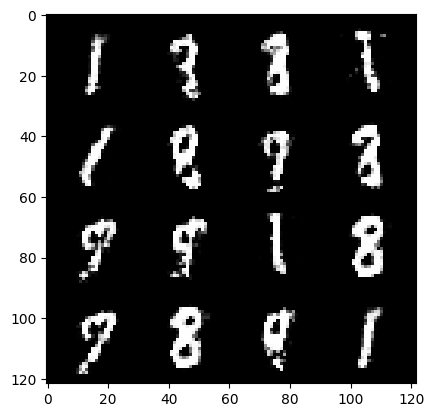

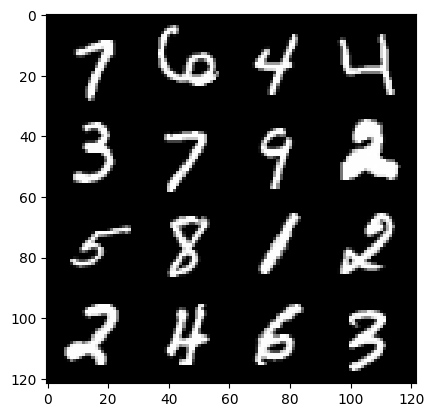

339: step 159000 / Gen loss 2.1785069386164353 / Disc loss 0.26736944595972706


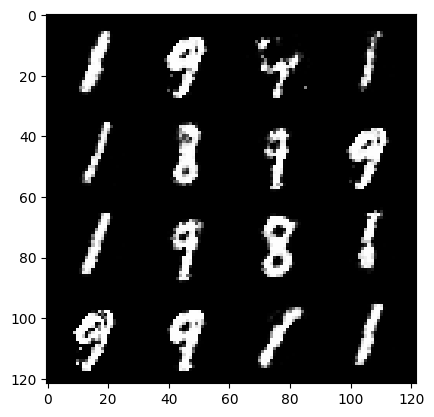

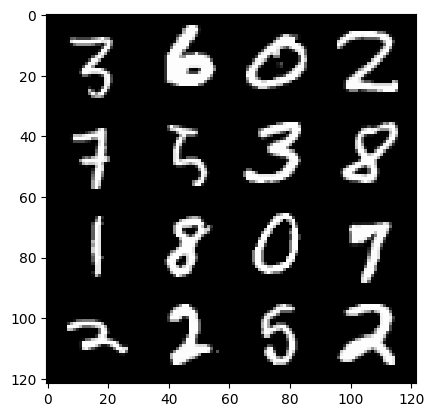

339: step 159300 / Gen loss 2.152615482012431 / Disc loss 0.26471385975678763


  0%|          | 0/469 [00:00<?, ?it/s]

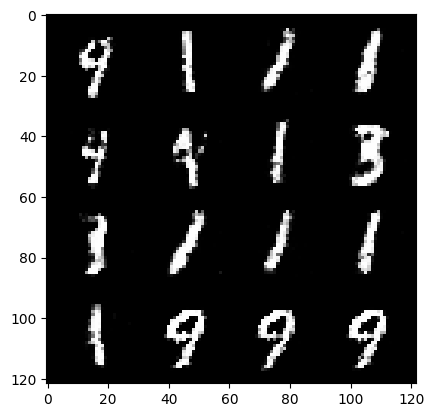

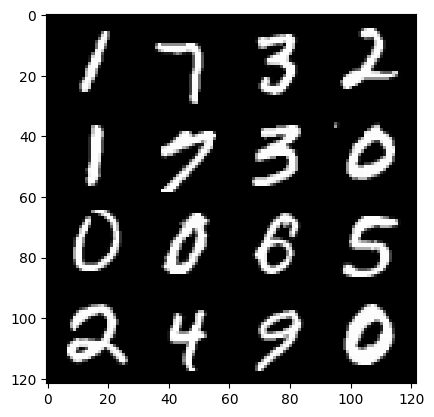

340: step 159600 / Gen loss 2.1446533608436575 / Disc loss 0.2678047230343023


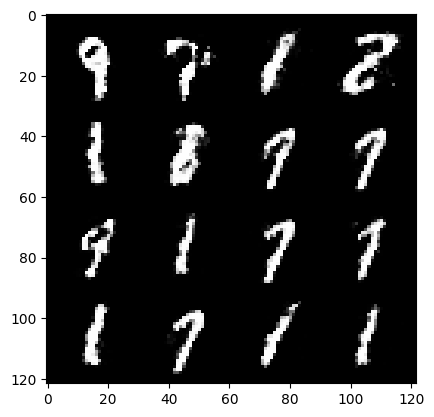

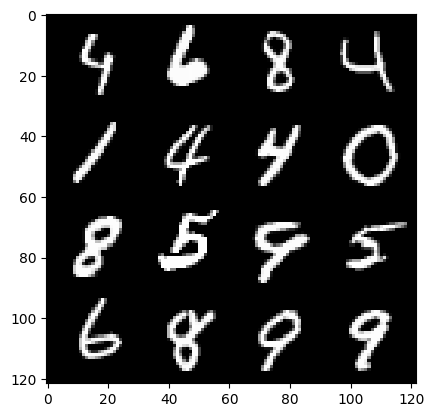

340: step 159900 / Gen loss 2.190514003833133 / Disc loss 0.2731119901935259


  0%|          | 0/469 [00:00<?, ?it/s]

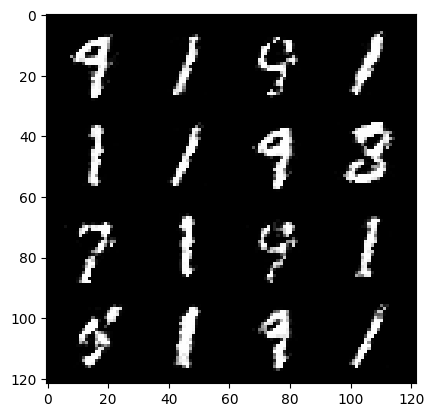

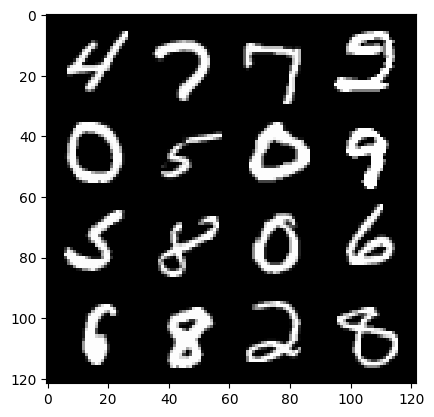

341: step 160200 / Gen loss 2.254605794350306 / Disc loss 0.2597051377097765


  0%|          | 0/469 [00:00<?, ?it/s]

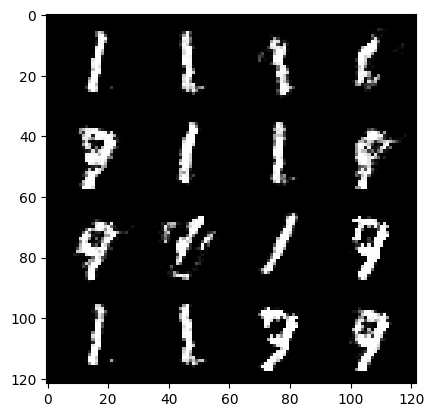

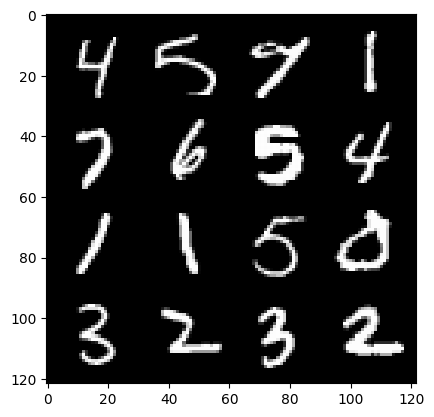

342: step 160500 / Gen loss 2.0907500052452077 / Disc loss 0.2679513034721216


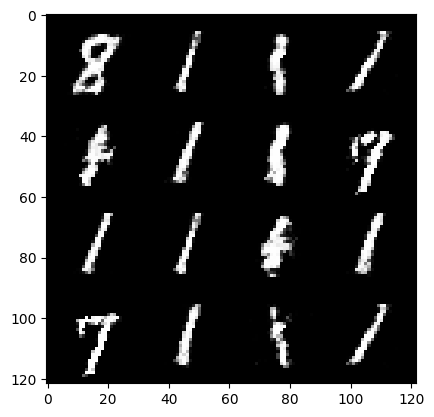

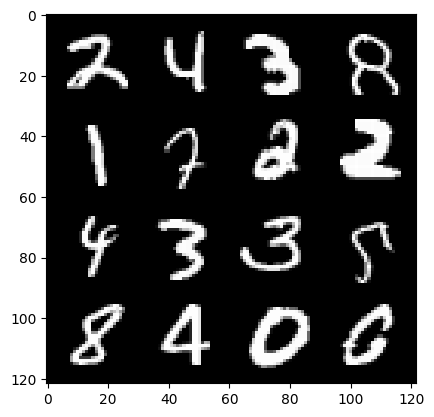

342: step 160800 / Gen loss 2.1083316572507216 / Disc loss 0.2643489882349969


  0%|          | 0/469 [00:00<?, ?it/s]

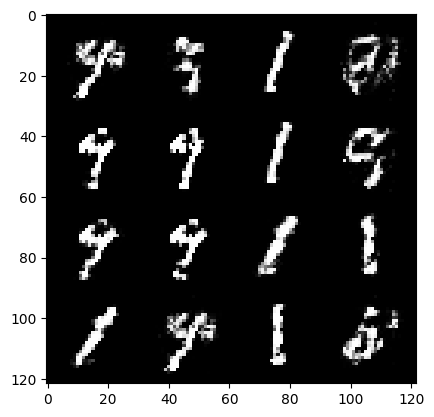

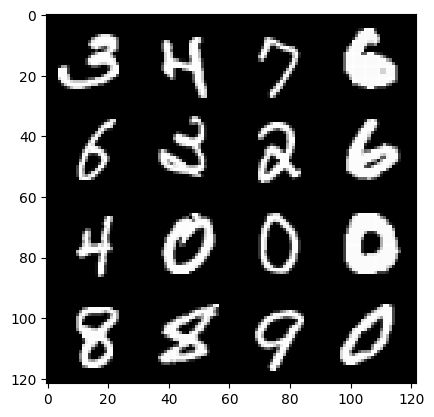

343: step 161100 / Gen loss 2.388696145613988 / Disc loss 0.24297266523043312


  0%|          | 0/469 [00:00<?, ?it/s]

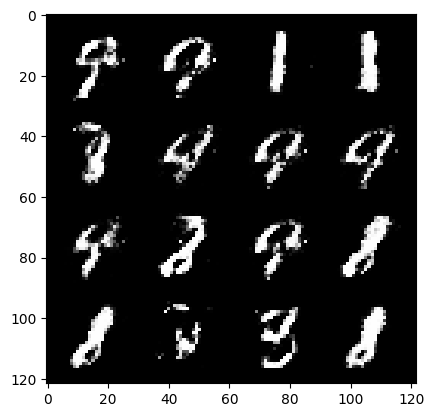

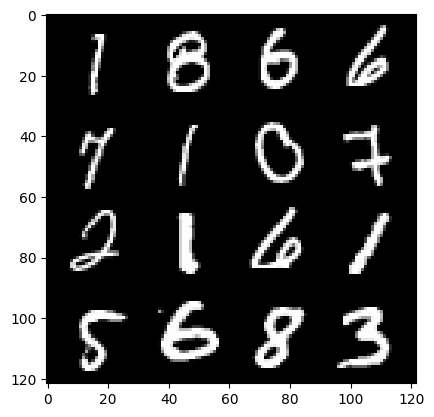

344: step 161400 / Gen loss 2.3054004498322804 / Disc loss 0.23423157840967188


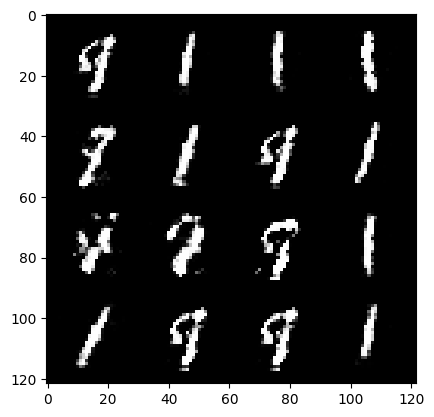

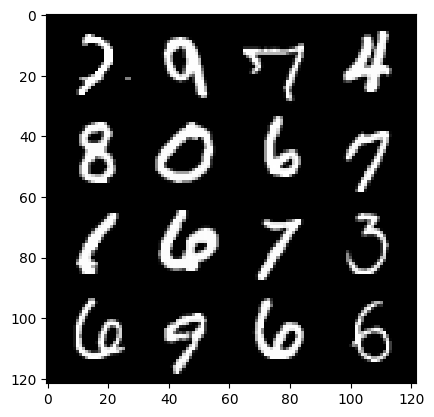

344: step 161700 / Gen loss 2.298399303356804 / Disc loss 0.23552977780501033


  0%|          | 0/469 [00:00<?, ?it/s]

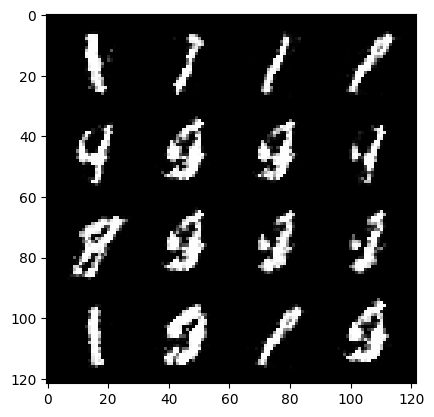

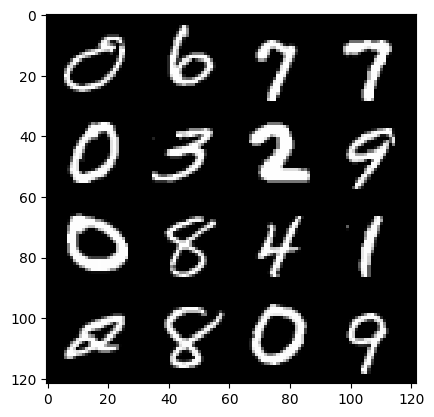

345: step 162000 / Gen loss 2.2642855091889693 / Disc loss 0.2359036376078923


  0%|          | 0/469 [00:00<?, ?it/s]

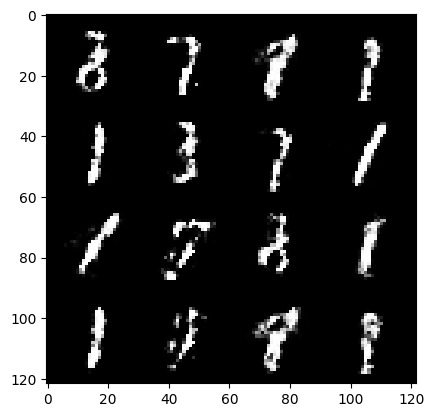

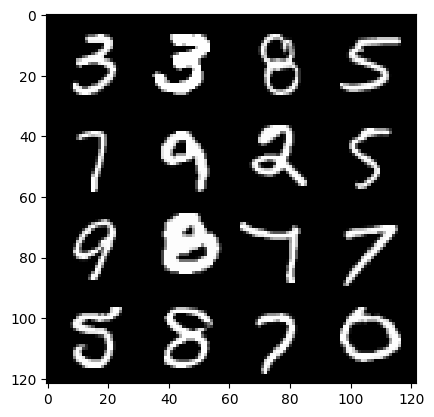

346: step 162300 / Gen loss 2.2525820620854717 / Disc loss 0.24103261590003966


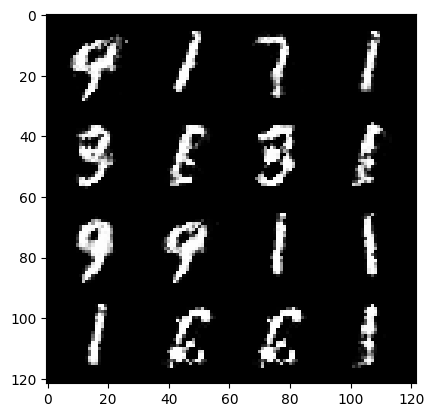

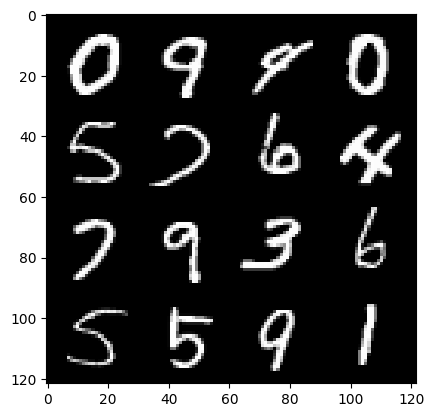

346: step 162600 / Gen loss 2.2847612309455854 / Disc loss 0.23109748775760325


  0%|          | 0/469 [00:00<?, ?it/s]

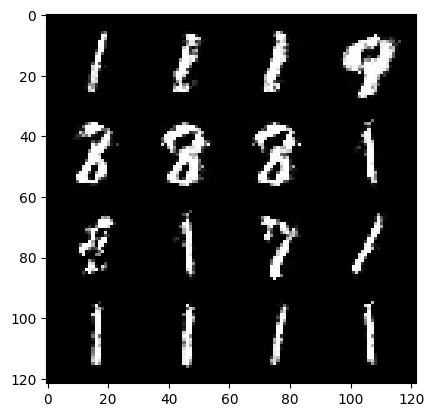

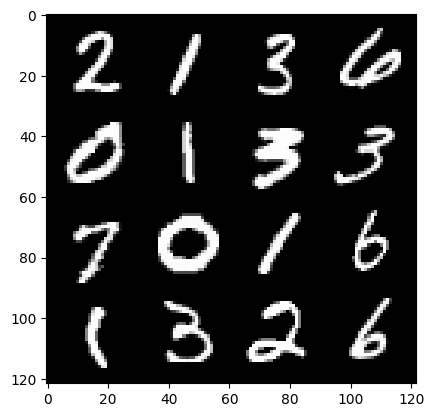

347: step 162900 / Gen loss 2.292980605761209 / Disc loss 0.24082566142082218


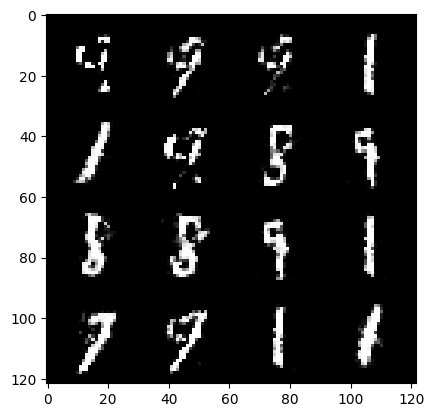

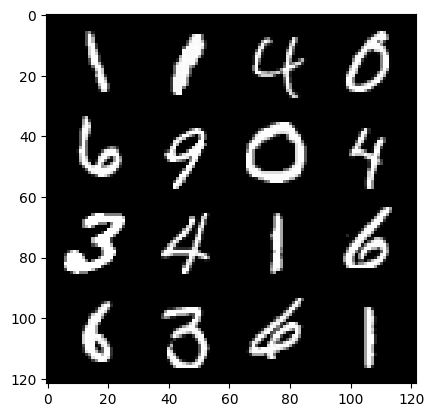

347: step 163200 / Gen loss 2.242157708009082 / Disc loss 0.24567749261856078


  0%|          | 0/469 [00:00<?, ?it/s]

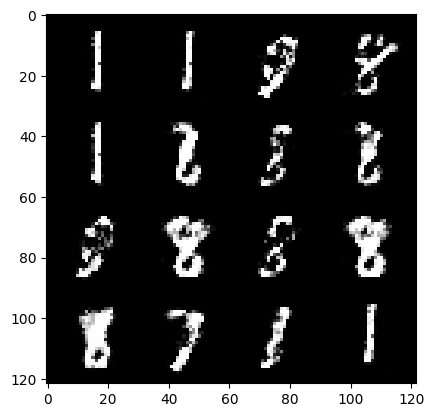

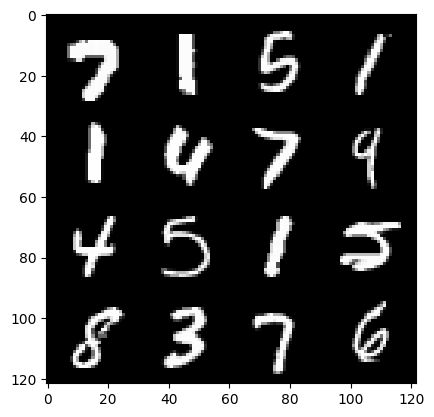

348: step 163500 / Gen loss 2.232687202692032 / Disc loss 0.2396973897516728


  0%|          | 0/469 [00:00<?, ?it/s]

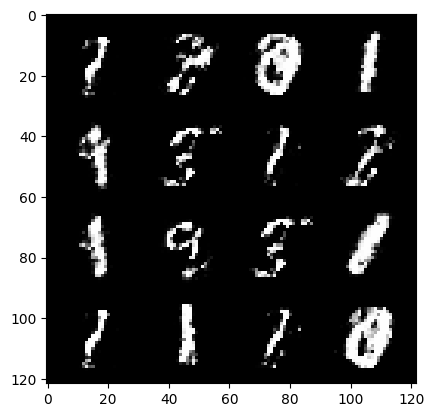

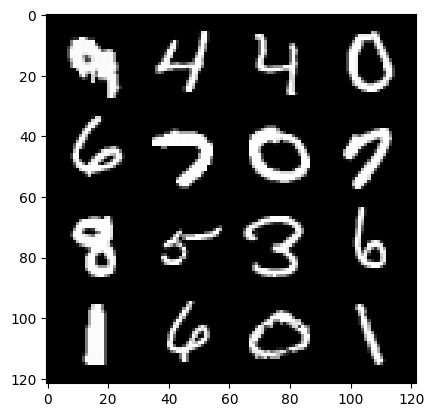

349: step 163800 / Gen loss 2.2493727540969846 / Disc loss 0.2442138992746673


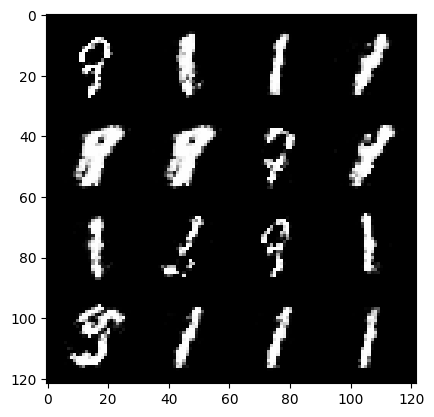

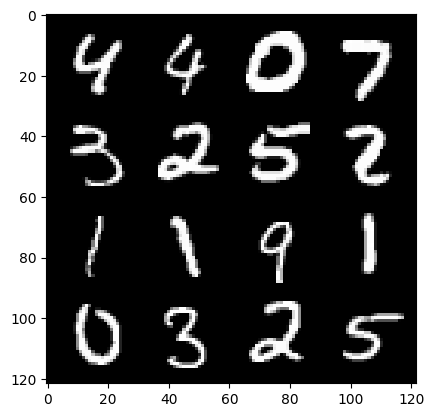

349: step 164100 / Gen loss 2.2539533881346387 / Disc loss 0.23489224856098484


  0%|          | 0/469 [00:00<?, ?it/s]

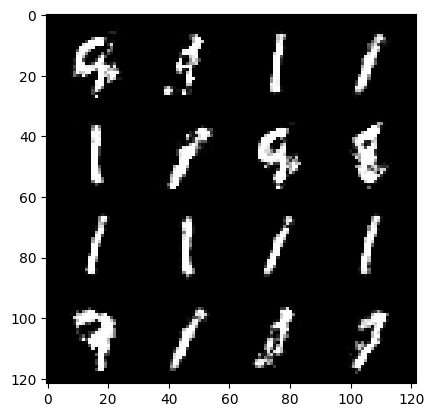

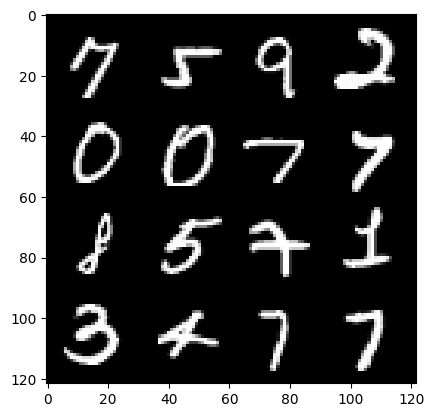

350: step 164400 / Gen loss 2.116037581364314 / Disc loss 0.2680579588313899


  0%|          | 0/469 [00:00<?, ?it/s]

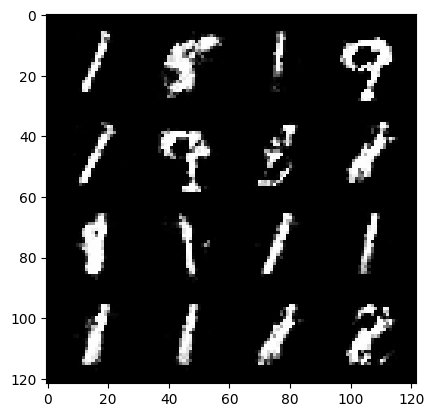

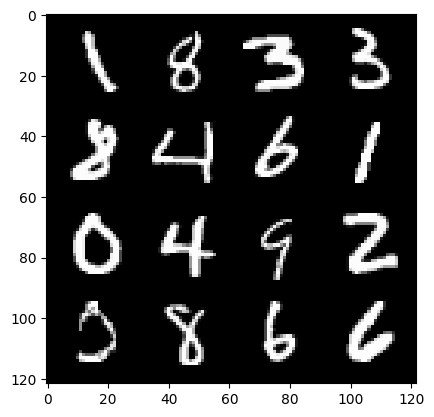

351: step 164700 / Gen loss 2.0902331340312967 / Disc loss 0.2701670017341775


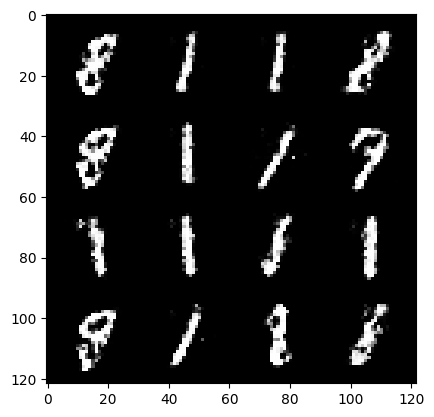

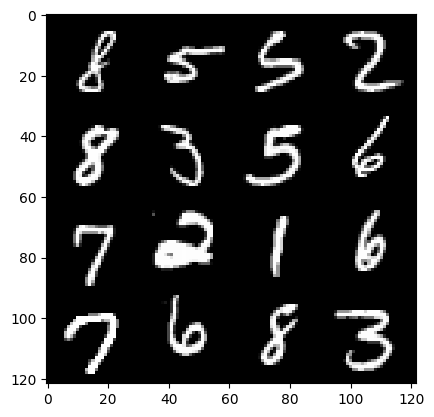

351: step 165000 / Gen loss 2.002900734345119 / Disc loss 0.2676453632613021


  0%|          | 0/469 [00:00<?, ?it/s]

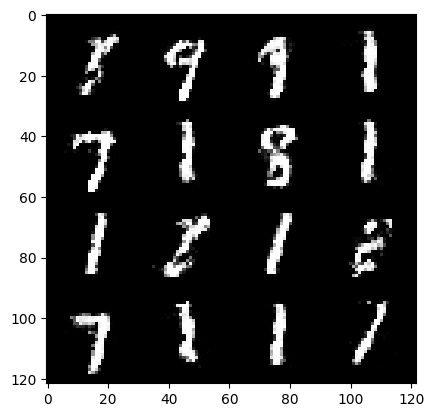

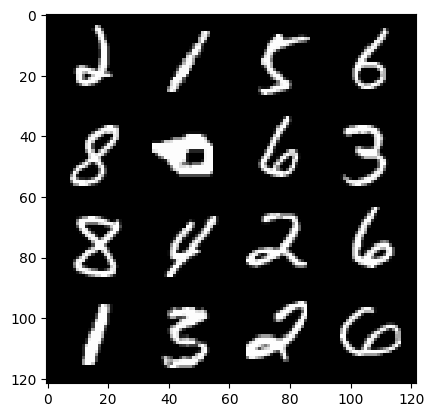

352: step 165300 / Gen loss 2.0739822578430167 / Disc loss 0.268311730871598


  0%|          | 0/469 [00:00<?, ?it/s]

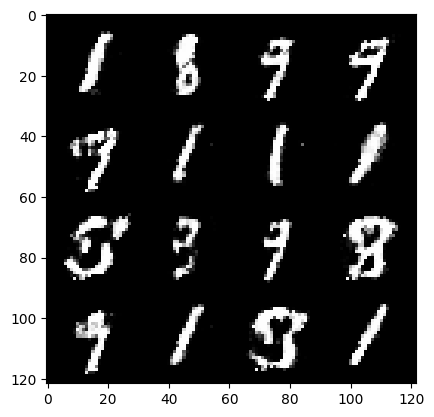

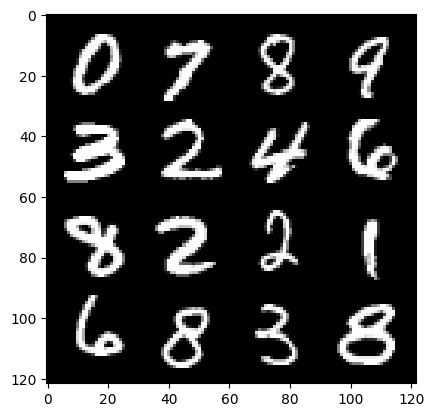

353: step 165600 / Gen loss 2.147797365983327 / Disc loss 0.27812626207868246


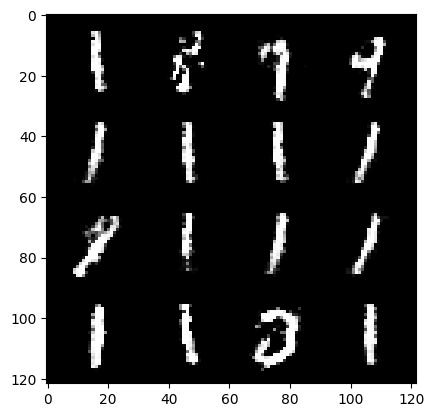

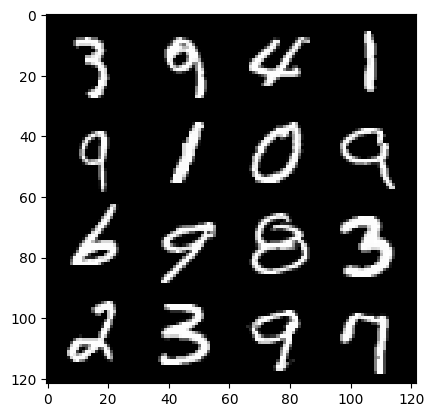

353: step 165900 / Gen loss 2.131826204856236 / Disc loss 0.257193933427334


  0%|          | 0/469 [00:00<?, ?it/s]

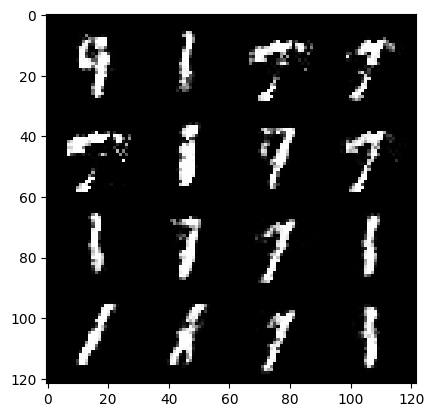

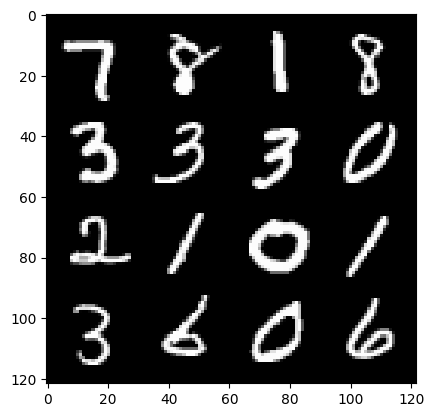

354: step 166200 / Gen loss 2.1159314203262336 / Disc loss 0.26155378848314303


  0%|          | 0/469 [00:00<?, ?it/s]

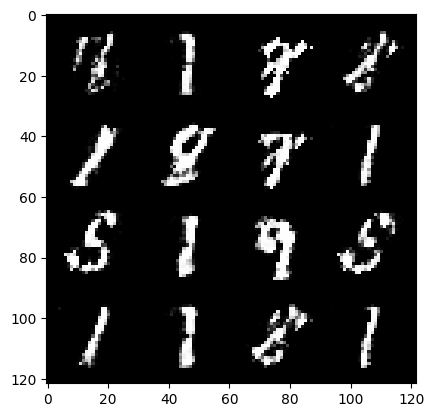

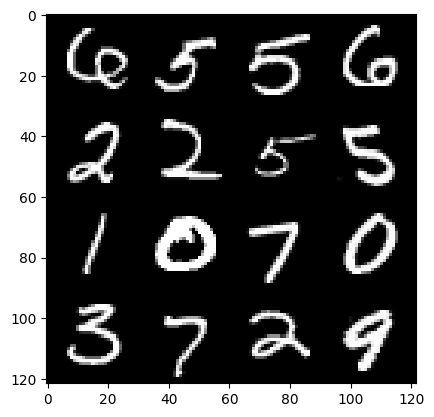

355: step 166500 / Gen loss 2.0520989100138354 / Disc loss 0.2785912284255028


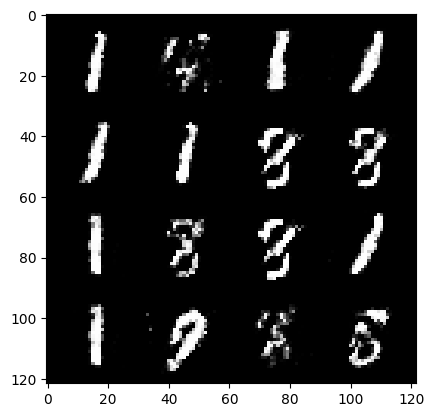

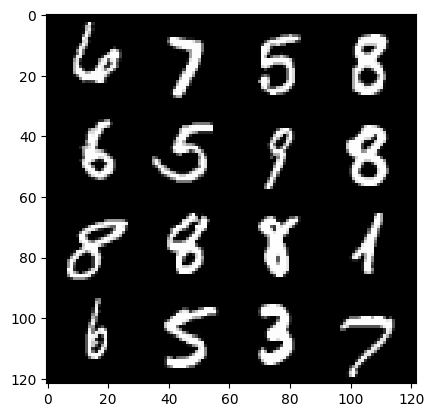

355: step 166800 / Gen loss 2.1596480099360145 / Disc loss 0.25940935765703516


  0%|          | 0/469 [00:00<?, ?it/s]

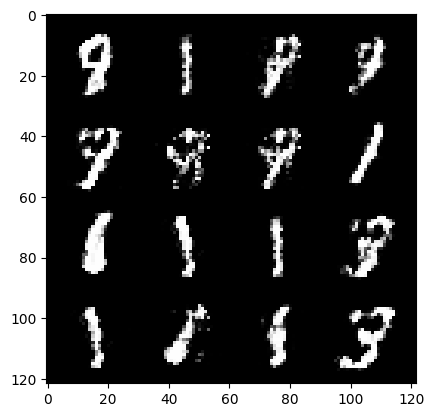

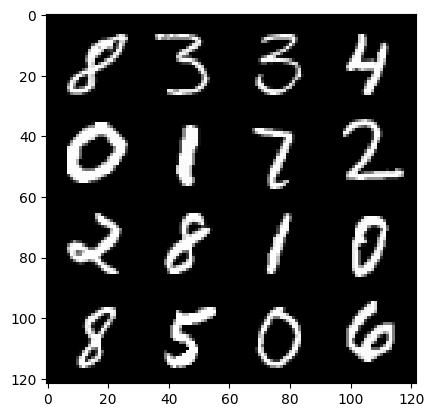

356: step 167100 / Gen loss 2.264213774998983 / Disc loss 0.24789423227310198


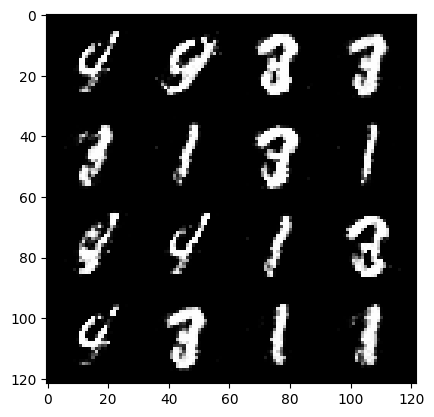

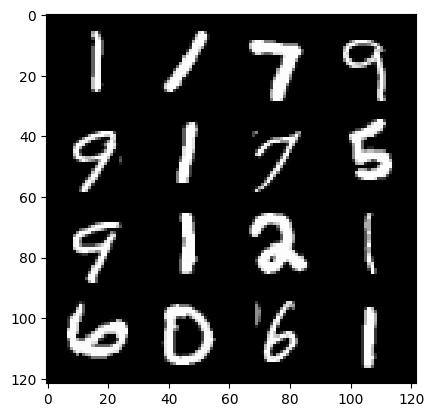

356: step 167400 / Gen loss 2.3536663472652433 / Disc loss 0.23934441149234773


  0%|          | 0/469 [00:00<?, ?it/s]

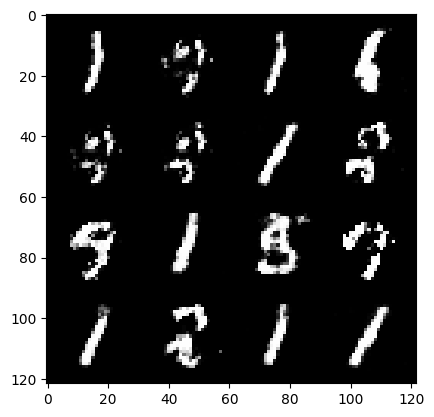

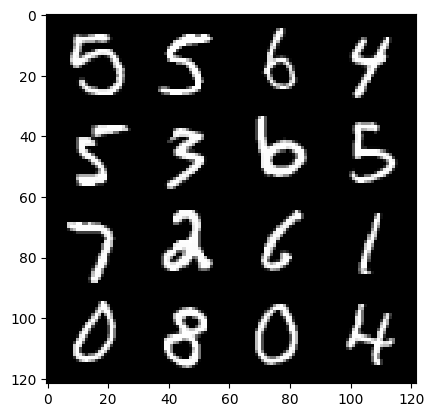

357: step 167700 / Gen loss 2.5130953462918577 / Disc loss 0.21758196026086812


  0%|          | 0/469 [00:00<?, ?it/s]

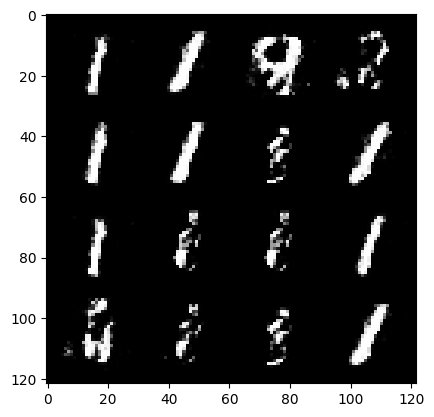

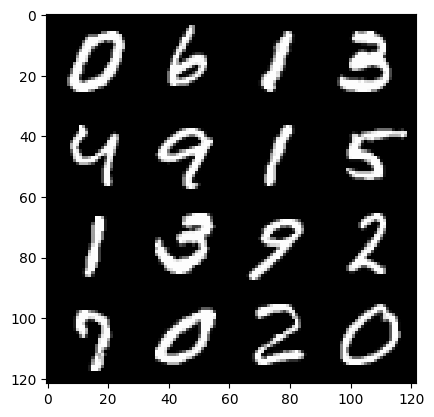

358: step 168000 / Gen loss 2.408522117932638 / Disc loss 0.22981294944882388


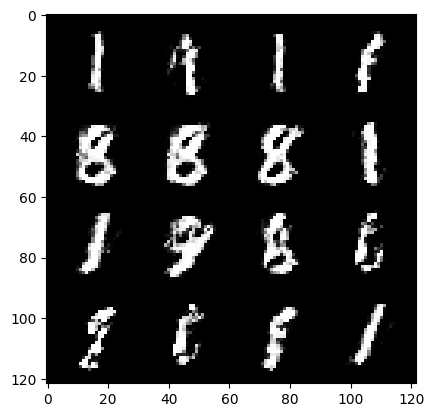

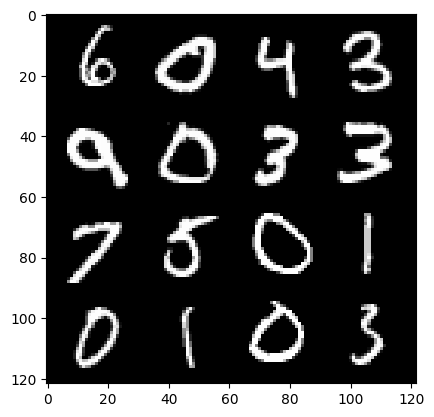

358: step 168300 / Gen loss 2.332723911205929 / Disc loss 0.24199866255124416


  0%|          | 0/469 [00:00<?, ?it/s]

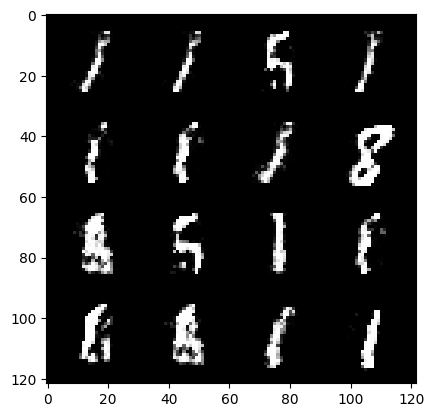

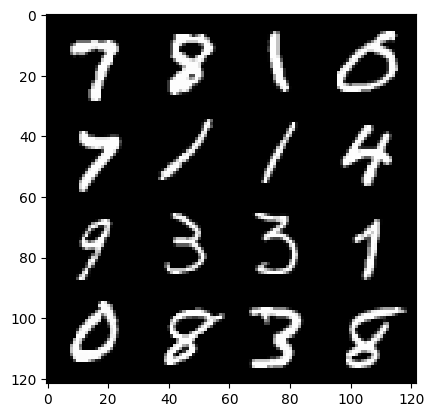

359: step 168600 / Gen loss 2.325482164621354 / Disc loss 0.2360664401948451


  0%|          | 0/469 [00:00<?, ?it/s]

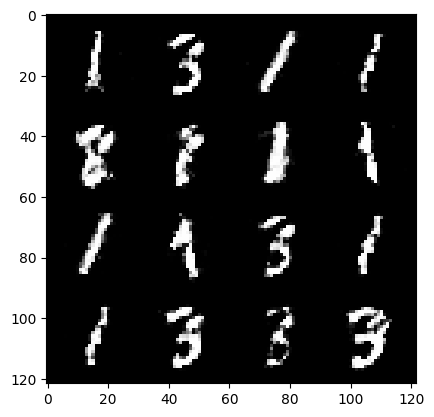

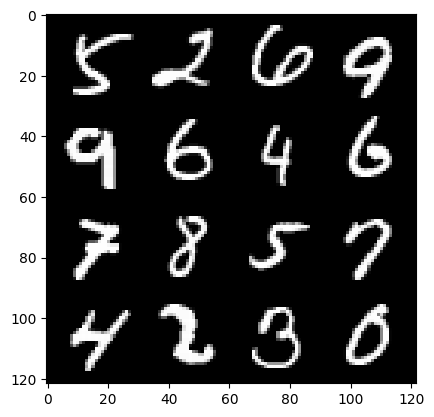

360: step 168900 / Gen loss 2.2846208349863697 / Disc loss 0.23530575608213752


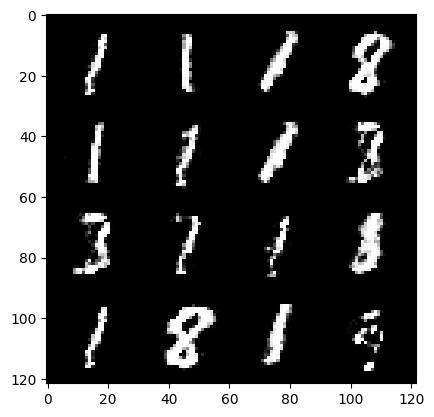

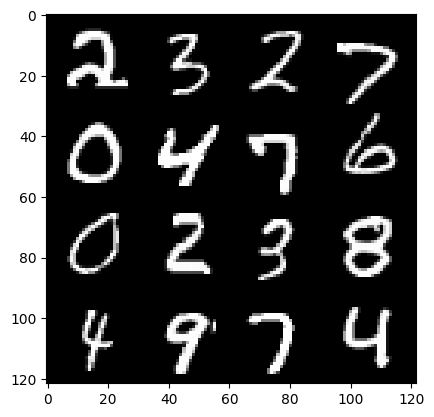

360: step 169200 / Gen loss 2.3350986695289637 / Disc loss 0.22476898215711116


  0%|          | 0/469 [00:00<?, ?it/s]

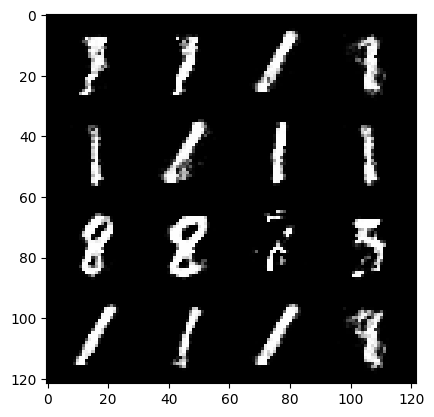

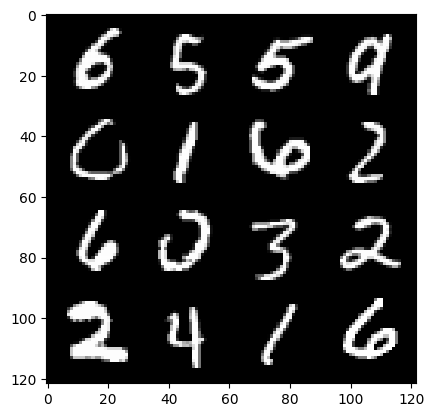

361: step 169500 / Gen loss 2.262915613253911 / Disc loss 0.24183332473039618


  0%|          | 0/469 [00:00<?, ?it/s]

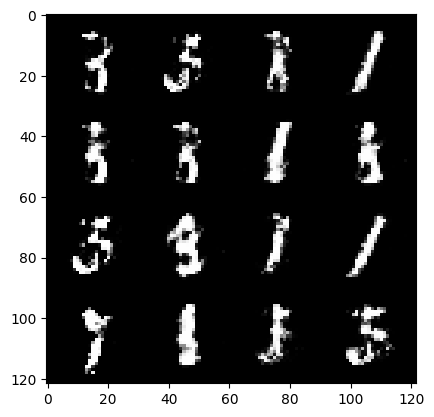

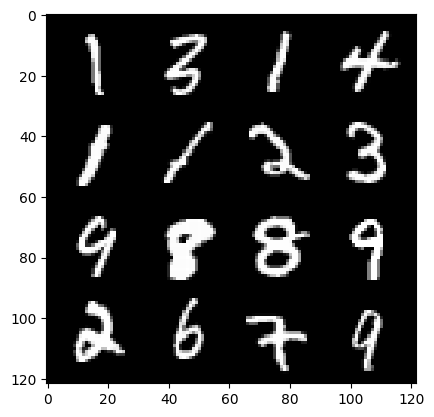

362: step 169800 / Gen loss 2.1829476698239643 / Disc loss 0.2529371190071106


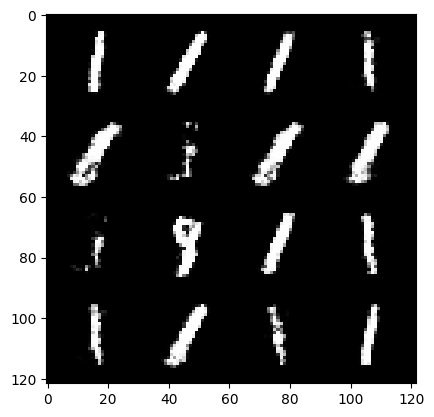

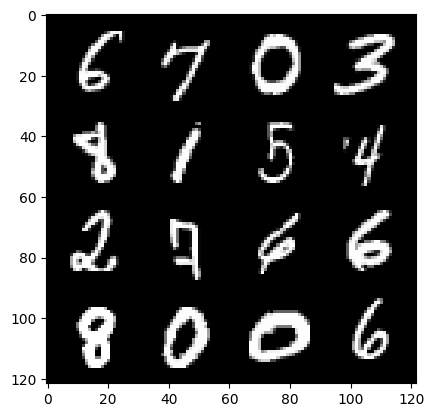

362: step 170100 / Gen loss 2.1610354459285728 / Disc loss 0.23998445962866155


  0%|          | 0/469 [00:00<?, ?it/s]

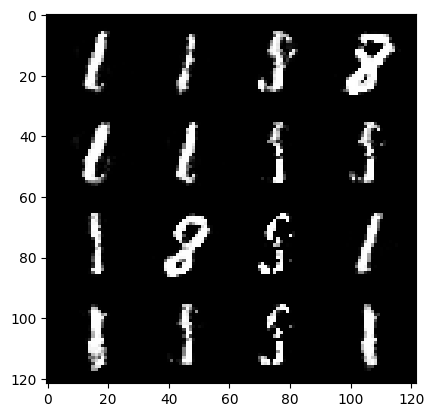

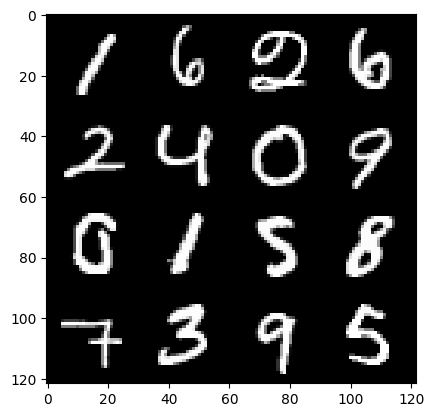

363: step 170400 / Gen loss 2.2384177756309516 / Disc loss 0.22795457849899906


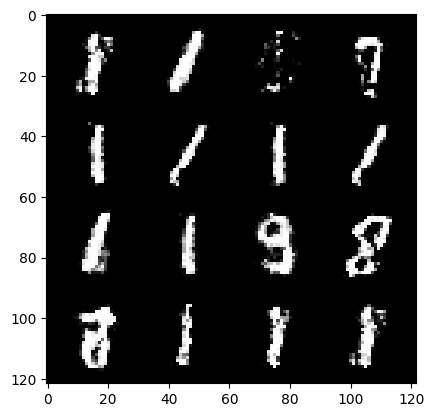

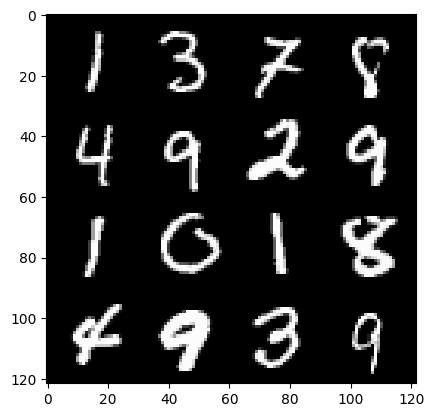

363: step 170700 / Gen loss 2.1606094654401136 / Disc loss 0.25010177905360853


  0%|          | 0/469 [00:00<?, ?it/s]

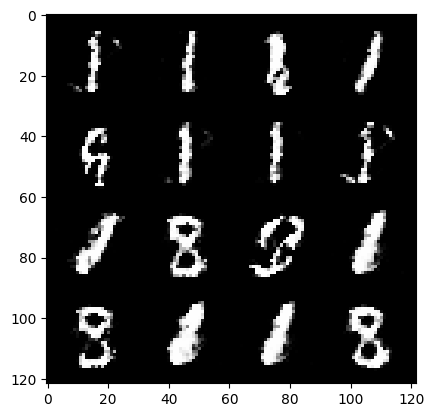

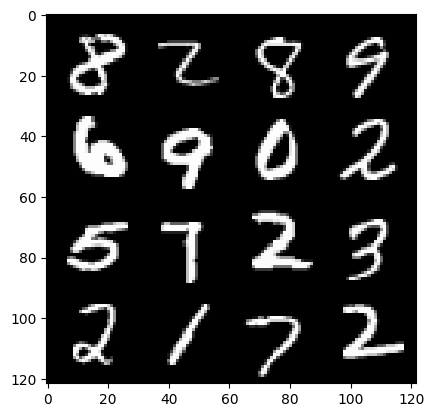

364: step 171000 / Gen loss 2.076670053402582 / Disc loss 0.25134220461050666


  0%|          | 0/469 [00:00<?, ?it/s]

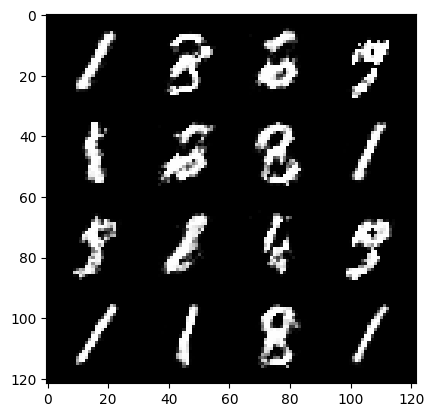

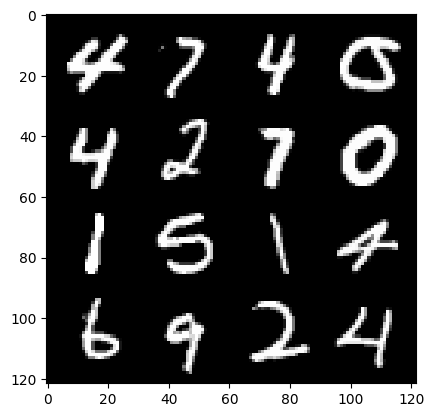

365: step 171300 / Gen loss 2.124574186801911 / Disc loss 0.24494344914952923


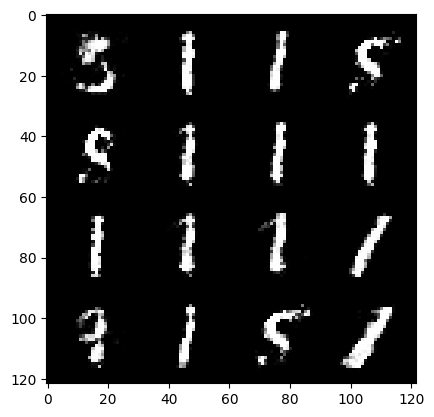

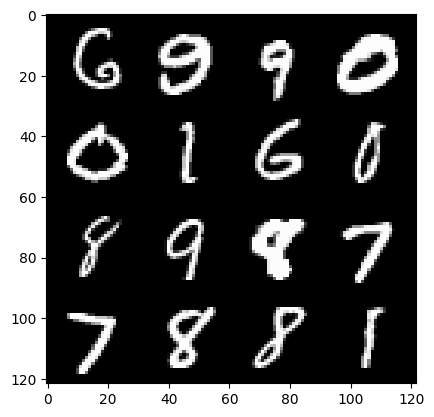

365: step 171600 / Gen loss 2.2099612017472596 / Disc loss 0.2611520848174889


  0%|          | 0/469 [00:00<?, ?it/s]

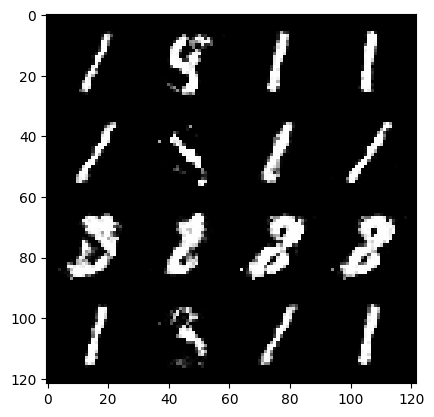

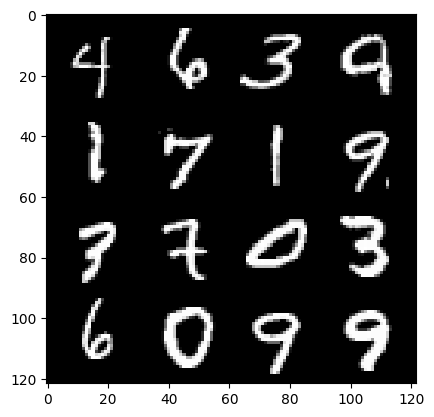

366: step 171900 / Gen loss 2.2854094115893027 / Disc loss 0.24384263053536412


  0%|          | 0/469 [00:00<?, ?it/s]

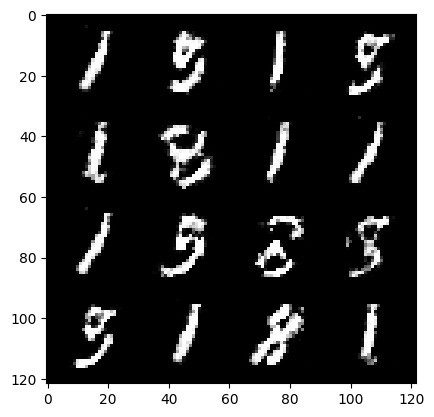

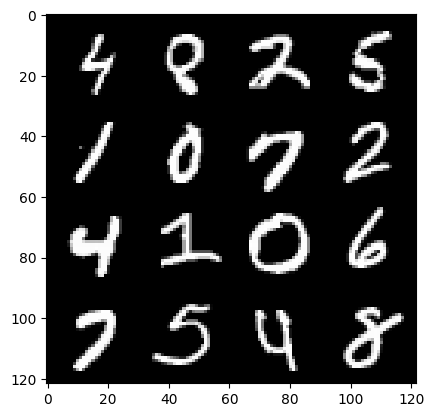

367: step 172200 / Gen loss 2.233678825696308 / Disc loss 0.24923499822616588


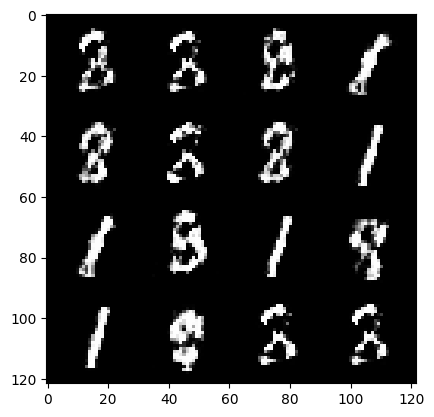

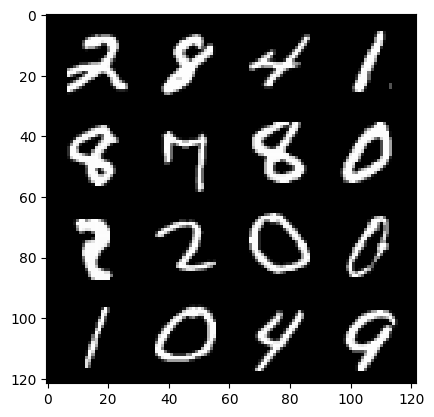

367: step 172500 / Gen loss 2.247921820481619 / Disc loss 0.23632698779304834


  0%|          | 0/469 [00:00<?, ?it/s]

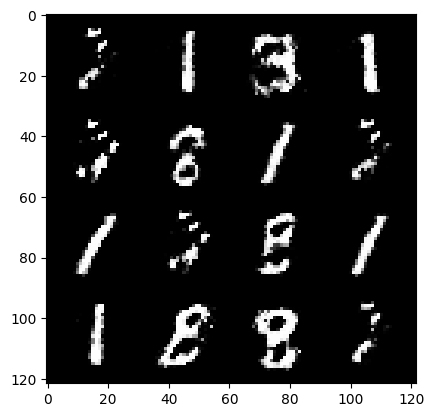

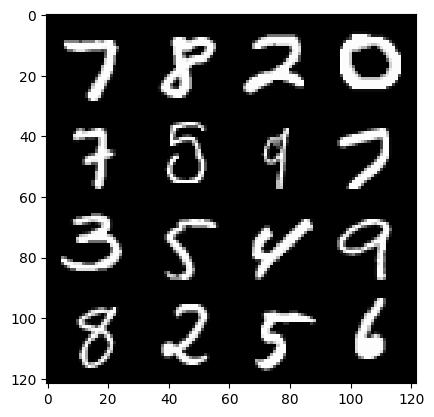

368: step 172800 / Gen loss 2.4770559763908397 / Disc loss 0.21391632840037336


  0%|          | 0/469 [00:00<?, ?it/s]

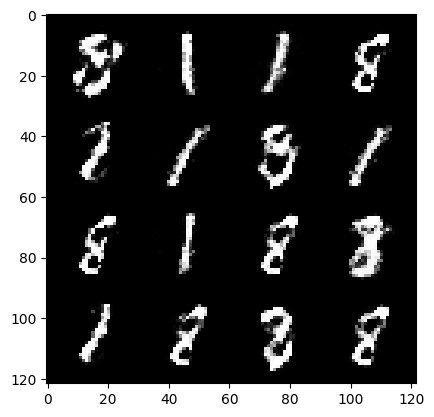

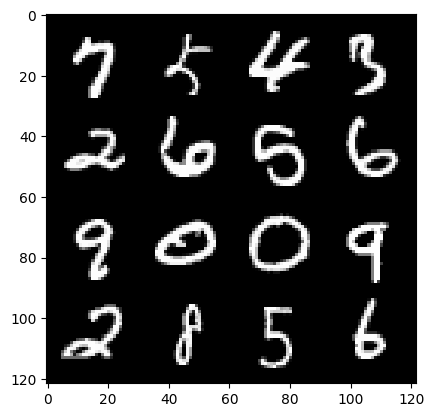

369: step 173100 / Gen loss 2.2556454642613732 / Disc loss 0.24135047117869074


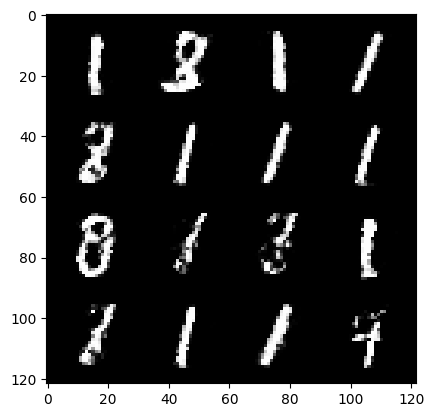

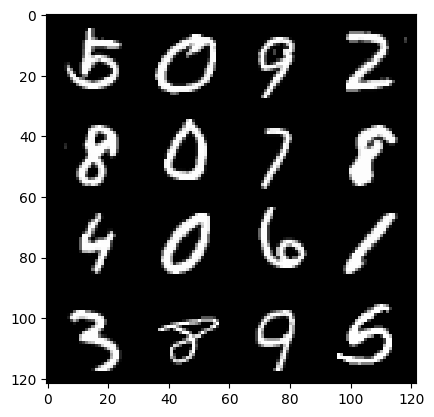

369: step 173400 / Gen loss 2.2784787766138725 / Disc loss 0.2332925426463285


  0%|          | 0/469 [00:00<?, ?it/s]

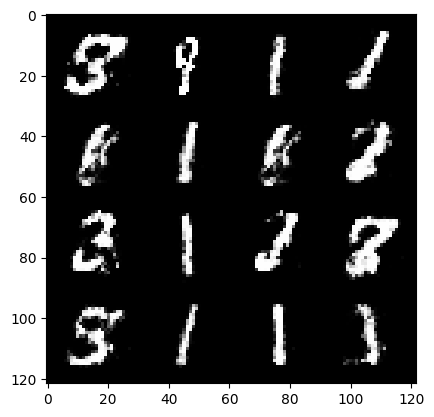

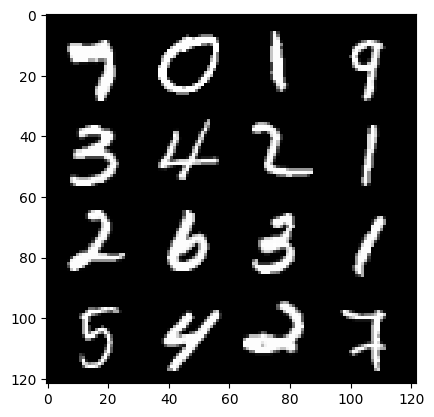

370: step 173700 / Gen loss 2.2880659206708285 / Disc loss 0.23498979250590027


  0%|          | 0/469 [00:00<?, ?it/s]

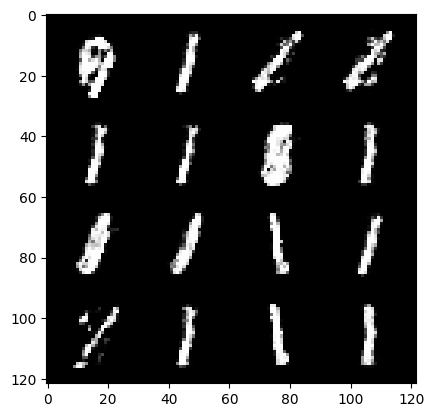

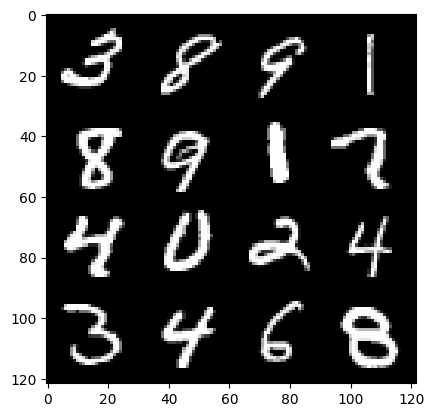

371: step 174000 / Gen loss 2.2604263353347775 / Disc loss 0.2382978514333566


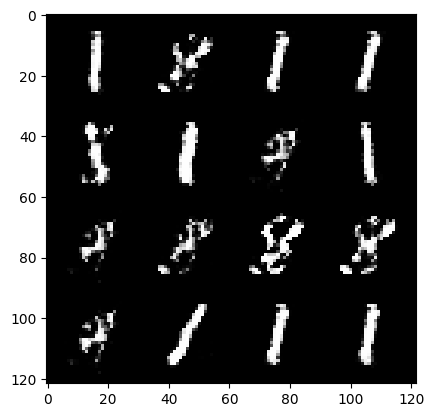

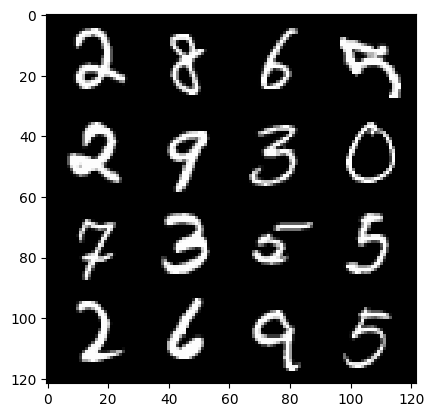

371: step 174300 / Gen loss 2.295126854976018 / Disc loss 0.2330453191697597


  0%|          | 0/469 [00:00<?, ?it/s]

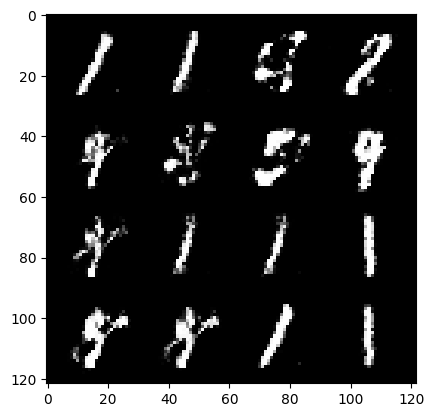

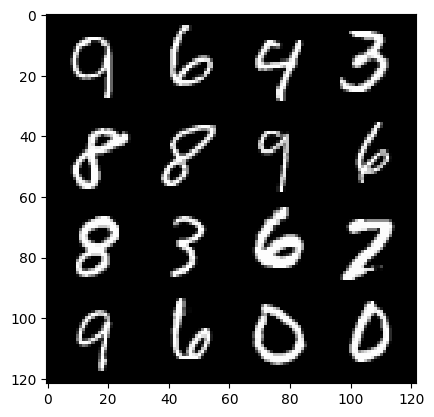

372: step 174600 / Gen loss 2.325497907002768 / Disc loss 0.22630898550152795


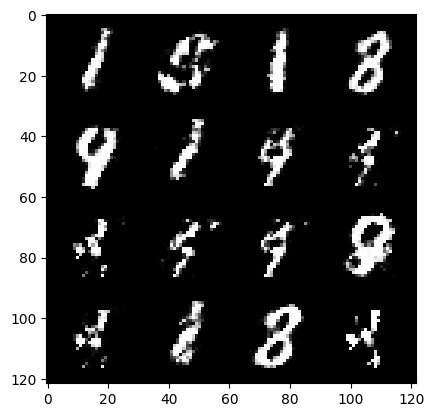

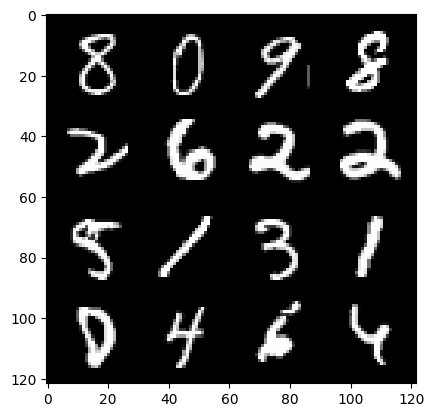

372: step 174900 / Gen loss 2.169616595506666 / Disc loss 0.2456176953514416


  0%|          | 0/469 [00:00<?, ?it/s]

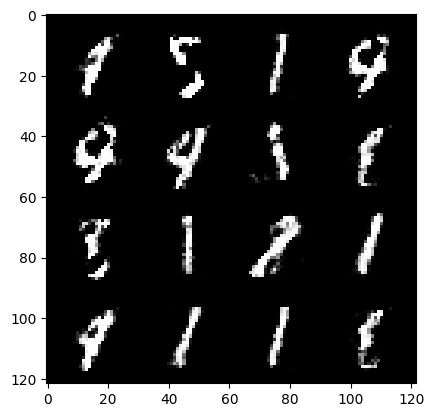

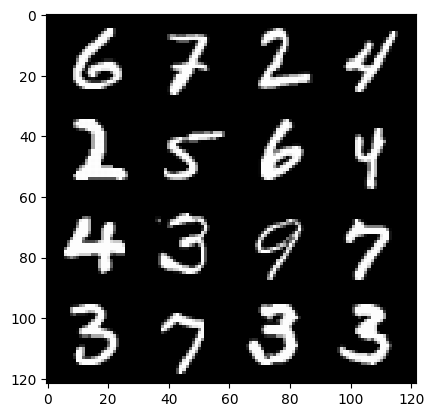

373: step 175200 / Gen loss 2.146170057058334 / Disc loss 0.26875919555624345


  0%|          | 0/469 [00:00<?, ?it/s]

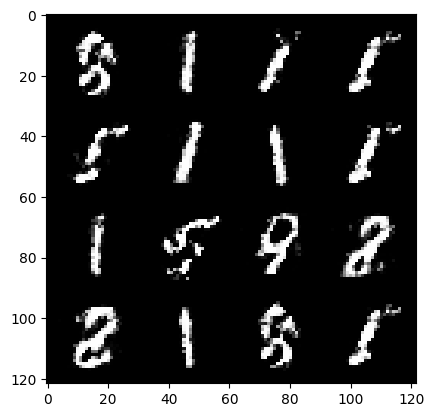

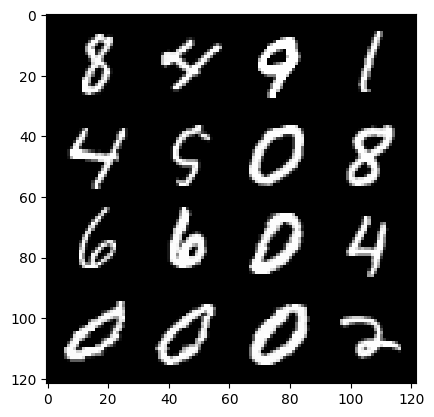

374: step 175500 / Gen loss 2.2892622907956444 / Disc loss 0.24315672864516563


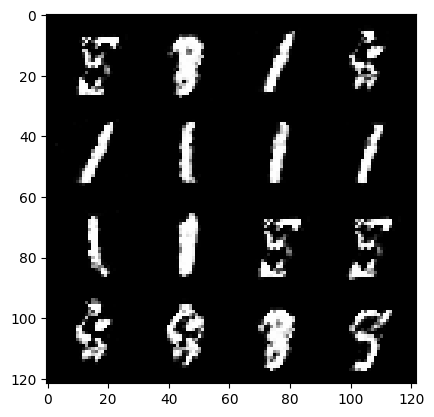

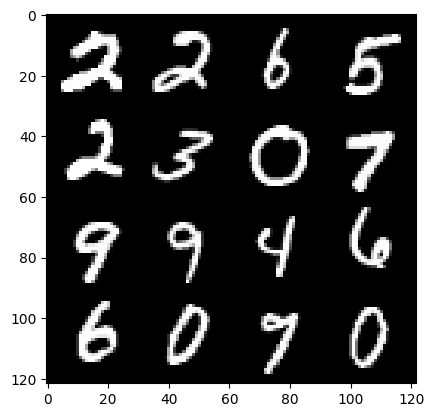

374: step 175800 / Gen loss 2.211419954299926 / Disc loss 0.24396466617782897


  0%|          | 0/469 [00:00<?, ?it/s]

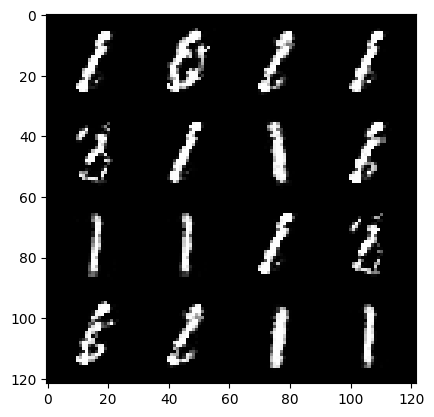

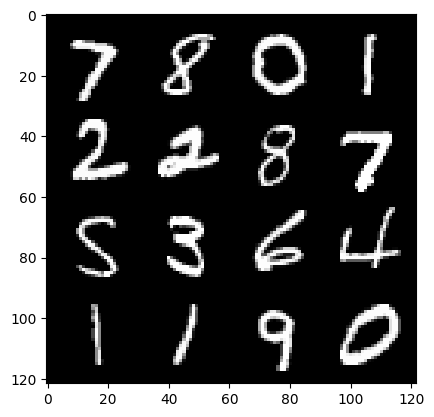

375: step 176100 / Gen loss 2.2766572368144975 / Disc loss 0.22956943725546214


  0%|          | 0/469 [00:00<?, ?it/s]

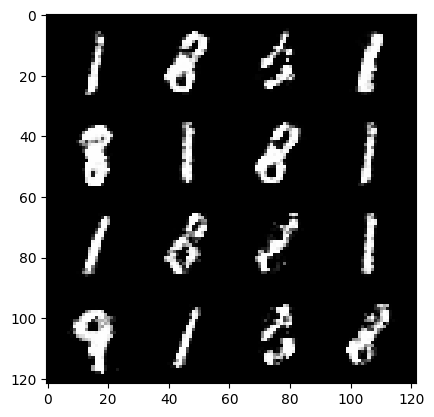

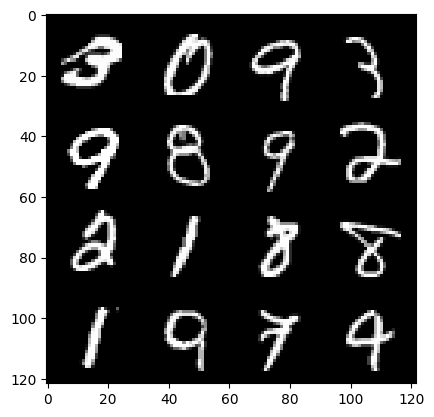

376: step 176400 / Gen loss 2.236194401184719 / Disc loss 0.22765921826163932


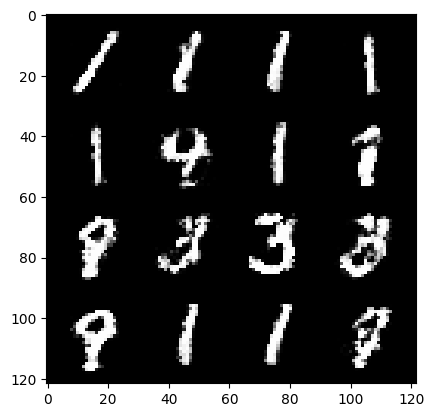

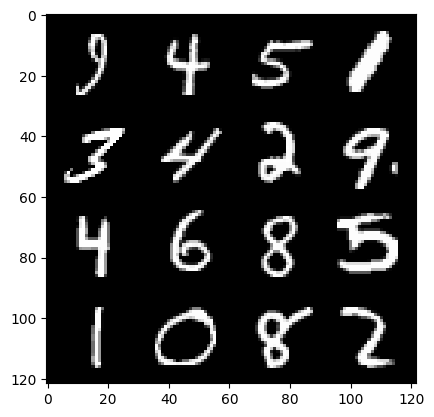

376: step 176700 / Gen loss 2.3219281808535253 / Disc loss 0.25053776855270066


  0%|          | 0/469 [00:00<?, ?it/s]

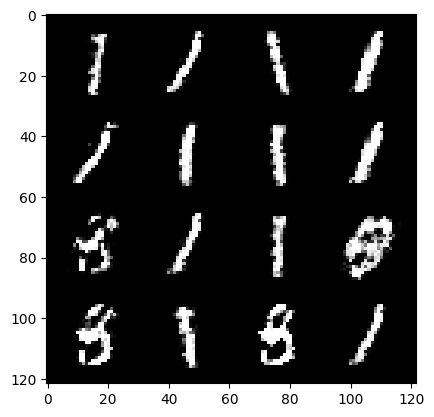

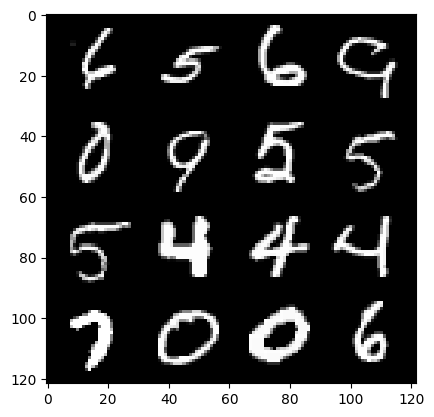

377: step 177000 / Gen loss 2.2371698029836016 / Disc loss 0.2562391765415669


  0%|          | 0/469 [00:00<?, ?it/s]

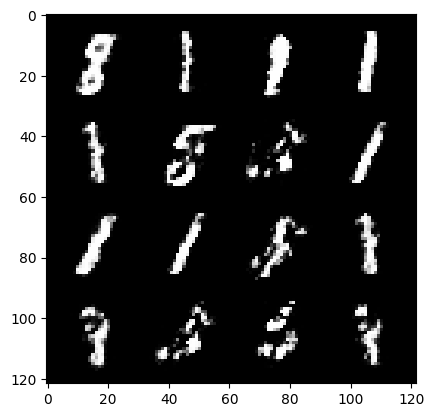

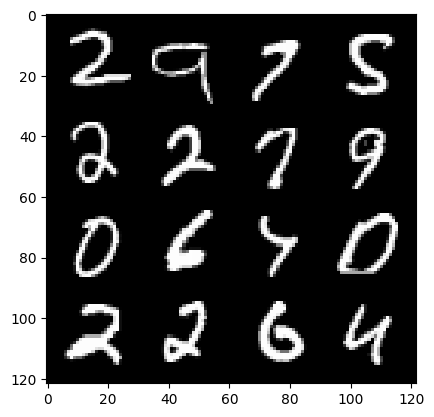

378: step 177300 / Gen loss 2.3225068322817486 / Disc loss 0.24609572708606725


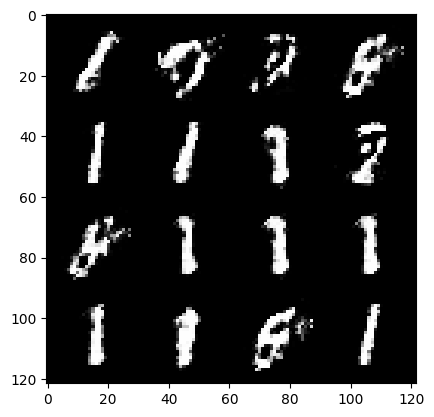

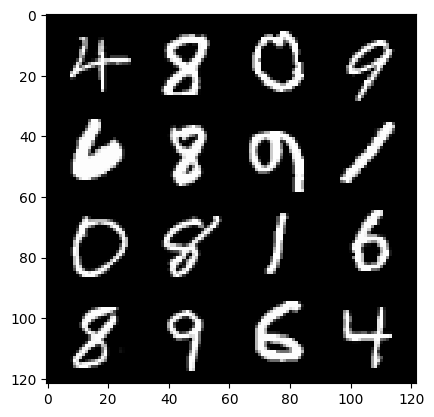

378: step 177600 / Gen loss 2.172068175474803 / Disc loss 0.26116094688574476


  0%|          | 0/469 [00:00<?, ?it/s]

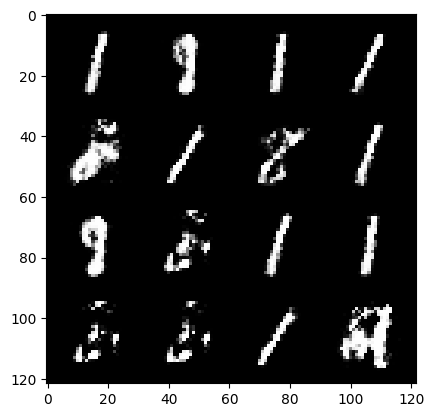

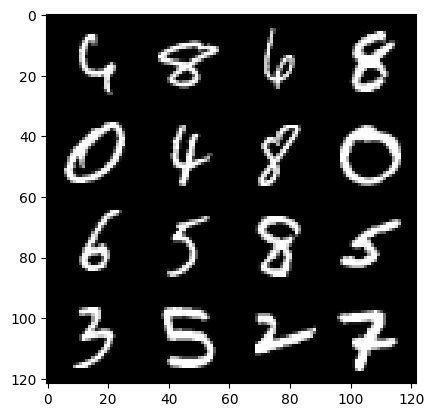

379: step 177900 / Gen loss 2.098458050489424 / Disc loss 0.26699185530344643


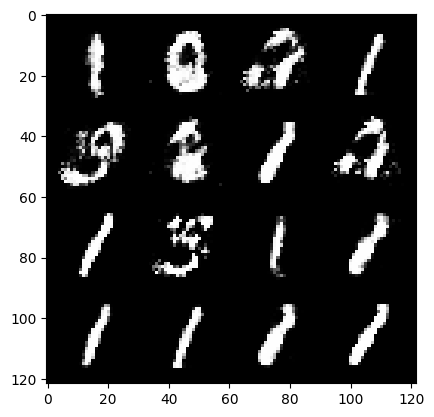

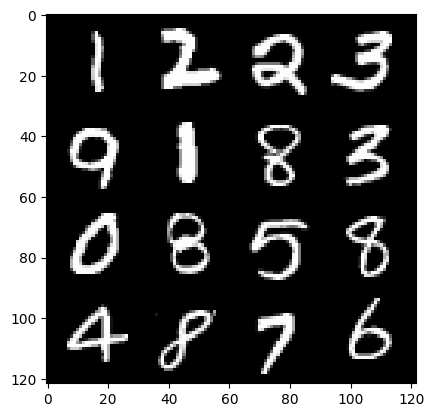

379: step 178200 / Gen loss 2.4695063360532115 / Disc loss 0.25149342815081277


  0%|          | 0/469 [00:00<?, ?it/s]

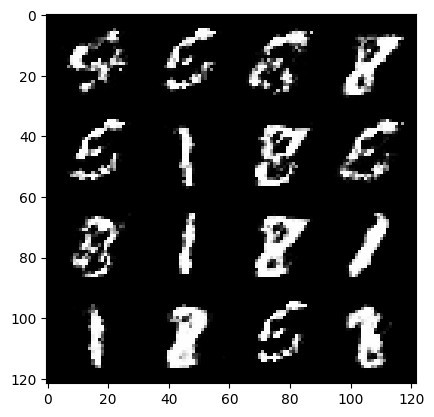

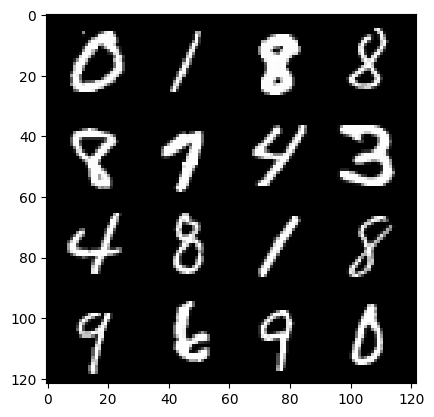

380: step 178500 / Gen loss 2.2859058133761097 / Disc loss 0.266584848711888


  0%|          | 0/469 [00:00<?, ?it/s]

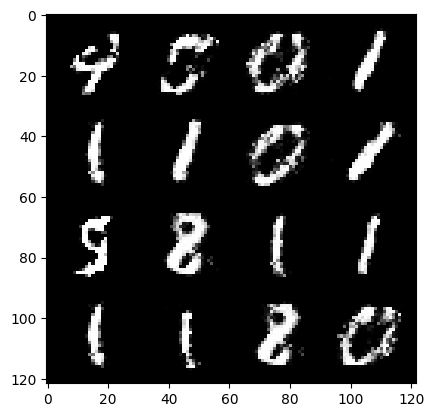

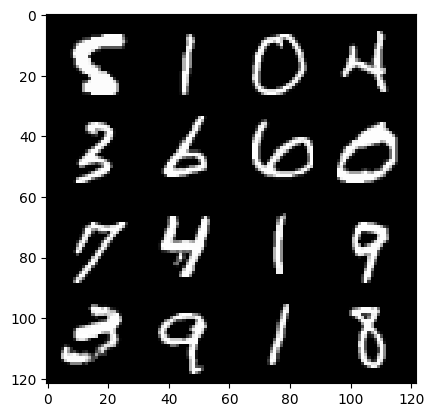

381: step 178800 / Gen loss 2.3022386638323447 / Disc loss 0.23708432838320737


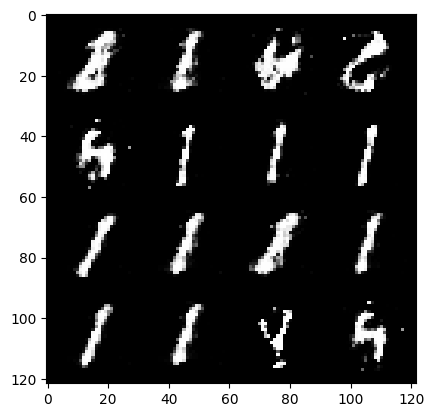

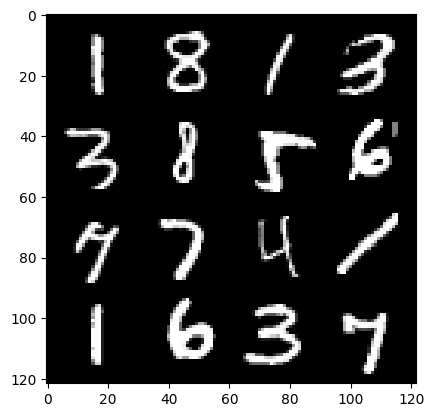

381: step 179100 / Gen loss 2.3493888525168076 / Disc loss 0.23384008094668382


  0%|          | 0/469 [00:00<?, ?it/s]

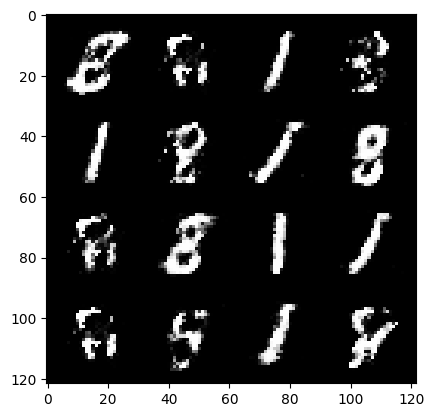

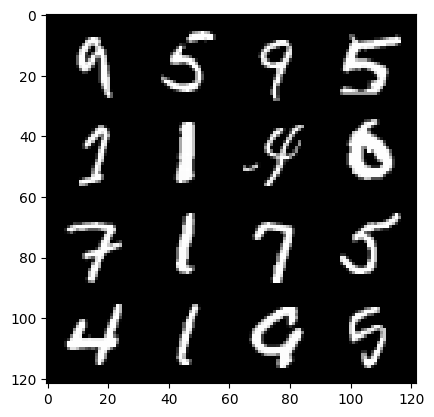

382: step 179400 / Gen loss 2.3455512909094494 / Disc loss 0.22591921627521508


  0%|          | 0/469 [00:00<?, ?it/s]

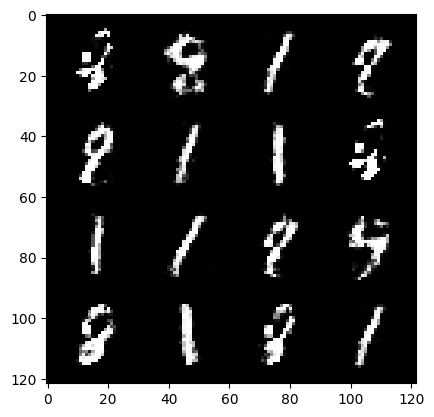

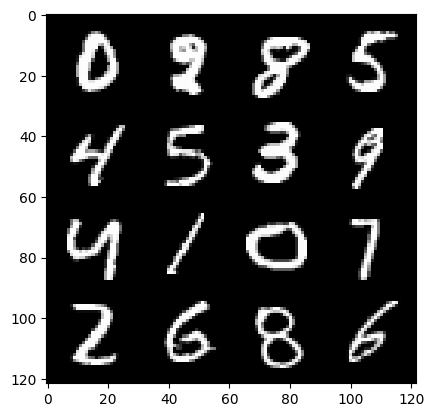

383: step 179700 / Gen loss 2.377709854443868 / Disc loss 0.2429353912174701


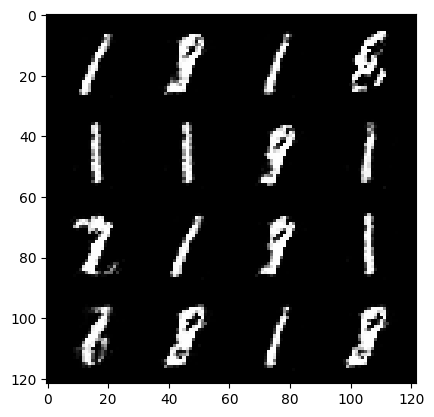

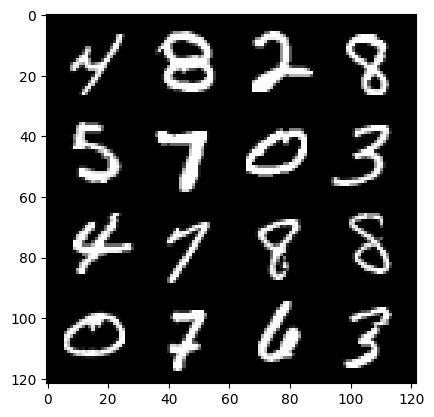

383: step 180000 / Gen loss 2.3653122444947554 / Disc loss 0.2113025717933974


  0%|          | 0/469 [00:00<?, ?it/s]

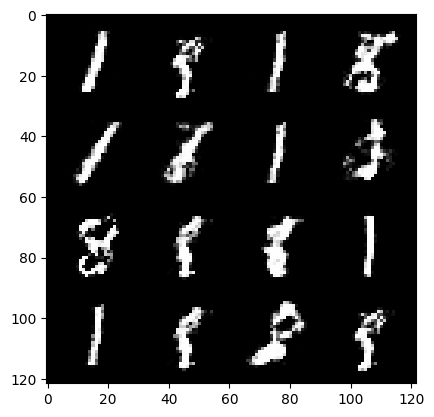

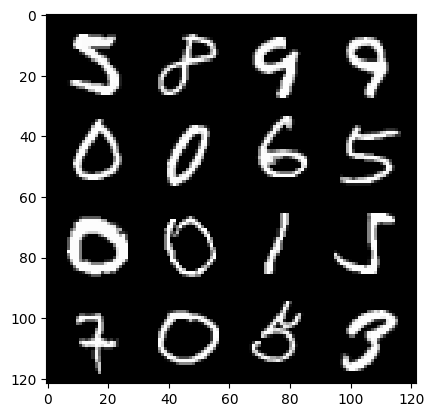

384: step 180300 / Gen loss 2.4992770425478605 / Disc loss 0.20776590791841337


  0%|          | 0/469 [00:00<?, ?it/s]

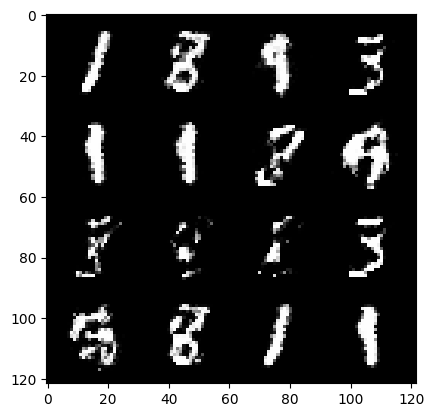

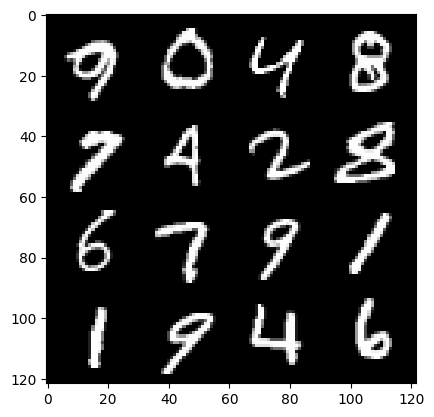

385: step 180600 / Gen loss 2.474300384521484 / Disc loss 0.21239652281006188


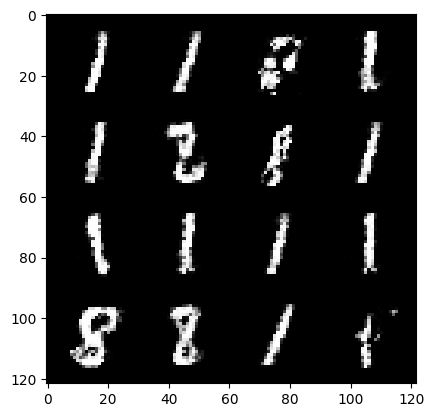

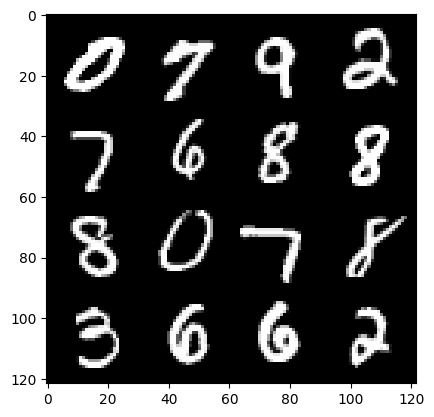

385: step 180900 / Gen loss 2.389576539993286 / Disc loss 0.21145893000066288


  0%|          | 0/469 [00:00<?, ?it/s]

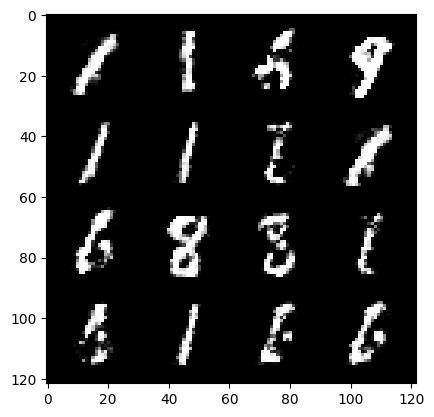

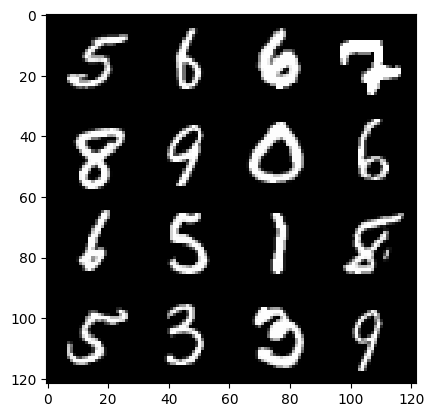

386: step 181200 / Gen loss 2.256674271027247 / Disc loss 0.25088895762960123


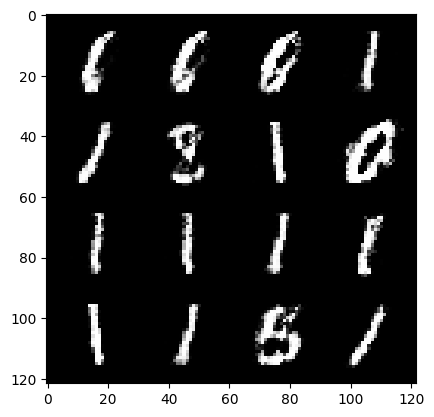

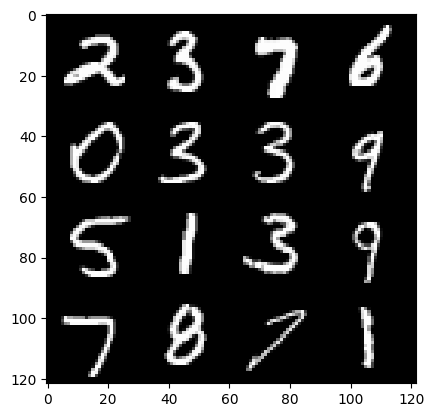

386: step 181500 / Gen loss 2.1593040724595376 / Disc loss 0.2442206160227456


  0%|          | 0/469 [00:00<?, ?it/s]

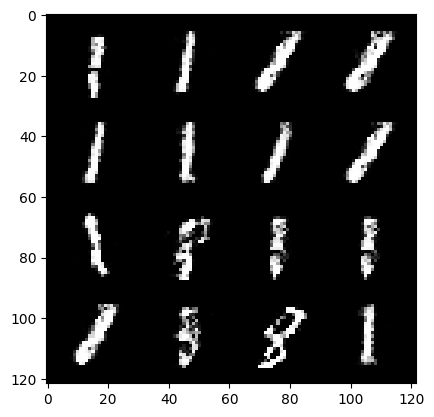

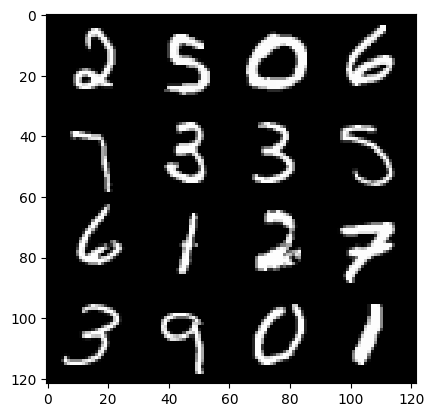

387: step 181800 / Gen loss 2.2505267103513065 / Disc loss 0.23200184896588313


  0%|          | 0/469 [00:00<?, ?it/s]

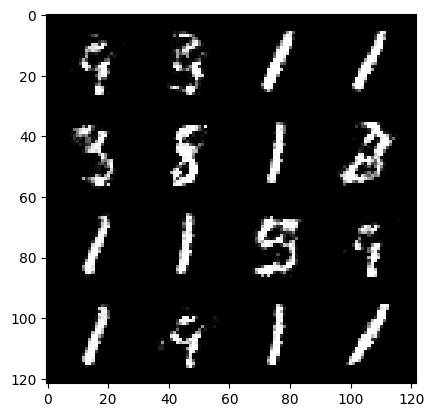

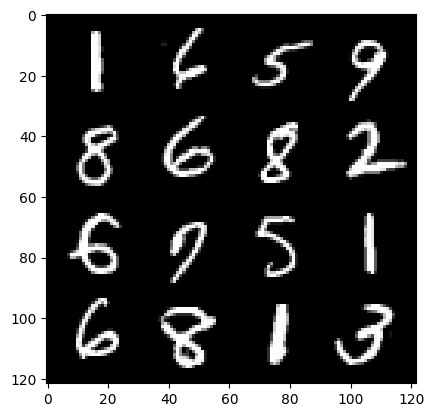

388: step 182100 / Gen loss 2.1579823513825733 / Disc loss 0.23971363589167582


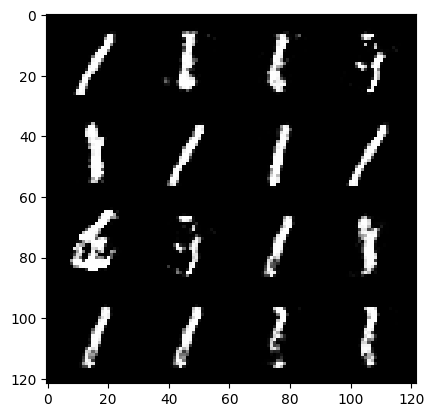

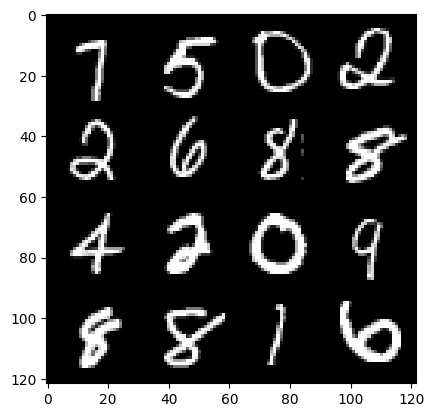

388: step 182400 / Gen loss 2.2147123126188912 / Disc loss 0.24369784250855447


  0%|          | 0/469 [00:00<?, ?it/s]

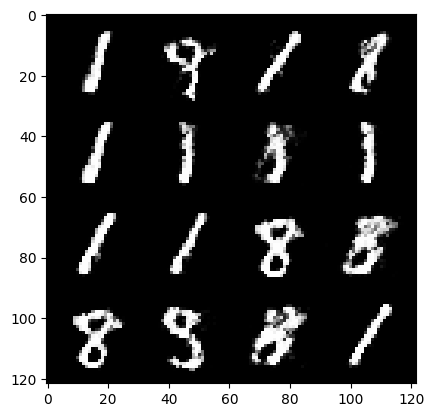

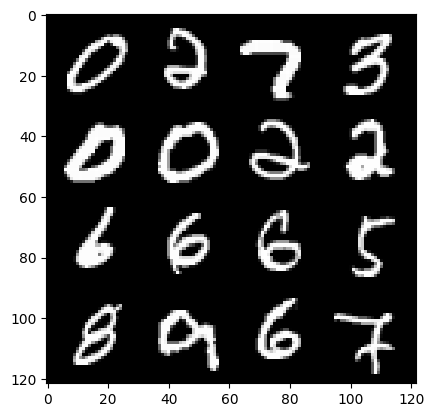

389: step 182700 / Gen loss 2.2199819676081356 / Disc loss 0.2420567866166434


  0%|          | 0/469 [00:00<?, ?it/s]

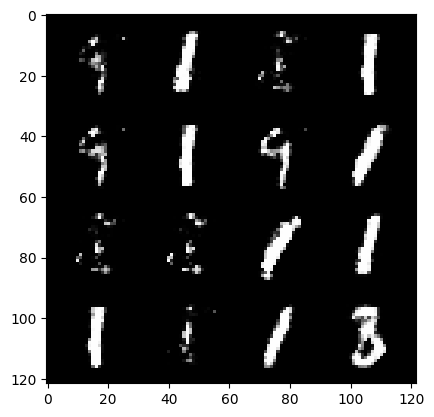

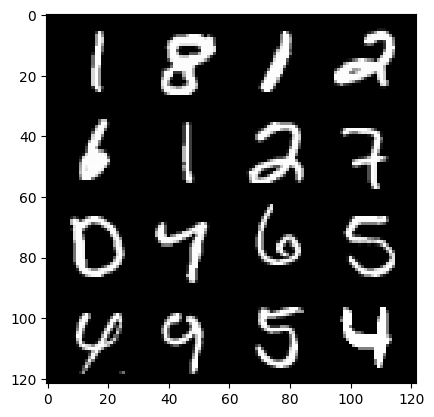

390: step 183000 / Gen loss 2.211149311065674 / Disc loss 0.22969115028778703


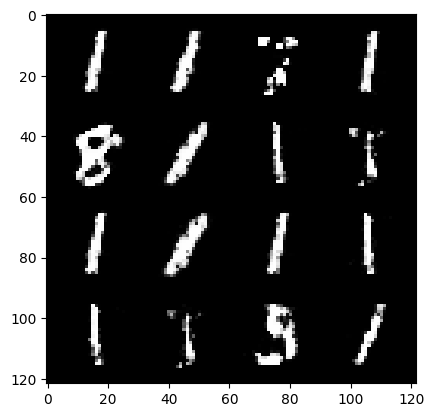

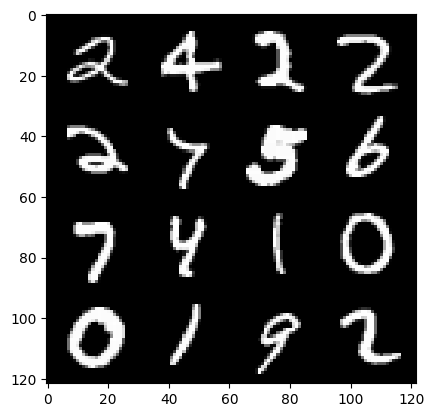

390: step 183300 / Gen loss 2.2306006495157873 / Disc loss 0.23413434639573086


  0%|          | 0/469 [00:00<?, ?it/s]

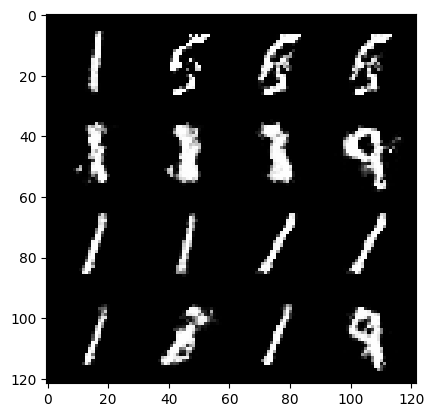

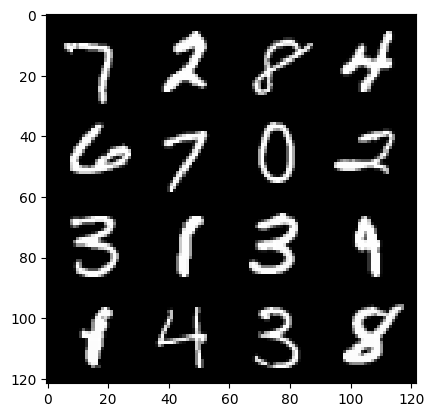

391: step 183600 / Gen loss 2.1358834246794376 / Disc loss 0.2621046201388043


  0%|          | 0/469 [00:00<?, ?it/s]

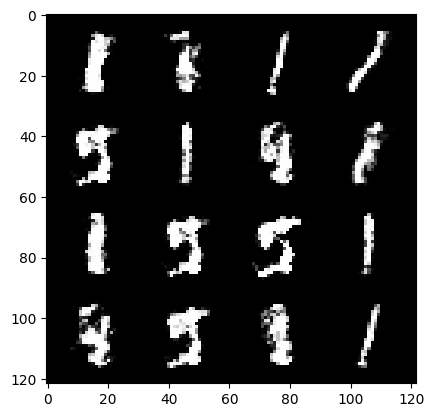

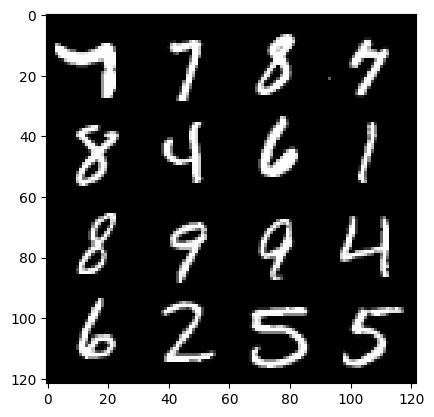

392: step 183900 / Gen loss 2.1171399915218334 / Disc loss 0.2642636117835841


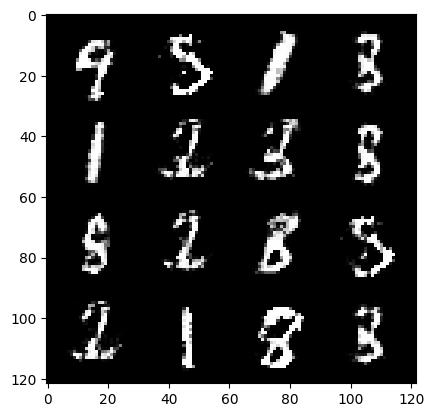

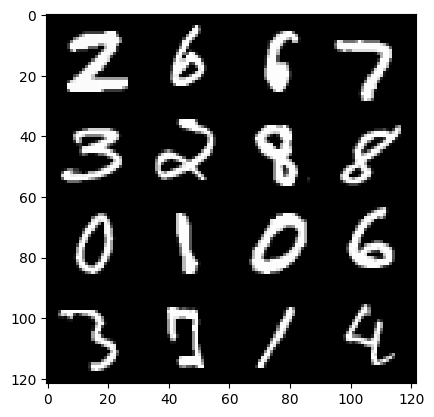

392: step 184200 / Gen loss 2.308097240130105 / Disc loss 0.2560560579597952


  0%|          | 0/469 [00:00<?, ?it/s]

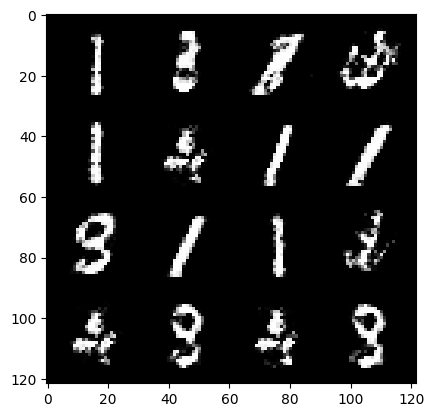

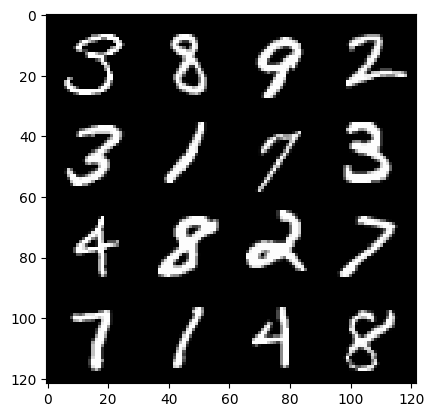

393: step 184500 / Gen loss 2.281424028873444 / Disc loss 0.2566895564893882


  0%|          | 0/469 [00:00<?, ?it/s]

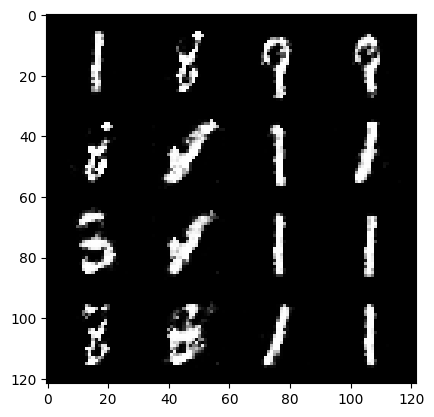

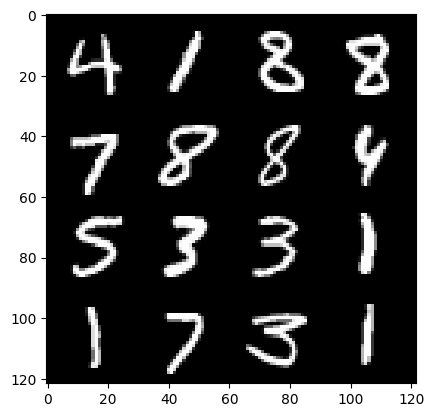

394: step 184800 / Gen loss 2.3660169088840504 / Disc loss 0.2136394664645193


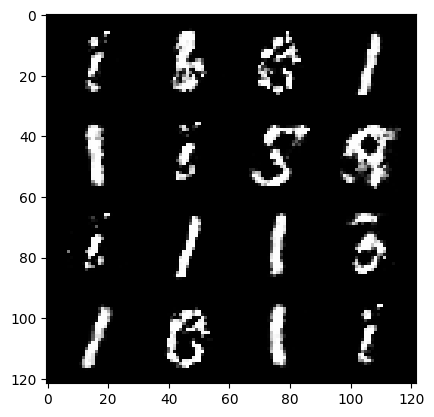

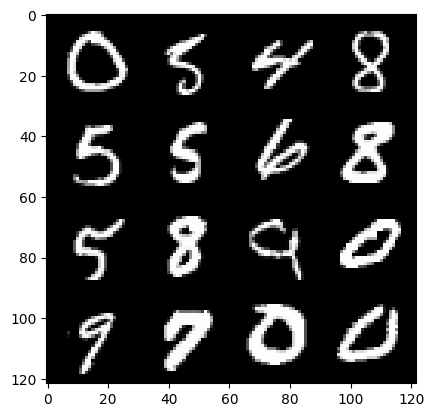

394: step 185100 / Gen loss 2.3870069638888065 / Disc loss 0.21570853521426525


  0%|          | 0/469 [00:00<?, ?it/s]

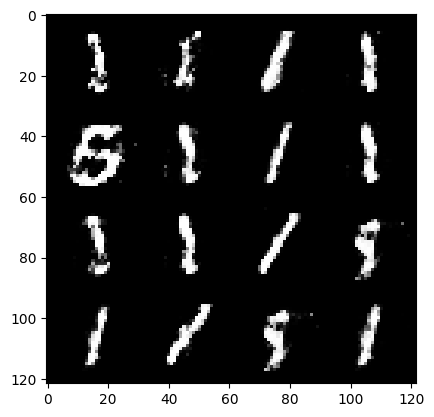

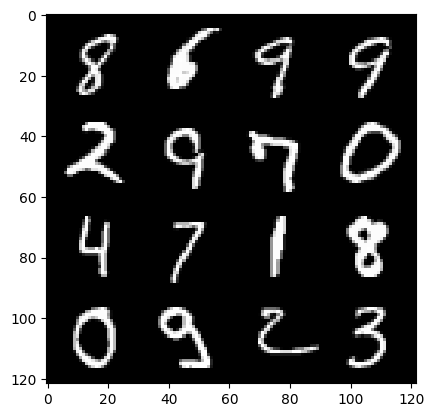

395: step 185400 / Gen loss 2.319001125892005 / Disc loss 0.22892685284217187


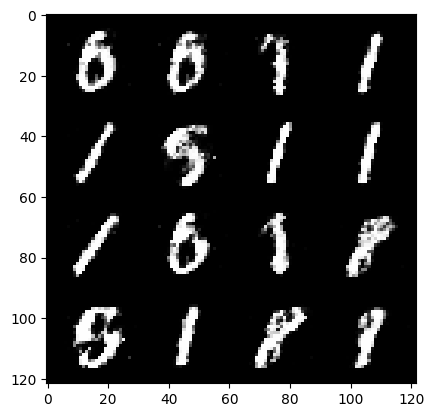

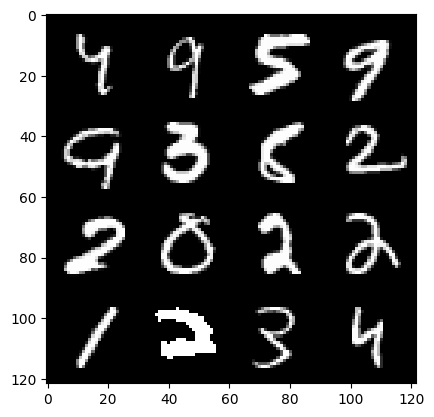

395: step 185700 / Gen loss 2.413004678090414 / Disc loss 0.21538870289921777


  0%|          | 0/469 [00:00<?, ?it/s]

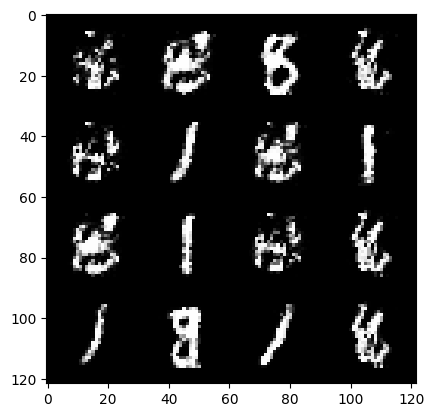

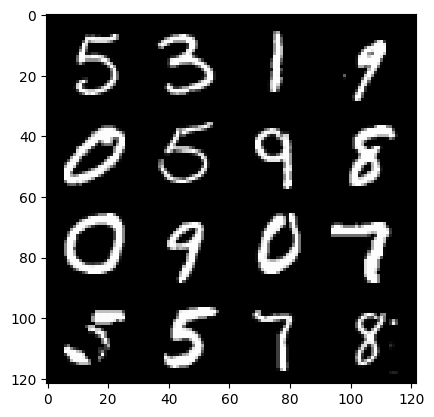

396: step 186000 / Gen loss 2.3085631008942915 / Disc loss 0.23359642917911205


  0%|          | 0/469 [00:00<?, ?it/s]

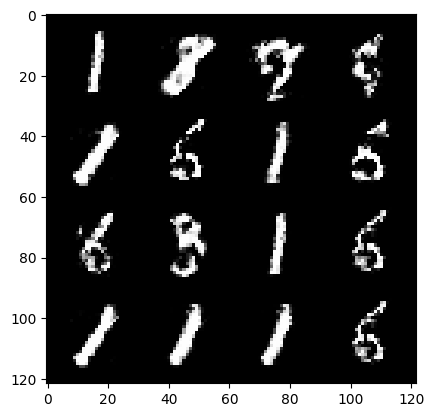

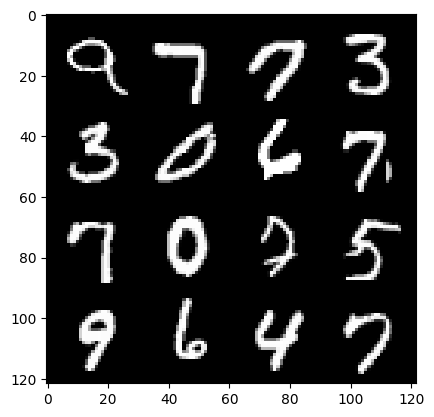

397: step 186300 / Gen loss 2.2967779219150537 / Disc loss 0.22471757749716462


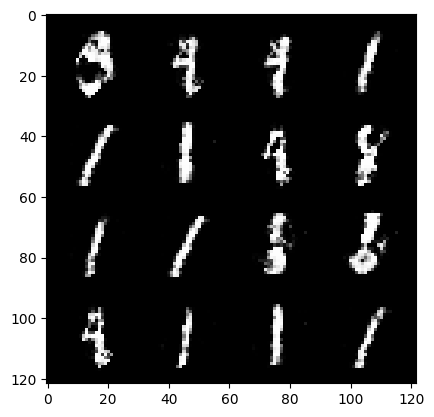

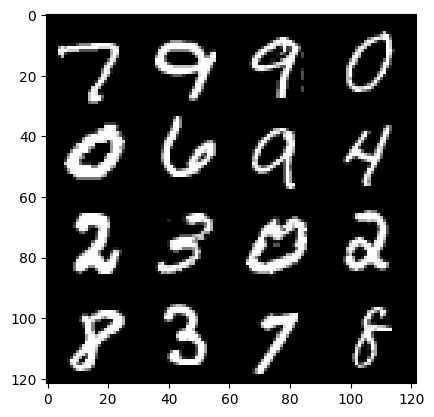

397: step 186600 / Gen loss 2.3496763559182505 / Disc loss 0.23737024724483466


  0%|          | 0/469 [00:00<?, ?it/s]

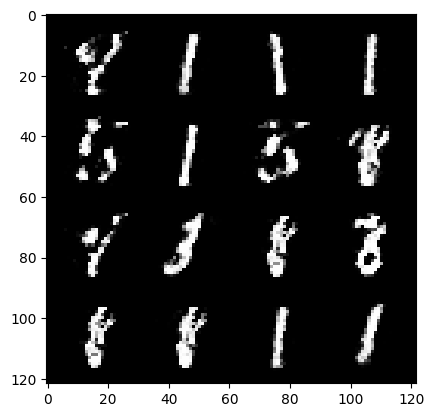

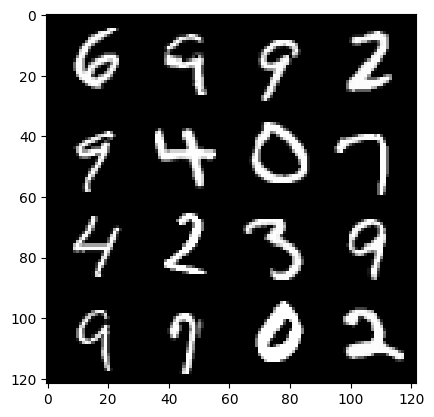

398: step 186900 / Gen loss 2.294868199030558 / Disc loss 0.24786719764272375


  0%|          | 0/469 [00:00<?, ?it/s]

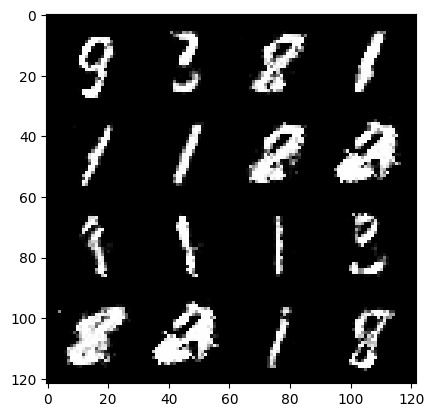

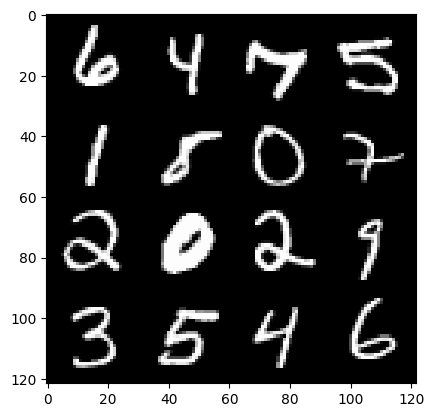

399: step 187200 / Gen loss 2.3478434598445888 / Disc loss 0.2526021869480609


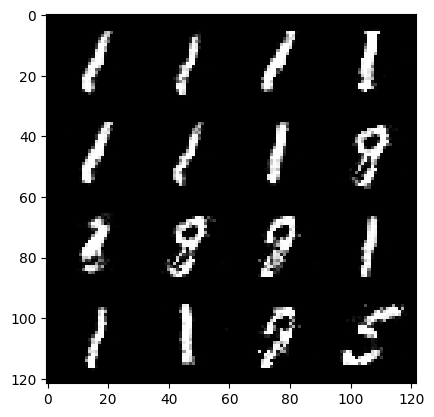

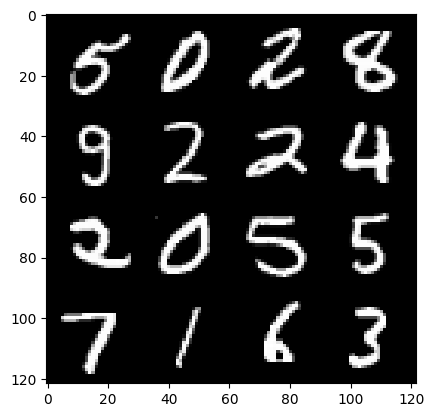

399: step 187500 / Gen loss 2.4084249158700315 / Disc loss 0.22562643011411046


  0%|          | 0/469 [00:00<?, ?it/s]

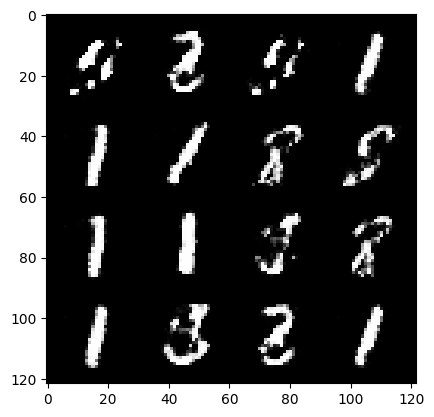

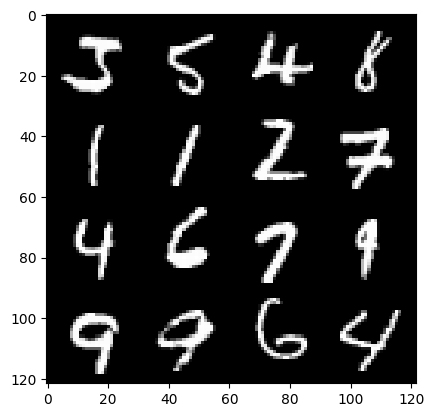

400: step 187800 / Gen loss 2.3576159862677253 / Disc loss 0.2507333406309285


  0%|          | 0/469 [00:00<?, ?it/s]

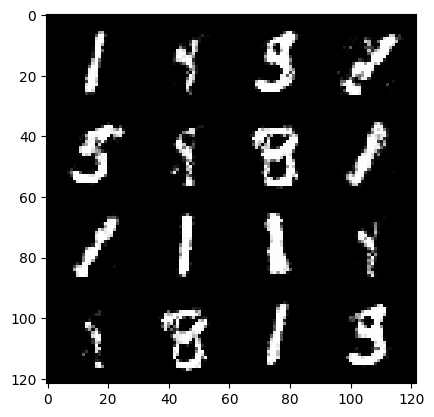

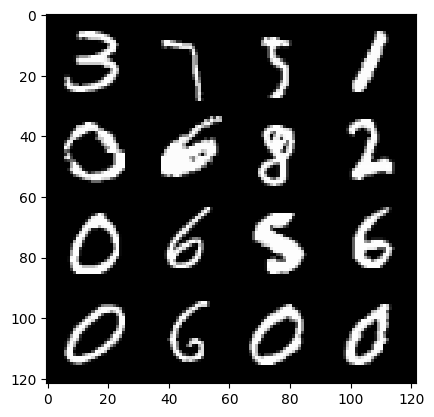

401: step 188100 / Gen loss 2.3531782559553776 / Disc loss 0.24249830305576336


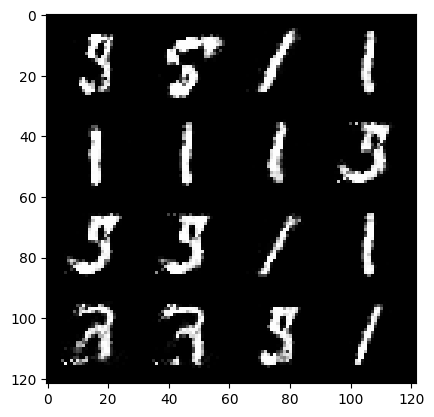

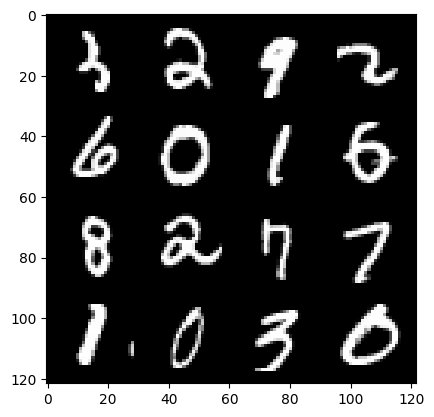

401: step 188400 / Gen loss 2.3042325647671995 / Disc loss 0.2234929889440536


  0%|          | 0/469 [00:00<?, ?it/s]

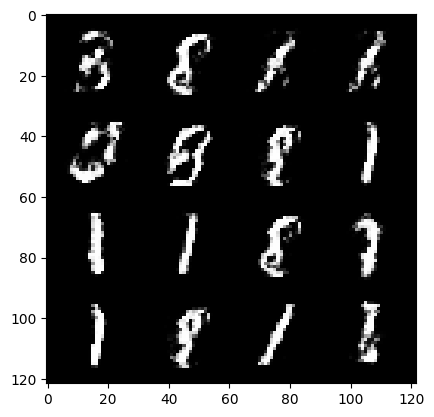

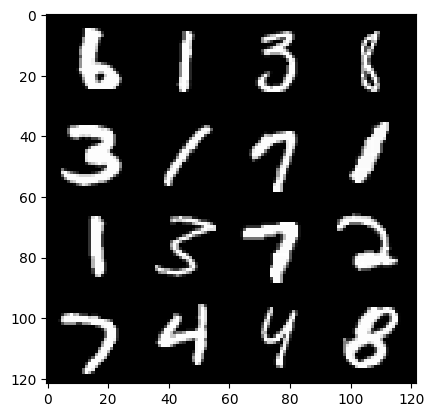

402: step 188700 / Gen loss 2.4492676289876303 / Disc loss 0.21213119139273967


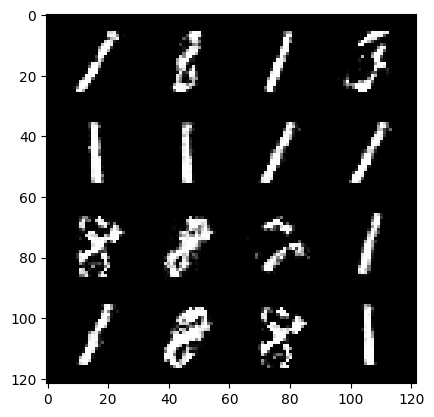

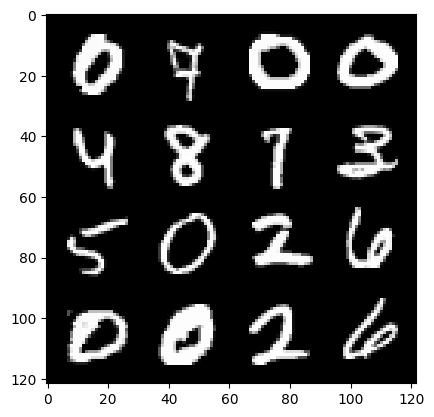

402: step 189000 / Gen loss 2.292714315255484 / Disc loss 0.26478423848748217


  0%|          | 0/469 [00:00<?, ?it/s]

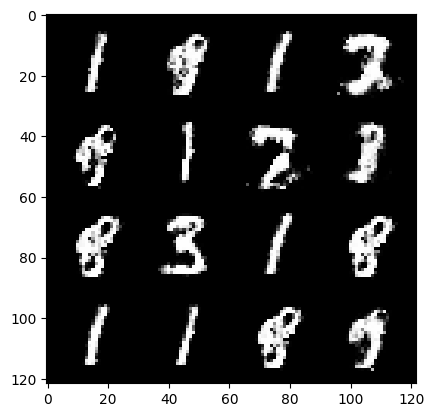

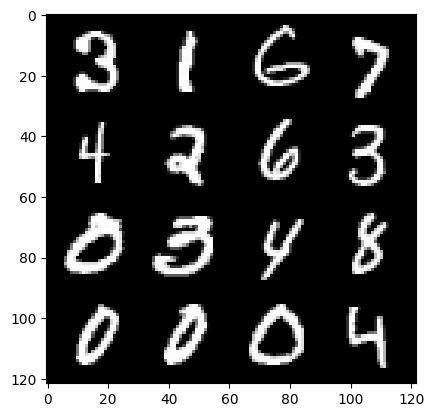

403: step 189300 / Gen loss 2.3980051040649424 / Disc loss 0.253166567136844


  0%|          | 0/469 [00:00<?, ?it/s]

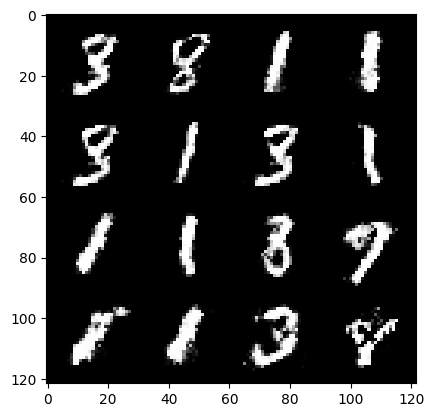

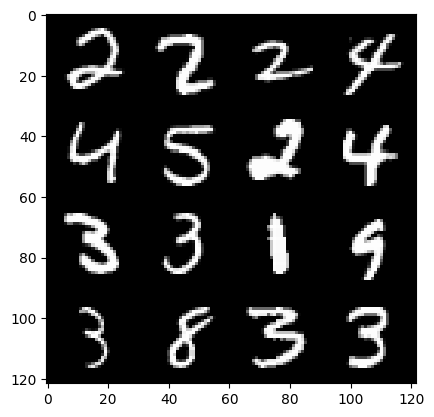

404: step 189600 / Gen loss 2.3976622509956362 / Disc loss 0.23354321022828411


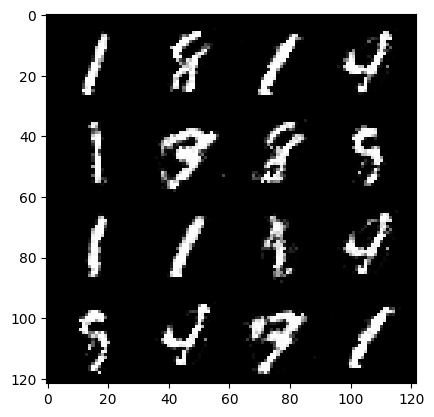

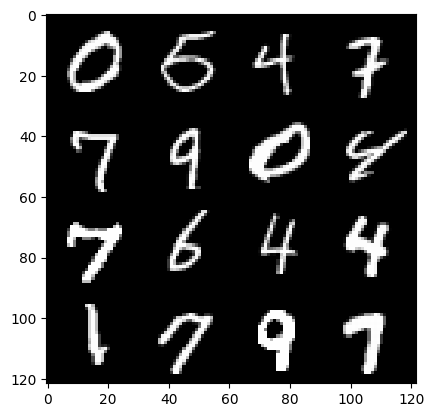

404: step 189900 / Gen loss 2.1226018043359125 / Disc loss 0.286562686463197


  0%|          | 0/469 [00:00<?, ?it/s]

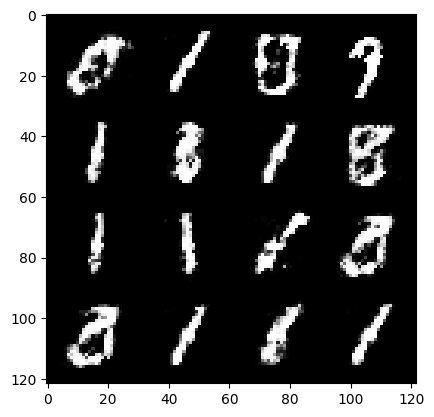

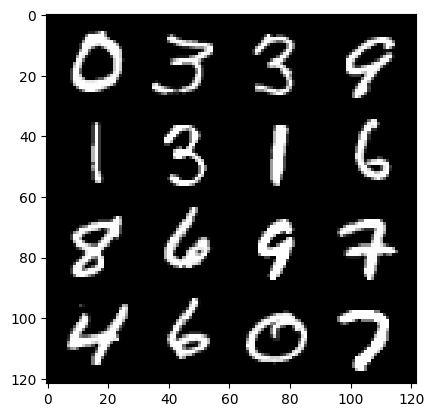

405: step 190200 / Gen loss 2.184300179481505 / Disc loss 0.2592012552420299


  0%|          | 0/469 [00:00<?, ?it/s]

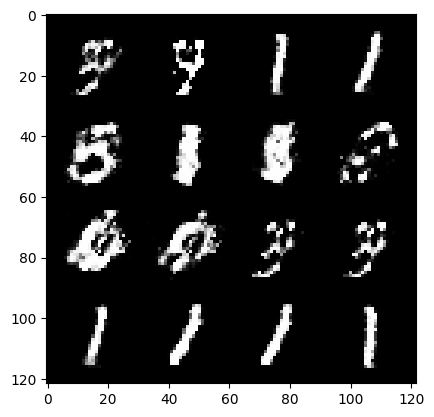

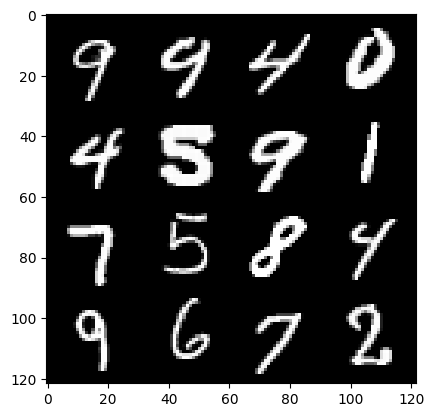

406: step 190500 / Gen loss 2.474421505133312 / Disc loss 0.22487315272291516


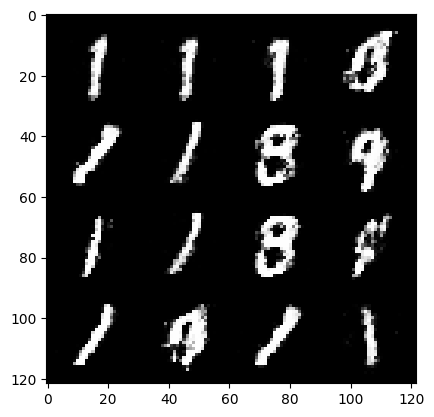

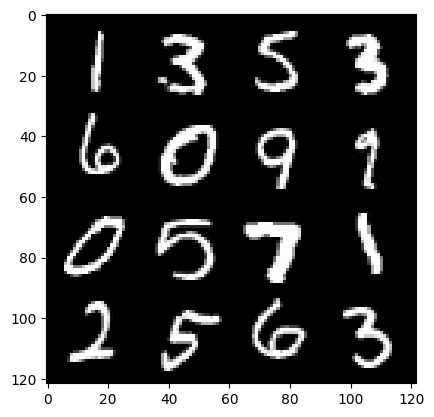

406: step 190800 / Gen loss 2.3839374788602194 / Disc loss 0.2158310803274314


  0%|          | 0/469 [00:00<?, ?it/s]

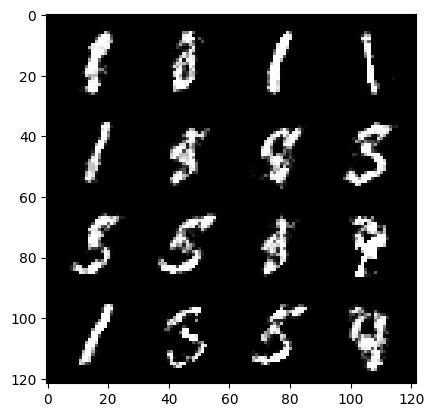

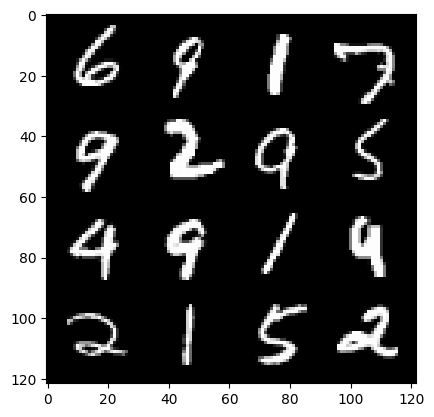

407: step 191100 / Gen loss 2.330814234018324 / Disc loss 0.2375567523638407


  0%|          | 0/469 [00:00<?, ?it/s]

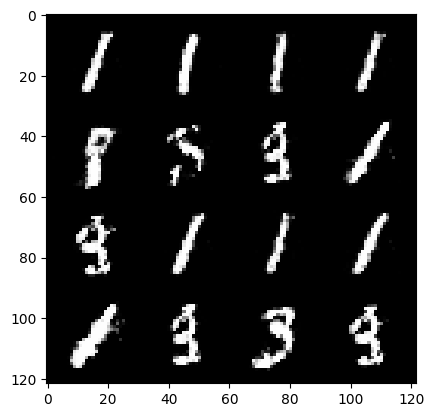

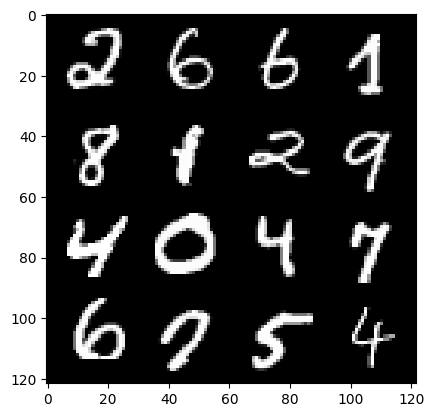

408: step 191400 / Gen loss 2.253696037928263 / Disc loss 0.2505253025889397


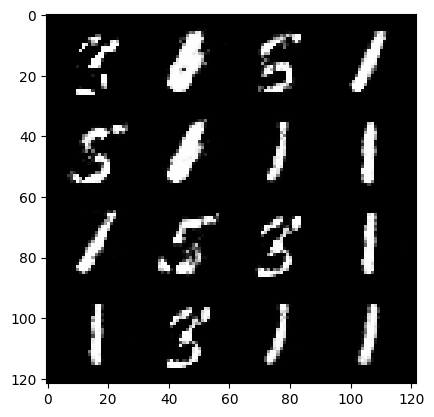

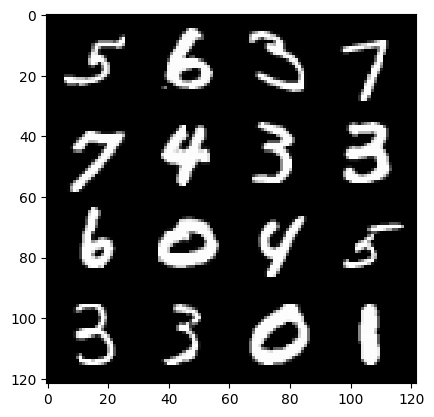

408: step 191700 / Gen loss 2.3158625562985735 / Disc loss 0.23363851552208267


  0%|          | 0/469 [00:00<?, ?it/s]

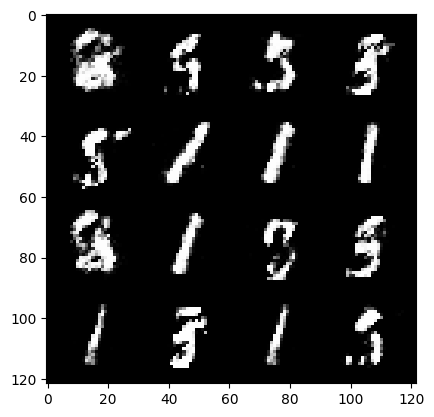

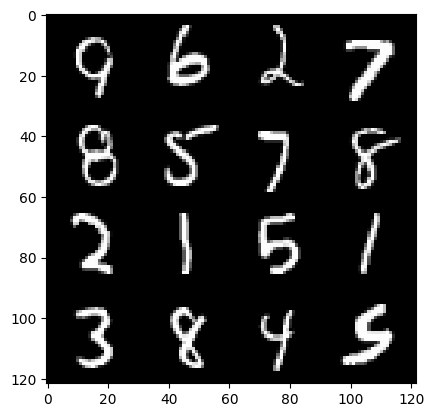

409: step 192000 / Gen loss 2.3700291601816827 / Disc loss 0.21254012003540998


  0%|          | 0/469 [00:00<?, ?it/s]

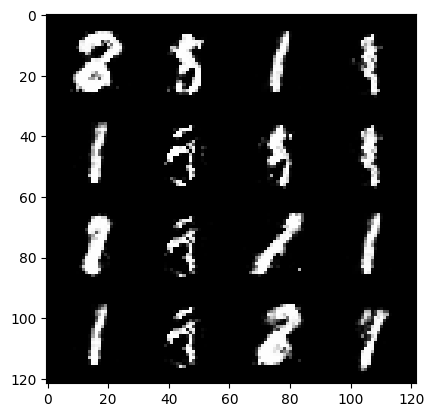

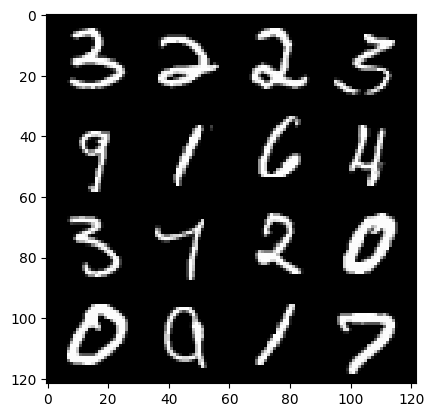

410: step 192300 / Gen loss 2.4103783182303107 / Disc loss 0.20882457350691166


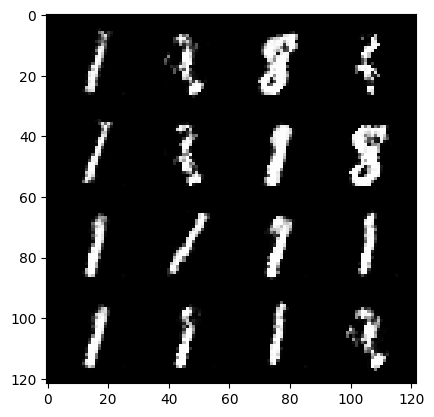

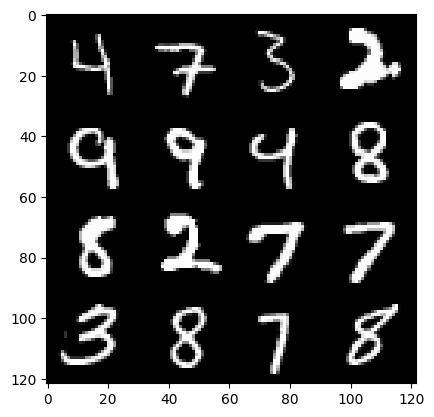

410: step 192600 / Gen loss 2.421489628156027 / Disc loss 0.21117570469776786


  0%|          | 0/469 [00:00<?, ?it/s]

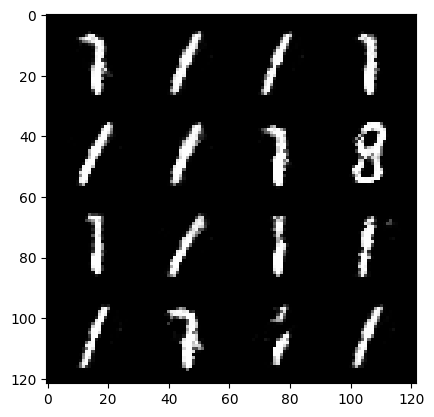

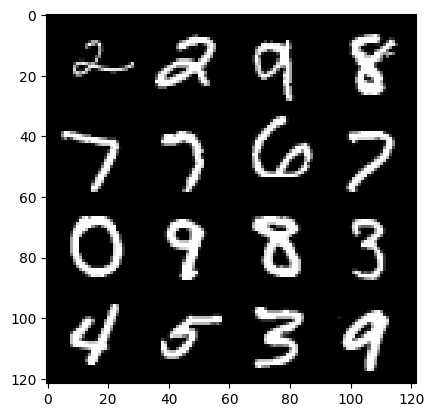

411: step 192900 / Gen loss 2.3748424033323934 / Disc loss 0.23390859022736546


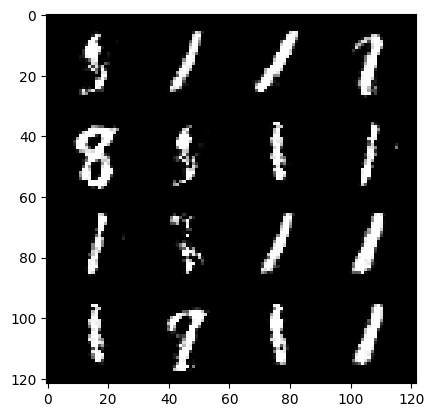

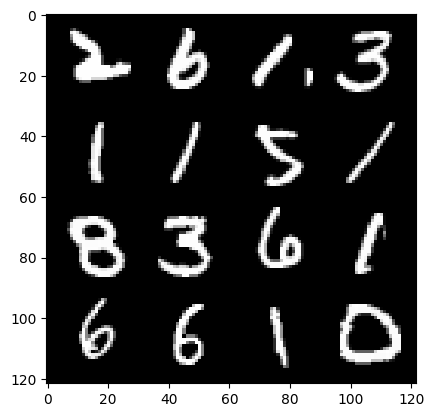

411: step 193200 / Gen loss 2.360958262681958 / Disc loss 0.21785479207833613


  0%|          | 0/469 [00:00<?, ?it/s]

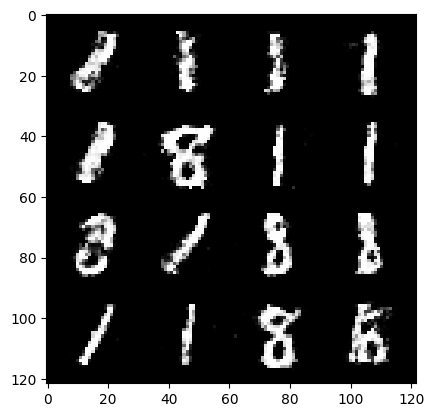

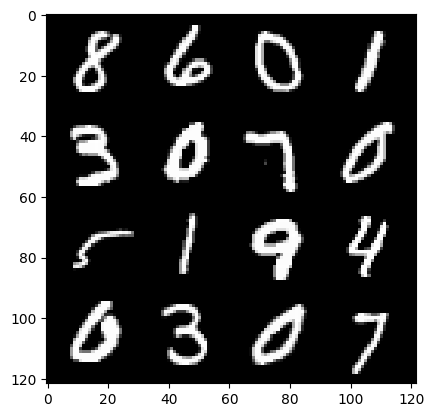

412: step 193500 / Gen loss 2.454527746041616 / Disc loss 0.22331756904721273


  0%|          | 0/469 [00:00<?, ?it/s]

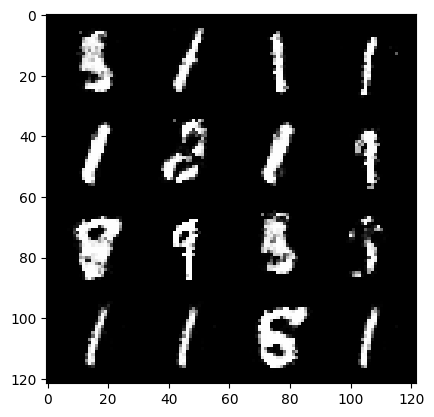

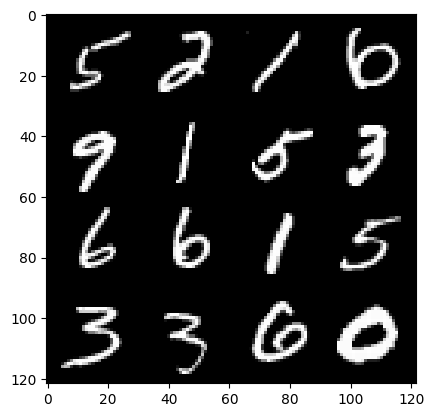

413: step 193800 / Gen loss 2.445064026912053 / Disc loss 0.21346923475464172


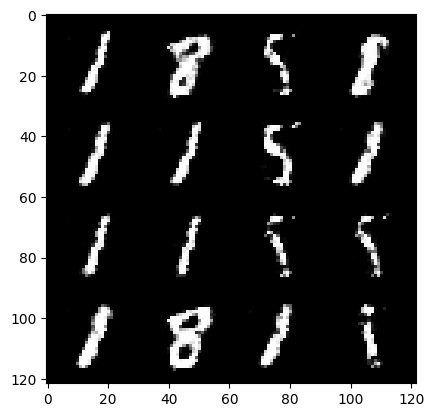

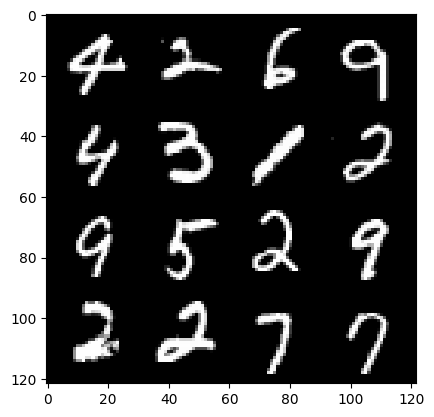

413: step 194100 / Gen loss 2.614968201319377 / Disc loss 0.2086663650472958


  0%|          | 0/469 [00:00<?, ?it/s]

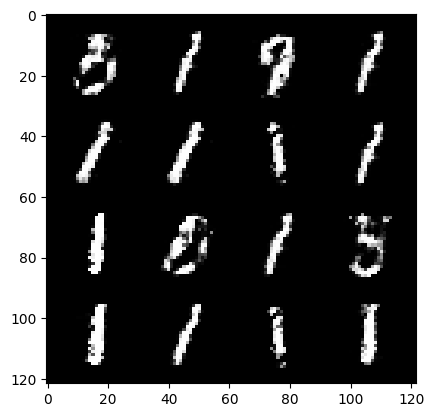

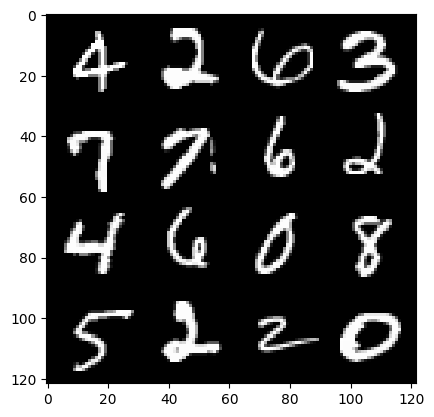

414: step 194400 / Gen loss 2.3150763515631345 / Disc loss 0.2078279942522445


  0%|          | 0/469 [00:00<?, ?it/s]

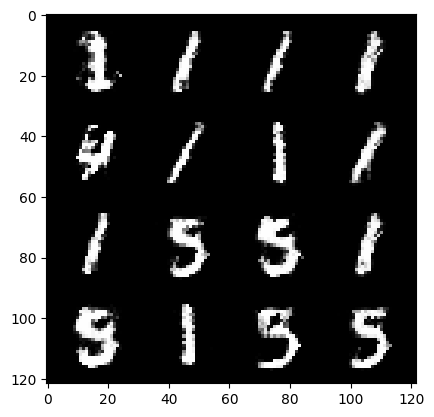

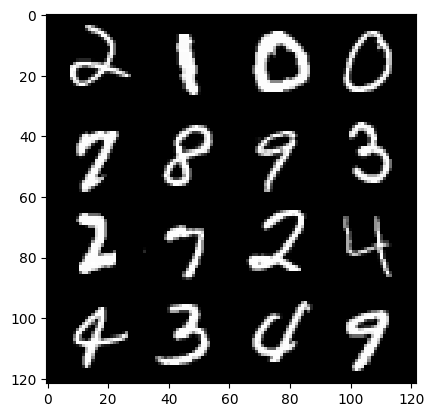

415: step 194700 / Gen loss 2.348257781267165 / Disc loss 0.20707615589102107


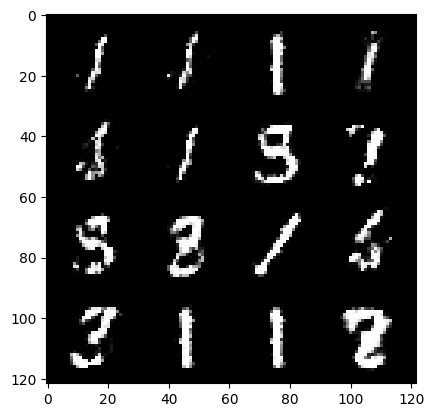

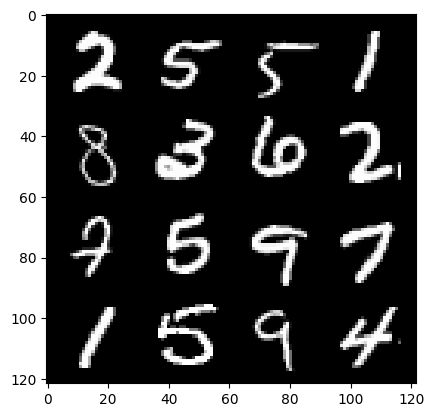

415: step 195000 / Gen loss 2.5264013218879704 / Disc loss 0.24098344489932066


  0%|          | 0/469 [00:00<?, ?it/s]

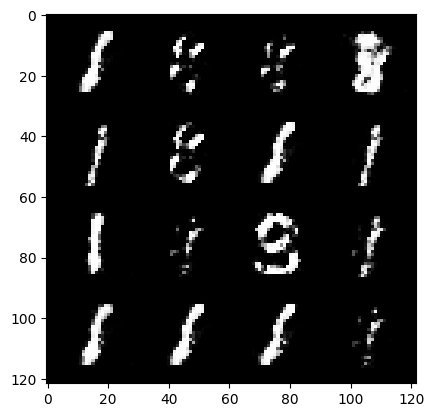

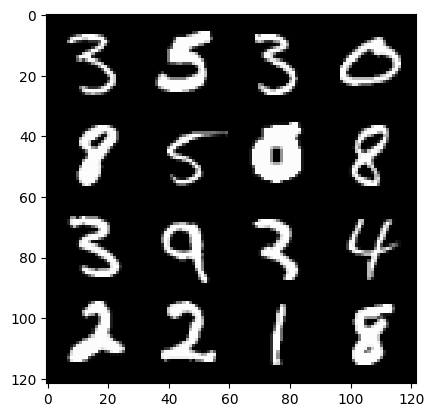

416: step 195300 / Gen loss 2.383295361200968 / Disc loss 0.23161084547638877


  0%|          | 0/469 [00:00<?, ?it/s]

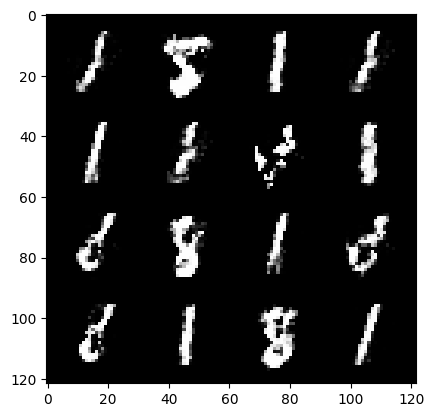

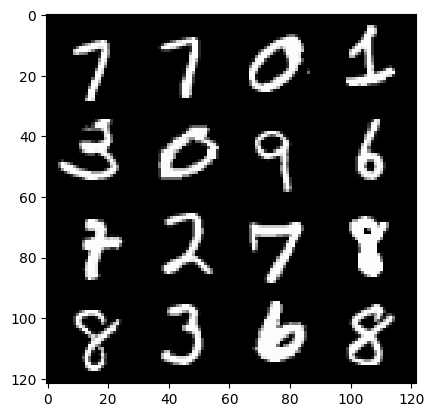

417: step 195600 / Gen loss 2.435625730355581 / Disc loss 0.18353937673072013


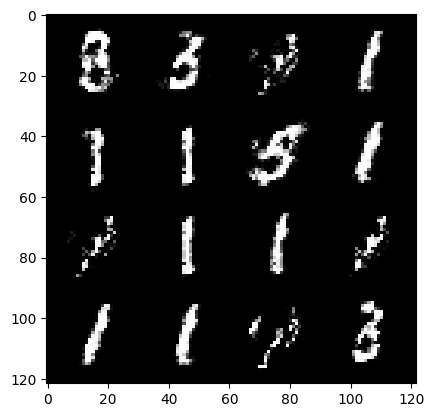

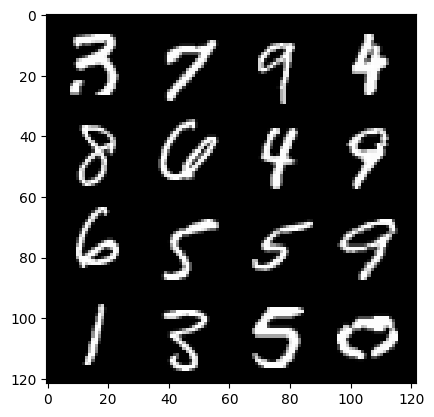

417: step 195900 / Gen loss 2.646218156814576 / Disc loss 0.21095215539137527


  0%|          | 0/469 [00:00<?, ?it/s]

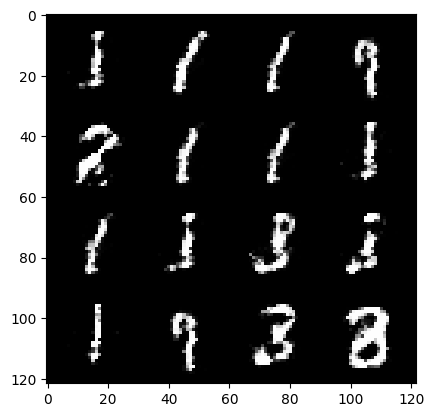

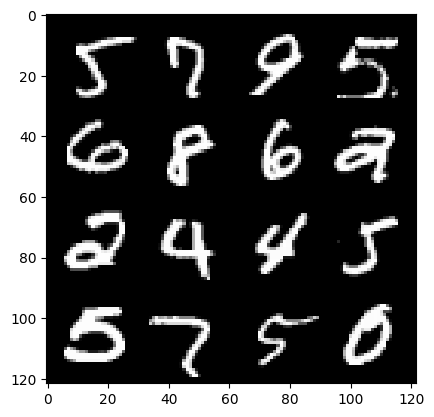

418: step 196200 / Gen loss 2.4053473579883575 / Disc loss 0.2138871563971042


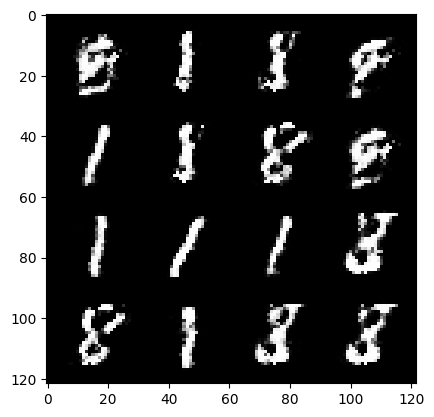

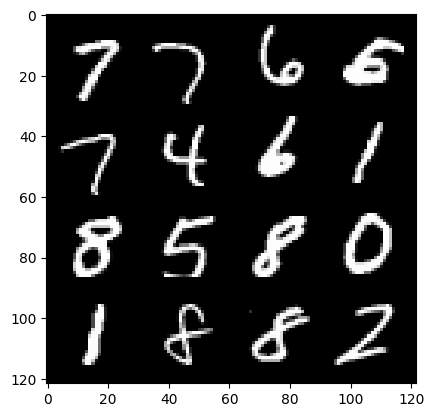

418: step 196500 / Gen loss 2.4091726283232378 / Disc loss 0.2091039927552143


  0%|          | 0/469 [00:00<?, ?it/s]

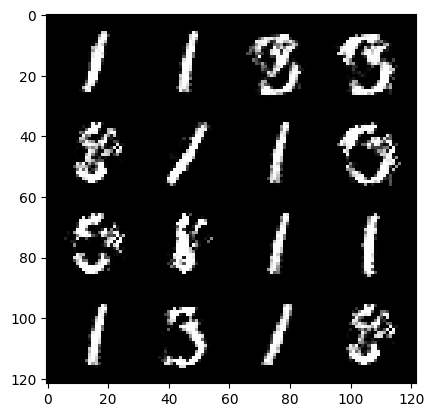

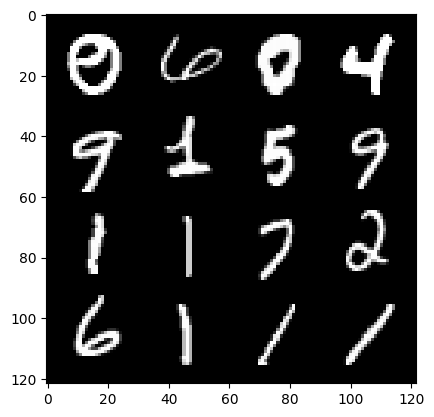

419: step 196800 / Gen loss 2.4605197123686473 / Disc loss 0.21926869057118875


  0%|          | 0/469 [00:00<?, ?it/s]

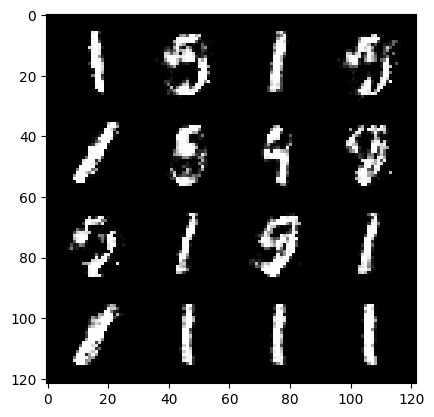

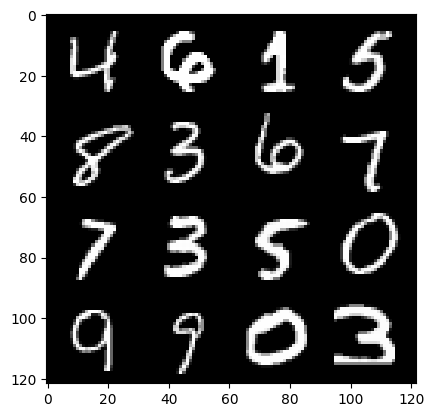

420: step 197100 / Gen loss 2.4538516513506576 / Disc loss 0.22328341121474893


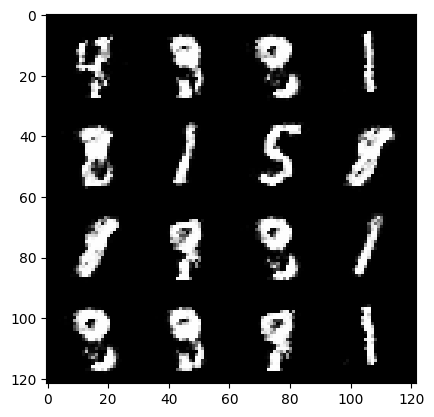

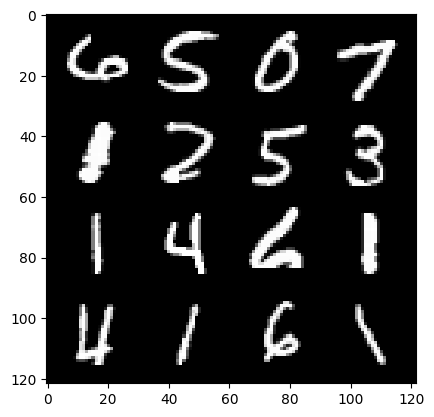

420: step 197400 / Gen loss 2.4967509754498804 / Disc loss 0.2147529699901741


  0%|          | 0/469 [00:00<?, ?it/s]

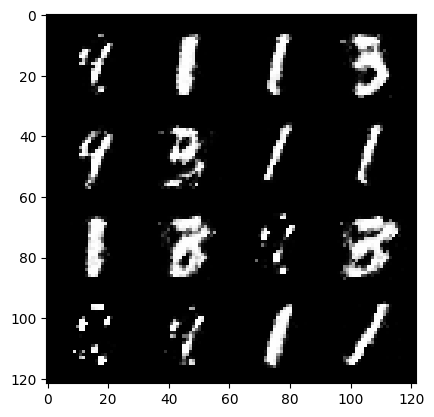

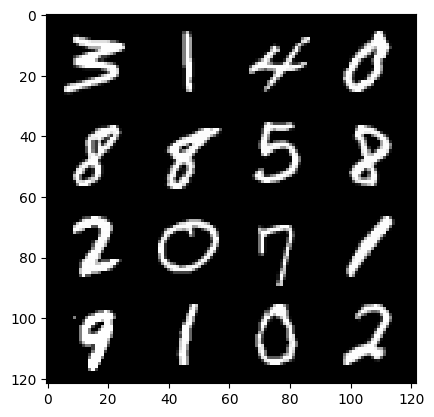

421: step 197700 / Gen loss 2.561295235157014 / Disc loss 0.21815172101060545


  0%|          | 0/469 [00:00<?, ?it/s]

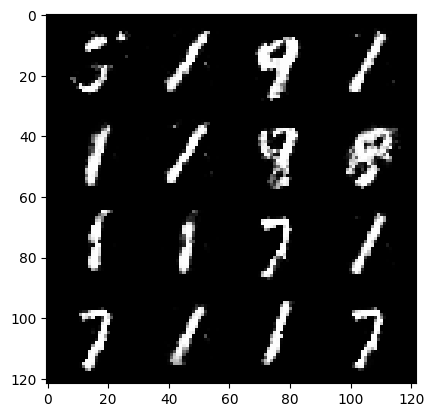

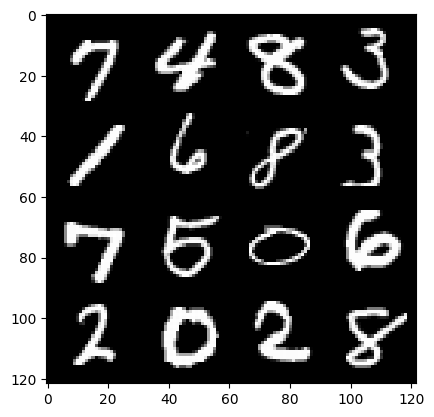

422: step 198000 / Gen loss 2.4527221266428634 / Disc loss 0.22739641842742764


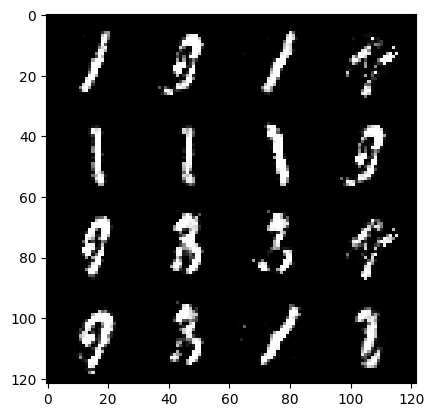

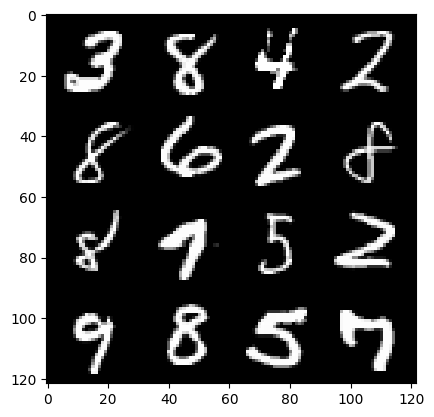

422: step 198300 / Gen loss 2.291465419133505 / Disc loss 0.24218877727786708


  0%|          | 0/469 [00:00<?, ?it/s]

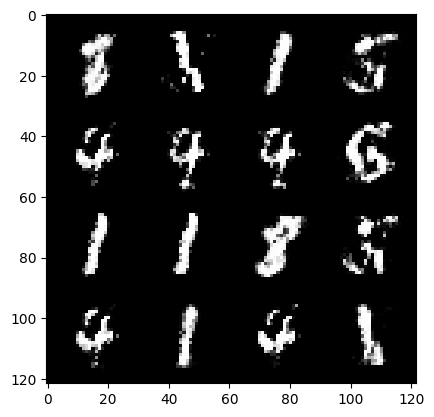

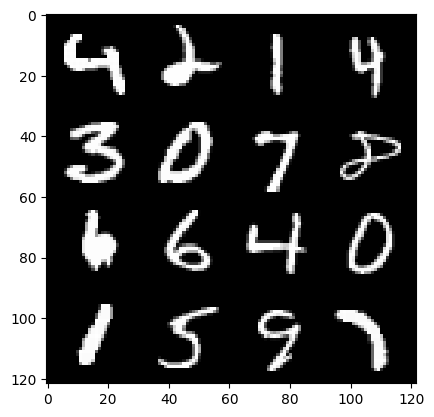

423: step 198600 / Gen loss 2.354888045390446 / Disc loss 0.24637737835446988


  0%|          | 0/469 [00:00<?, ?it/s]

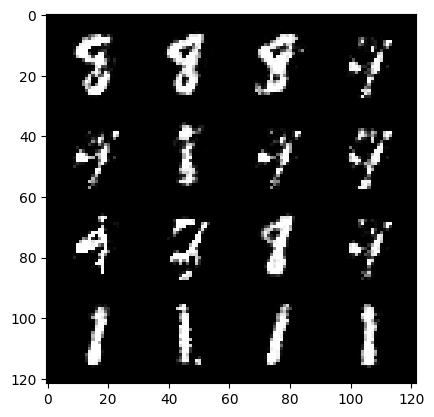

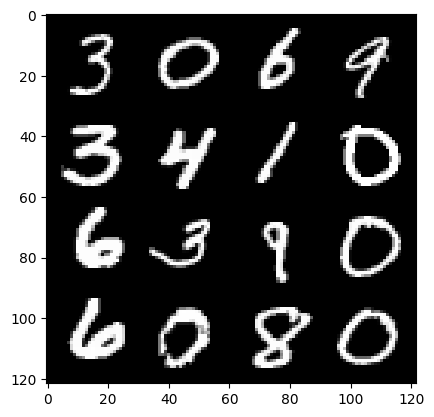

424: step 198900 / Gen loss 2.342218511899312 / Disc loss 0.2311922429998714


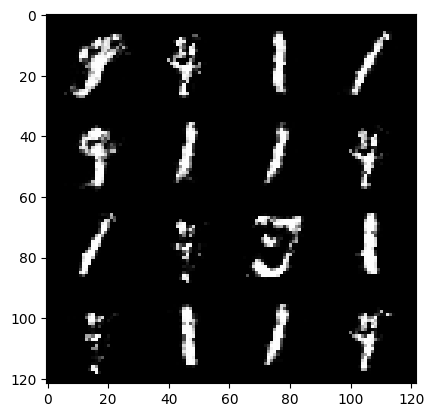

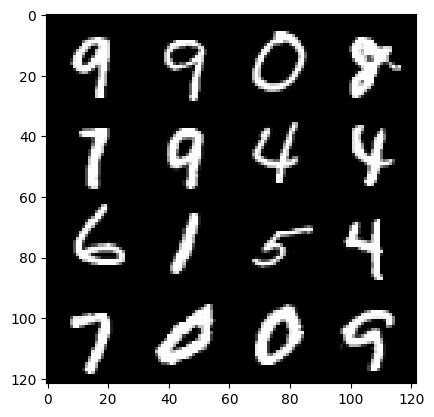

424: step 199200 / Gen loss 2.427184616724649 / Disc loss 0.22557609121004737


  0%|          | 0/469 [00:00<?, ?it/s]

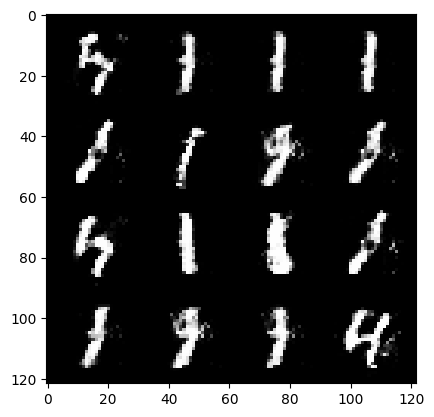

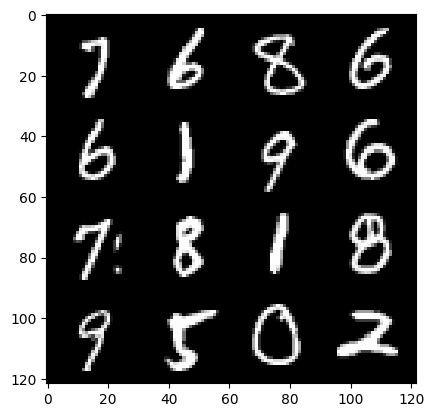

425: step 199500 / Gen loss 2.341095681190491 / Disc loss 0.22979834422469114


  0%|          | 0/469 [00:00<?, ?it/s]

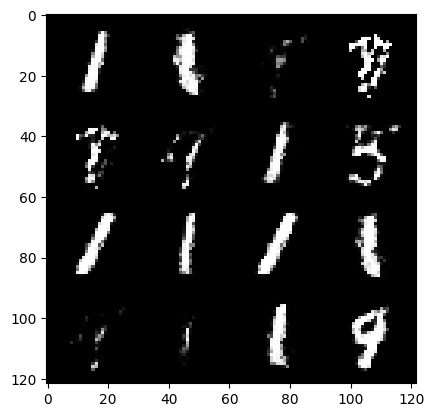

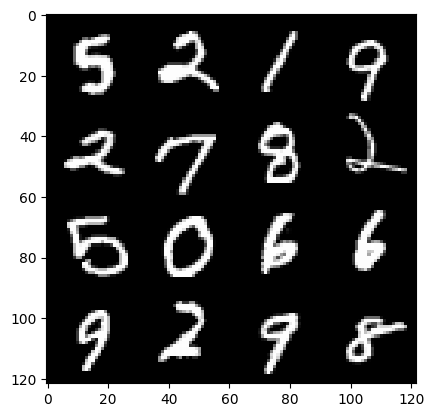

426: step 199800 / Gen loss 2.314051899115244 / Disc loss 0.21903188397487


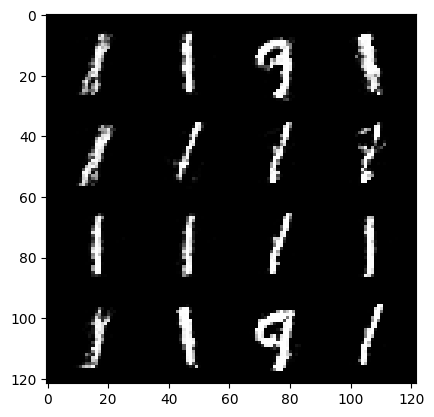

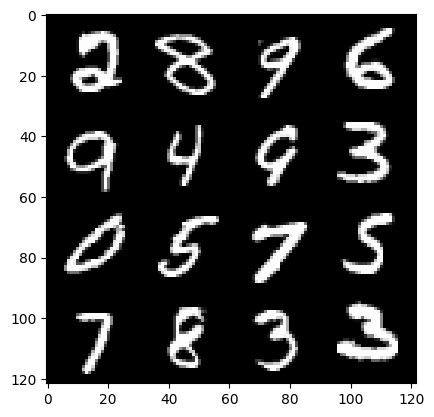

426: step 200100 / Gen loss 2.3656821552912395 / Disc loss 0.21323318367203054


  0%|          | 0/469 [00:00<?, ?it/s]

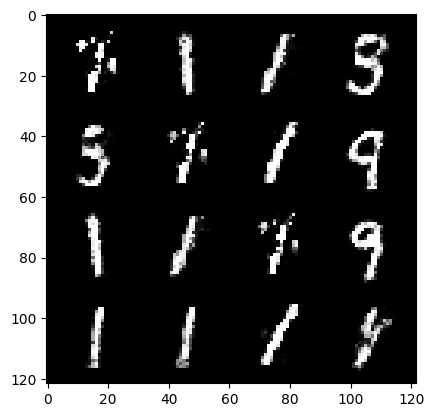

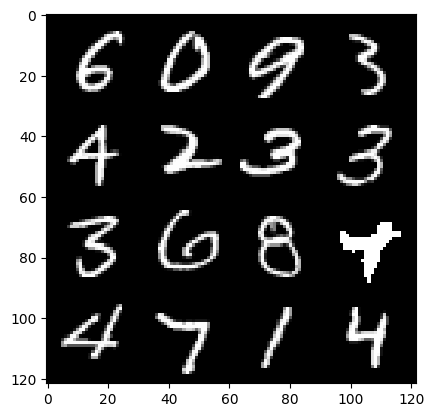

427: step 200400 / Gen loss 2.3715690318743405 / Disc loss 0.21013912533720341


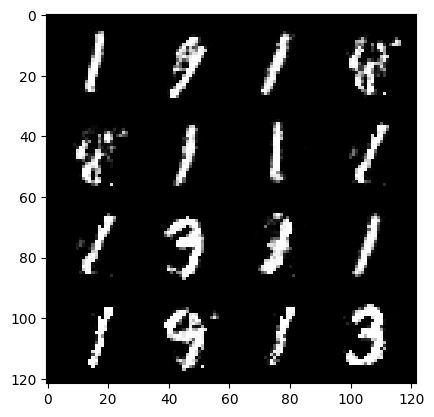

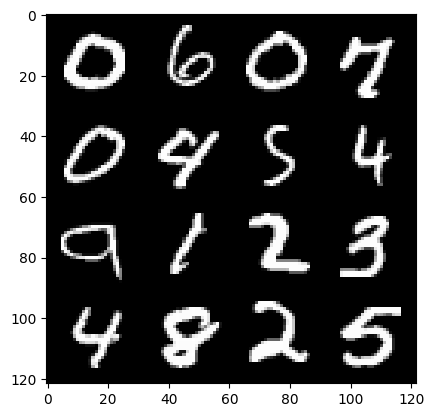

427: step 200700 / Gen loss 2.360732191801071 / Disc loss 0.22283147553602864


  0%|          | 0/469 [00:00<?, ?it/s]

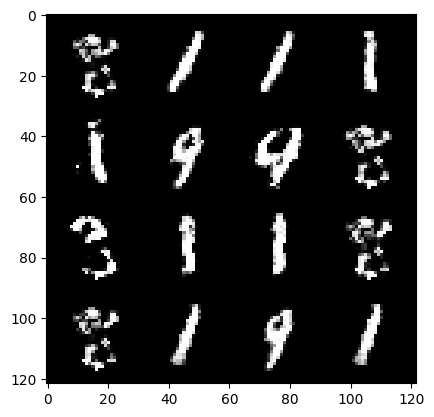

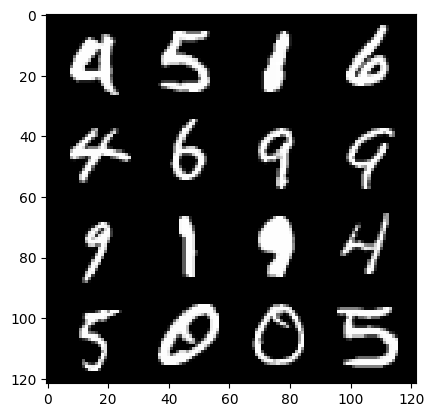

428: step 201000 / Gen loss 2.431471102237703 / Disc loss 0.2318796814481418


  0%|          | 0/469 [00:00<?, ?it/s]

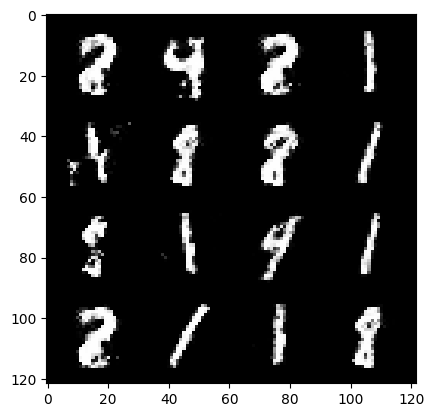

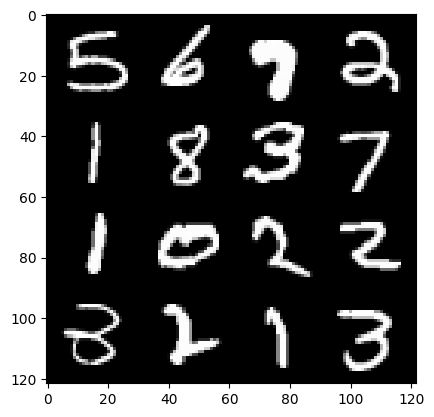

429: step 201300 / Gen loss 2.252743544181189 / Disc loss 0.2506587206323944


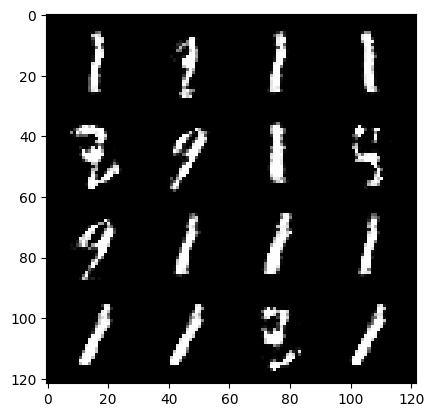

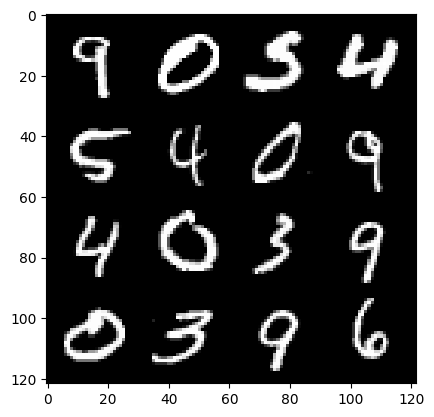

429: step 201600 / Gen loss 2.340823256572087 / Disc loss 0.23773911615212756


  0%|          | 0/469 [00:00<?, ?it/s]

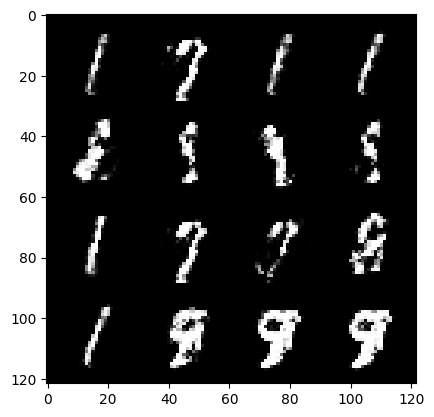

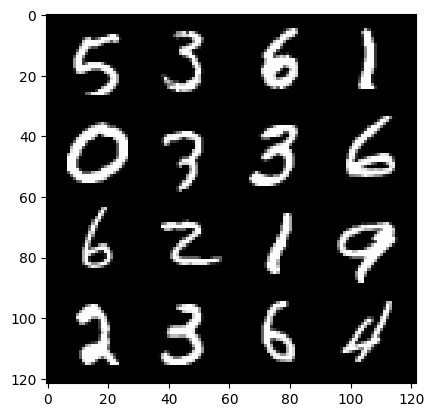

430: step 201900 / Gen loss 2.458714899222055 / Disc loss 0.254554655700922


  0%|          | 0/469 [00:00<?, ?it/s]

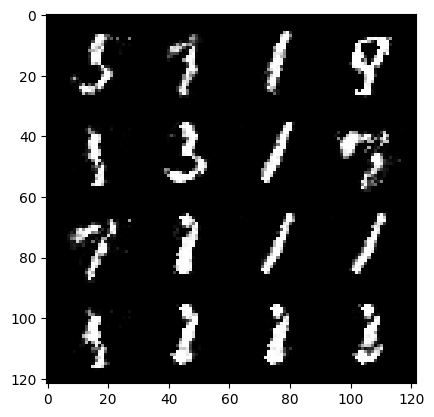

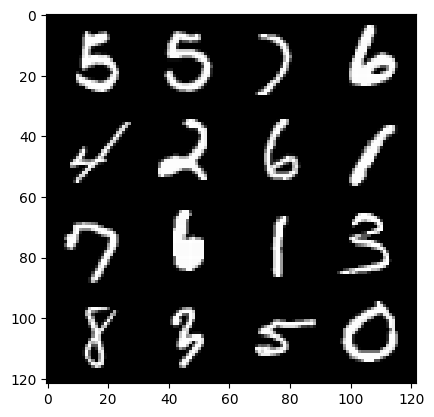

431: step 202200 / Gen loss 2.5972315001487734 / Disc loss 0.1984347893546024


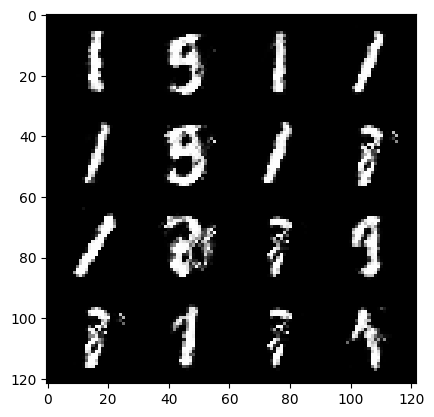

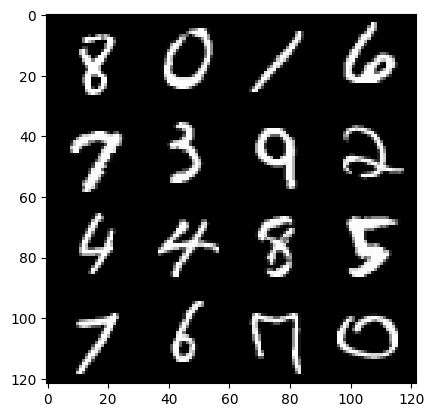

431: step 202500 / Gen loss 2.435683961311977 / Disc loss 0.2210788127034903


  0%|          | 0/469 [00:00<?, ?it/s]

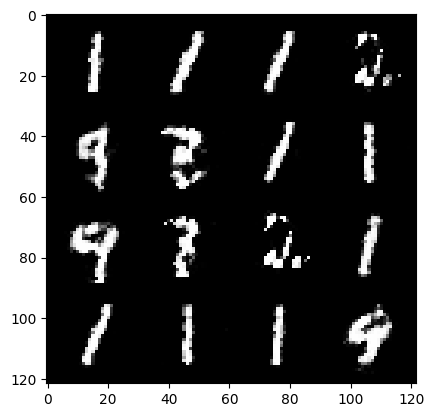

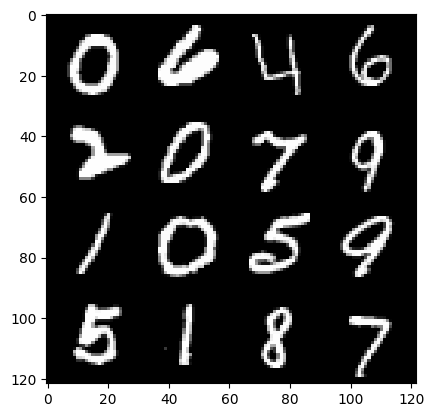

432: step 202800 / Gen loss 2.591011634270349 / Disc loss 0.22460434054334957


  0%|          | 0/469 [00:00<?, ?it/s]

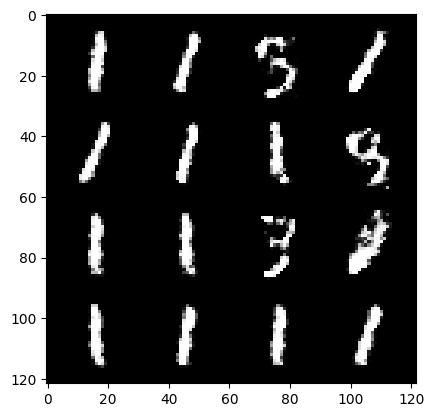

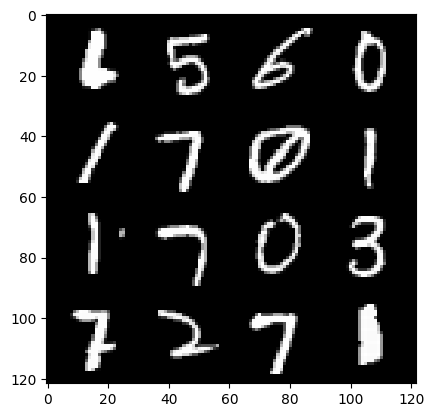

433: step 203100 / Gen loss 2.4125355100631696 / Disc loss 0.21133769015471154


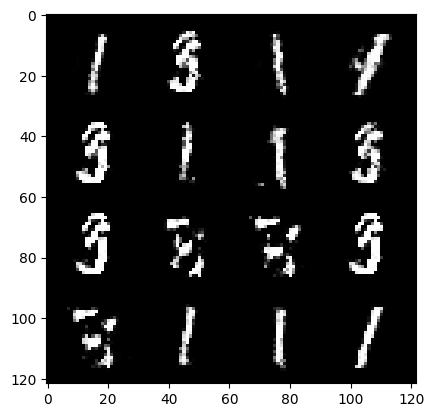

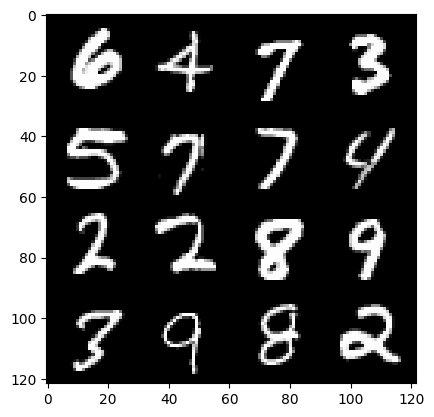

433: step 203400 / Gen loss 2.633563799063363 / Disc loss 0.20568977569540345


  0%|          | 0/469 [00:00<?, ?it/s]

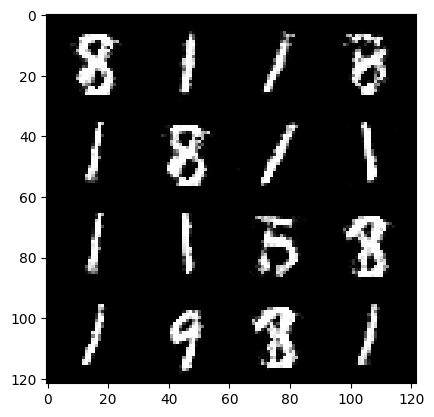

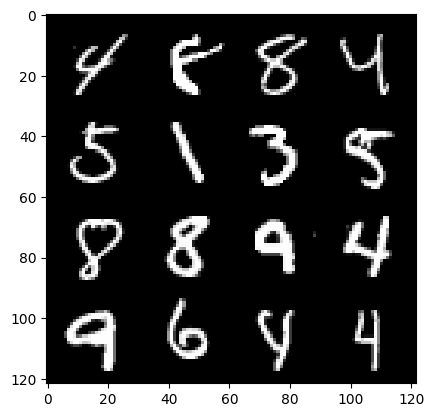

434: step 203700 / Gen loss 2.6127597165107725 / Disc loss 0.19470520305136857


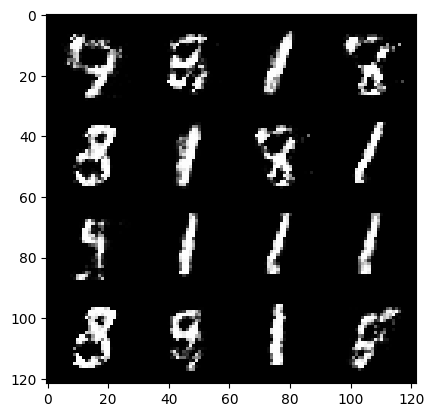

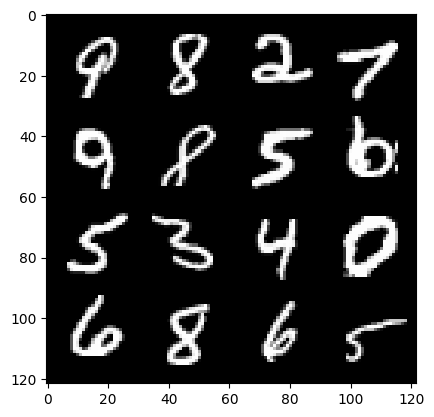

434: step 204000 / Gen loss 2.470519214471182 / Disc loss 0.2479387271900974


  0%|          | 0/469 [00:00<?, ?it/s]

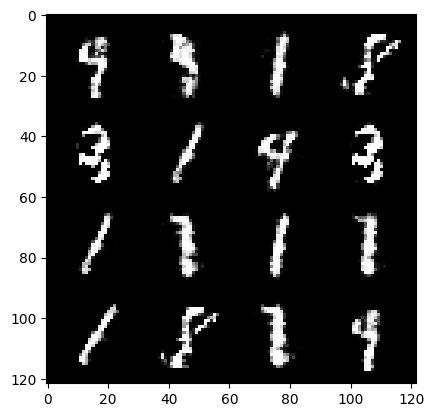

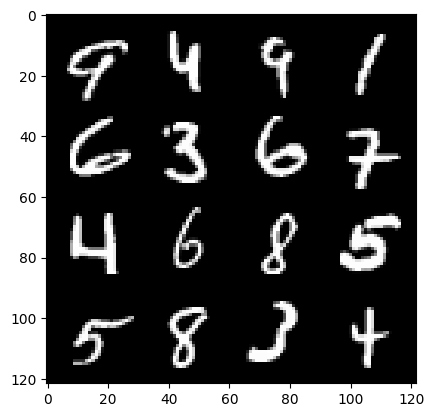

435: step 204300 / Gen loss 2.476333089669546 / Disc loss 0.21789324000477792


  0%|          | 0/469 [00:00<?, ?it/s]

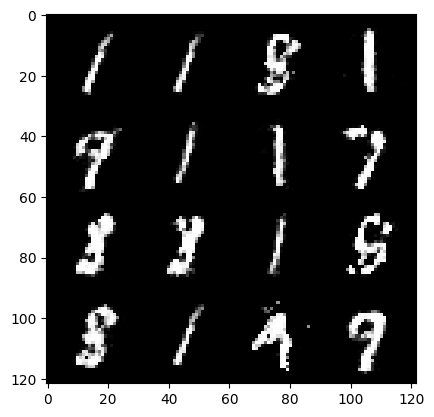

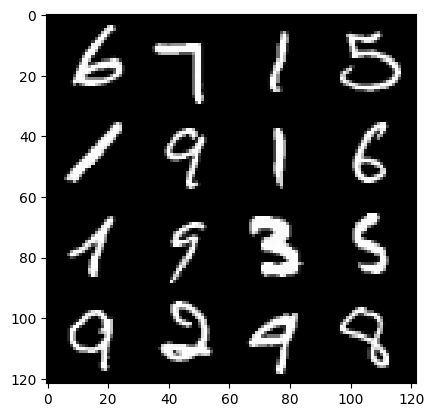

436: step 204600 / Gen loss 2.341164691050845 / Disc loss 0.2417272318899629


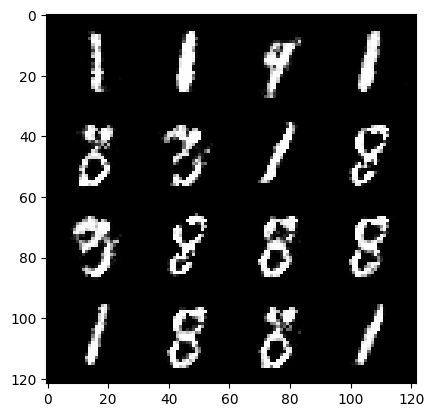

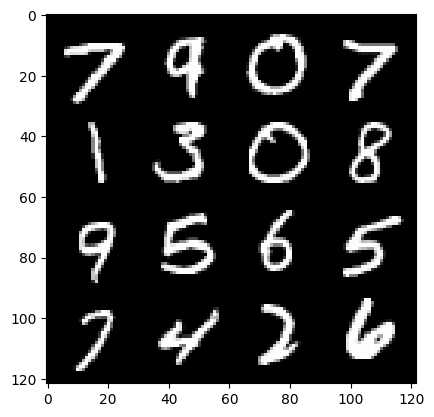

436: step 204900 / Gen loss 2.3513100842634835 / Disc loss 0.23637344290812798


  0%|          | 0/469 [00:00<?, ?it/s]

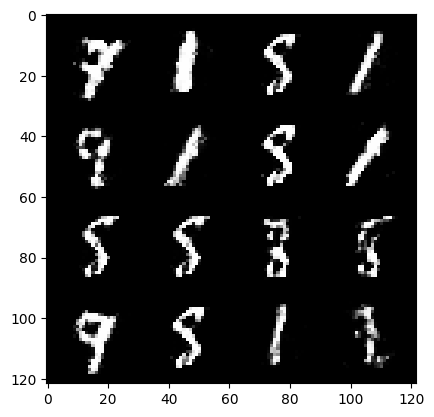

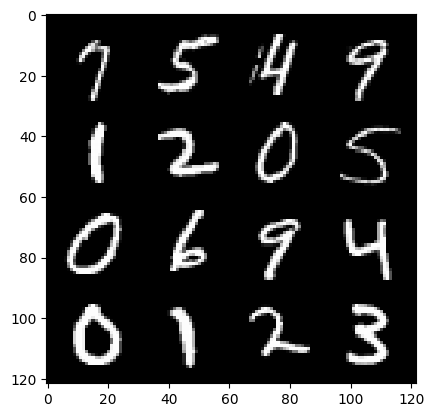

437: step 205200 / Gen loss 2.423609234491985 / Disc loss 0.22912193094690625


  0%|          | 0/469 [00:00<?, ?it/s]

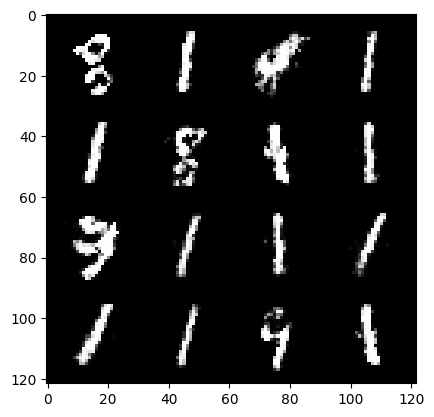

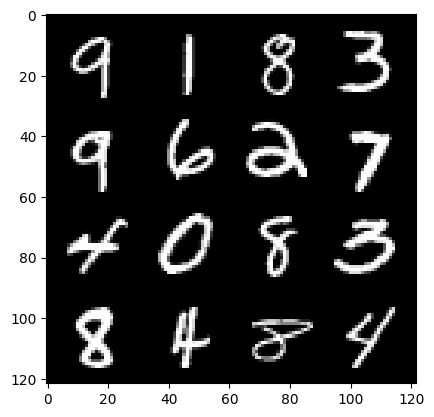

438: step 205500 / Gen loss 2.384686102072396 / Disc loss 0.22918421179056178


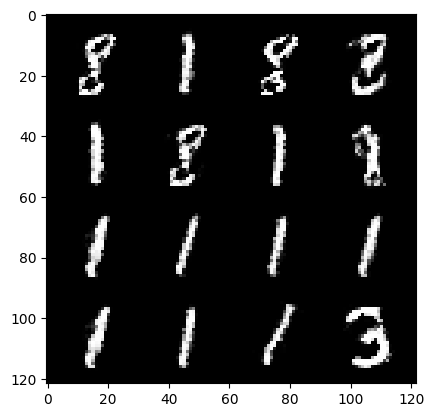

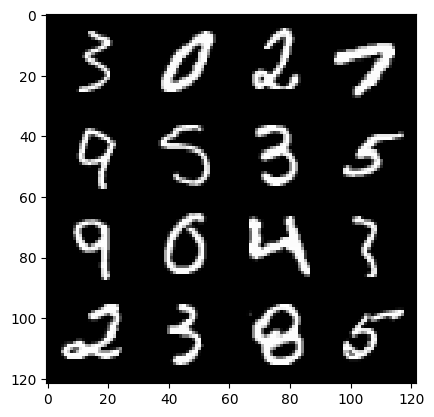

438: step 205800 / Gen loss 2.481410593191782 / Disc loss 0.21556320890784247


  0%|          | 0/469 [00:00<?, ?it/s]

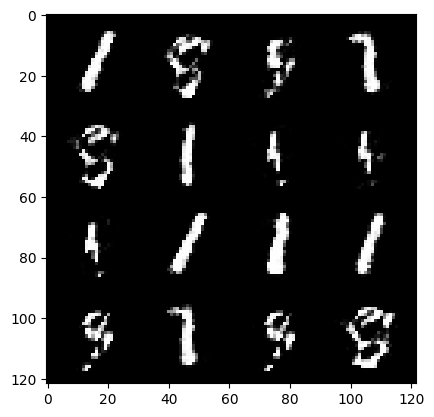

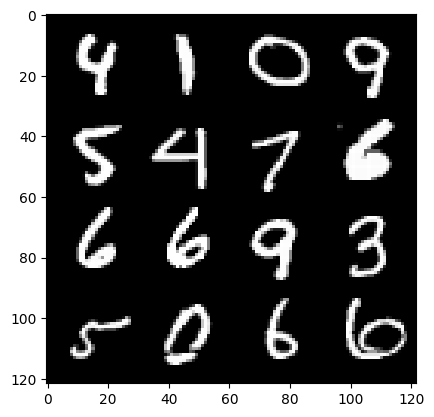

439: step 206100 / Gen loss 2.426116278568904 / Disc loss 0.21828891957799587


  0%|          | 0/469 [00:00<?, ?it/s]

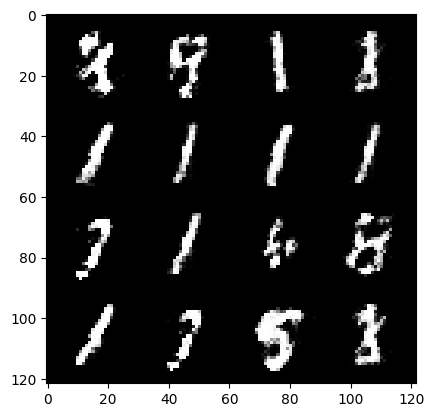

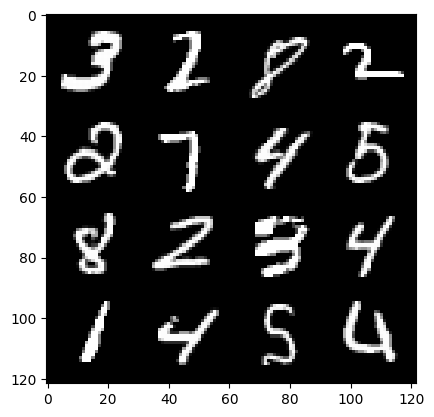

440: step 206400 / Gen loss 2.3609271303812673 / Disc loss 0.23457823783159246


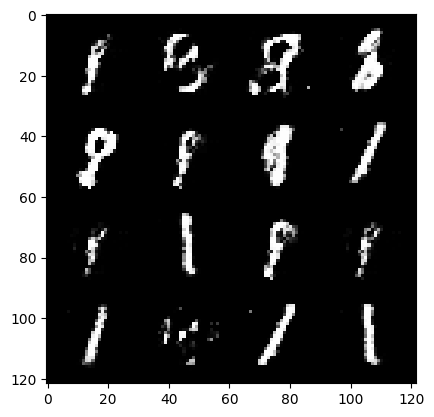

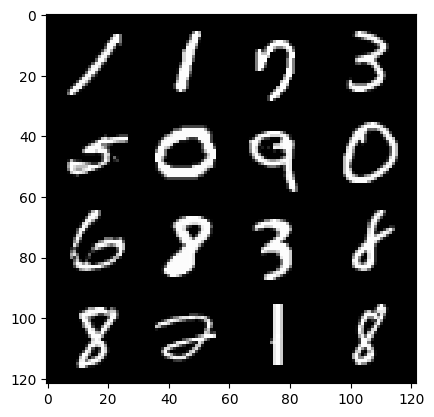

440: step 206700 / Gen loss 2.377396833499272 / Disc loss 0.2219022081792355


  0%|          | 0/469 [00:00<?, ?it/s]

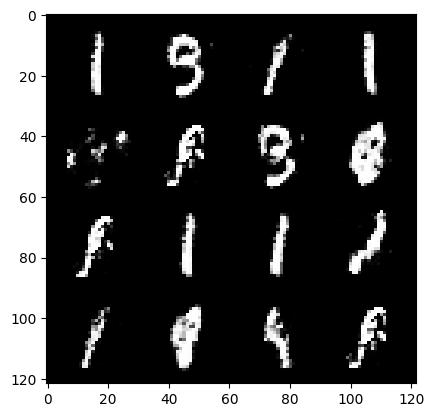

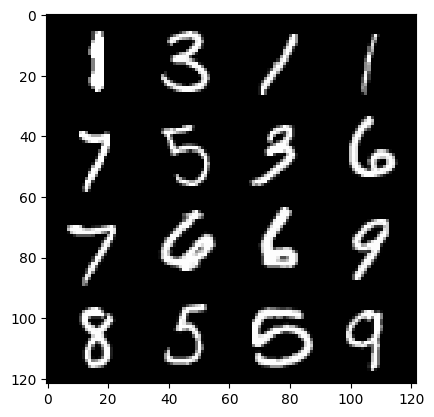

441: step 207000 / Gen loss 2.419844861825306 / Disc loss 0.19926150754094119


  0%|          | 0/469 [00:00<?, ?it/s]

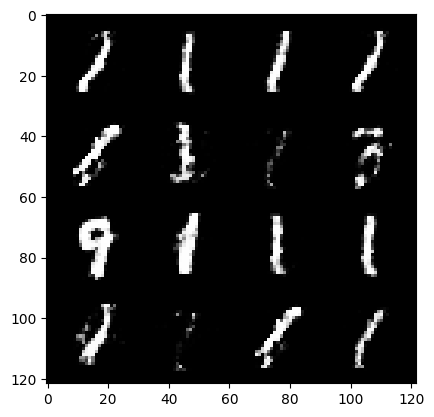

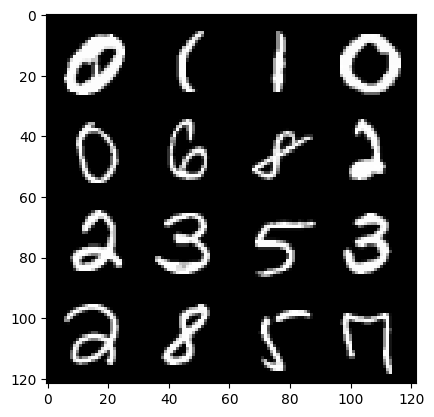

442: step 207300 / Gen loss 2.33631231745084 / Disc loss 0.22787000114719072


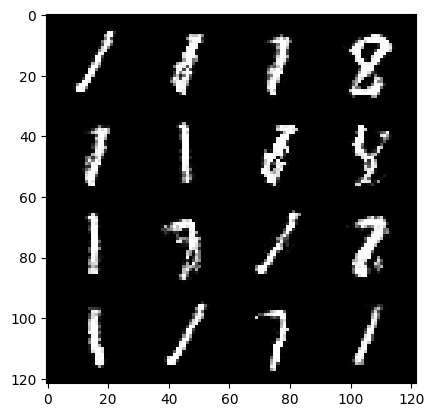

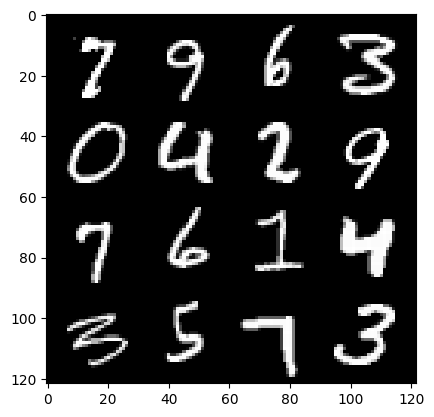

442: step 207600 / Gen loss 2.3996983563899996 / Disc loss 0.22068674698472007


  0%|          | 0/469 [00:00<?, ?it/s]

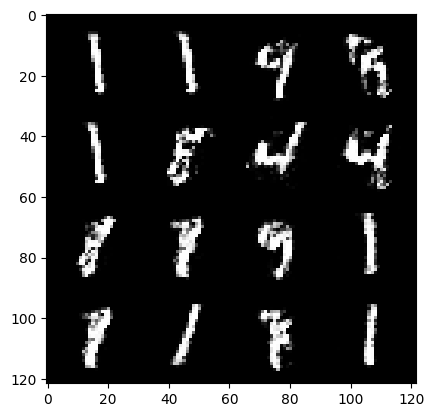

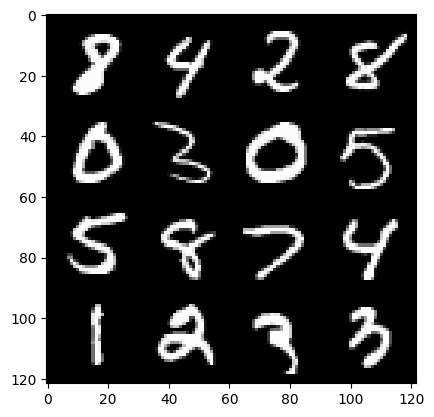

443: step 207900 / Gen loss 2.2617359519004823 / Disc loss 0.23407650580008832


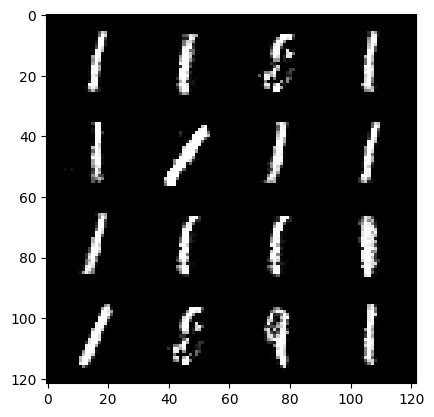

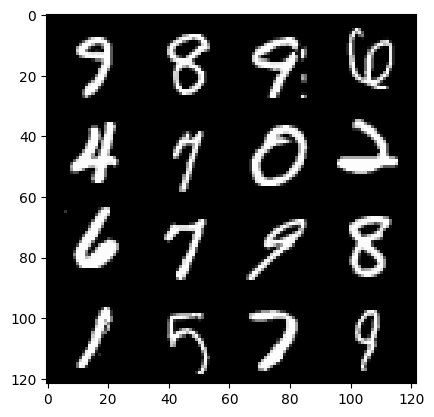

443: step 208200 / Gen loss 2.247712842623391 / Disc loss 0.23752212345600132


  0%|          | 0/469 [00:00<?, ?it/s]

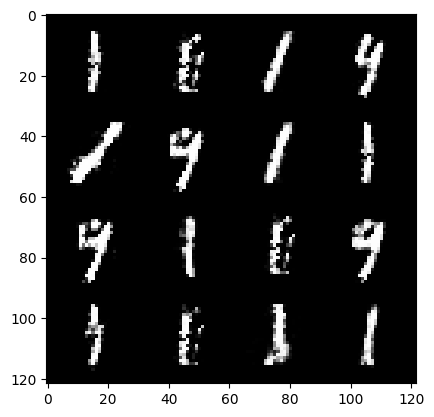

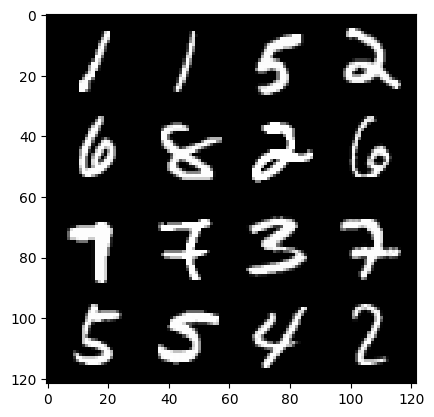

444: step 208500 / Gen loss 2.261529344717662 / Disc loss 0.22128701835870737


  0%|          | 0/469 [00:00<?, ?it/s]

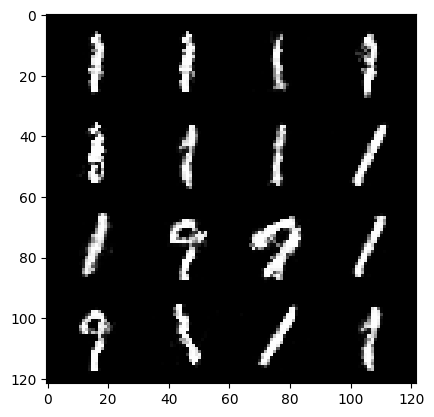

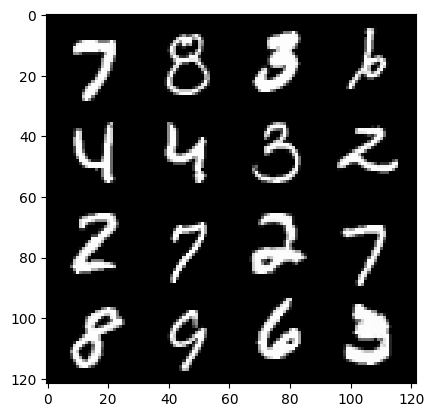

445: step 208800 / Gen loss 2.3542118306954682 / Disc loss 0.21423878024021797


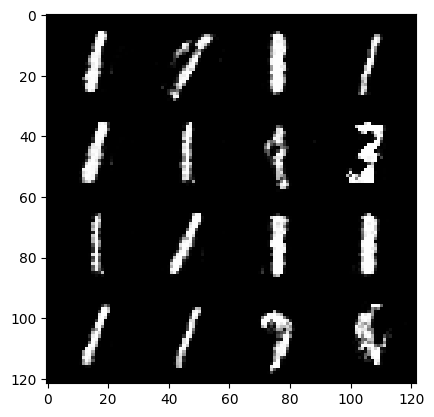

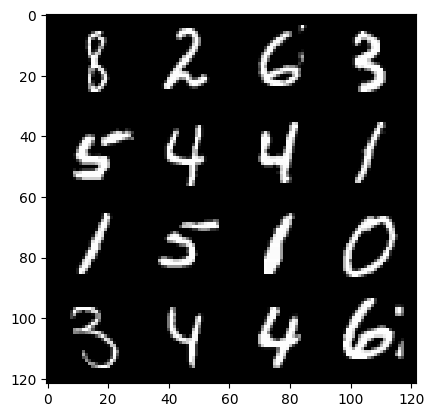

445: step 209100 / Gen loss 2.323487760225931 / Disc loss 0.2189925975600879


  0%|          | 0/469 [00:00<?, ?it/s]

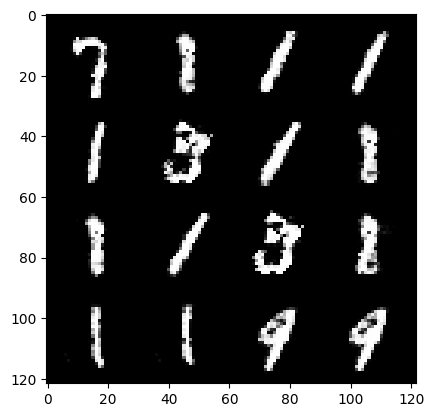

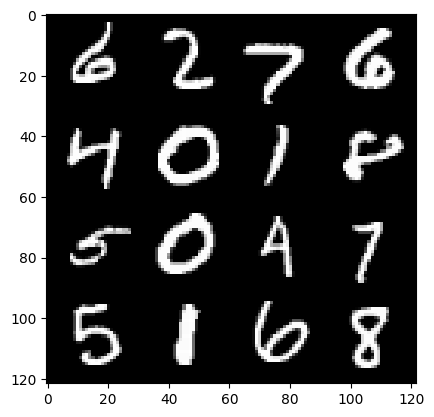

446: step 209400 / Gen loss 2.231407900651295 / Disc loss 0.253129477103551


  0%|          | 0/469 [00:00<?, ?it/s]

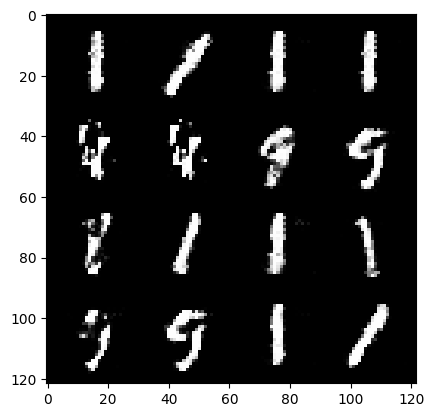

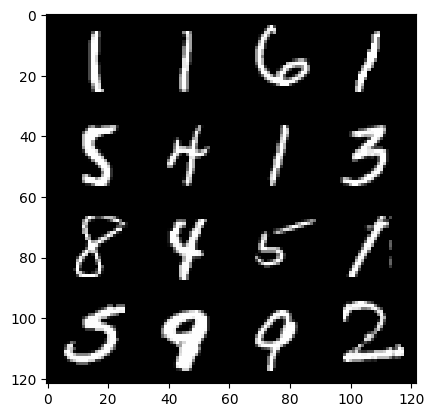

447: step 209700 / Gen loss 2.2443621261914584 / Disc loss 0.24805404697855316


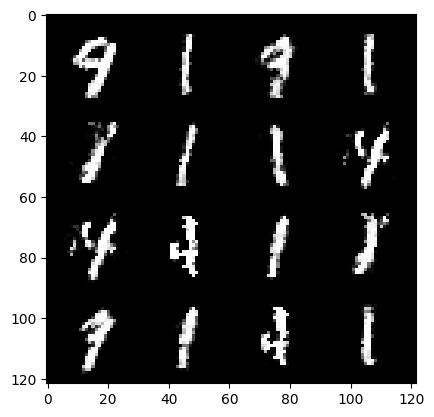

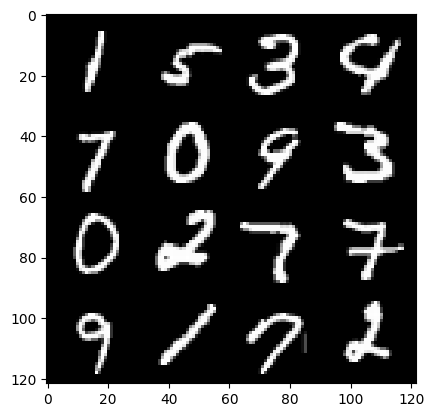

447: step 210000 / Gen loss 2.2171046562989556 / Disc loss 0.24065567627549173


  0%|          | 0/469 [00:00<?, ?it/s]

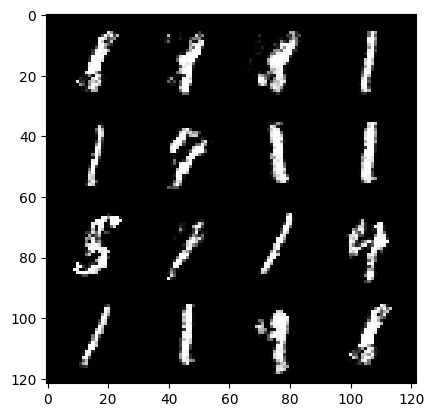

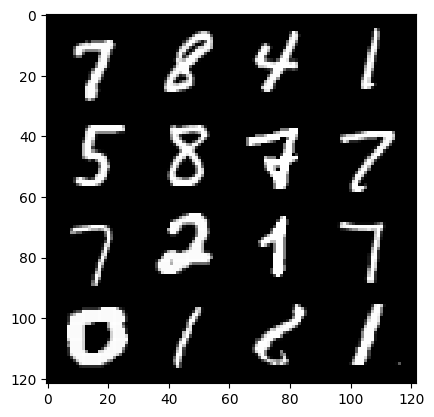

448: step 210300 / Gen loss 2.316347614129386 / Disc loss 0.23576543336113287


  0%|          | 0/469 [00:00<?, ?it/s]

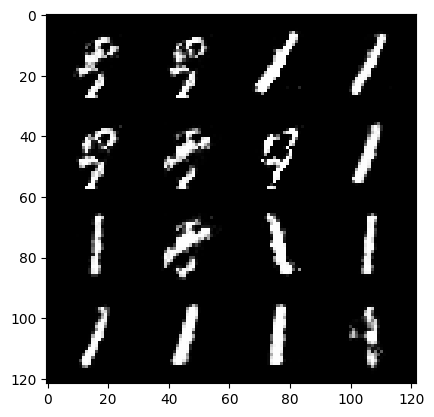

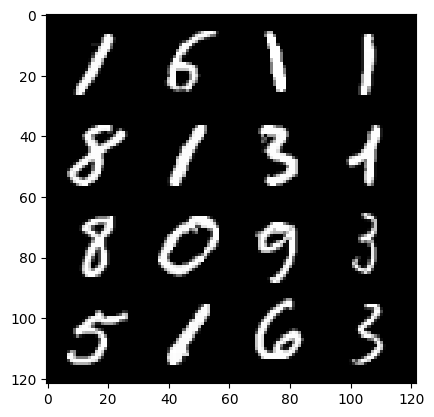

449: step 210600 / Gen loss 2.2304079751173633 / Disc loss 0.24994375194112448


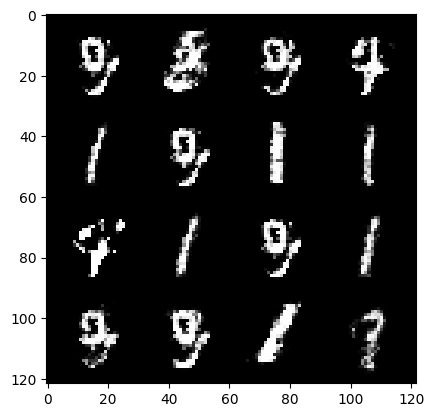

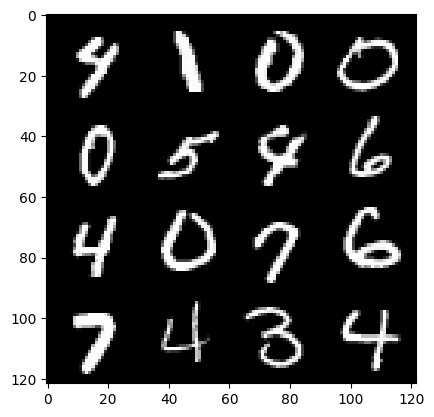

449: step 210900 / Gen loss 2.1775240810712178 / Disc loss 0.25729492758711164


  0%|          | 0/469 [00:00<?, ?it/s]

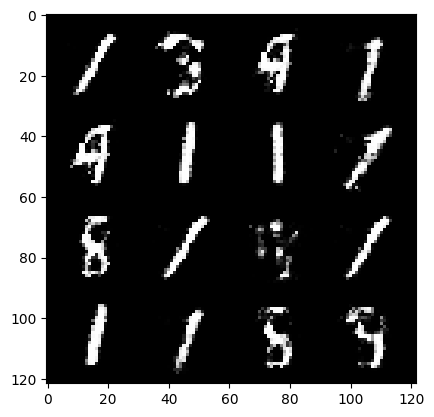

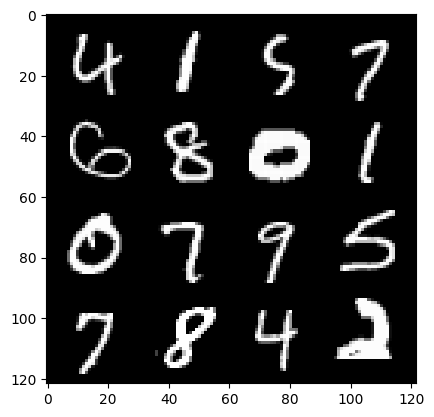

450: step 211200 / Gen loss 2.281021178563437 / Disc loss 0.223136652459701


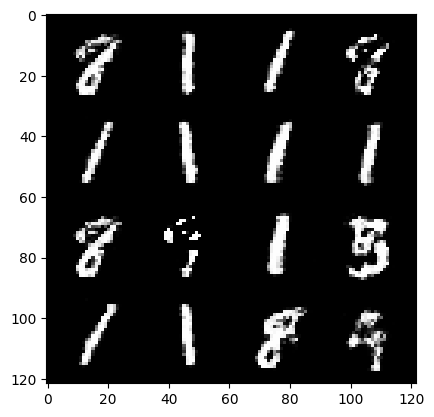

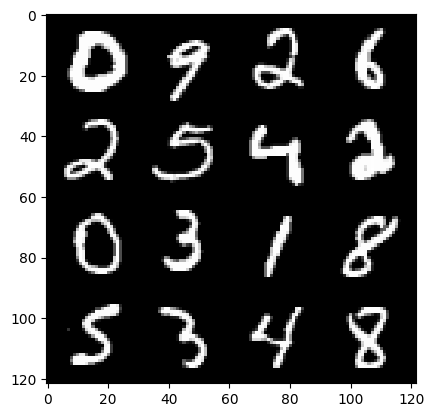

450: step 211500 / Gen loss 2.3347007246812175 / Disc loss 0.2519407215714454


  0%|          | 0/469 [00:00<?, ?it/s]

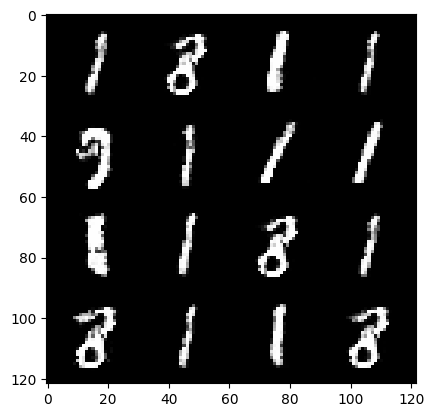

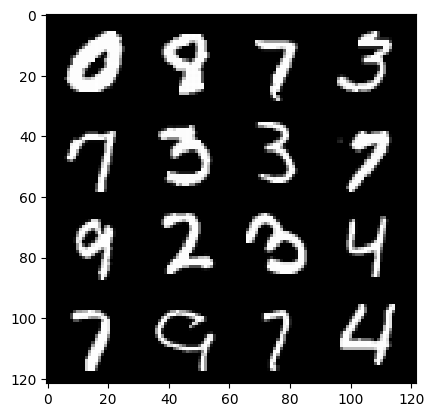

451: step 211800 / Gen loss 2.324037626187005 / Disc loss 0.22123461345831563


  0%|          | 0/469 [00:00<?, ?it/s]

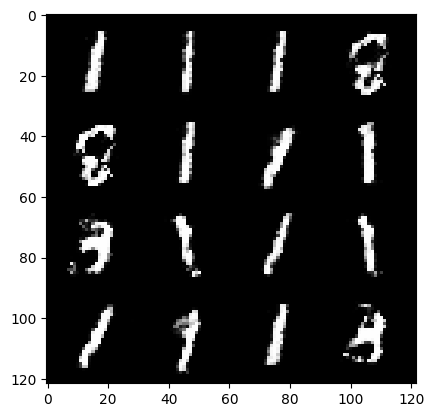

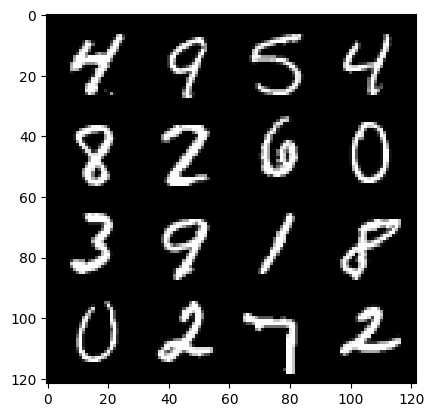

452: step 212100 / Gen loss 2.3007058139642074 / Disc loss 0.22562524269024525


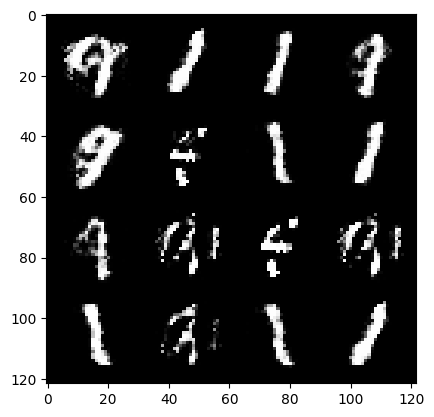

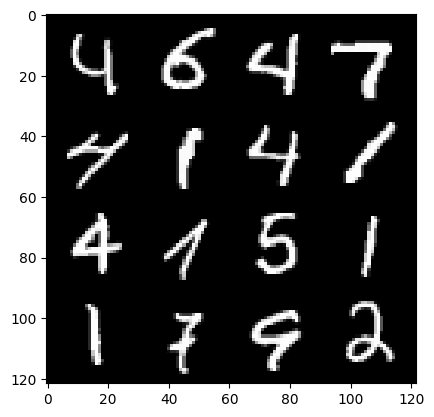

452: step 212400 / Gen loss 2.4591030279795327 / Disc loss 0.23859511561691762


  0%|          | 0/469 [00:00<?, ?it/s]

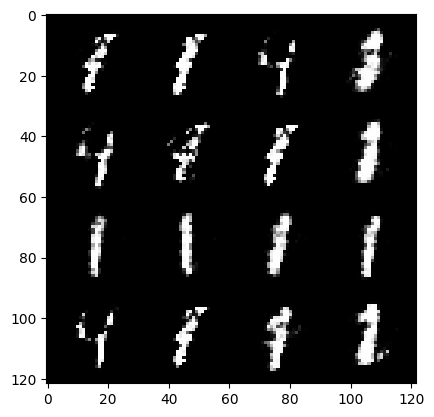

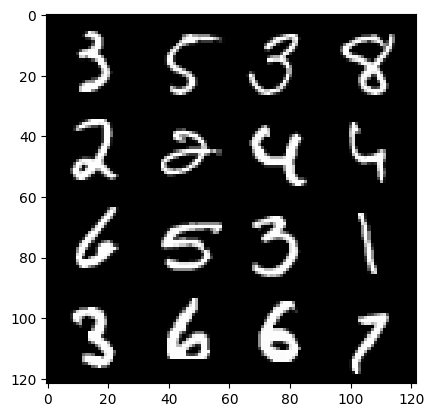

453: step 212700 / Gen loss 2.4763728745778413 / Disc loss 0.19815256131192055


  0%|          | 0/469 [00:00<?, ?it/s]

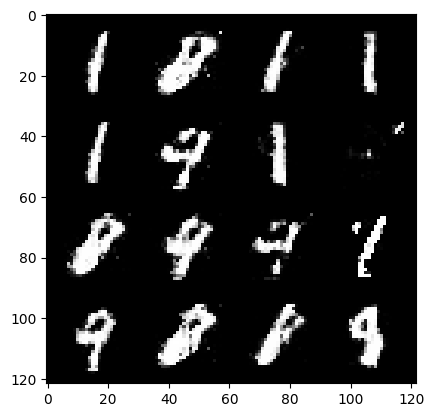

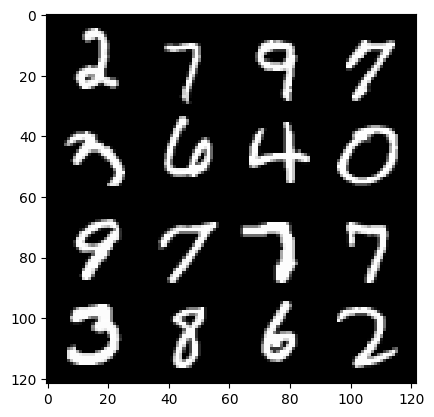

454: step 213000 / Gen loss 2.5649699775377908 / Disc loss 0.19348053144911911


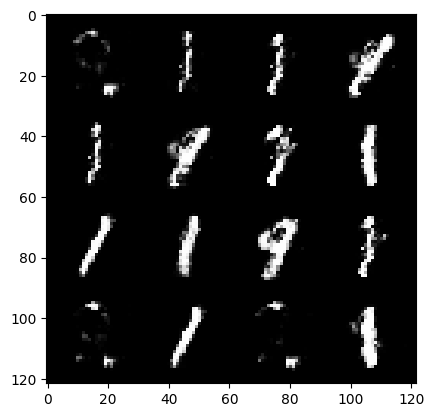

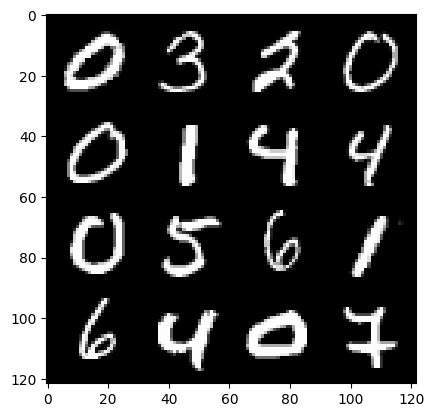

454: step 213300 / Gen loss 2.4803568673133847 / Disc loss 0.18625272110104557


  0%|          | 0/469 [00:00<?, ?it/s]

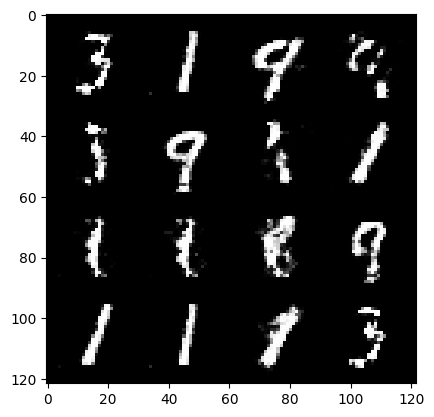

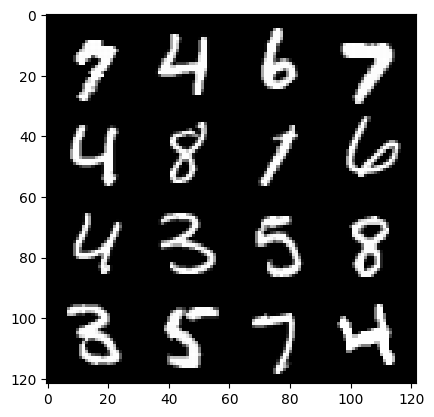

455: step 213600 / Gen loss 2.413337988853456 / Disc loss 0.20789420162638036


  0%|          | 0/469 [00:00<?, ?it/s]

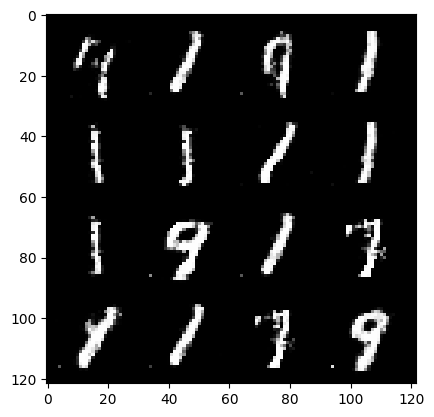

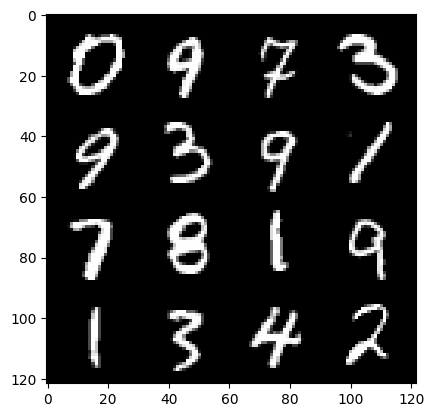

456: step 213900 / Gen loss 2.3547302718957273 / Disc loss 0.2244220592329899


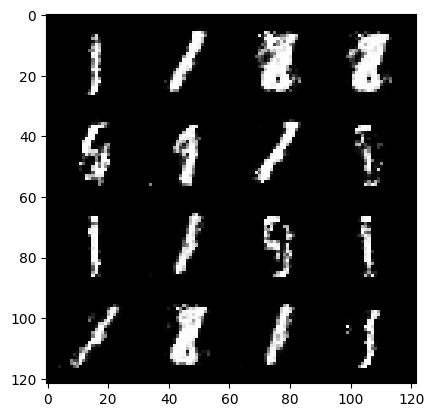

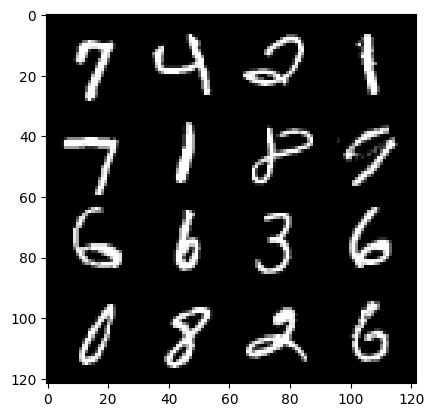

456: step 214200 / Gen loss 2.228513091802599 / Disc loss 0.22274139598011994


  0%|          | 0/469 [00:00<?, ?it/s]

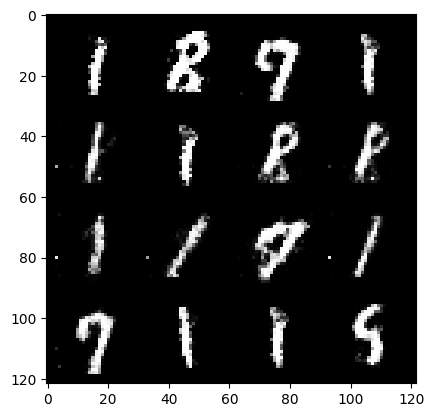

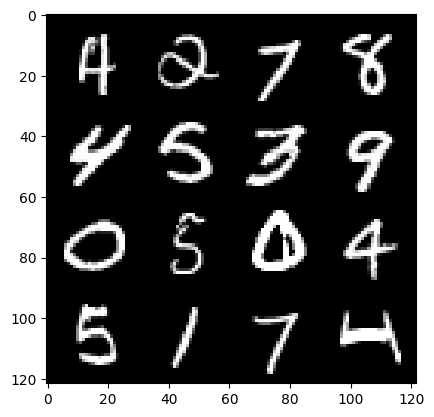

457: step 214500 / Gen loss 2.258710313240687 / Disc loss 0.2722860137124858


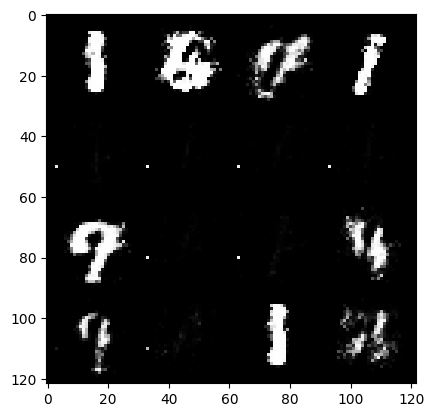

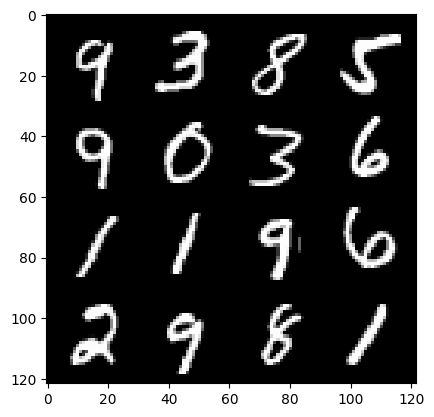

457: step 214800 / Gen loss 1.1834193797906238 / Disc loss 2.249909860094388


  0%|          | 0/469 [00:00<?, ?it/s]

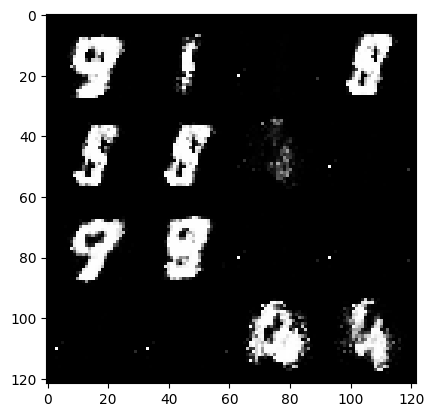

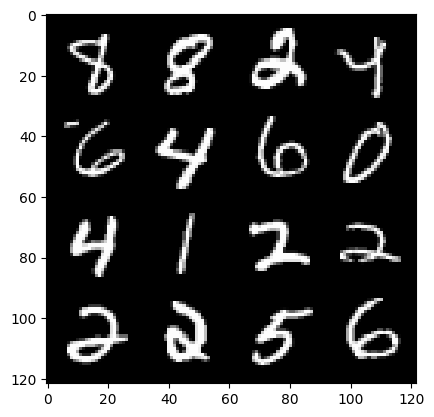

458: step 215100 / Gen loss 1.6983134305477143 / Disc loss 0.5619546909133593


  0%|          | 0/469 [00:00<?, ?it/s]

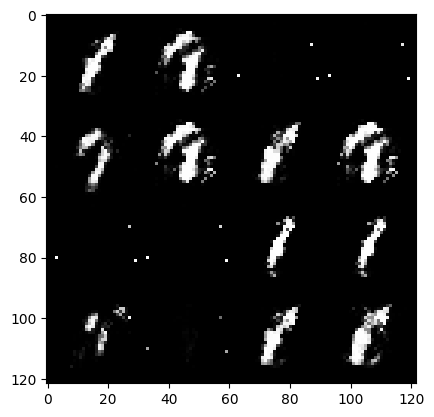

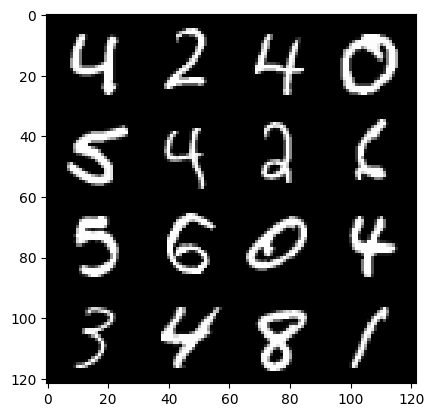

459: step 215400 / Gen loss 2.1304564825693775 / Disc loss 0.5195492798089979


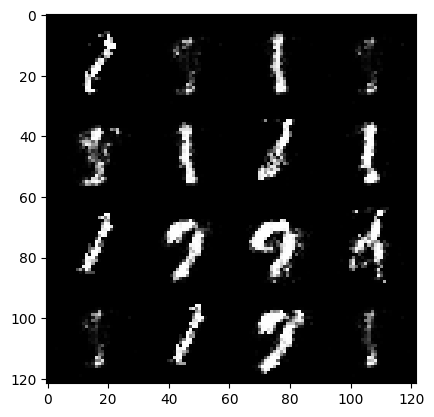

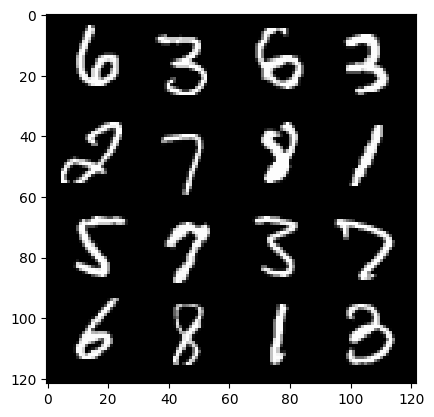

459: step 215700 / Gen loss 2.3695159184932733 / Disc loss 0.3318867385884126


  0%|          | 0/469 [00:00<?, ?it/s]

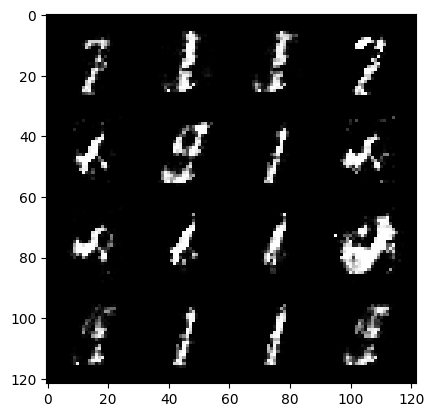

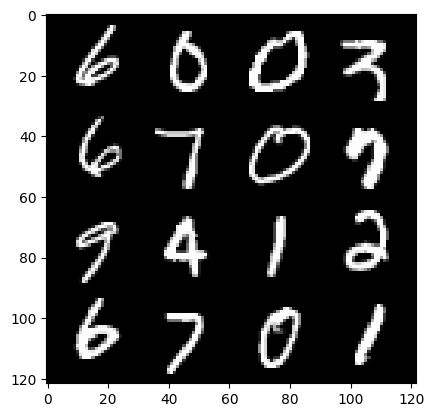

460: step 216000 / Gen loss 1.5915801139672585 / Disc loss 0.33512783825397496


  0%|          | 0/469 [00:00<?, ?it/s]

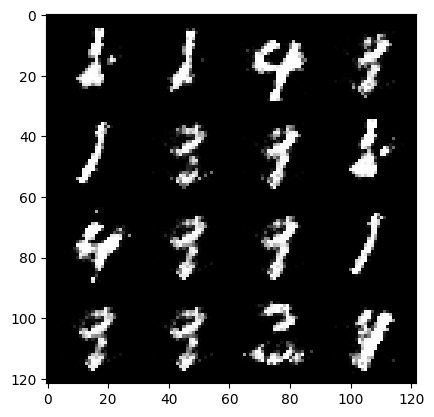

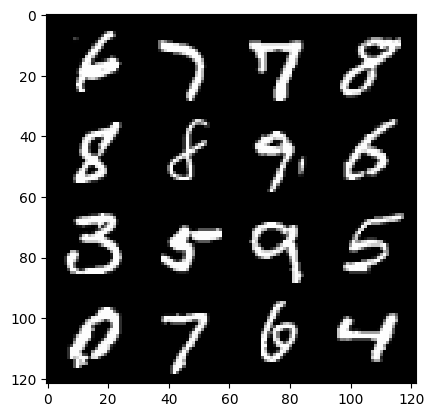

461: step 216300 / Gen loss 1.6567851523558283 / Disc loss 0.32030012925465917


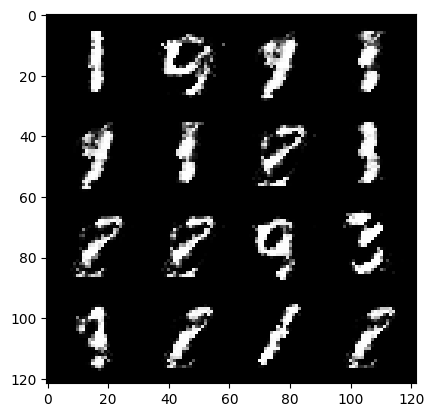

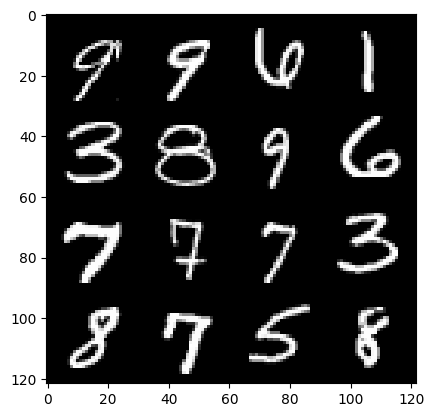

461: step 216600 / Gen loss 1.774008858601253 / Disc loss 0.32117092981934536


  0%|          | 0/469 [00:00<?, ?it/s]

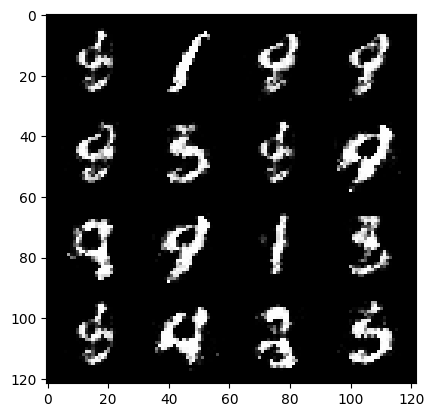

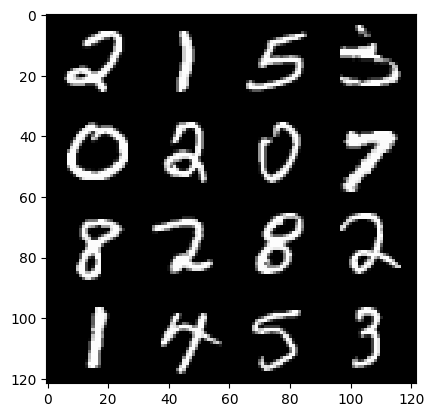

462: step 216900 / Gen loss 1.742999230623246 / Disc loss 0.3304354460040727


  0%|          | 0/469 [00:00<?, ?it/s]

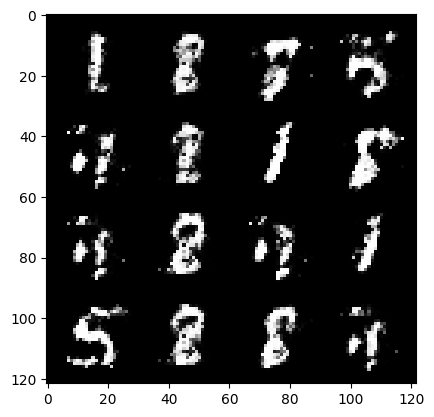

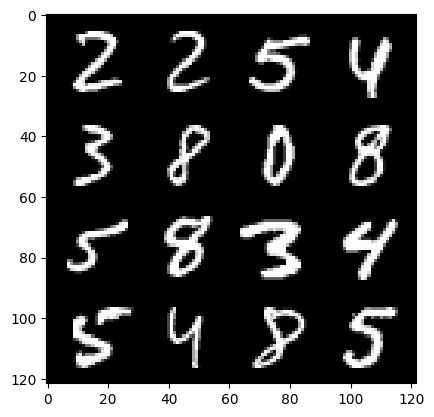

463: step 217200 / Gen loss 1.724694781303406 / Disc loss 0.34425582279761635


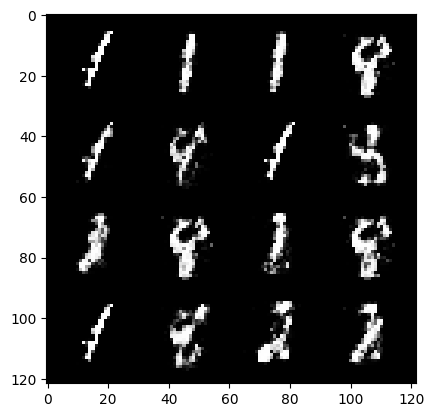

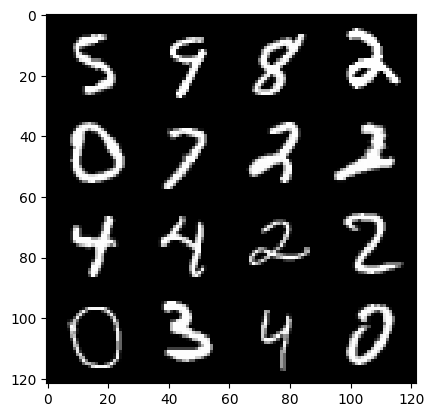

463: step 217500 / Gen loss 1.8189226567745207 / Disc loss 0.29911266644795753


  0%|          | 0/469 [00:00<?, ?it/s]

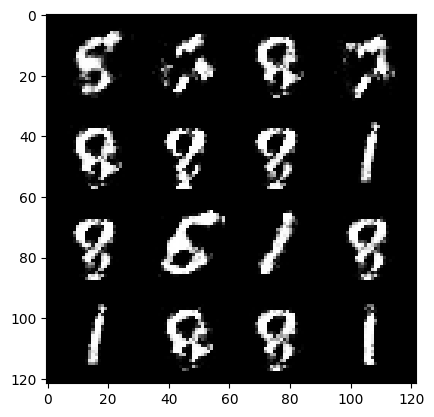

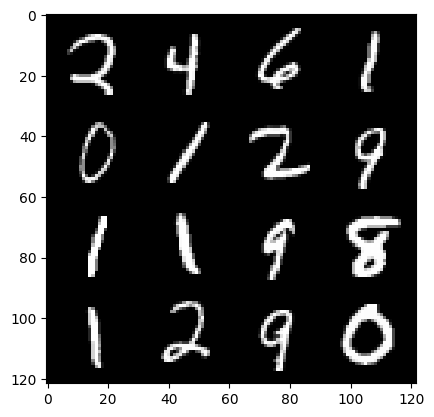

464: step 217800 / Gen loss 1.8858558622996033 / Disc loss 0.29112842758496593


  0%|          | 0/469 [00:00<?, ?it/s]

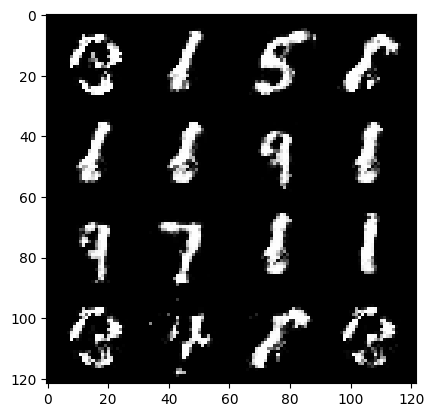

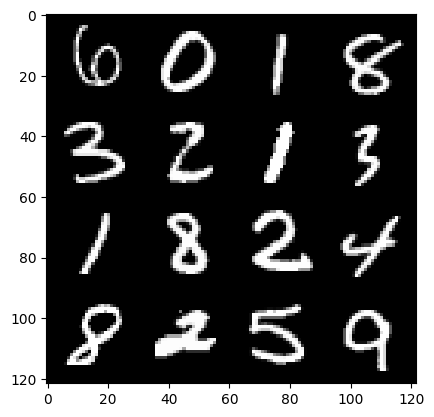

465: step 218100 / Gen loss 1.8439041439692179 / Disc loss 0.33298531403144205


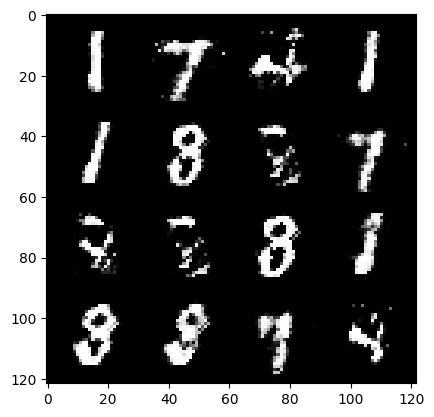

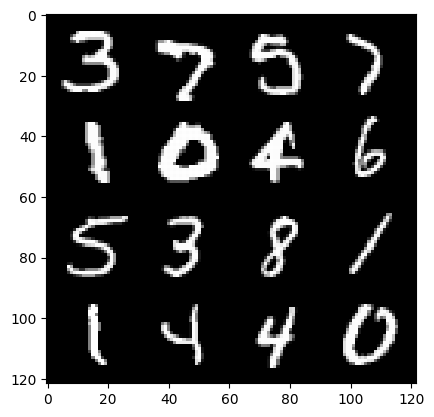

465: step 218400 / Gen loss 1.8907374791304254 / Disc loss 0.29698347682754206


  0%|          | 0/469 [00:00<?, ?it/s]

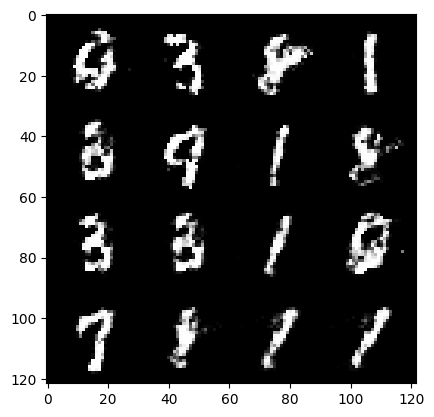

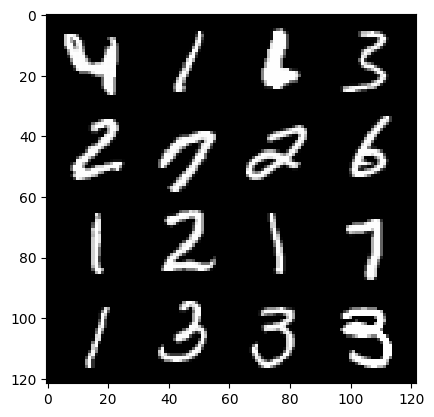

466: step 218700 / Gen loss 1.8432454939683283 / Disc loss 0.3130789058407148


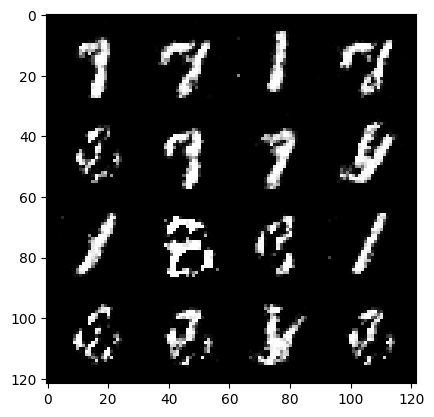

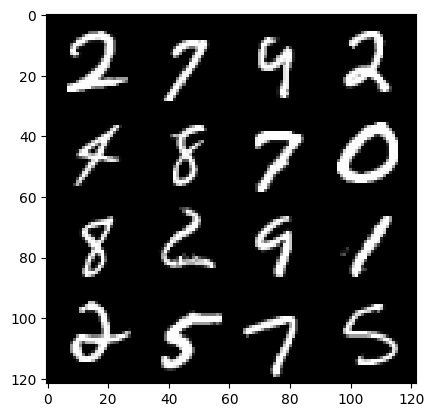

466: step 219000 / Gen loss 1.7913104724884026 / Disc loss 0.34785893281300845


  0%|          | 0/469 [00:00<?, ?it/s]

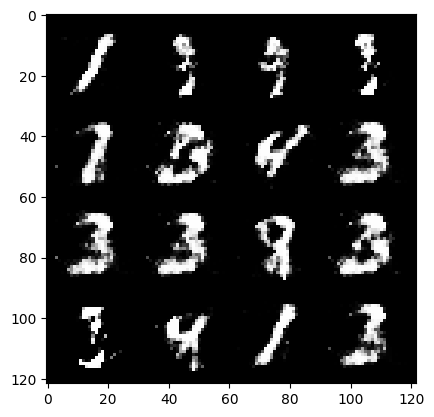

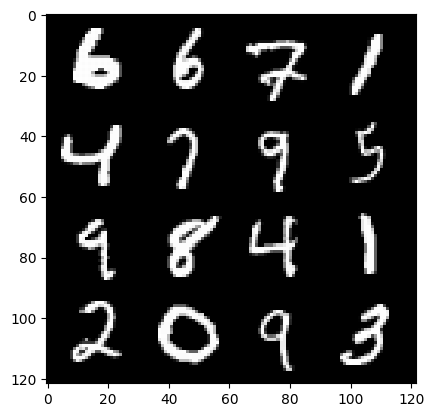

467: step 219300 / Gen loss 1.8069283537069951 / Disc loss 0.32854360873500504


  0%|          | 0/469 [00:00<?, ?it/s]

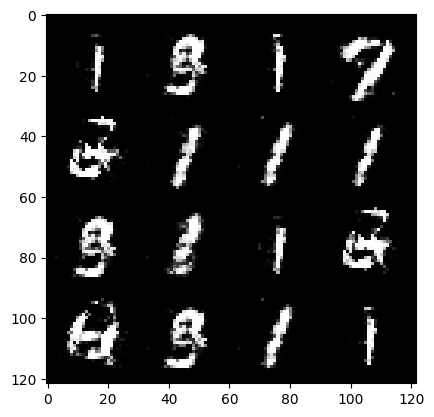

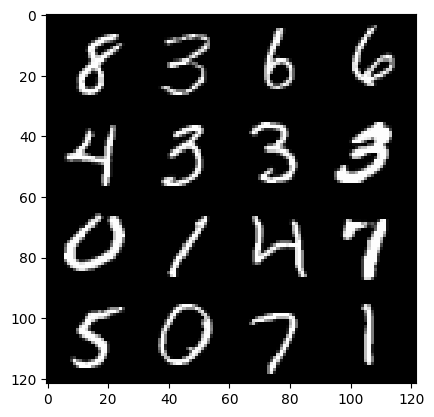

468: step 219600 / Gen loss 1.9856860689322144 / Disc loss 0.27034665609399494


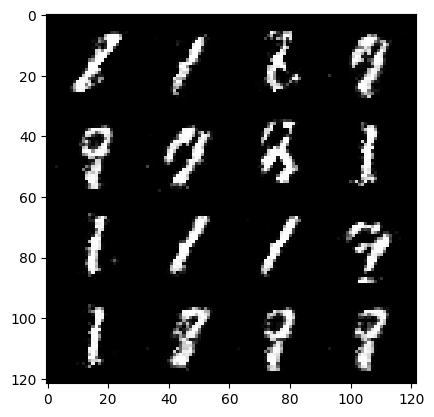

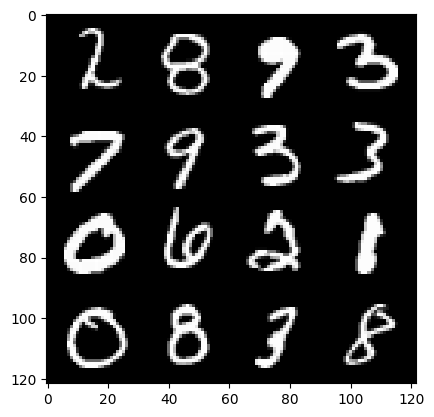

468: step 219900 / Gen loss 1.8905135480562825 / Disc loss 0.28658066113789876


  0%|          | 0/469 [00:00<?, ?it/s]

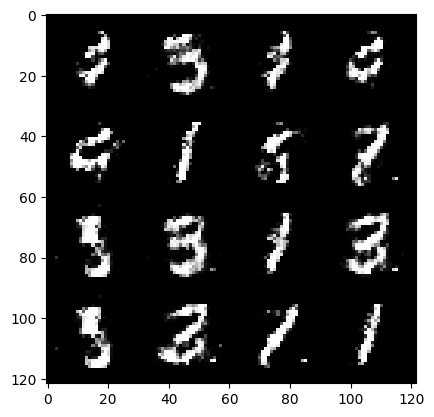

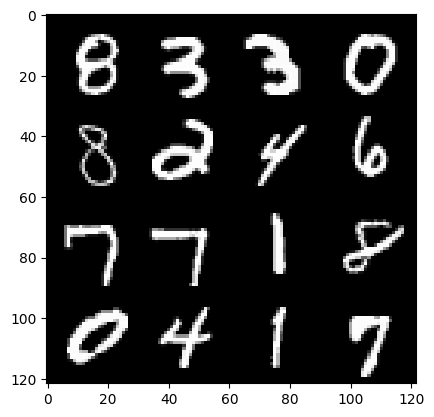

469: step 220200 / Gen loss 1.881492632230123 / Disc loss 0.28295493245124825


  0%|          | 0/469 [00:00<?, ?it/s]

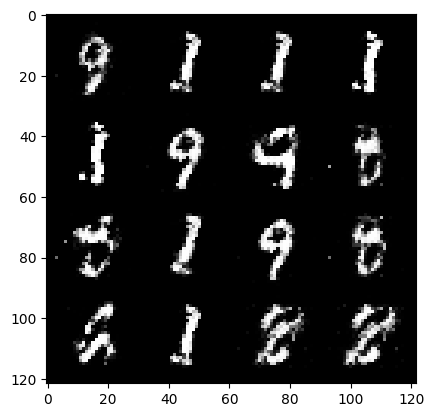

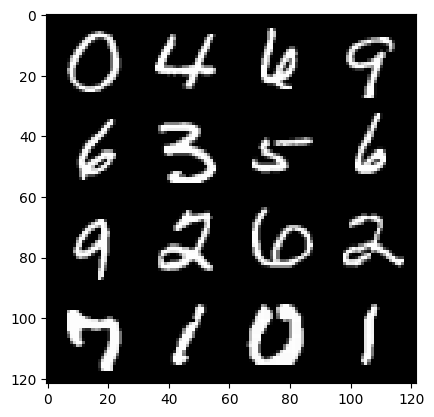

470: step 220500 / Gen loss 1.9832087727387746 / Disc loss 0.2654000727832316


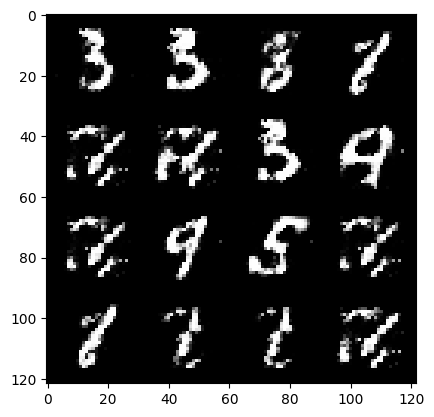

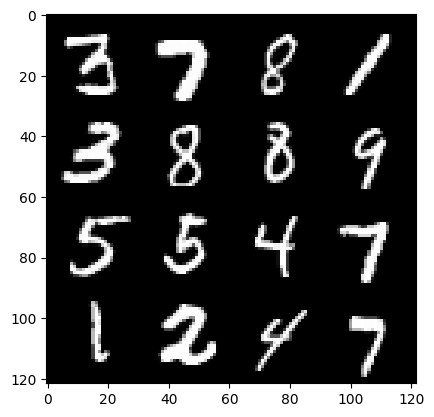

470: step 220800 / Gen loss 1.9814681589603431 / Disc loss 0.28193983634312936


  0%|          | 0/469 [00:00<?, ?it/s]

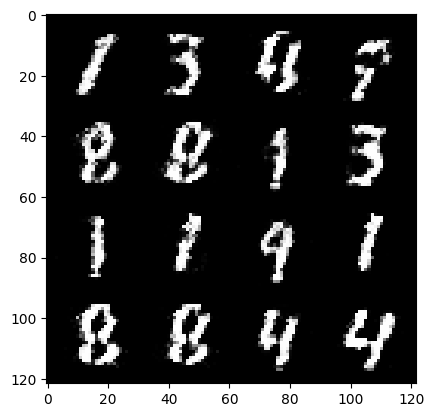

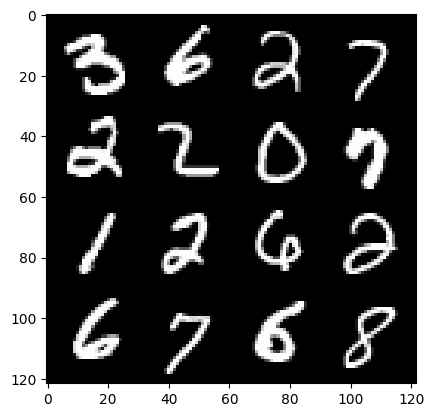

471: step 221100 / Gen loss 2.089131716092426 / Disc loss 0.2520335675776004


  0%|          | 0/469 [00:00<?, ?it/s]

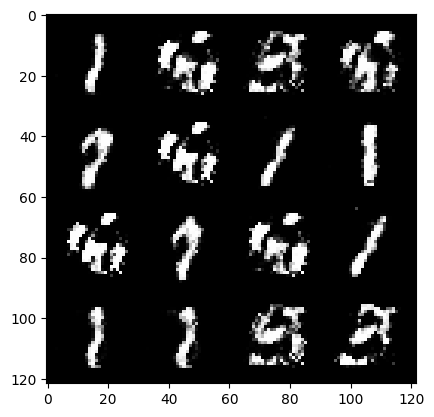

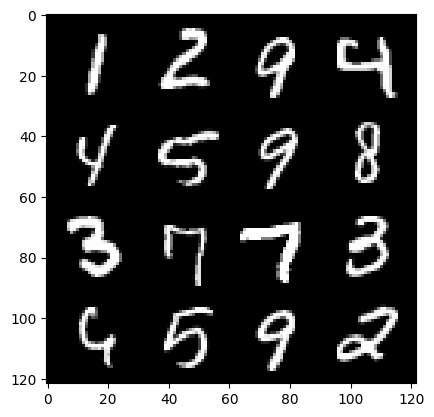

472: step 221400 / Gen loss 2.1083446645736683 / Disc loss 0.266191509415706


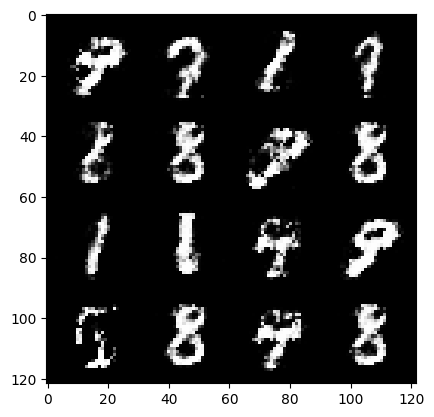

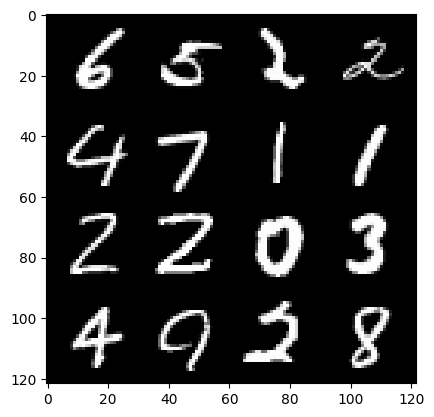

472: step 221700 / Gen loss 2.0940359715620676 / Disc loss 0.26917955189943304


  0%|          | 0/469 [00:00<?, ?it/s]

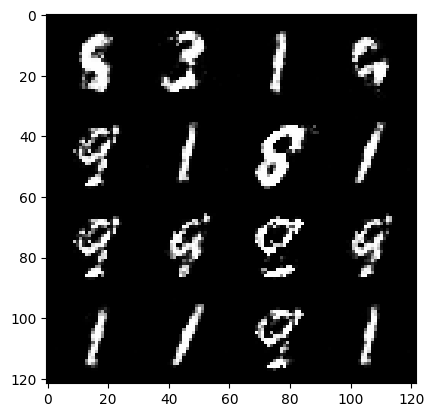

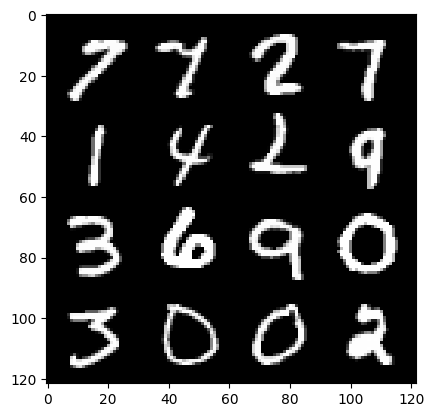

473: step 222000 / Gen loss 2.025394495725632 / Disc loss 0.29440588692824043


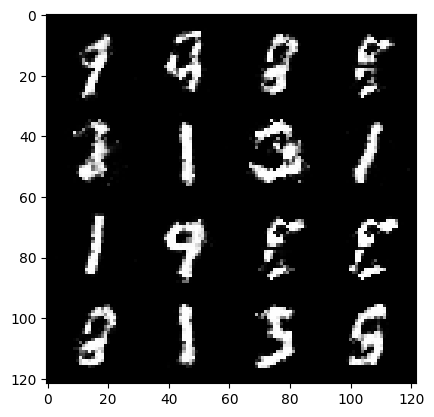

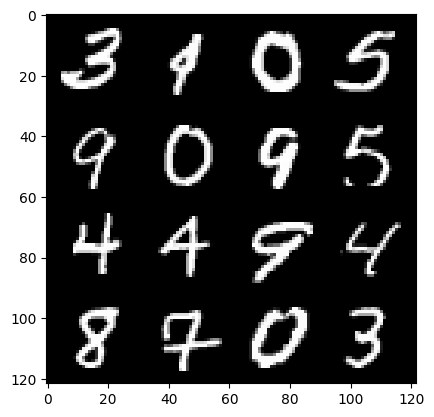

473: step 222300 / Gen loss 1.964440180063248 / Disc loss 0.297185609638691


  0%|          | 0/469 [00:00<?, ?it/s]

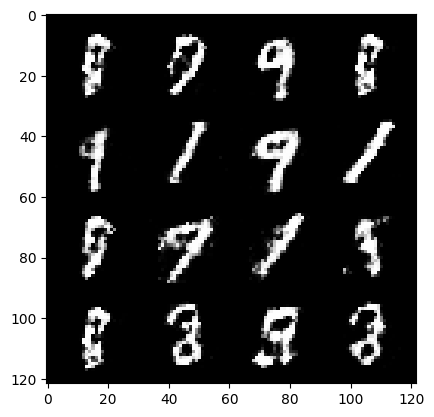

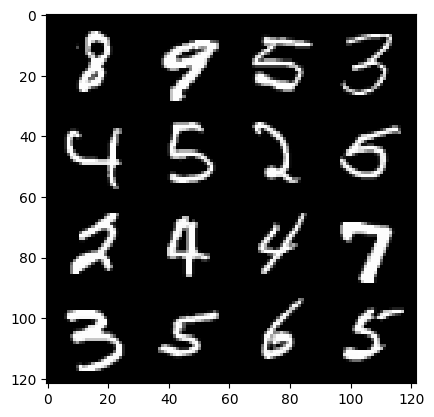

474: step 222600 / Gen loss 2.0272051239013664 / Disc loss 0.27988786583145464


  0%|          | 0/469 [00:00<?, ?it/s]

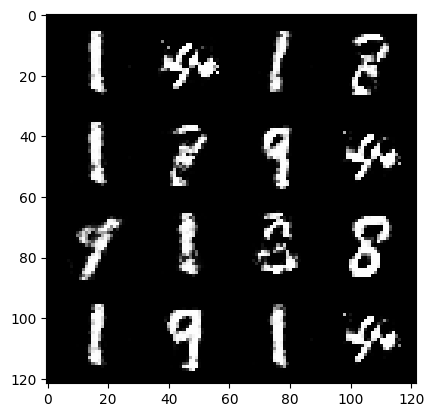

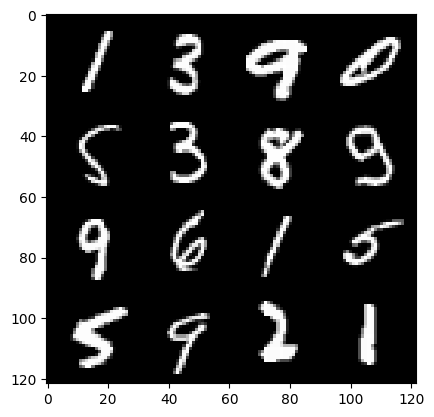

475: step 222900 / Gen loss 1.9208075690269466 / Disc loss 0.3035379612445835


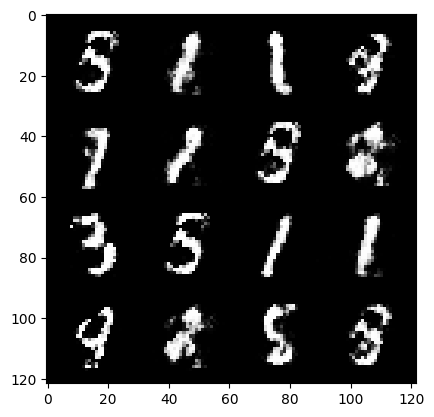

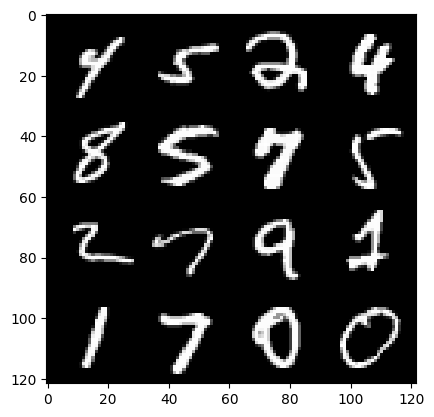

475: step 223200 / Gen loss 1.900930283864339 / Disc loss 0.32596873005231203


  0%|          | 0/469 [00:00<?, ?it/s]

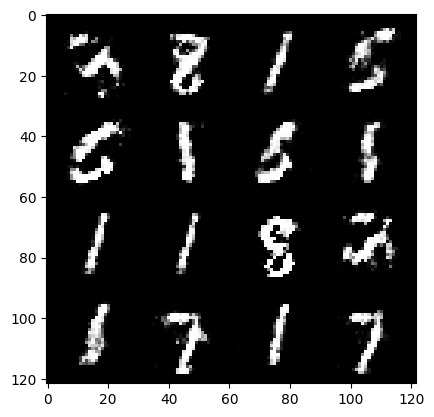

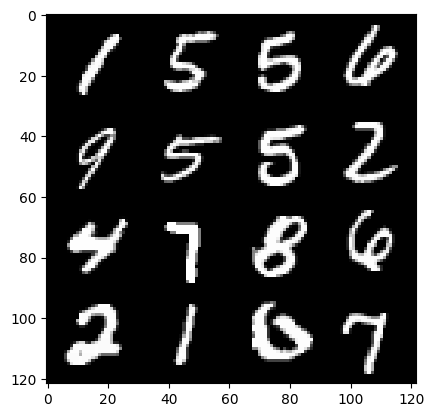

476: step 223500 / Gen loss 1.9337079763412468 / Disc loss 0.34228768040736535


  0%|          | 0/469 [00:00<?, ?it/s]

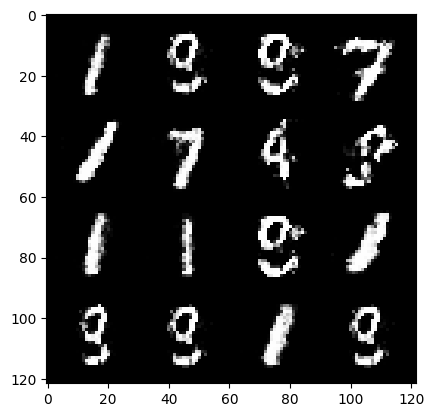

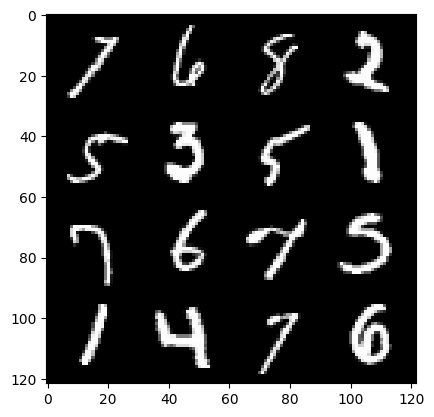

477: step 223800 / Gen loss 1.9936673982938127 / Disc loss 0.2996713674565158


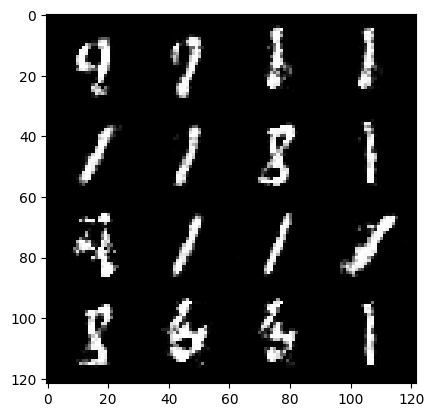

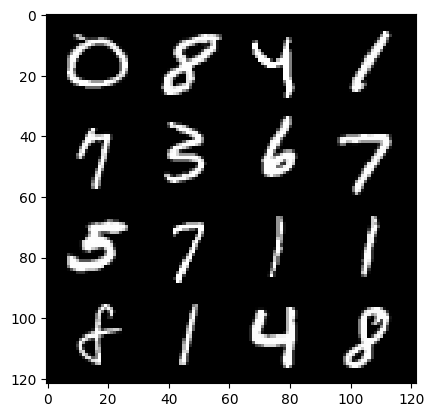

477: step 224100 / Gen loss 1.9393707168102265 / Disc loss 0.2978112810850144


  0%|          | 0/469 [00:00<?, ?it/s]

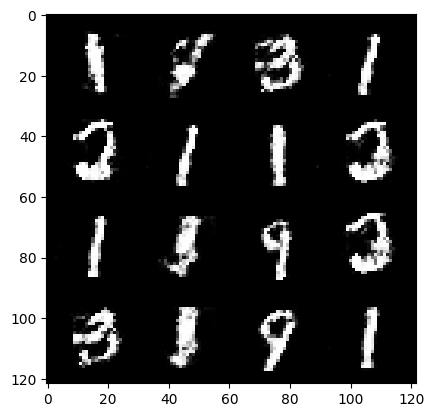

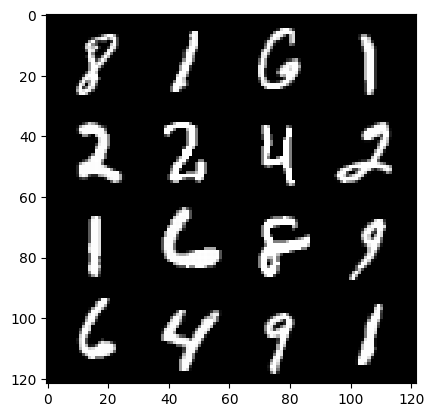

478: step 224400 / Gen loss 1.930226987600326 / Disc loss 0.3158862641950449


  0%|          | 0/469 [00:00<?, ?it/s]

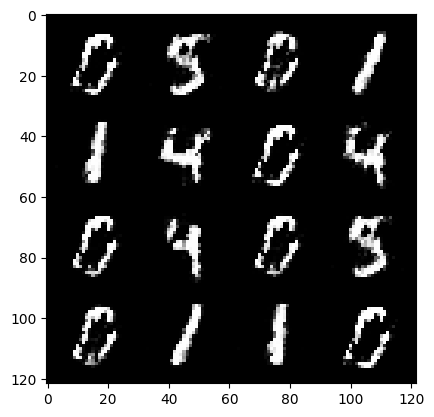

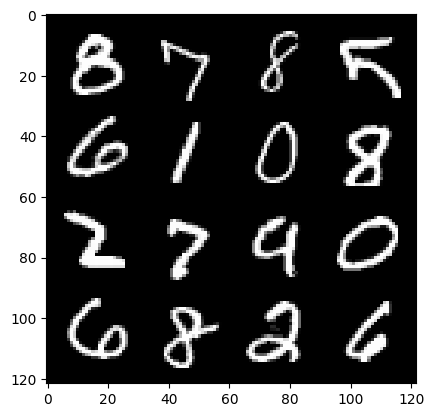

479: step 224700 / Gen loss 2.0359667297204354 / Disc loss 0.3218774751822154


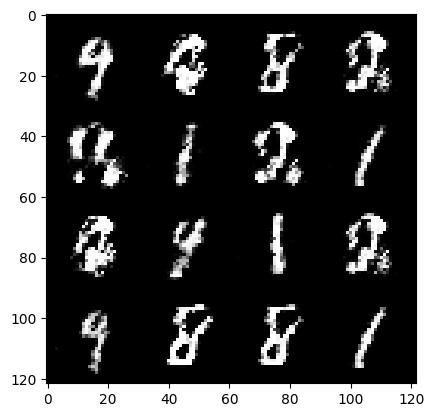

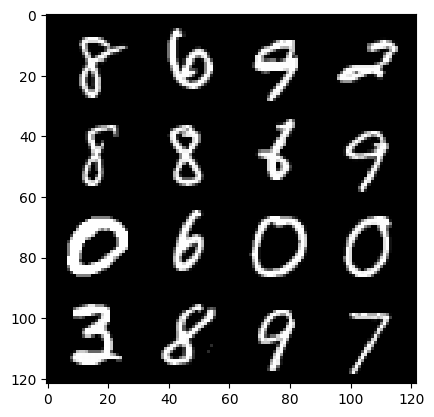

479: step 225000 / Gen loss 2.1005673209826163 / Disc loss 0.2771445821722349


  0%|          | 0/469 [00:00<?, ?it/s]

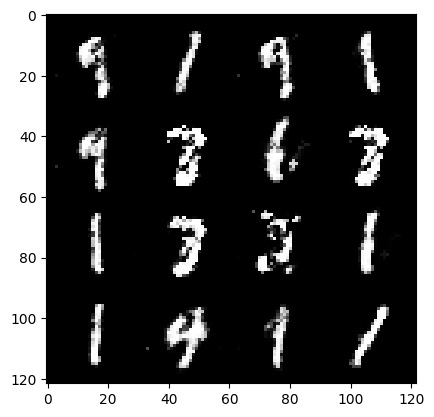

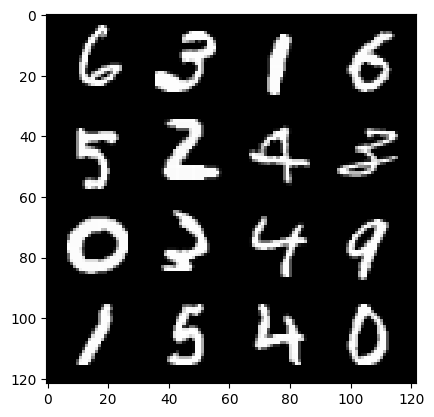

480: step 225300 / Gen loss 2.007375026941299 / Disc loss 0.3149461499353251


  0%|          | 0/469 [00:00<?, ?it/s]

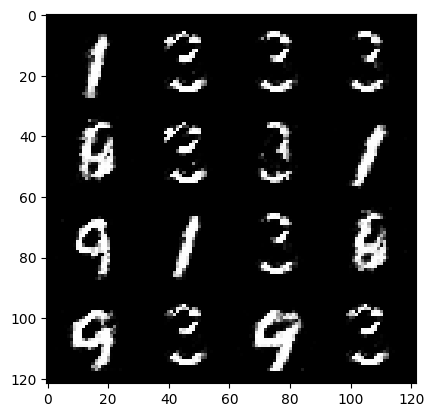

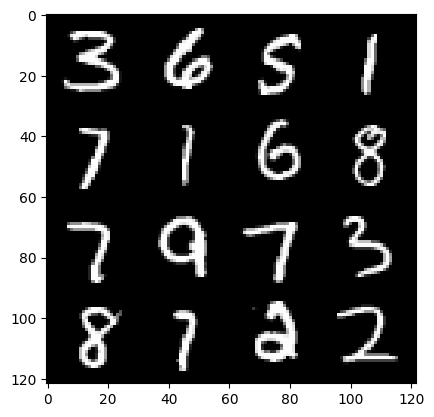

481: step 225600 / Gen loss 1.980433258612951 / Disc loss 0.29614667445421233


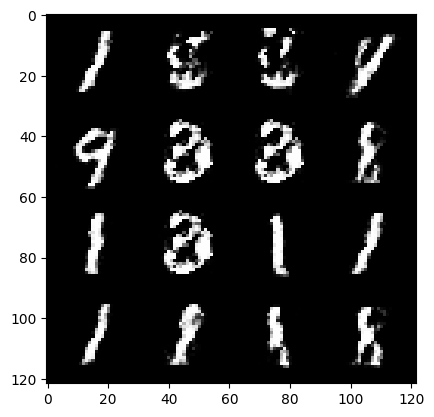

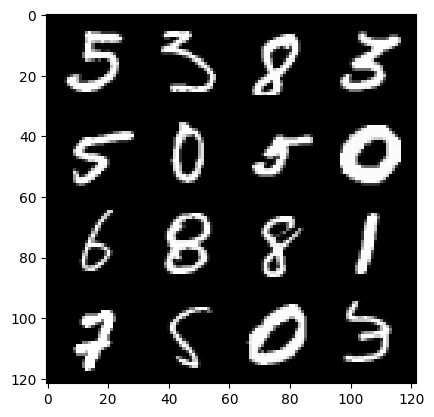

481: step 225900 / Gen loss 1.9929218399524693 / Disc loss 0.3122103002667428


  0%|          | 0/469 [00:00<?, ?it/s]

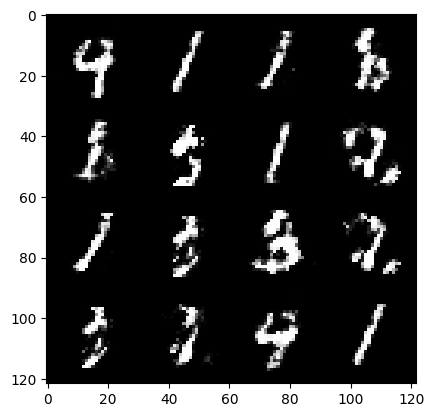

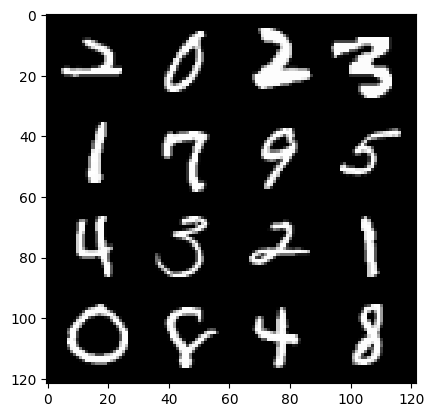

482: step 226200 / Gen loss 2.0554195932547263 / Disc loss 0.30043069009979567


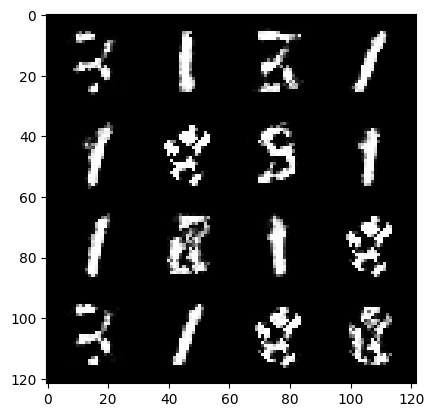

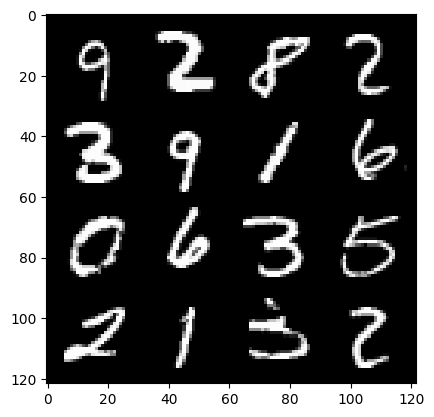

482: step 226500 / Gen loss 2.1081829543908435 / Disc loss 0.2576061242322127


  0%|          | 0/469 [00:00<?, ?it/s]

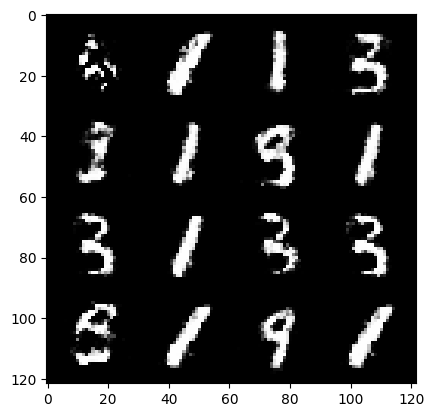

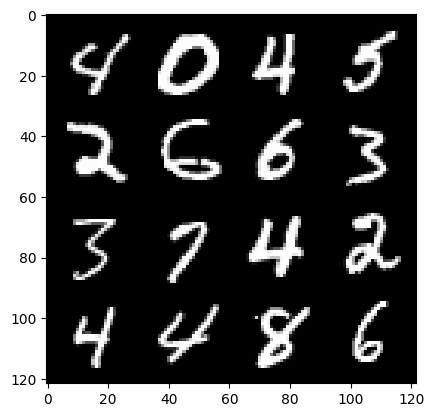

483: step 226800 / Gen loss 2.148955860137939 / Disc loss 0.2674330992003282


  0%|          | 0/469 [00:00<?, ?it/s]

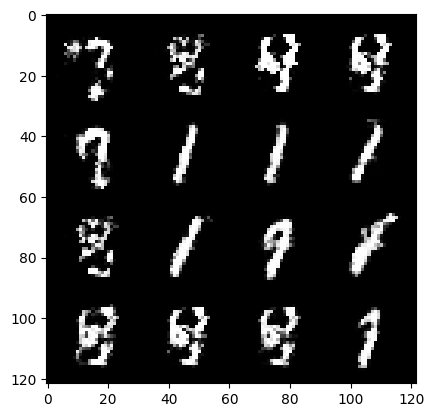

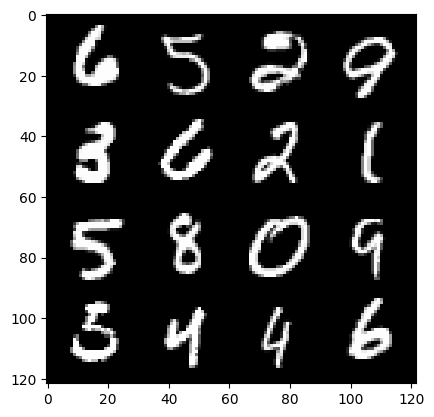

484: step 227100 / Gen loss 2.229877695639927 / Disc loss 0.2606506252785523


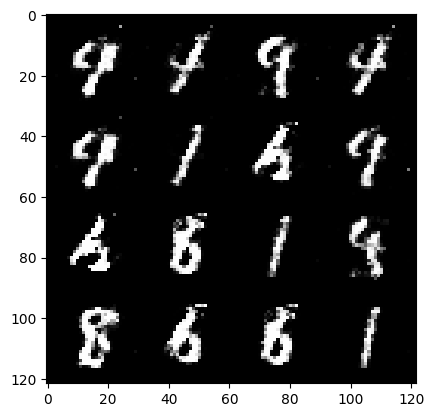

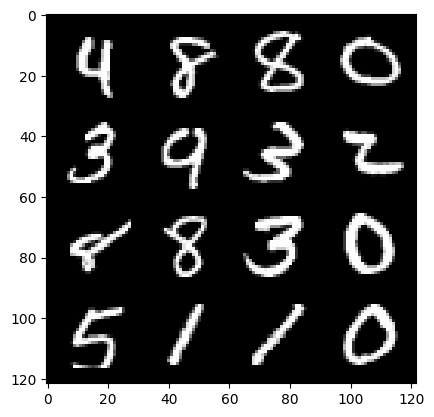

484: step 227400 / Gen loss 2.13706112384796 / Disc loss 0.27551115284363425


  0%|          | 0/469 [00:00<?, ?it/s]

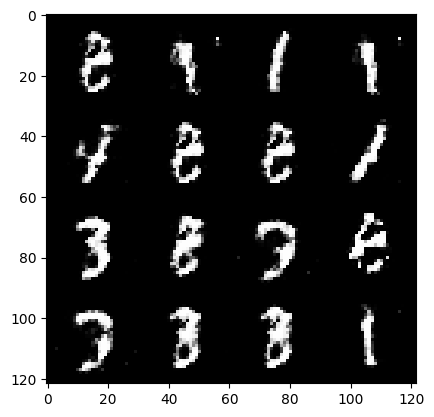

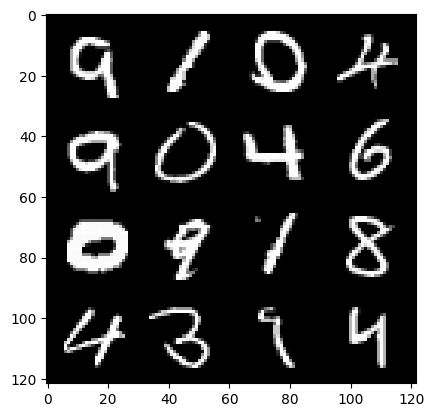

485: step 227700 / Gen loss 2.0802896654605867 / Disc loss 0.28112724741299955


  0%|          | 0/469 [00:00<?, ?it/s]

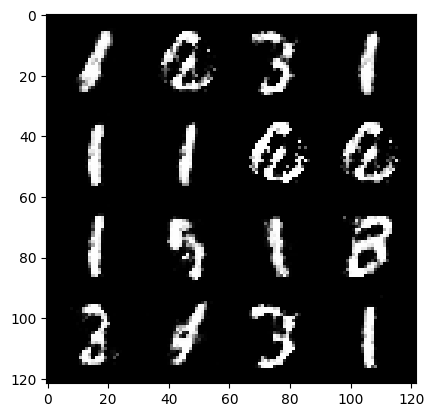

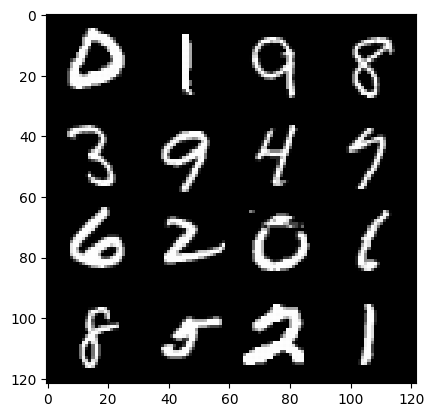

486: step 228000 / Gen loss 2.103817754189174 / Disc loss 0.2745999990900354


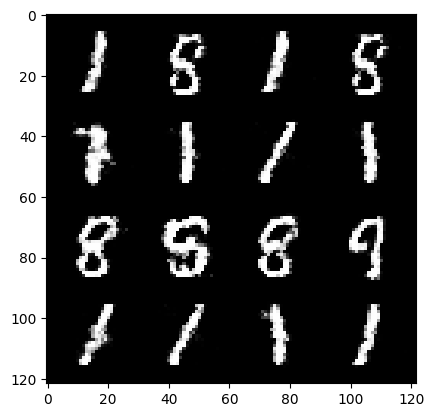

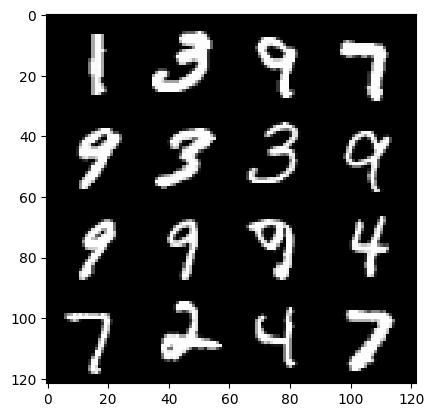

486: step 228300 / Gen loss 2.072334756851197 / Disc loss 0.2946330272157984


  0%|          | 0/469 [00:00<?, ?it/s]

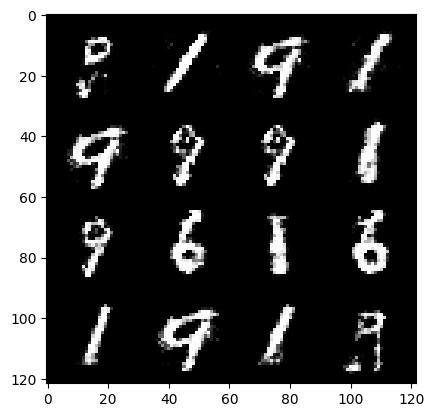

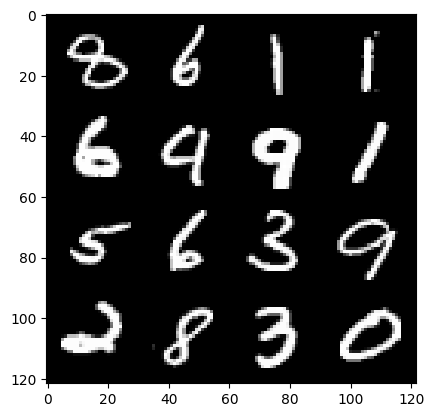

487: step 228600 / Gen loss 2.074885622660318 / Disc loss 0.2882828370730084


  0%|          | 0/469 [00:00<?, ?it/s]

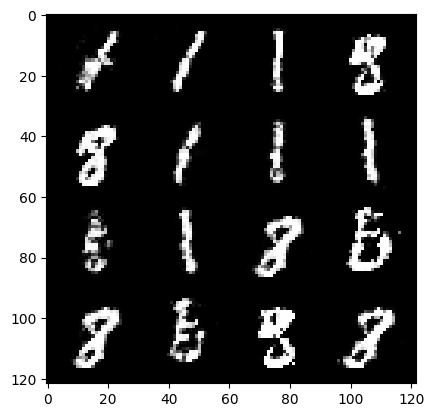

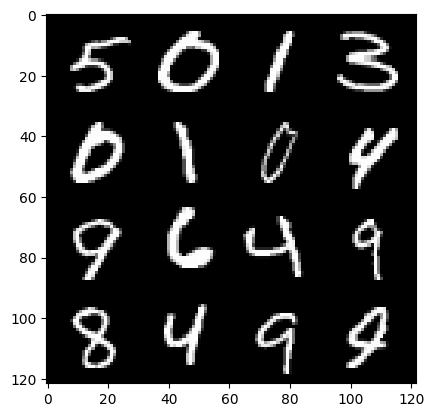

488: step 228900 / Gen loss 2.042486749490102 / Disc loss 0.29880544230341893


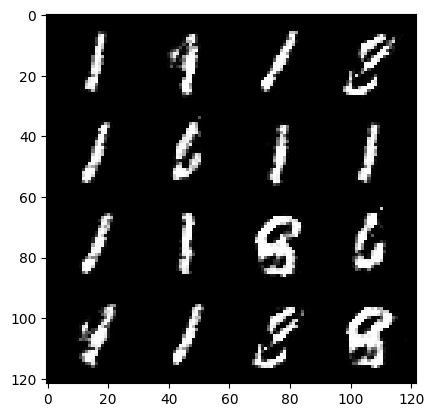

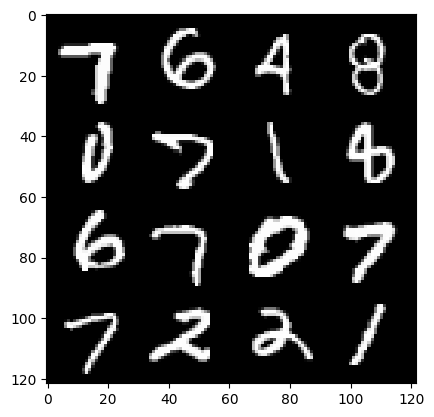

488: step 229200 / Gen loss 2.029757504860561 / Disc loss 0.3299106120069822


  0%|          | 0/469 [00:00<?, ?it/s]

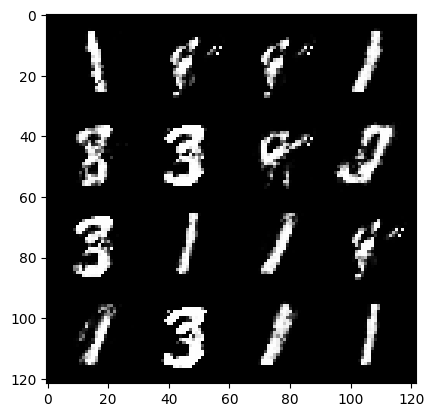

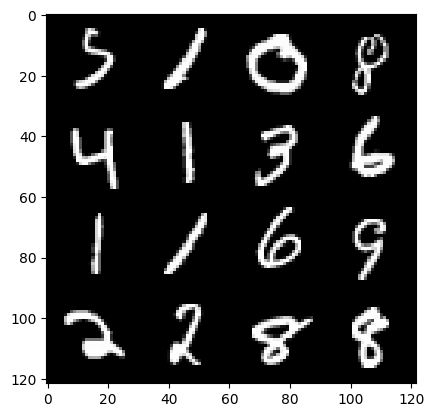

489: step 229500 / Gen loss 2.1296985387802123 / Disc loss 0.2813636854787668


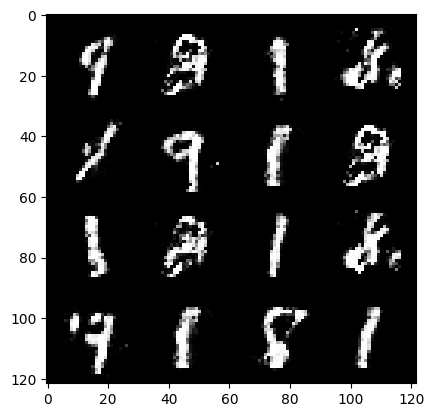

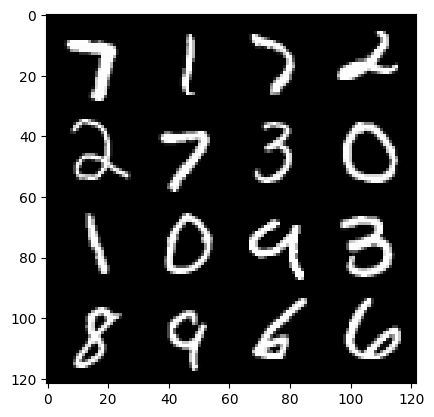

489: step 229800 / Gen loss 2.0740568713347125 / Disc loss 0.2936007174849513


  0%|          | 0/469 [00:00<?, ?it/s]

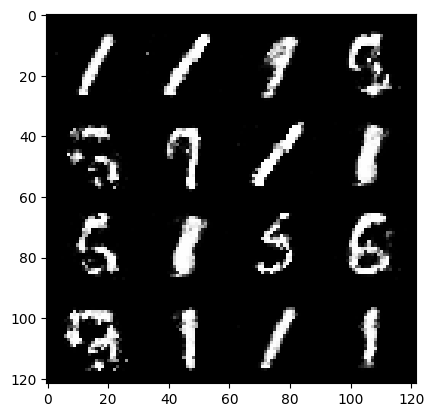

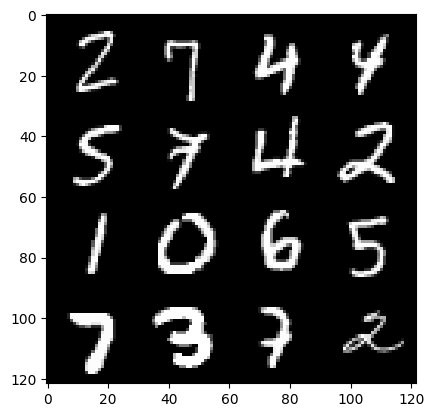

490: step 230100 / Gen loss 2.215605374177297 / Disc loss 0.2980618200202783


  0%|          | 0/469 [00:00<?, ?it/s]

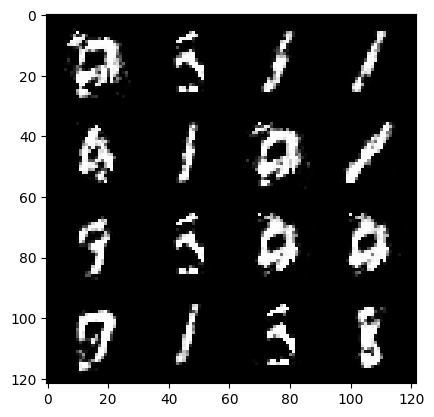

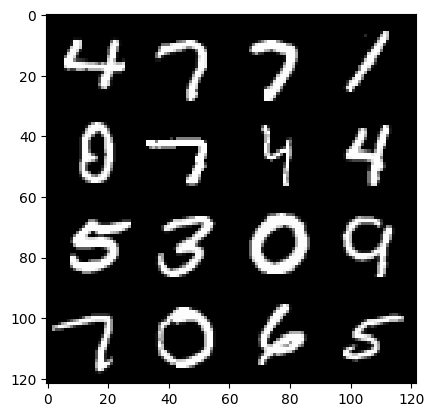

491: step 230400 / Gen loss 2.087347038984299 / Disc loss 0.2947845746080078


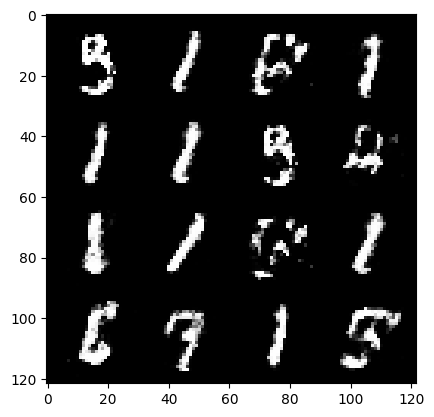

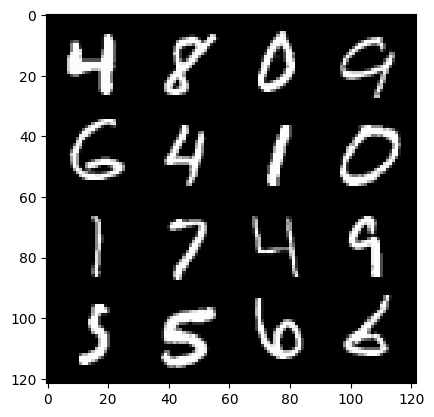

491: step 230700 / Gen loss 2.2044391342004155 / Disc loss 0.2789494666457176


  0%|          | 0/469 [00:00<?, ?it/s]

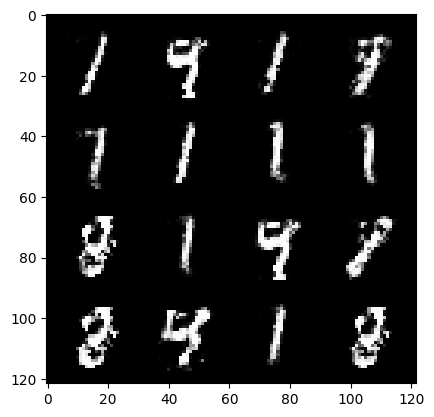

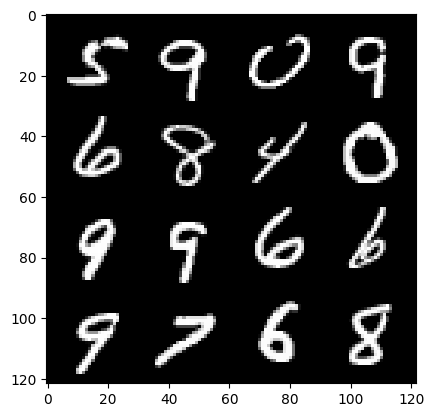

492: step 231000 / Gen loss 2.1663440187772105 / Disc loss 0.2595736368993917


  0%|          | 0/469 [00:00<?, ?it/s]

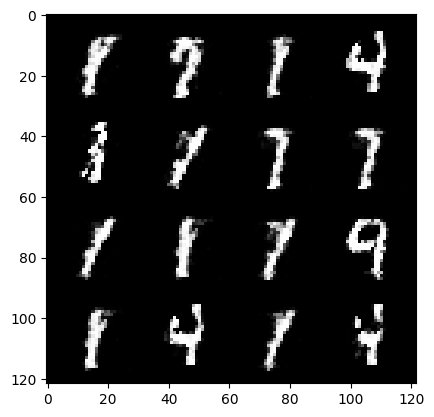

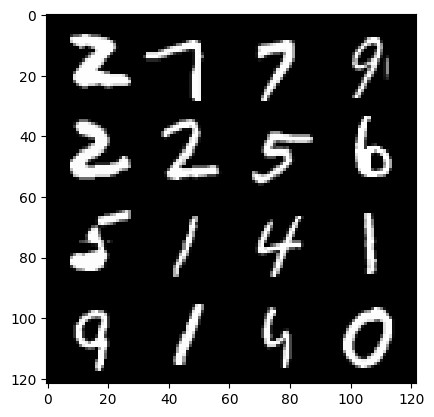

493: step 231300 / Gen loss 2.1737331736087797 / Disc loss 0.26718226025501884


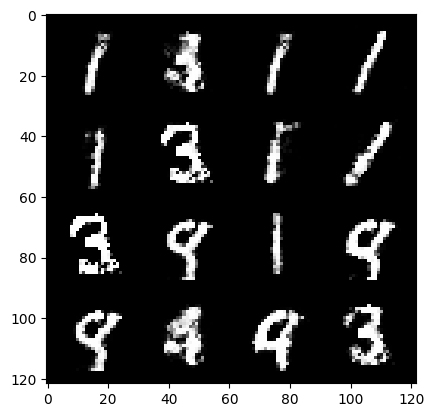

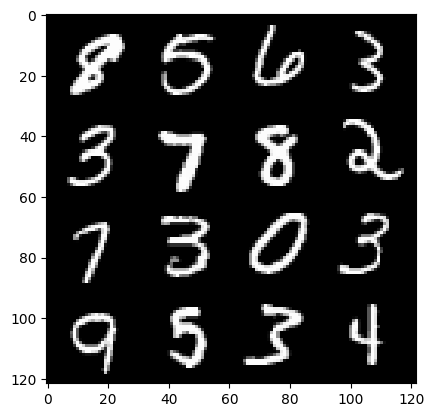

493: step 231600 / Gen loss 2.285522560675942 / Disc loss 0.24102248400449736


  0%|          | 0/469 [00:00<?, ?it/s]

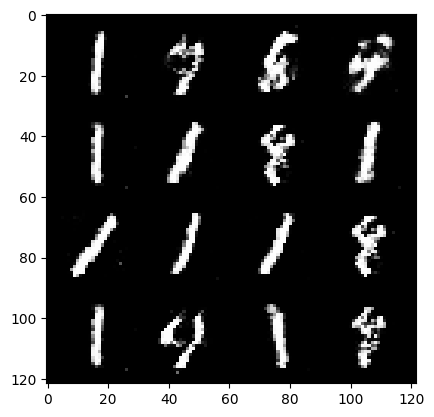

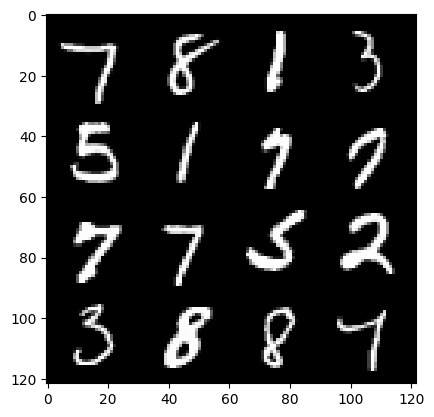

494: step 231900 / Gen loss 2.175550227165223 / Disc loss 0.28988725299636514


  0%|          | 0/469 [00:00<?, ?it/s]

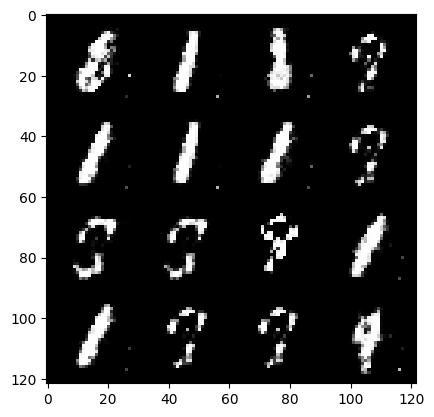

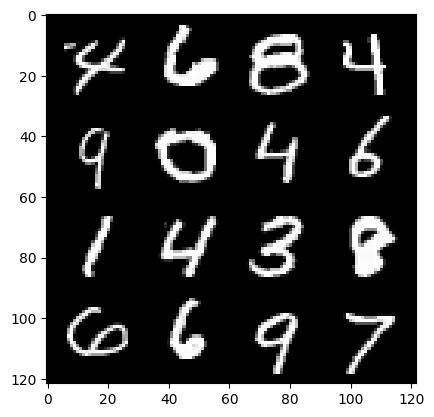

495: step 232200 / Gen loss 2.1713016100724536 / Disc loss 0.27738770748178154


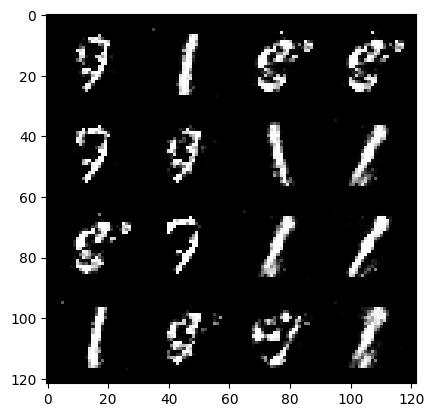

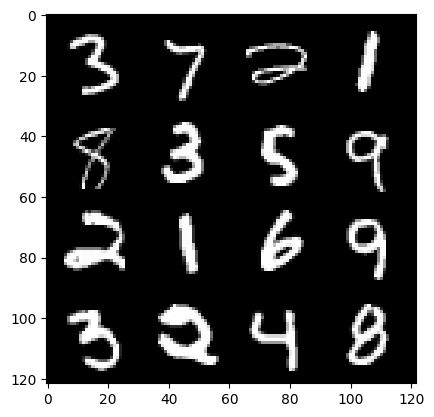

495: step 232500 / Gen loss 2.469458940029141 / Disc loss 0.20600989232460656


  0%|          | 0/469 [00:00<?, ?it/s]

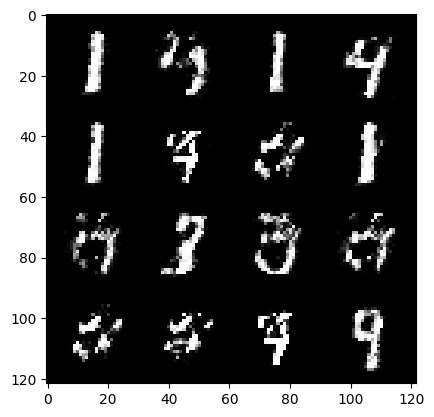

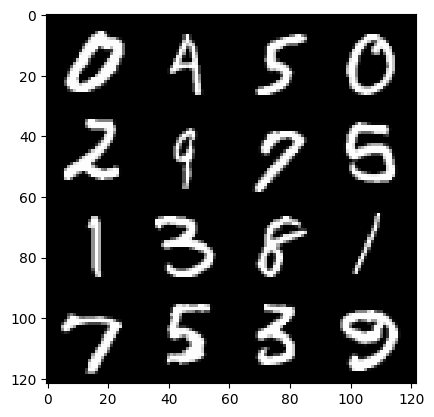

496: step 232800 / Gen loss 2.413091857433318 / Disc loss 0.22893072620034205


  0%|          | 0/469 [00:00<?, ?it/s]

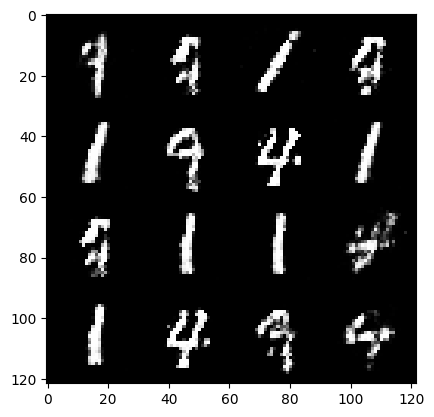

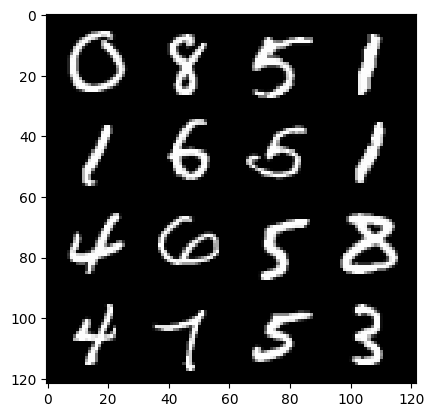

497: step 233100 / Gen loss 2.4076932851473485 / Disc loss 0.225737434476614


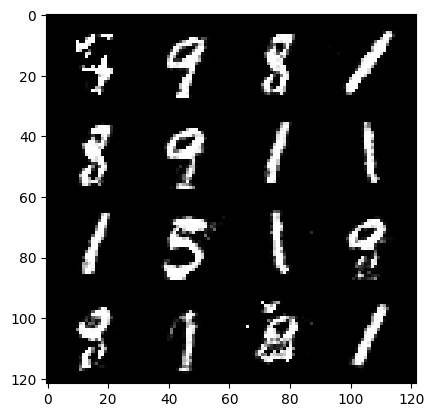

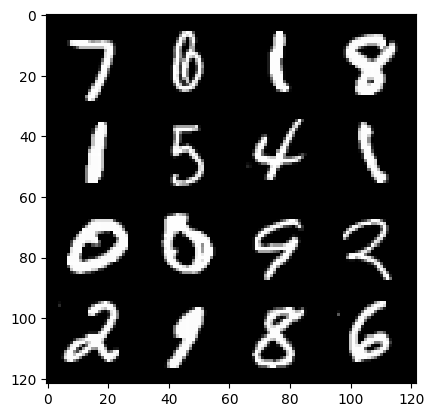

497: step 233400 / Gen loss 2.351097464164099 / Disc loss 0.2422952902813752


  0%|          | 0/469 [00:00<?, ?it/s]

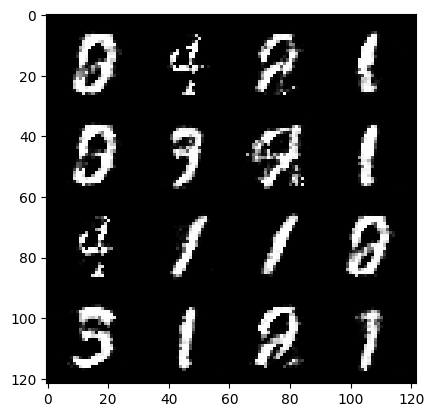

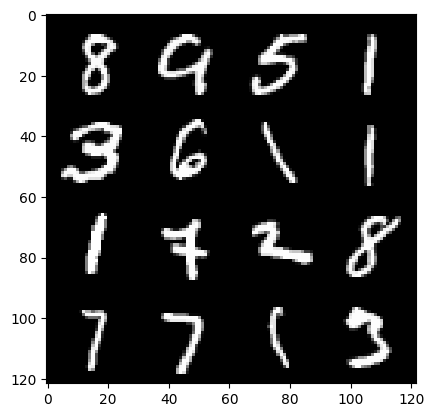

498: step 233700 / Gen loss 2.3276992762088775 / Disc loss 0.23658706518510997


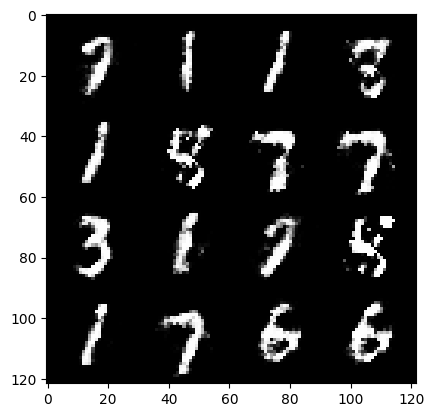

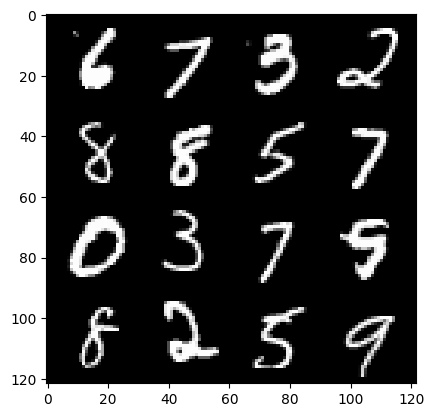

498: step 234000 / Gen loss 2.4231154576937337 / Disc loss 0.2405367440978685


  0%|          | 0/469 [00:00<?, ?it/s]

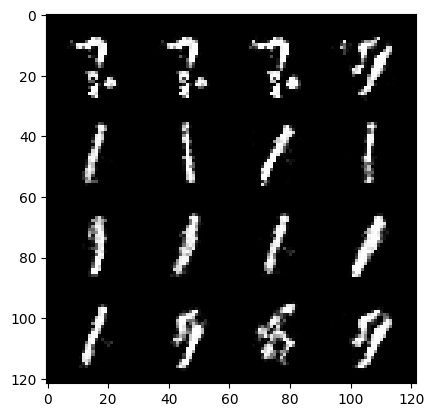

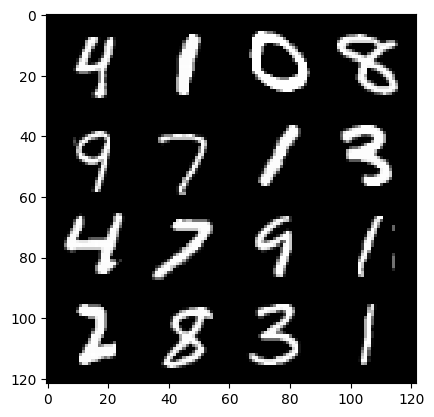

499: step 234300 / Gen loss 2.365063078403475 / Disc loss 0.24646879335244512


In [ ]:
## 60000 / 128 = 468.75 step in each epoch
## each step is going to process 128 images (batch size)

for epoch in range(epochs):
  for real, _ in tqdm(dataloader):
    ## discriminator
    disc_opt.zero_grad()
    cur_bs = len(real) # 128 * 1 * 28 * 28
    real = real.view(cur_bs, -1) # 128 * 784
    real = real.to(device)

    disc_loss = cal_disc_loss(loss_func, gen, disc, cur_bs, real, z_dim)
    disc_loss.backward(retain_graph = True)
    disc_opt.step()

    ## generator
    gen_opt.zero_grad()
    gen_loss = cal_gen_loss(loss_func, gen, disc, cur_bs, z_dim)
    gen_loss.backward(retain_graph = True)
    gen_opt.step()

    ## visualization & stats
    mean_disc_loss += disc_loss.item()/info_step
    mean_gen_loss += gen_loss.item()/info_step

    if cur_step % info_step == 0 and cur_step > 0:
      fake_noise = gen_noise(cur_bs, z_dim)
      fake = gen(fake_noise)
      show(fake)
      show(real)
      print(f"{epoch}: step {cur_step} / Gen loss {mean_gen_loss} / Disc loss {mean_disc_loss}")
      mean_gen_loss, mean_disc_loss = 0,0
    cur_step += 1
